# Learning Kalman filter parameters 

## Importing needed libraries

In [1]:
# includes
import urllib.request
import numpy as np
import pandas as pd
from time import time
import scipy.stats
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.utils import check_X_y
from sklearn.utils.validation import check_is_fitted
from sklearn.utils.multiclass import unique_labels
from filterpy.kalman import KalmanFilter
import sklearn.metrics
import matplotlib.pyplot as plt
%matplotlib notebook
from pykalman import KalmanFilter as KFEM

## Importing Dataset

### Importing Artificial Dataset
Files from data1.csv to data10.csv; you can skip this step and load real data - below.

In [ ]:
# load dataset
import csv
X = []
y = []
with open('./data/data1.csv') as csvfile:
    streamreader = csv.reader(csvfile, delimiter=";")
    i = 0
    for row in streamreader:
        #print(row[0], row[1], row[2], row[3])
        if i > 0:
            X.append([float(row[1])])
            #print(row[2])
            if row[2] == 'False':
                y.append(0);
            else:
                y.append(1);
            
        i = i + 1
        
X = np.array(X)
y = np.array(y)

## Importing W4C sensor data set

In [2]:
# API URL to underground water levels in Slovenia
def LoadData(StationId):
    url = "http://atena.ijs.si:8080/CollectorAPIServer/undergroundWater?station_id=" + str(StationId);
    jsonStr = urllib.request.urlopen(url).read().decode('utf-8');
    df = pd.read_json(jsonStr);
    # format feature vector appropriately
    X = np.array(df['Value'])
    X = X.reshape(X.shape[0],-1)
    # compute mean standard deviation
    ts = pd.Series(df['Value'])
    # converting unix timestamp to date-time object
    df['Date'] = df['LastUpdatedEpoch']
    #df['Date'] = pd.to_datetime(df['Date'], unit='ms')
    
    # remove unneccessary fields
    df.drop('LastUpdated', 1, inplace=True);
    df.drop('LastUpdatedEpoch', 1, inplace=True);
    df.drop('Region_id', 1, inplace=True);
    df.drop('Region_name', 1, inplace=True);
    df.drop('Station_id', 1, inplace=True);
    df.drop('Station_name', 1, inplace=True);
    df.drop('SystemCodeNumber', 1, inplace=True);
    
    # calculate average noise
    noise = ts.rolling(window = 10, center = False).std().mean()
    return df, X, noise

In [8]:
# station with id 85076 is 1279238400Lj - RTV (0261) Ljubljansko polje
df, X, noise = LoadData(75020)

In [ ]:
df

In [40]:


# introduce noise
y = []
for i in range(0, len(X)):
    error = 0
    if (np.random.uniform() < 0.05):
        o = np.random.normal(0, 2);
        if (abs(o) > 2 * noise):
            X[i] = X[i] + o
            #print(X, o)
            error = 1
    y.append(error)
    
y = np.array(y)

In [41]:
# number of all generated outliers
y.sum()

396

## Implementation of Kalman Autonomous Outlier Detection Classificator

In [16]:
class KalmanAOTSClassifier(BaseEstimator, ClassifierMixin):
        
    def __init__(self, p_fact=3., r_fact=30., q_fact=0.0000015):
        # initial factors
        self.p_fact = p_fact
        self.r_fact = r_fact
        self.q_fact = q_fact
        
        # scoring = "accuracy"
    
        self.errors = []
        self.ytspredictions = []
        self.ypredicted = []

        self.Fn = 2
        self.Hn = 2
        
        # init Kalman filter
        self.kf = KalmanFilter(self.Fn, self.Hn)        
        # initial hidden state
        self.kf.x = np.array([[ 0],[ 0]]);
        # initial transition matrix
        self.kf.F = np.array([[1., 1.], [0., 1.]]);
        # initial measurements function
        self.kf.H = np.array([[1., 0.]]);
        
    def EMoptimization(self, X):
        # init Kalman filter
        self.kf = KalmanFilter(self.Fn, self.Hn)        
        # initial hidden state
        # approximate initial state
        startx = X[0]
        startkx = X[1] - X[0]
        self.kf.x = np.array([startx, startkx]);
        # initial transition matrix
        self.kf.F = np.array([[1., 1.], [0., 1.]]);
        # initial measurements function
        self.kf.H = np.array([[1., 0.]]);
        
        # perform EM expectation minimization for Kalman Filter
        lkf = KFEM(transition_matrices = self.kf.F, observation_matrices = self.kf.H)
        # print(self.kf.F, self.kf.H)
        # flatten X for em
        Xflat = np.ndarray.flatten(X)
        #print(Xflat)
        lkf.em(Xflat, n_iter = 1)

        self.EM_initialstate = lkf.initial_state_mean
        self.EM_P = lkf.transition_covariance
        self.EM_R = lkf.observation_covariance
        self.EM_Q = lkf.initial_state_covariance
        
        
    def fit(self, X, y):
        if 'EM_P' in locals():
            print("Exists")
        else:
            #print("EM was not yet run")
            self.EMoptimization(X)
                    
        # Check that X and y have correct shape
        X, y = check_X_y(X, y)
        
        # Store the classes seen during fit
        self.classes_ = unique_labels(y)
        
        # covariance matrix
        self.kf.P = self.EM_P * self.p_fact # kf.P *= 3;
        # state uncertainty
        self.kf.R = self.EM_R * self.r_fact # kf.R = 1;
        self.kf.Q = self.EM_Q * self.q_fact # kf.Q = np.array([[0.0001, 0.0005], [0.0005, 0.0005]])

        # intial state
        self.kf.x = self.EM_initialstate

        self.X_ = X
        self.y_ = y
        # Return the classifier
        return self

    def get_params(self, deep=True):
        # suppose this estimator has parameters "alpha" and "recursive"
        return {"p_fact": self.p_fact, "r_fact": self.r_fact, "q_fact": self.q_fact }

    def set_params(self, **parameters):
        for parameter, value in parameters.items():
            setattr(self, parameter, value)
        return self    
    
    def predict(self, X):
        print("Predict is run")
        # Check is fit had been called
        check_is_fitted(self, ['X_', 'y_'])

        # Input validation
        #X = check_array(X)
        self.ypredicted = []
        self.tspredictions = []
        
        for m in X:
            m = m[0]
            self.kf.predict();
            y = self.kf.x[0] + self.kf.x[1] * 0.01 # hardcoded step (!)
            e = self.kf.P[0, 0]
            
            error = 0
            if (m < y - e):
                self.kf.P *= 2;
                error = 1
            if (m > y + e):
                self.kf.P *= 2;
                error = 1
            
            self.errors.append(e)
            self.tspredictions.append(y)
            
            if error == 0:
                self.kf.update(m)
            
            #print(m, y, e, error)
            self.ypredicted.append(error)

        return self.ypredicted
    
    def returnVariance(self):
        return self.errors
    
    def returnPredictions(self):
        return self.tspredictions
    
    def score(self, X, y_true):
        ly = self.predict(X);
        score = sklearn.metrics.f1_score(y_true, ly)
        # print(sklearn.metrics.classification_report(y_true, y))
        print("Score: ", score, "    p, r, q", self.p_fact, self.r_fact, self.q_fact)
        return score

## Optimal parameter learning
We create a set of possible values of factors and then perform a randomized search over it. Grid search might be better!

In [42]:
param_dist = {
    "p_fact": [0.0001, 0.0003, 0.001, 0.003, 0.01, 0.03, 0.1, 0.3, 1., 3., 10, 30],
    "r_fact": [0.003, 0.01, 0.03, 0.1, 0.3, 1., 3., 10],
    "q_fact": [0.00001, 0.0003, 0.001, 0.003, 0.01, 0.03, 0.1]
}

In [43]:
clf2 = KalmanAOTSClassifier();
n_iter_search = 10
random_search = RandomizedSearchCV(clf2, param_distributions=param_dist, n_iter=n_iter_search)
random_search.fit(X[0:1000], y[0:1000])

Predict is run
Score:  0.55737704918     p, r, q 0.3 0.003 0.1
Predict is run
Score:  0.739130434783     p, r, q 0.3 0.003 0.1
Predict is run
Score:  0.603773584906     p, r, q 0.3 0.003 0.1
Predict is run
Score:  0.693069306931     p, r, q 0.3 0.003 0.1
Predict is run
Score:  0.734693877551     p, r, q 0.3 0.003 0.1
Predict is run
Score:  0.628571428571     p, r, q 0.3 0.003 0.1
Predict is run
Score:  0.307692307692     p, r, q 0.001 1.0 0.0003
Predict is run
Score:  0.5     p, r, q 0.001 1.0 0.0003
Predict is run
Score:  0.315789473684     p, r, q 0.001 1.0 0.0003
Predict is run
Score:  0.56     p, r, q 0.001 1.0 0.0003
Predict is run
Score:  0.358974358974     p, r, q 0.001 1.0 0.0003
Predict is run
Score:  0.5     p, r, q 0.001 1.0 0.0003
Predict is run
Score:  0.0869565217391     p, r, q 0.3 10 0.01
Predict is run


C:\Users\kkenda\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1113: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


Score:  0.0     p, r, q 0.3 10 0.01
Predict is run
Score:  0.0869565217391     p, r, q 0.3 10 0.01
Predict is run
Score:  0.0     p, r, q 0.3 10 0.01
Predict is run
Score:  0.173913043478     p, r, q 0.3 10 0.01
Predict is run
Score:  0.0     p, r, q 0.3 10 0.01
Predict is run
Score:  0.0740740740741     p, r, q 0.1 10 1e-05
Predict is run
Score:  0.0540540540541     p, r, q 0.1 10 1e-05
Predict is run
Score:  0.153846153846     p, r, q 0.1 10 1e-05
Predict is run
Score:  0.105263157895     p, r, q 0.1 10 1e-05
Predict is run
Score:  0.222222222222     p, r, q 0.1 10 1e-05
Predict is run
Score:  0.0540540540541     p, r, q 0.1 10 1e-05
Predict is run
Score:  0.129032258065     p, r, q 0.0003 10 0.001
Predict is run
Score:  0.0     p, r, q 0.0003 10 0.001
Predict is run
Score:  0.129032258065     p, r, q 0.0003 10 0.001
Predict is run
Score:  0.0     p, r, q 0.0003 10 0.001
Predict is run
Score:  0.129032258065     p, r, q 0.0003 10 0.001
Predict is run
Score:  0.0     p, r, q 0.0003 10

RandomizedSearchCV(cv=None, error_score='raise',
          estimator=KalmanAOTSClassifier(p_fact=3.0, q_fact=1.5e-06, r_fact=30.0),
          fit_params={}, iid=True, n_iter=10, n_jobs=1,
          param_distributions={'p_fact': [0.0001, 0.0003, 0.001, 0.003, 0.01, 0.03, 0.1, 0.3, 1.0, 3.0, 10, 30], 'r_fact': [0.003, 0.01, 0.03, 0.1, 0.3, 1.0, 3.0, 10], 'q_fact': [1e-05, 0.0003, 0.001, 0.003, 0.01, 0.03, 0.1]},
          pre_dispatch='2*n_jobs', random_state=None, refit=True,
          return_train_score=True, scoring=None, verbose=0)

In [44]:
# Utility function to report best scores
def report(results, n_top=3):
    for i in range(1, n_top + 1):
        candidates = np.flatnonzero(results['rank_test_score'] == i)
        for candidate in candidates:
            print("Model with rank: {0}".format(i))
            print("Mean validation score: {0:.3f} (std: {1:.3f})".format(
                  results['mean_test_score'][candidate],
                  results['std_test_score'][candidate]))
            print("Parameters: {0}".format(results['params'][candidate]))
            print("")
report(random_search.cv_results_)

Model with rank: 1
Mean validation score: 0.664 (std: 0.089)
Parameters: {'r_fact': 0.1, 'q_fact': 0.01, 'p_fact': 0.3}

Model with rank: 2
Mean validation score: 0.632 (std: 0.075)
Parameters: {'r_fact': 0.003, 'q_fact': 0.1, 'p_fact': 0.3}

Model with rank: 3
Mean validation score: 0.529 (std: 0.035)
Parameters: {'r_fact': 0.03, 'q_fact': 0.0003, 'p_fact': 1.0}



## Creating optimal classificator

In [ ]:
clftrue = KalmanAOTSClassifier(p_fact = 1.0, q_fact = 0.1, r_fact = 0.01)
clftrue.fit(X[0:800], y[0:800])
clftrue.score(X[0:800], y[0:800])

In [ ]:
pred = clftrue.predict(X[0:800])

In [ ]:
np.array(pred).sum()

In [ ]:
print("F1", sklearn.metrics.f1_score(clftrue.ypredicted, y[0:800]))
print("Acc", sklearn.metrics.accuracy_score(clftrue.ypredicted, y[0:800]))
print("Prec", sklearn.metrics.precision_score(clftrue.ypredicted, y[0:800]))
print("Recall", sklearn.metrics.recall_score(clftrue.ypredicted, y[0:800]))

In [ ]:
clftrue.y_
yt = clftrue.tspredictions

In [ ]:
# visualize errors
import matplotlib.pyplot as plt
fig1 = plt.figure()
plt.plot(X[20:400], label="measurements"); 
plt.plot(yt[20:400], label="KF prediction");
# plt.fill_between(xM, yM - yE, yM + yE, label="band", alpha = 0.2)
plt.legend(loc='upper right', prop={'size': 9})

plt.show()

In [23]:
def CleanData(stationId):
    df, X, noise = LoadData(stationId)
    if len(df) == 0:
        return 0, 0, noise;
    # if noise > 0.2:
    #    return(-1)
        
    y = np.zeros(len(X))
    # smooth sensors
    clftrue = KalmanAOTSClassifier(p_fact = 1.0, q_fact = 0.1, r_fact = 0.003)
    # rougher sensors 50101
    #clftrue = KalmanAOTSClassifier(p_fact = 3.0, q_fact = 0.01, r_fact = 0.1)
    # 16005    
    # clftrue = KalmanAOTSClassifier(p_fact = 0.3, q_fact = 0.03, r_fact = 0.01)    
    # 75020    
    # clftrue = KalmanAOTSClassifier(p_fact = 0.3, q_fact = 0.01, r_fact = 2)
    clftrue.fit(X, y)

    pred = clftrue.predict(X)
    
    '''
    #fig2 = plt.figure(figsize=(15,10))
    startPlot = 20
    endPlot = len(X)
    x_axis = (np.array(df['Date']))[startPlot:endPlot] #.reshape(X.shape[0],-1))
    
    plt.plot(x_axis, X[startPlot:endPlot], label="measurements"); 
    '''
    yt = clftrue.tspredictions
    '''
    plt.plot(x_axis, yt[startPlot:endPlot], label="KF prediction");
    #plt.plot(np.array(clftrue.ypredicted[120:700]) + 276)
    yE = np.array(clftrue.returnVariance());
    #print(x_axis)
    min_axis =  (yt[startPlot:endPlot] - yE[startPlot:endPlot]).flatten()
    max_axis =  (yt[startPlot:endPlot] + yE[startPlot:endPlot]).flatten()
    #print(len(x_axis), len(min_axis), len(max_axis))
    plt.fill_between(x_axis, min_axis, max_axis, label="band", alpha = 0.2)
    plt.legend(loc='upper right', prop={'size': 9})

    for i in range(1, endPlot - startPlot):
        if pred[i + startPlot] == 1:
            plt.axvline(x = x_axis[i], linestyle=':', color='red')
            
    #plt.savefig(str(stationId) + ".png")
    #plt.close()
    '''
    # return number of detected errors
    return len(df), np.array(pred).sum(), noise, pred, yt

#a, b, c, d, e = CleanData(75020)

## List all the available sensors for GroundWater in Ljubljana

In [9]:
# API URL to underground water levels Slovenia
# list all available sensors
url = "http://atena.ijs.si:8080/CollectorAPIServer/undergroundWater?getStations";
jsonStr = urllib.request.urlopen(url).read().decode('utf-8');
sources = pd.read_json(jsonStr);

In [ ]:
# go through all sensors and run algorithm for them
allNodes = []
for i in range(0, len(sources)):
    try:
        length, errors, noise = CleanData(sources["Station_id"][i])
        allNodes.append({"stationId": sources["Station_id"][i], "len": length, "errors": errors, "noise": noise})
        print(sources["Station_id"][i], errors)
    except Exception as inst:
        print(type(inst))    # the exception instance
        print(inst.args)     # arguments stored in .args
        
    

In [ ]:
allNodes

Predict is run


<IPython.core.display.Javascript object>


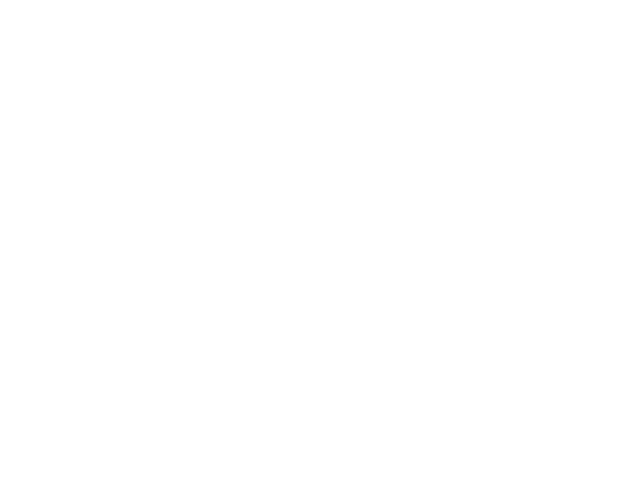

Predict is run


<IPython.core.display.Javascript object>


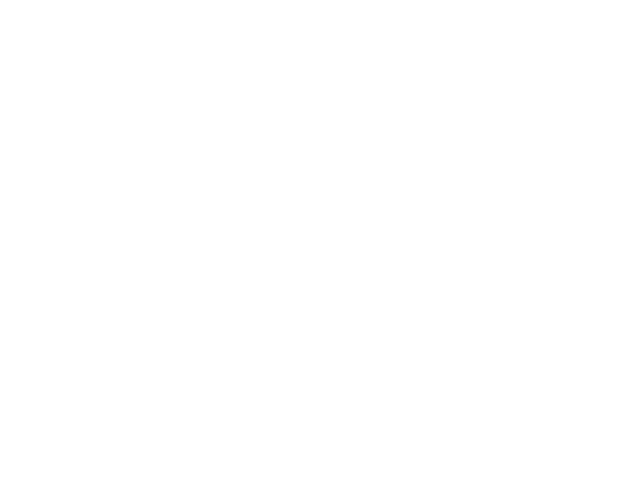

Predict is run


<IPython.core.display.Javascript object>


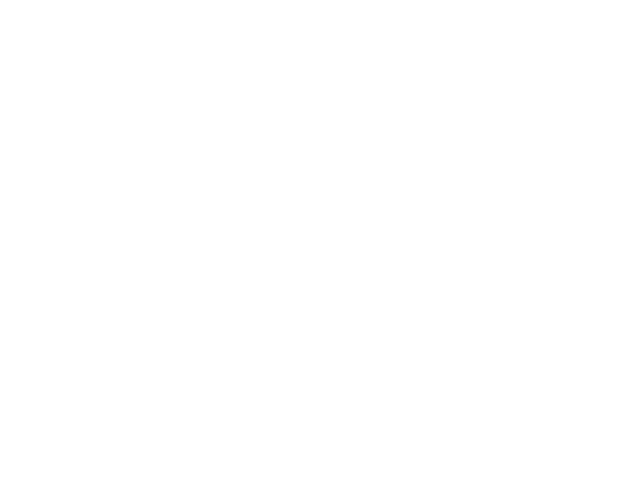

Predict is run


<IPython.core.display.Javascript object>


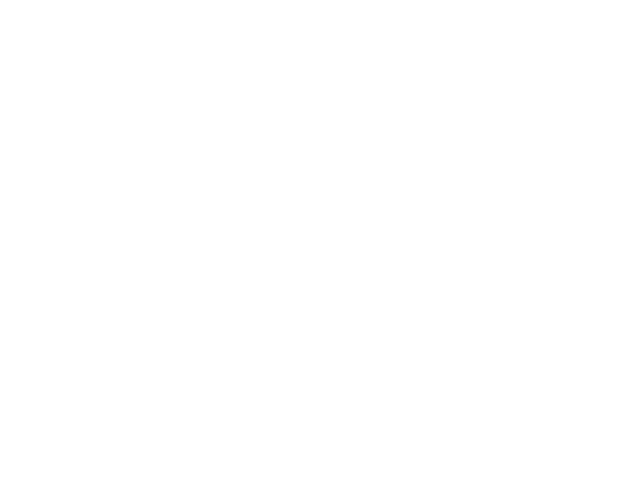

Predict is run


<IPython.core.display.Javascript object>


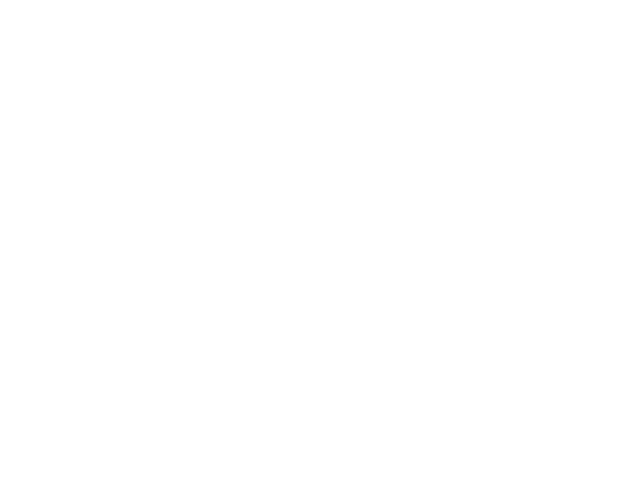

In [20]:
for i in [10078, 15008, 90015, 73021, 90012]:
    length, errors, noise = CleanData(i)

## ARIMA modeling of timeseries
To investigate the effect of data cleaning.

In [11]:
# includes
from pandas import datetime
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima_model import ARMAResults 

C:\Users\kkenda\Anaconda3\lib\site-packages\statsmodels\compat\pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [21]:
def CompareCleanRaw(sensorId):
    # load data
    df, X, noise = LoadData(sensorId)
    # convert data frame in to timeseries
    df['Date'] = pd.to_datetime(df['Date'], unit='ms')
    df.set_index('Date', inplace=True)
    # convert to timeseries
    startPlot = 20
    ts = pd.Series(df['Value'][startPlot:])
    
    # fit model
    model = ARIMA(ts, order=(1,1,0))
    model_fit = model.fit(disp=0)
    bic1 = model_fit.bic
    
    
    # clean data
    # clean data and make clean set
    length, errors, noise, pred, yt = CleanData(sensorId)
    print("Sensor", sensorId)
    print("Errors: ", errors, " (", errors/length, ")")
    pred = pred[startPlot:]
    yt = yt[startPlot:]
    
    uts = ts.copy();
    for i in range(1, len(yt)):
        if (pred[i] == 1):
            uts[i] = yt[i]
            
    # fit model
    modelu = ARIMA(uts, order=(1,1,0))
    modelu_fit = modelu.fit(disp=0)
    bic2 = modelu_fit.bic
    
    print("BIC - raw:", bic1, " BIC - clean:", bic2)
    
    plt.plot(uts, label="Clean data")
    plt.plot(ts, label="Raw data")
    plt.legend(loc='lower right', prop={'size': 9})
    #plt.savefig('c' + str(sensorId) + ".png")
    #plt.close();

Predict is run
Sensor 75020
Errors:  389  ( 0.0482570400695 )
BIC - raw: -15496.3973613  BIC - clean: -12645.9581784


<IPython.core.display.Javascript object>


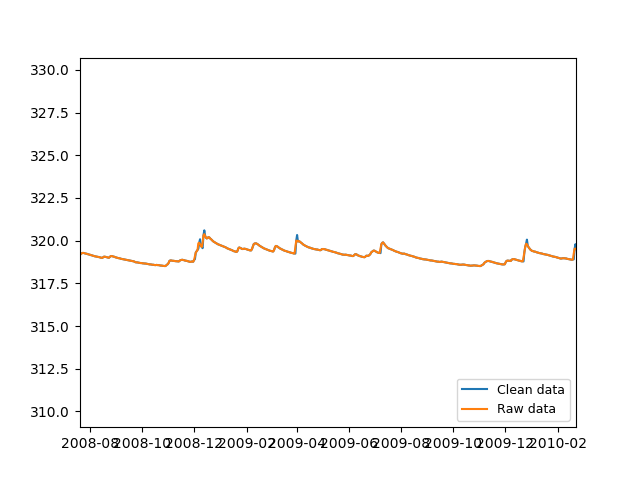

In [24]:
CompareCleanRaw(75020)

<IPython.core.display.Javascript object>


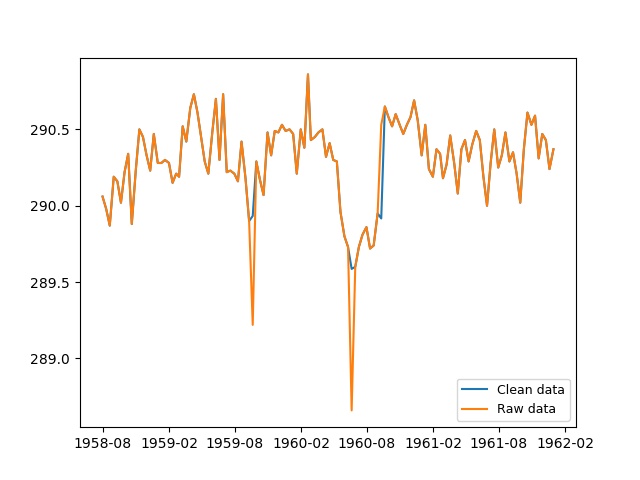

In [135]:
plt.plot(uts, label="Clean data")
plt.plot(ts, label="Raw data")
plt.legend(loc='lower right', prop={'size': 9})

In [131]:
plt.savefig('cleanvsnot.png')

## Clustering of sensors

In [14]:
# API URL to underground water levels Slovenia
# list all available sensors
url = "http://atena.ijs.si:8080/CollectorAPIServer/undergroundWater?getStations";
jsonStr = urllib.request.urlopen(url).read().decode('utf-8');
sources = pd.read_json(jsonStr);

Chosen 16005
Predict is run
Sensor 16005
Errors:  38  ( 0.00285907757129 )
BIC - raw: -60644.3803453  BIC - clean: -59458.7263529


<IPython.core.display.Javascript object>


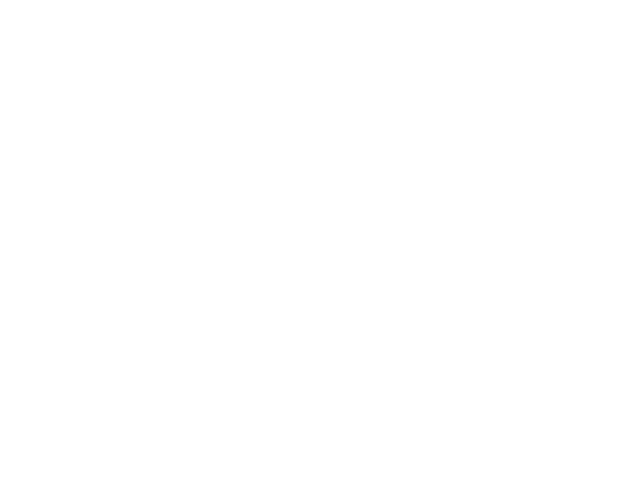

Chosen 75020
Predict is run


<IPython.core.display.Javascript object>


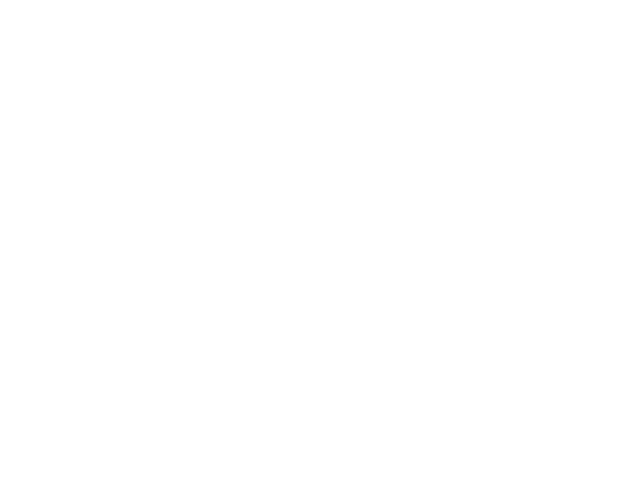

Sensor 75020
Errors:  389  ( 0.0482570400695 )
BIC - raw: -15496.3973613  BIC - clean: -12645.9581784


<IPython.core.display.Javascript object>


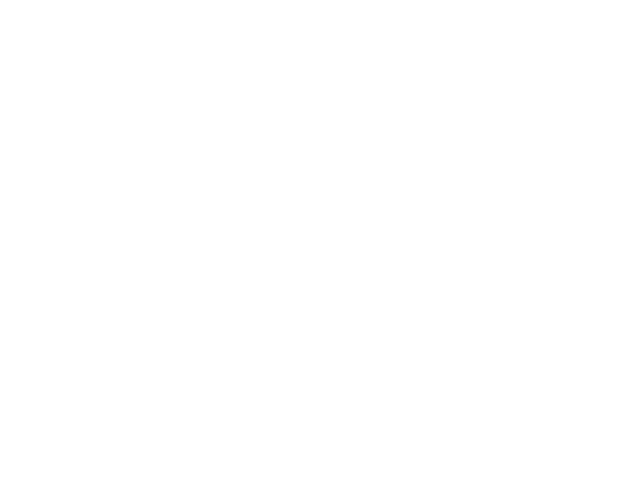

Chosen 95052
Predict is run


<IPython.core.display.Javascript object>


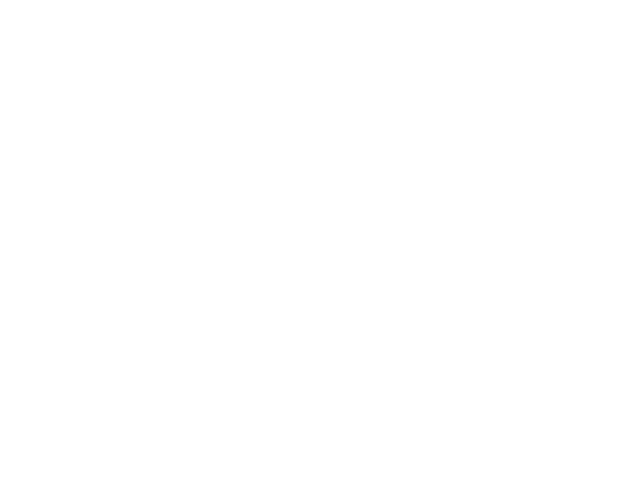

Sensor 95052
Errors:  54  ( 0.461538461538 )
BIC - raw: 303.598664575  BIC - clean: 301.933602347


<IPython.core.display.Javascript object>


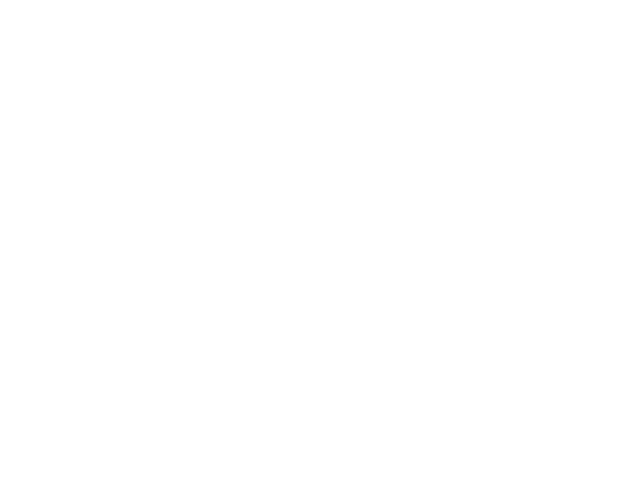

Chosen 95081
Predict is run


<IPython.core.display.Javascript object>


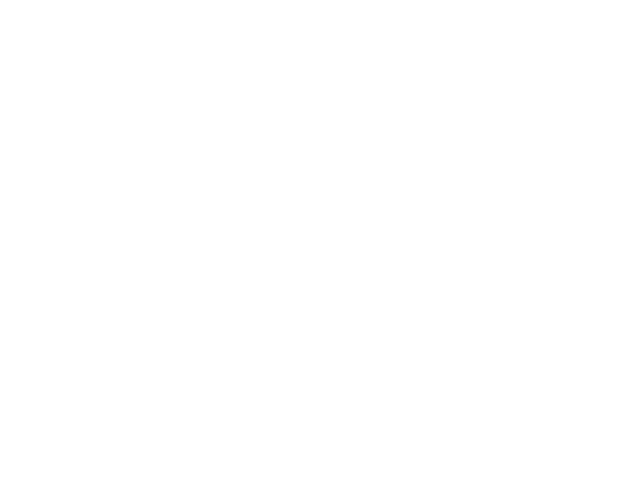

Sensor 95081
Errors:  43  ( 0.623188405797 )
BIC - raw: 245.136852265  BIC - clean: 295.5049653


<IPython.core.display.Javascript object>


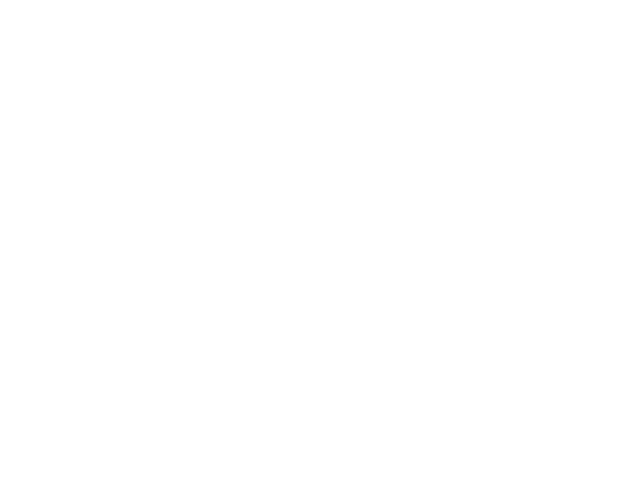

Chosen 95006
Predict is run


<IPython.core.display.Javascript object>


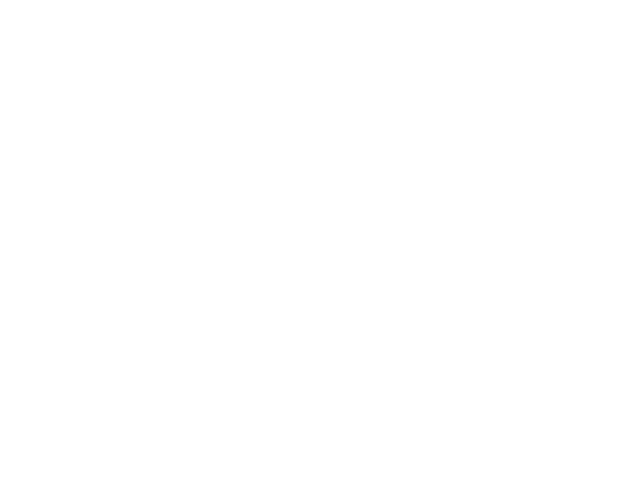

Sensor 95006
Errors:  42  ( 0.352941176471 )
BIC - raw: 175.275185396  BIC - clean: 162.130966521


<IPython.core.display.Javascript object>


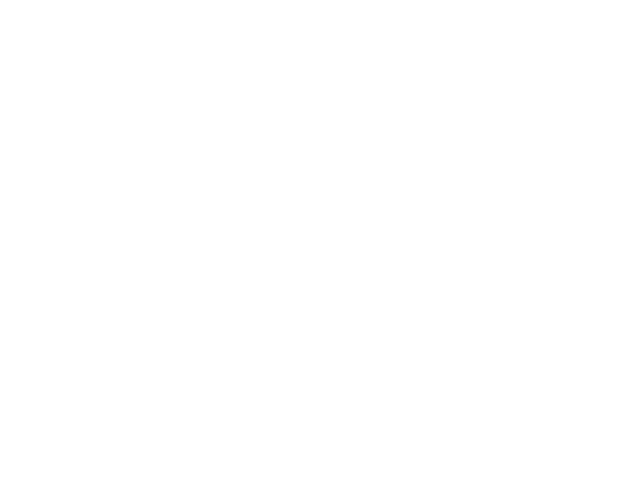

Chosen 95035
Predict is run


<IPython.core.display.Javascript object>


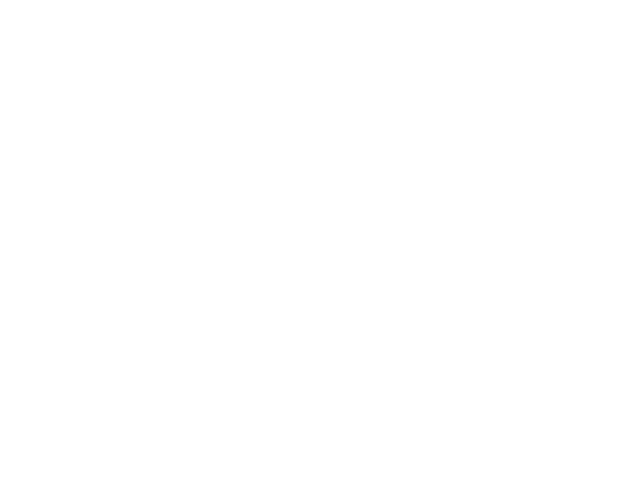

Sensor 95035
Errors:  1369  ( 0.182996925545 )
BIC - raw: 1706.44438696  BIC - clean: 4478.37418163


<IPython.core.display.Javascript object>


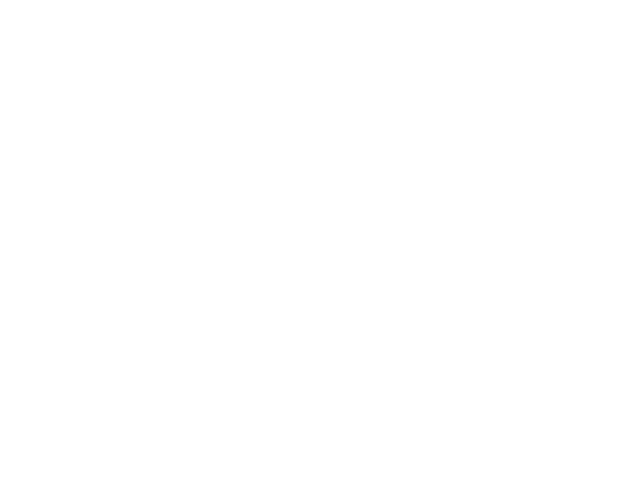

Chosen 95024
Predict is run


<IPython.core.display.Javascript object>


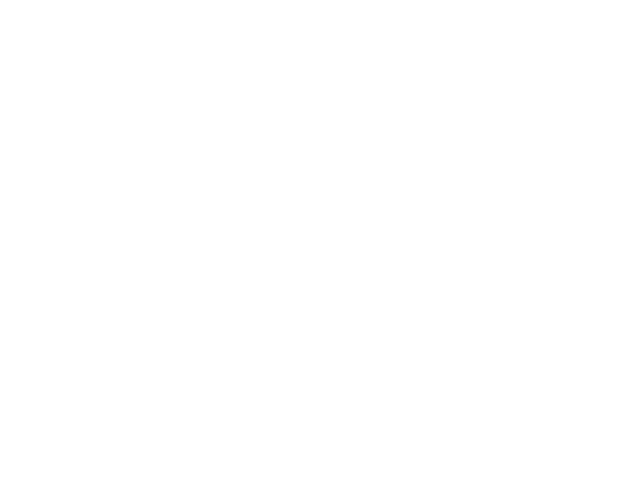

Sensor 95024
Errors:  58  ( 0.487394957983 )
BIC - raw: 257.897055964  BIC - clean: 301.717156764


<IPython.core.display.Javascript object>


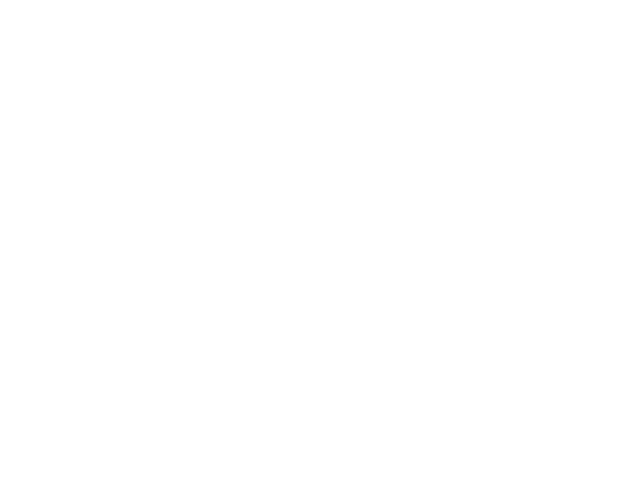

Chosen 95046
Predict is run


<IPython.core.display.Javascript object>


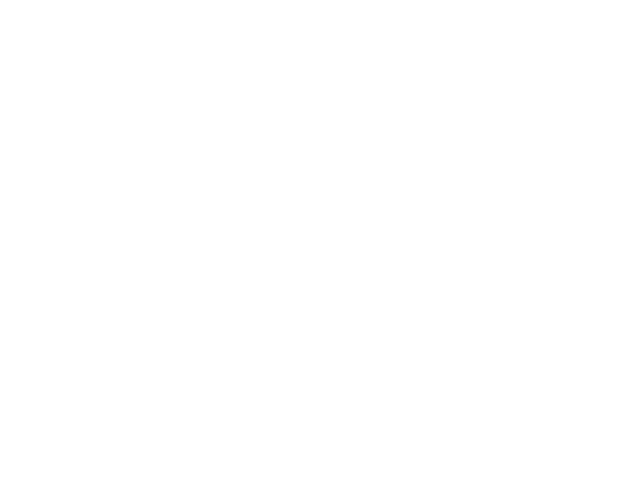

Sensor 95046
Errors:  20  ( 0.176991150442 )
BIC - raw: 1760.41423138  BIC - clean: 1696.83453432


<IPython.core.display.Javascript object>


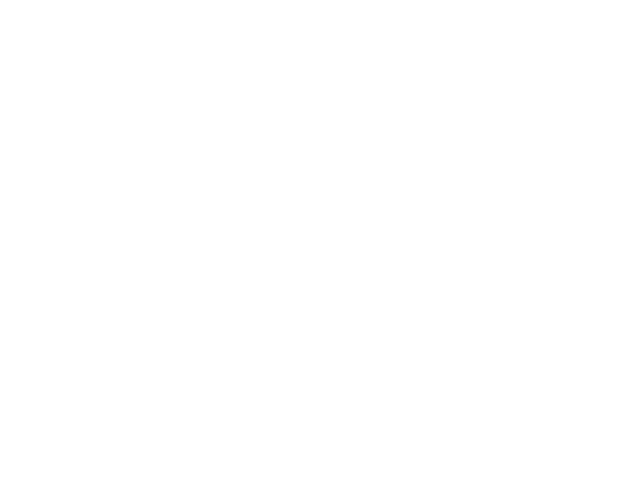

Chosen 95031
Predict is run


<IPython.core.display.Javascript object>


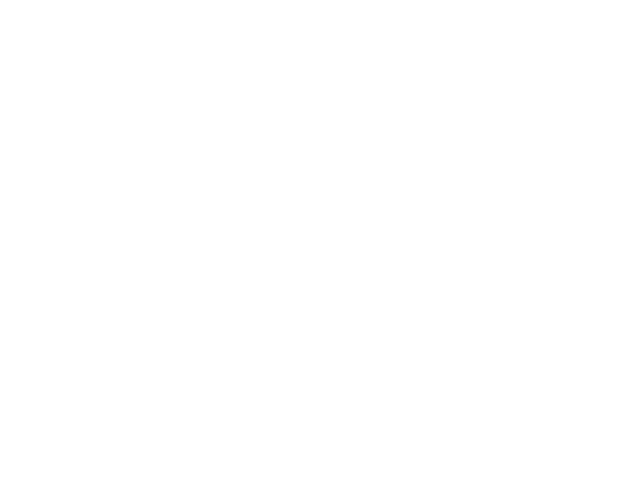

Sensor 95031
Errors:  34  ( 0.283333333333 )
BIC - raw: 77.4054374531  BIC - clean: 72.4675415565


<IPython.core.display.Javascript object>


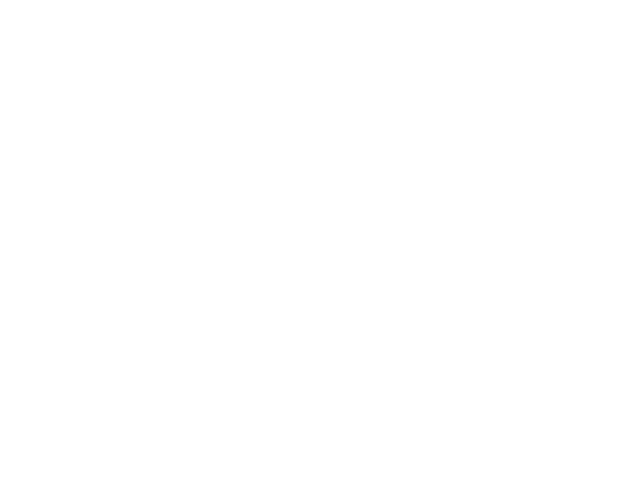

Chosen 95030
Predict is run


<IPython.core.display.Javascript object>


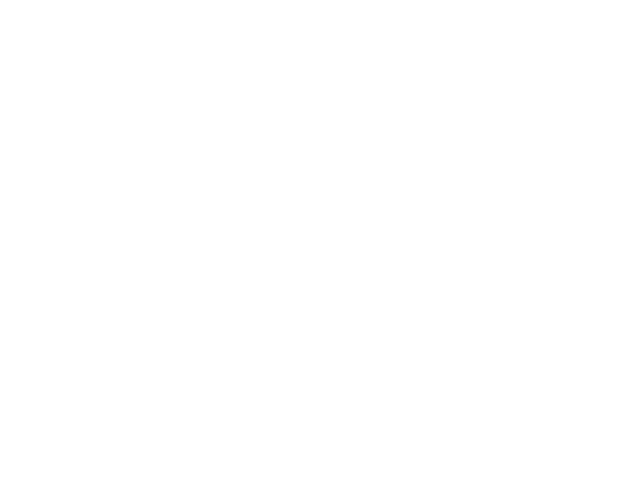

Sensor 95030
Errors:  2419  ( 0.263364180729 )
BIC - raw: 10857.8870337  BIC - clean: 16442.2132596


<IPython.core.display.Javascript object>


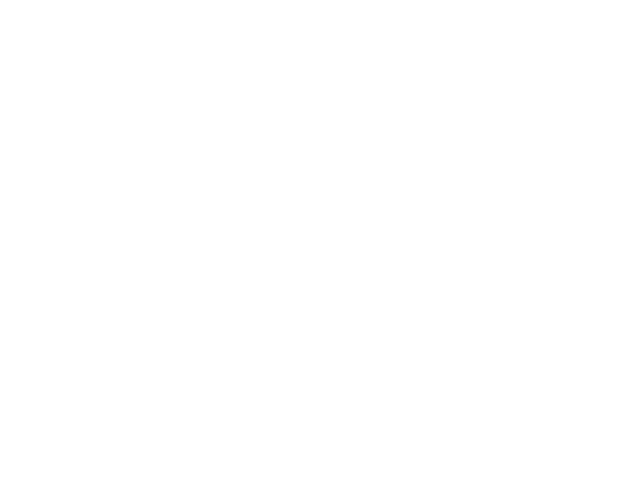

Chosen 95002
Predict is run


<IPython.core.display.Javascript object>


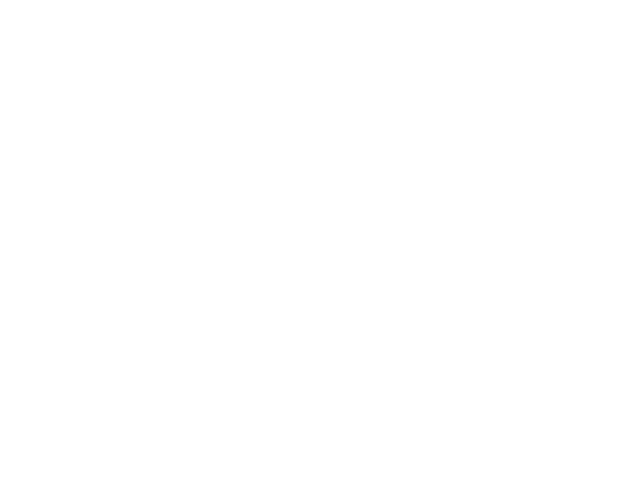

Sensor 95002
Errors:  44  ( 0.382608695652 )
BIC - raw: 258.362823916  BIC - clean: 232.553640081


<IPython.core.display.Javascript object>


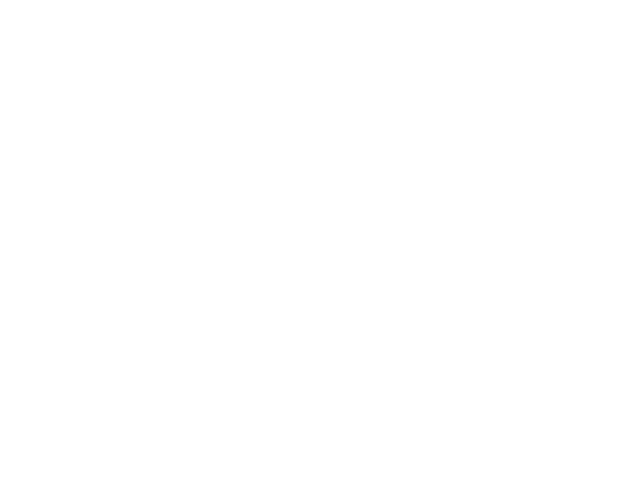

Chosen 95019
Predict is run


<IPython.core.display.Javascript object>


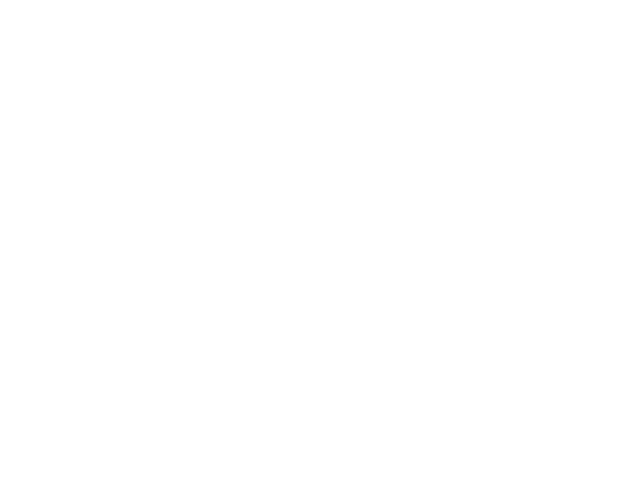

Sensor 95019
Errors:  36  ( 0.3 )
BIC - raw: 148.164853561  BIC - clean: 199.814293036


<IPython.core.display.Javascript object>


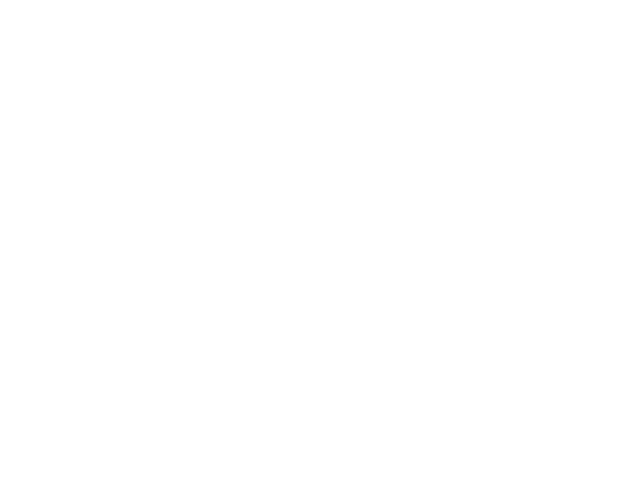

Chosen 95020
Predict is run


<IPython.core.display.Javascript object>


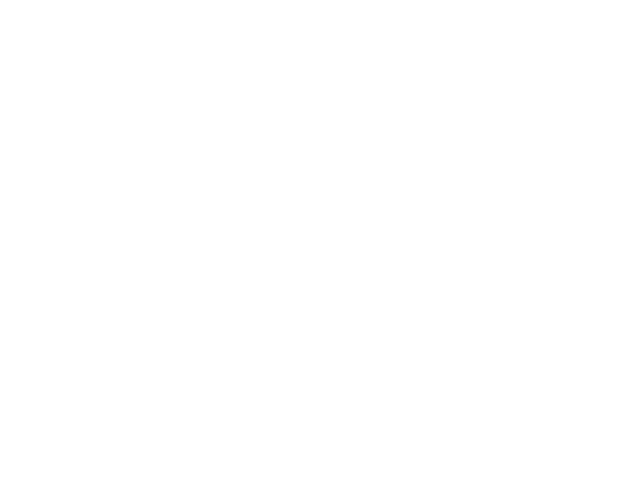

Sensor 95020
Errors:  481  ( 0.262411347518 )
BIC - raw: -481.010449399  BIC - clean: 61.2391232625


<IPython.core.display.Javascript object>


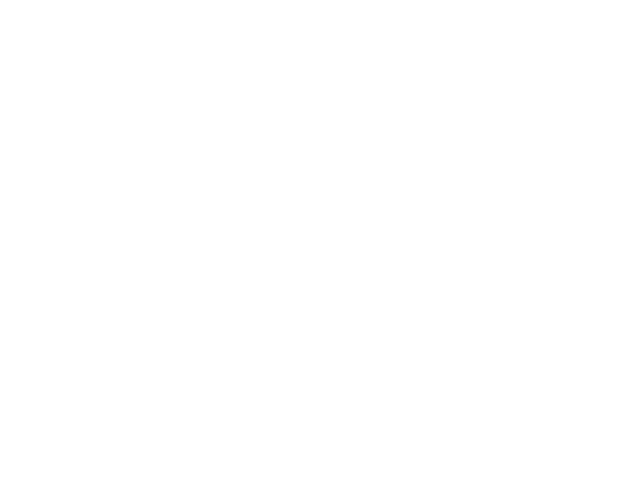

Chosen 95056
Predict is run


<IPython.core.display.Javascript object>


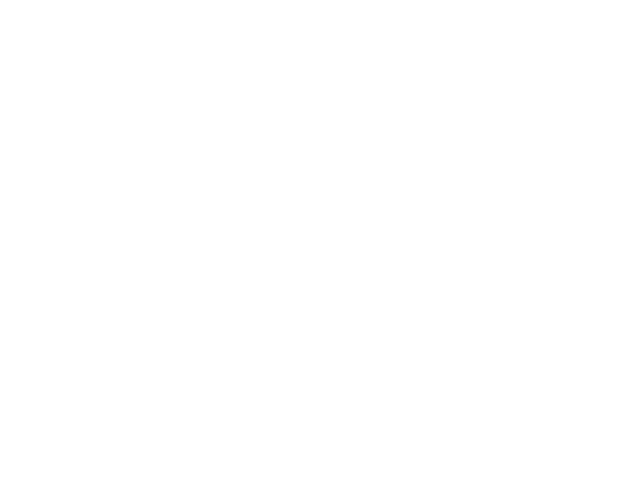

Sensor 95056
Errors:  47  ( 0.635135135135 )
BIC - raw: 323.532324596  BIC - clean: 279.429541789


<IPython.core.display.Javascript object>


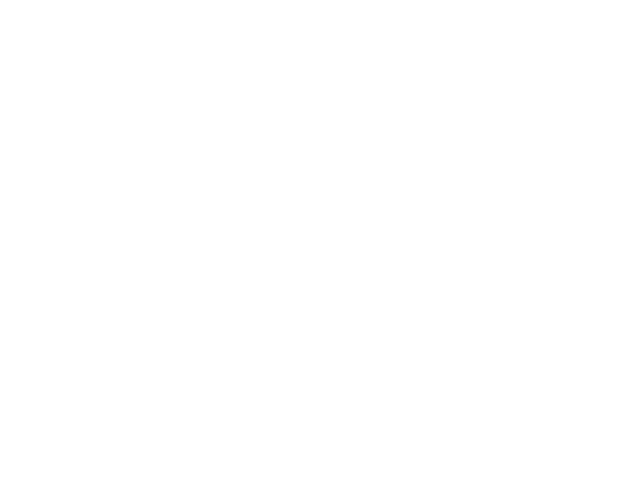

Chosen 95101
Predict is run


<IPython.core.display.Javascript object>


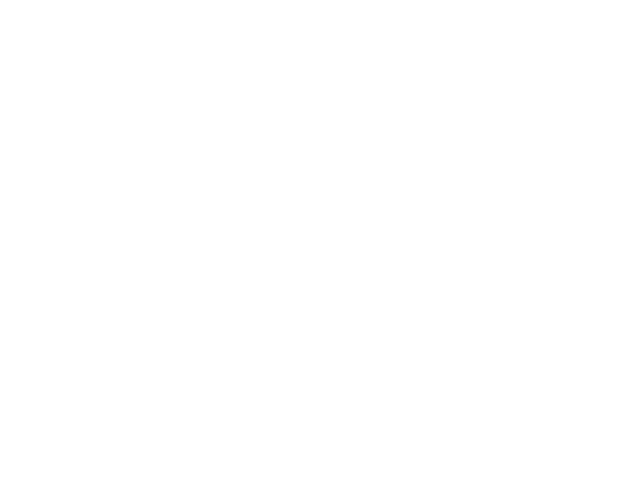

Sensor 95101
Errors:  403  ( 0.508838383838 )
BIC - raw: 2132.61831693  BIC - clean: 2365.20451202


<IPython.core.display.Javascript object>


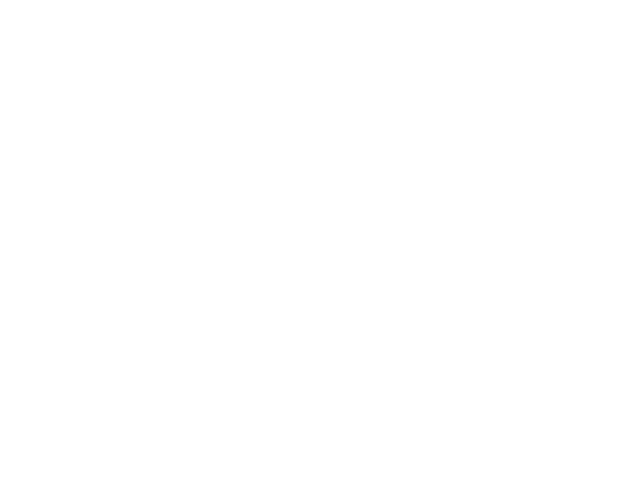

Chosen 95057
Predict is run


<IPython.core.display.Javascript object>


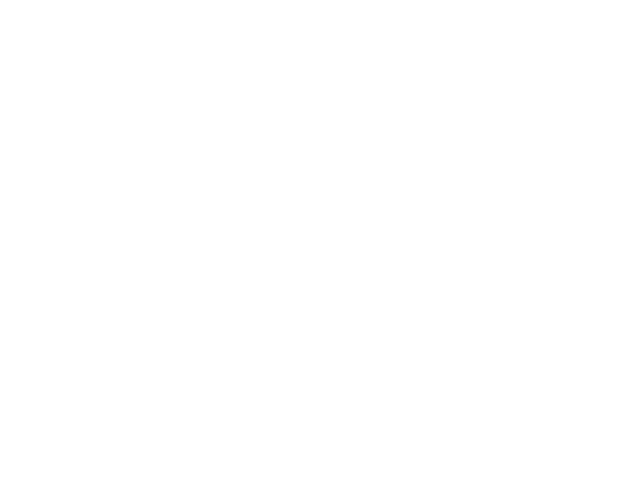

Sensor 95057
Errors:  2  ( 0.00512820512821 )
BIC - raw: 5885.96942403  BIC - clean: 1693.91083085


<IPython.core.display.Javascript object>


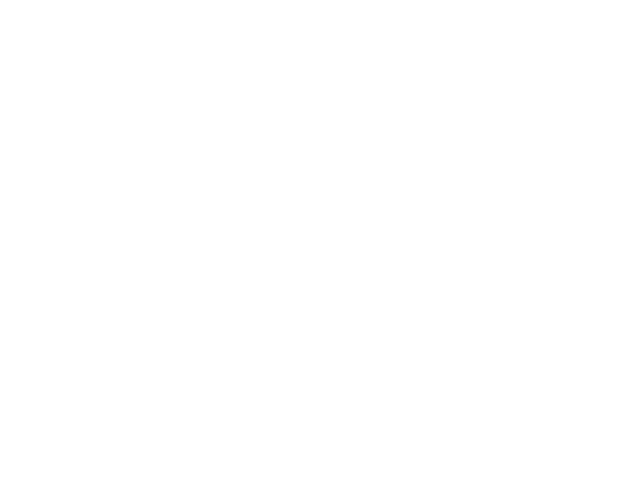

Chosen 95059
Predict is run


<IPython.core.display.Javascript object>


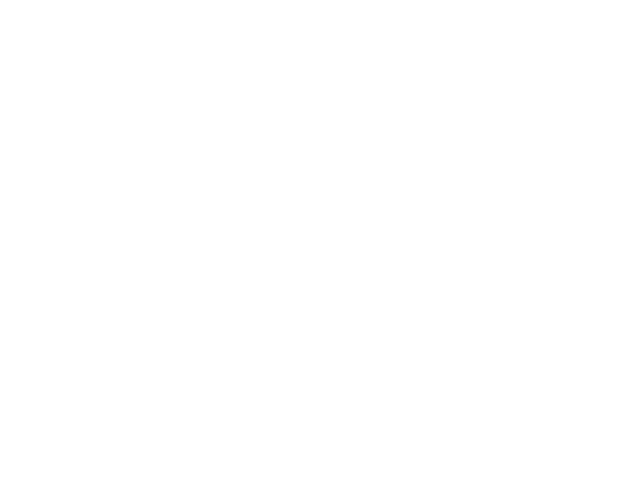

Sensor 95059
Errors:  53  ( 0.441666666667 )
BIC - raw: 216.814893765  BIC - clean: 200.663373245


<IPython.core.display.Javascript object>


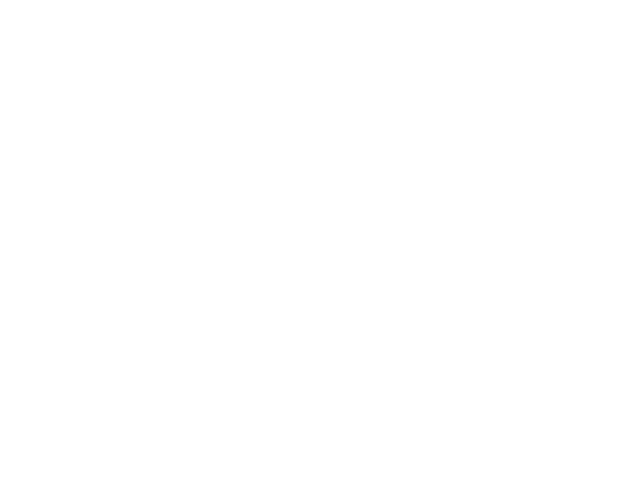

Chosen 95058
Predict is run


<IPython.core.display.Javascript object>


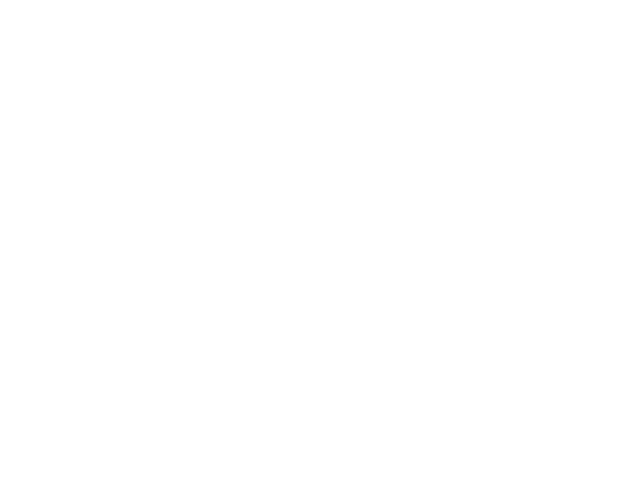

Sensor 95058
Errors:  48  ( 0.403361344538 )
BIC - raw: 183.456111863  BIC - clean: 171.427433954


<IPython.core.display.Javascript object>


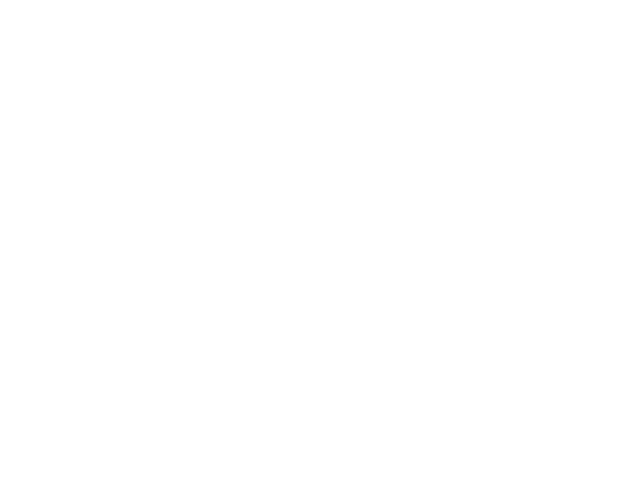

Chosen 95055
Predict is run


<IPython.core.display.Javascript object>


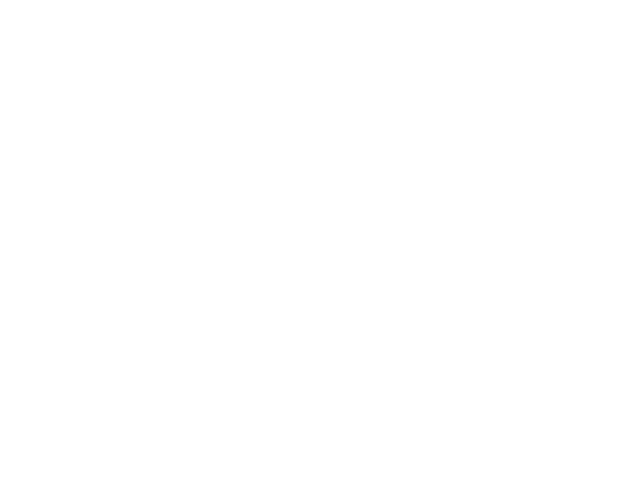

Sensor 95055
Errors:  4  ( 0.000376010528295 )
BIC - raw: 134595.551995  BIC - clean: -7260.53279903


<IPython.core.display.Javascript object>


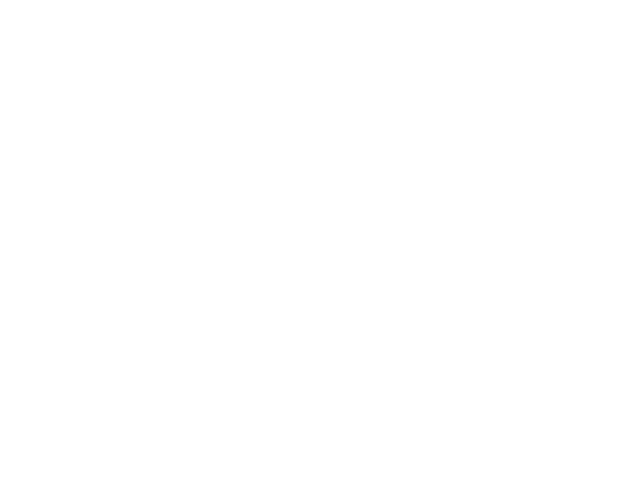

Chosen 95105
Predict is run


<IPython.core.display.Javascript object>


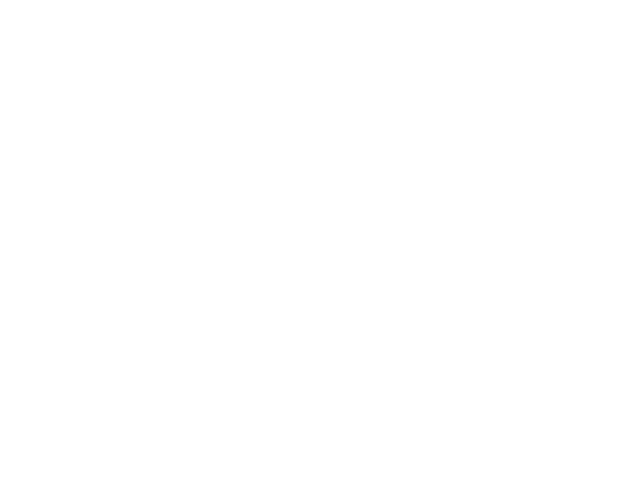

Sensor 95105
Errors:  2  ( 0.00167224080268 )
BIC - raw: 17478.4193411  BIC - clean: 2065.051846


<IPython.core.display.Javascript object>


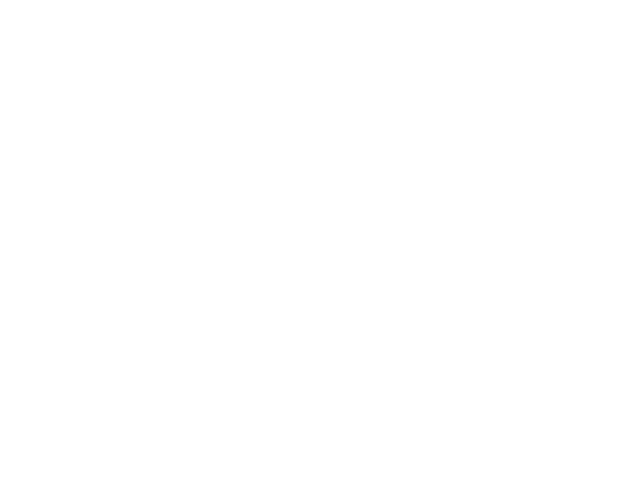

Chosen 95005
Predict is run


<IPython.core.display.Javascript object>


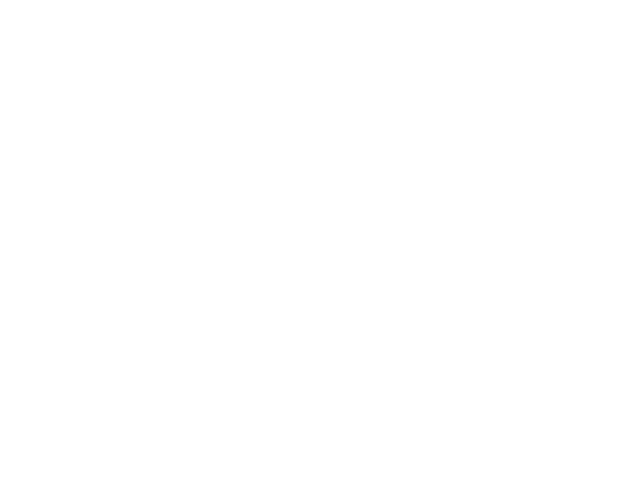

Sensor 95005
Errors:  1392  ( 0.187399030695 )
BIC - raw: 537.560999856  BIC - clean: 3656.78588244


<IPython.core.display.Javascript object>


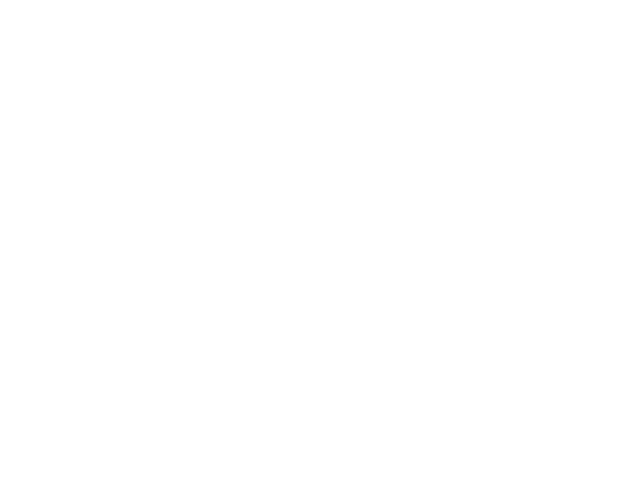

Chosen 95050
Predict is run


<IPython.core.display.Javascript object>


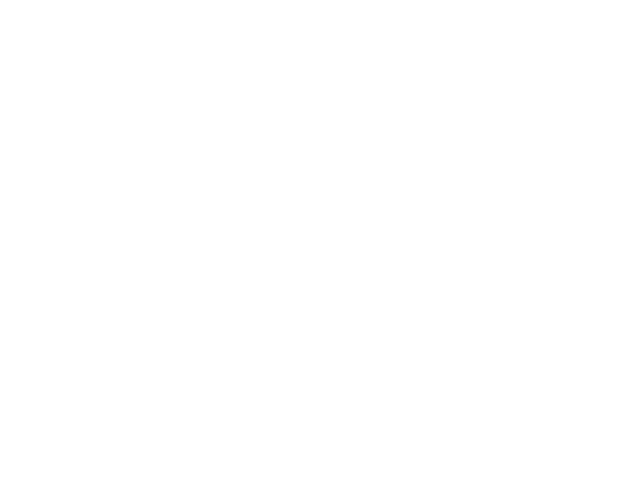

Sensor 95050
Errors:  97  ( 0.0368261199696 )
BIC - raw: 41831.437097  BIC - clean: 40949.1128138


<IPython.core.display.Javascript object>


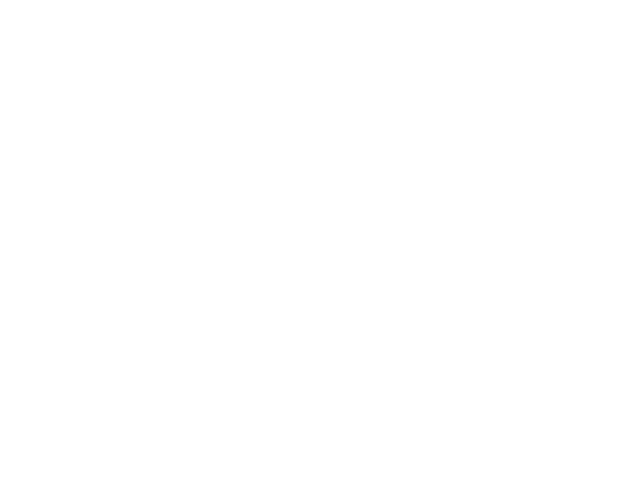

Chosen 95037
Predict is run


<IPython.core.display.Javascript object>


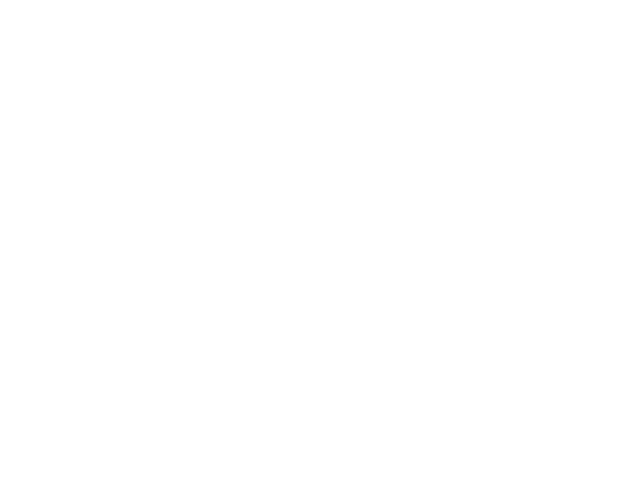

Sensor 95037
Errors:  58  ( 0.483333333333 )
BIC - raw: 223.224804465  BIC - clean: 245.065071707


<IPython.core.display.Javascript object>


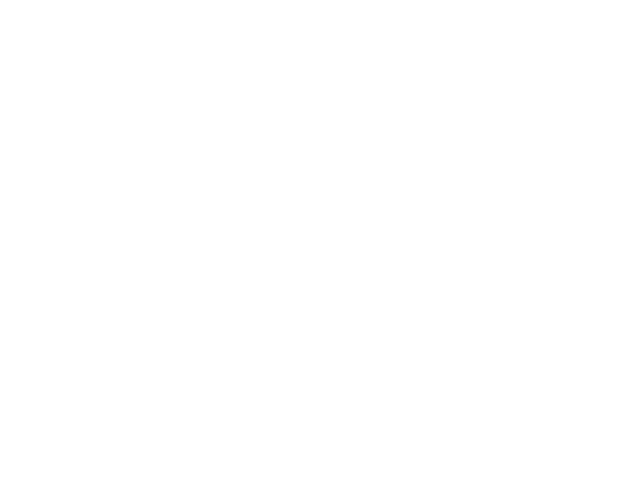

Chosen 95007
Predict is run


<IPython.core.display.Javascript object>


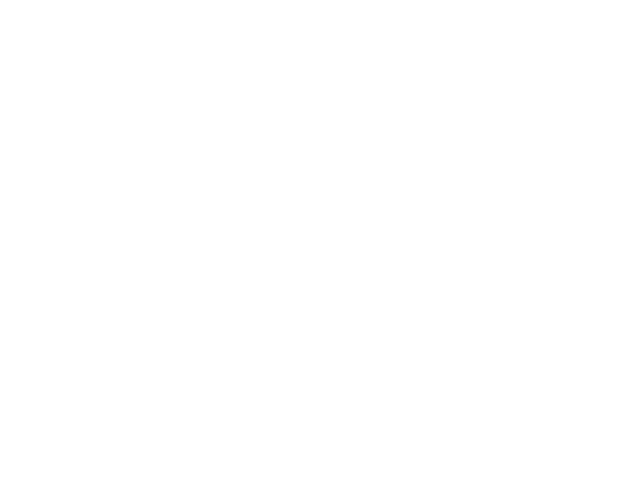

Sensor 95007
Errors:  41  ( 0.347457627119 )
BIC - raw: 102.321180581  BIC - clean: 148.987393591


<IPython.core.display.Javascript object>


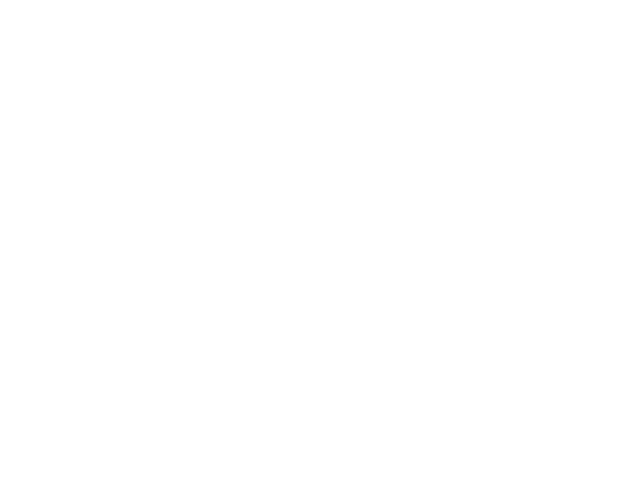

Chosen 95103
Predict is run


<IPython.core.display.Javascript object>


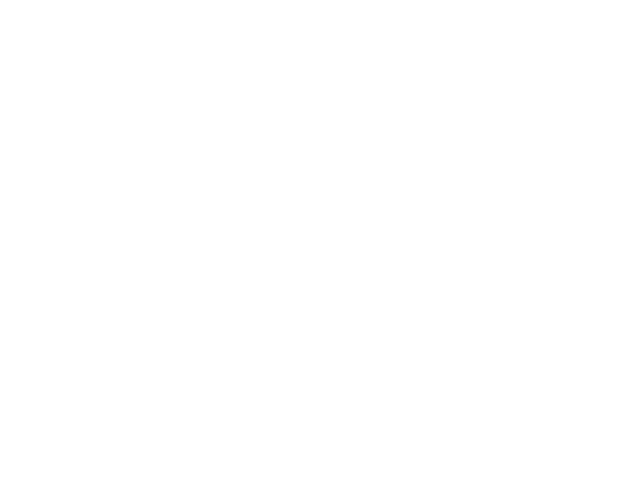

Sensor 95103
Errors:  525  ( 0.42270531401 )
BIC - raw: 1787.10564237  BIC - clean: 2316.4771734


<IPython.core.display.Javascript object>


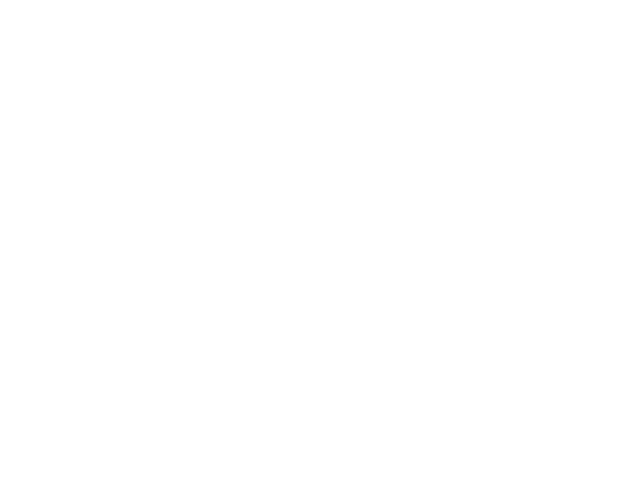

Chosen 95072
Predict is run


<IPython.core.display.Javascript object>


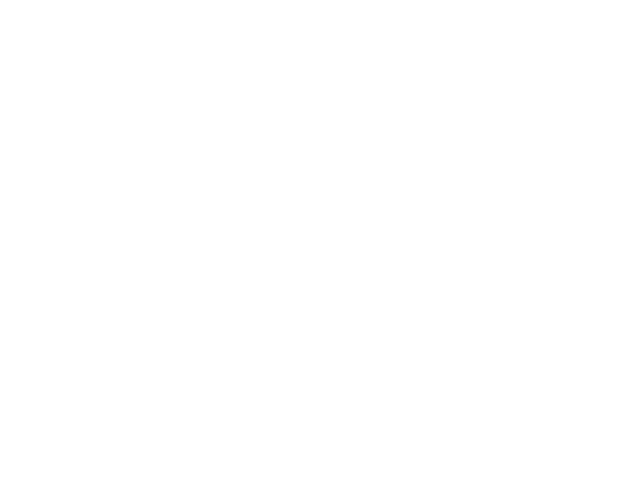

Sensor 95072
Errors:  63  ( 0.525 )
BIC - raw: 277.666982461  BIC - clean: 339.539244939


<IPython.core.display.Javascript object>


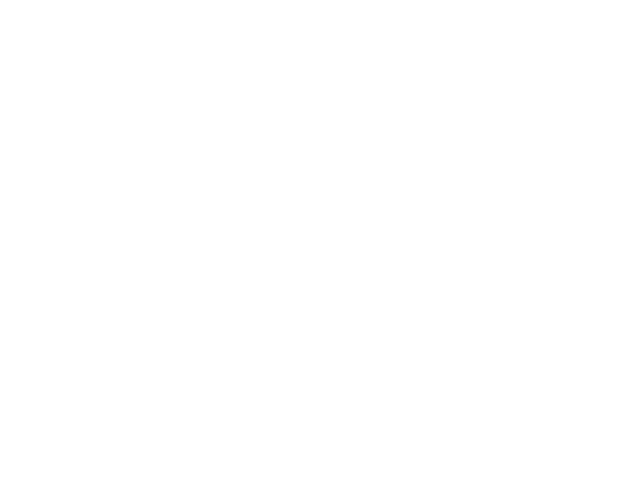

Chosen 60050
Predict is run


<IPython.core.display.Javascript object>


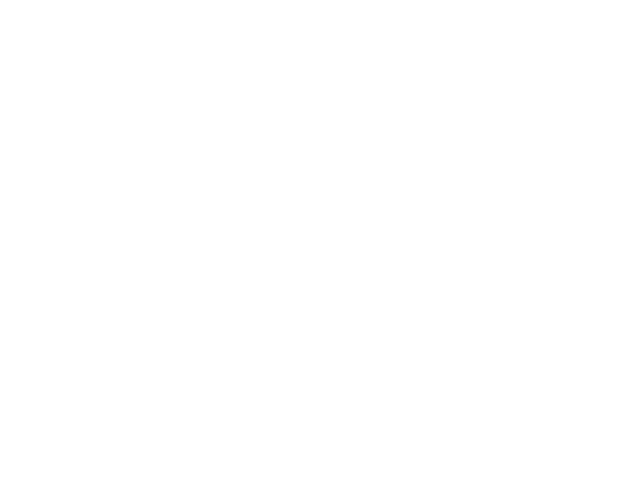

Sensor 60050
Errors:  1047  ( 0.139823717949 )
BIC - raw: -3701.53403797  BIC - clean: -860.19877625


<IPython.core.display.Javascript object>


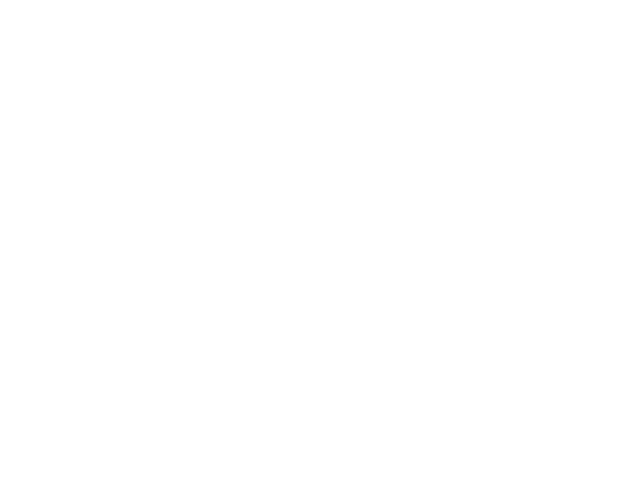

Chosen 73021
Predict is run


<IPython.core.display.Javascript object>


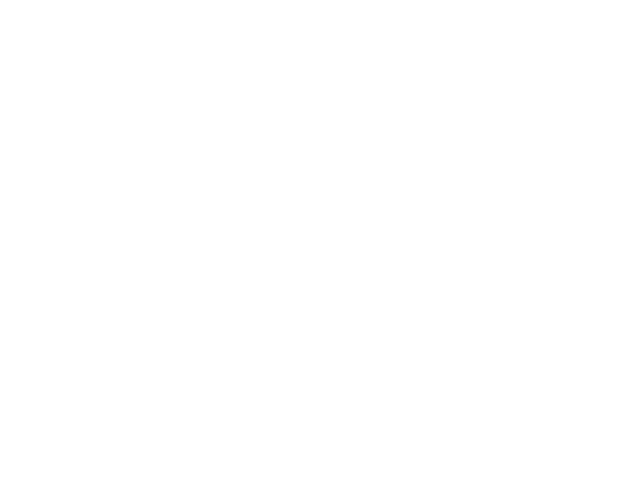

Sensor 73021
Errors:  5  ( 0.00457038391225 )
BIC - raw: -6537.70953843  BIC - clean: -6537.70953843


<IPython.core.display.Javascript object>


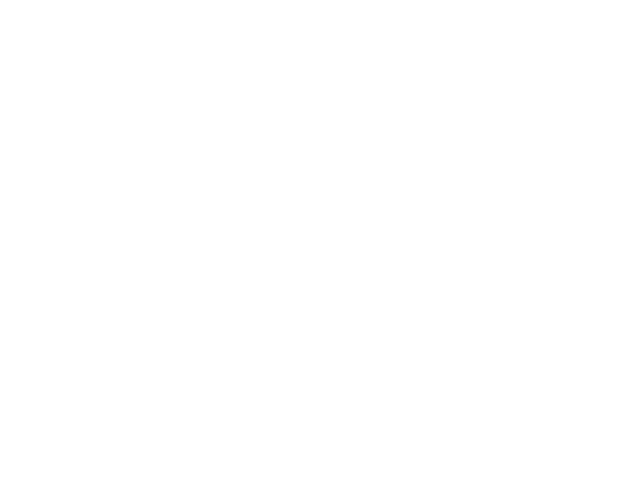

Chosen 30032
Predict is run


<IPython.core.display.Javascript object>


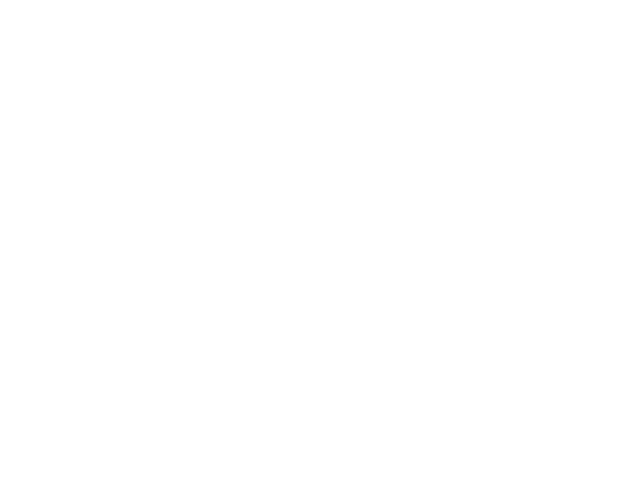

Sensor 30032
Errors:  14  ( 0.0154355016538 )
BIC - raw: -2982.10515754  BIC - clean: -3279.54869905


<IPython.core.display.Javascript object>


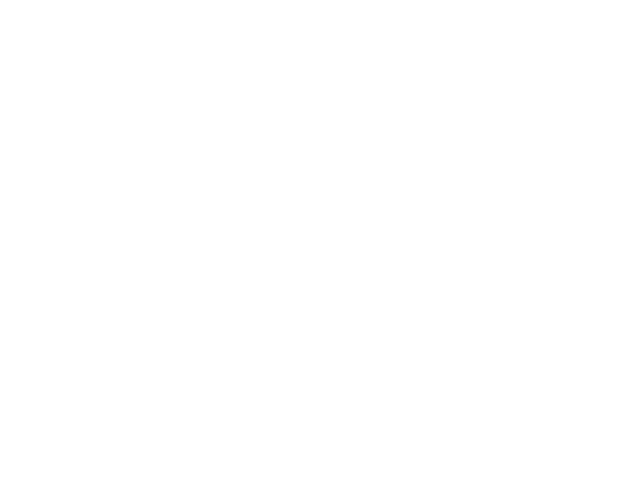

Chosen 30010
Predict is run


<IPython.core.display.Javascript object>


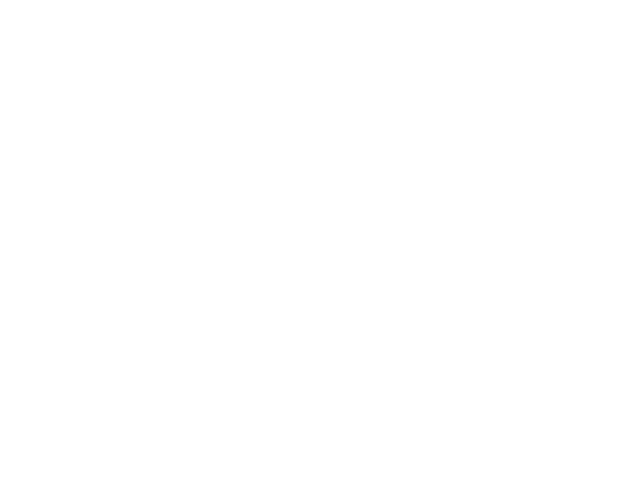

Sensor 30010
Errors:  1368  ( 0.222620016273 )
BIC - raw: -750.858010147  BIC - clean: 2058.4460606


<IPython.core.display.Javascript object>


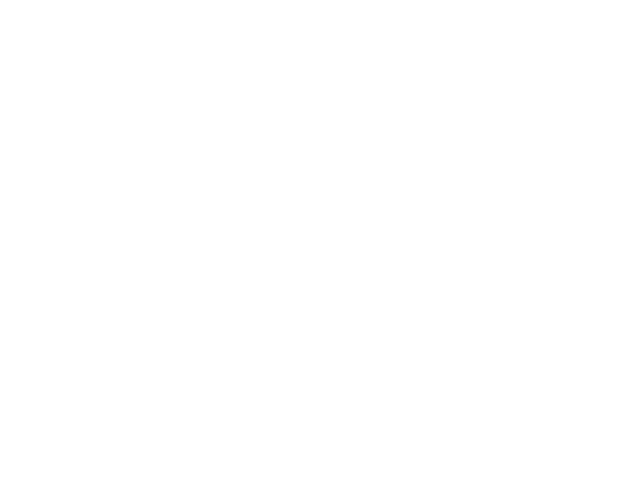

Chosen 60101
Predict is run


<IPython.core.display.Javascript object>


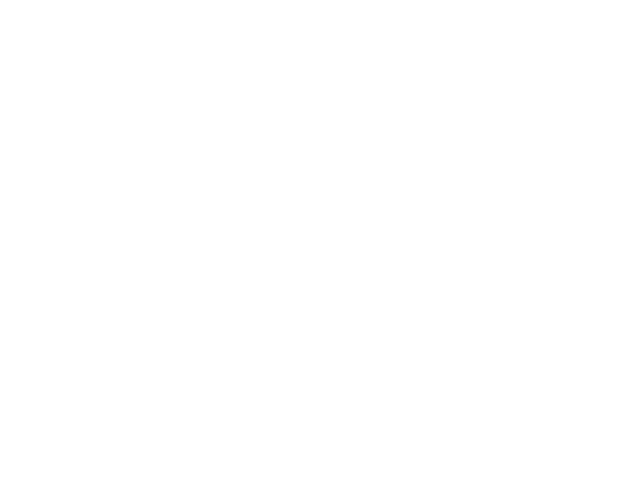

Sensor 60101
Errors:  7  ( 0.0316742081448 )
BIC - raw: -556.054806493  BIC - clean: -588.536115738


<IPython.core.display.Javascript object>


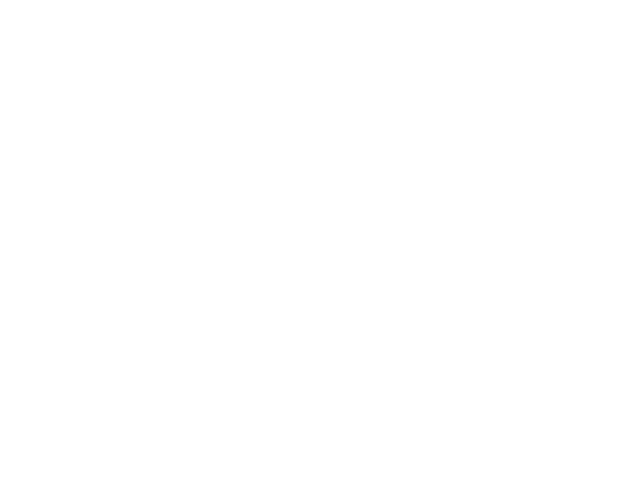

Chosen 30102
Predict is run


<IPython.core.display.Javascript object>


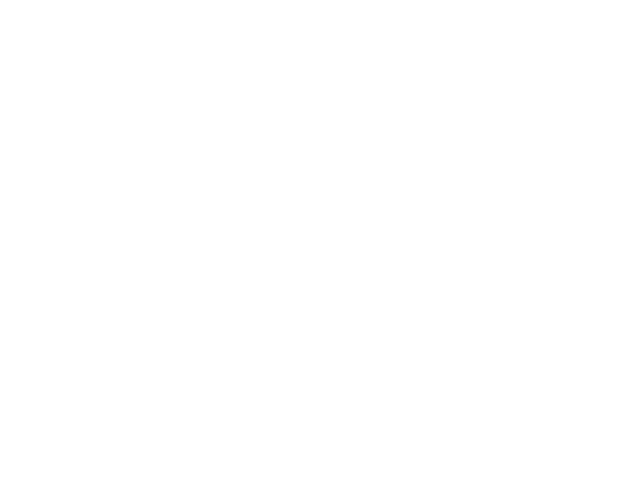

Sensor 30102
Errors:  84  ( 0.041257367387 )
BIC - raw: 32744.4597754  BIC - clean: 32724.8357488


<IPython.core.display.Javascript object>


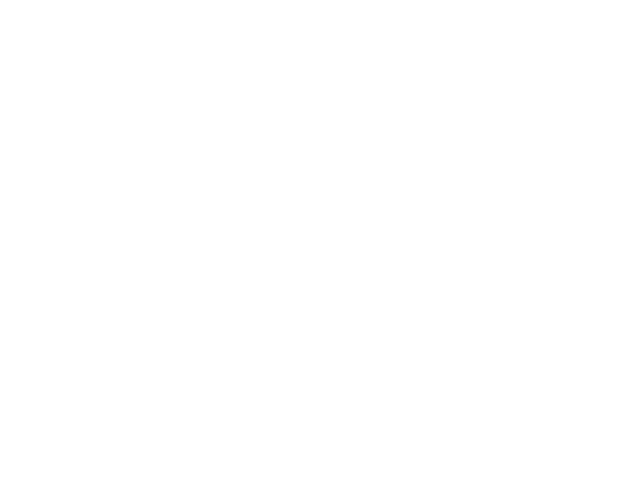

Chosen 30192
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30055
Predict is run


<IPython.core.display.Javascript object>


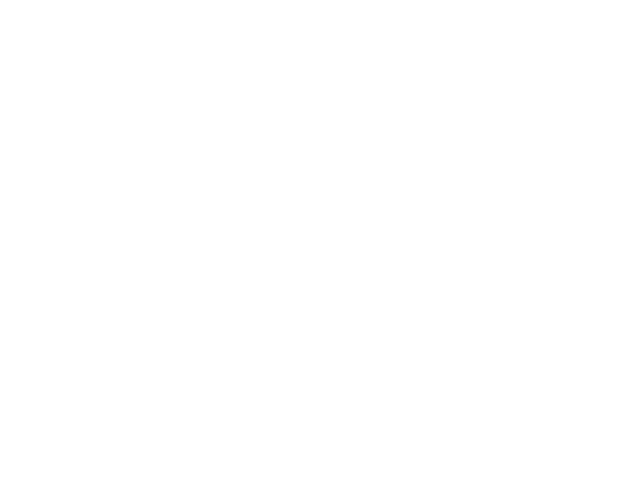

Sensor 30055
Errors:  123  ( 0.561643835616 )
BIC - raw: 719.935977204  BIC - clean: 707.759853941


<IPython.core.display.Javascript object>


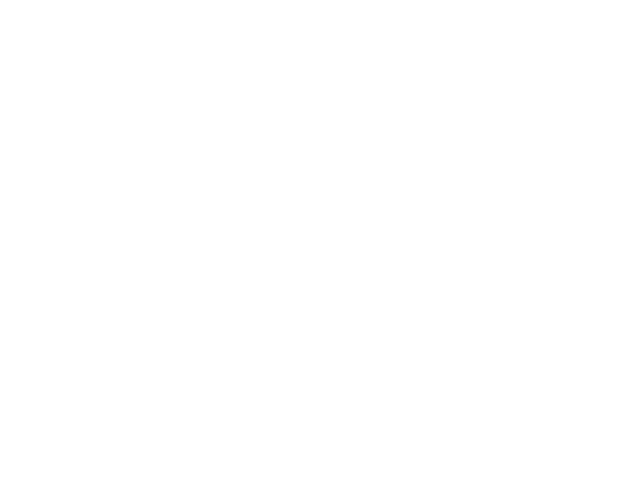

Chosen 95071
Predict is run


<IPython.core.display.Javascript object>


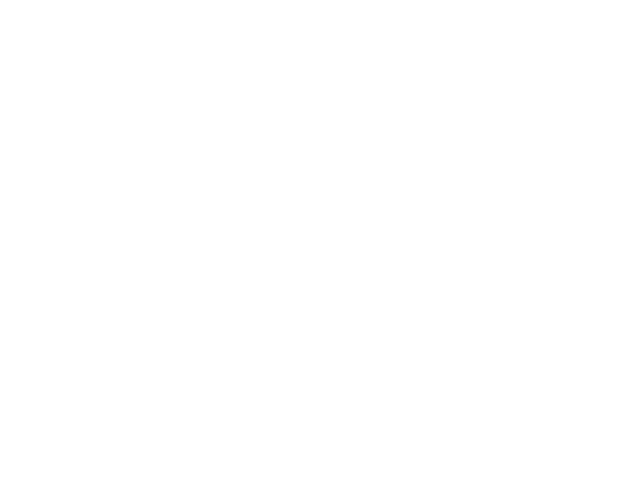

Sensor 95071
Errors:  70  ( 0.583333333333 )
BIC - raw: 415.072279644  BIC - clean: 447.466418244


<IPython.core.display.Javascript object>


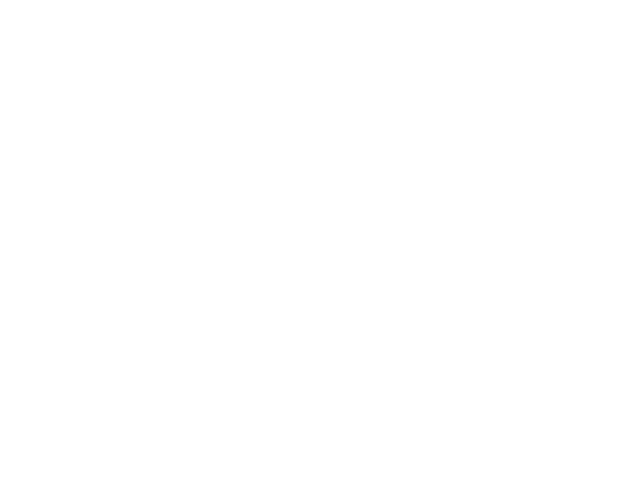

Chosen 30189
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30187
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30036
Predict is run


<IPython.core.display.Javascript object>


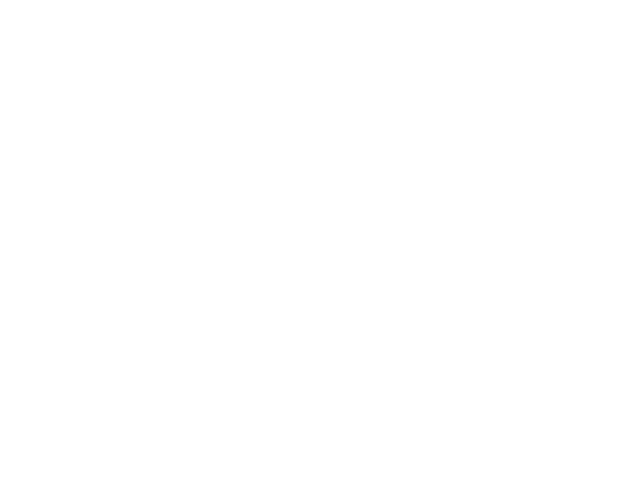

Sensor 30036
Errors:  7  ( 0.0642201834862 )
BIC - raw: 17.6942099866  BIC - clean: -23.8472096212


<IPython.core.display.Javascript object>


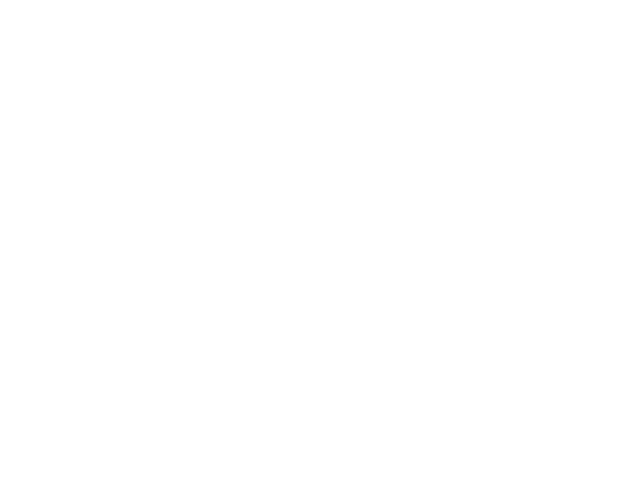

Chosen 30190
Predict is run


<IPython.core.display.Javascript object>


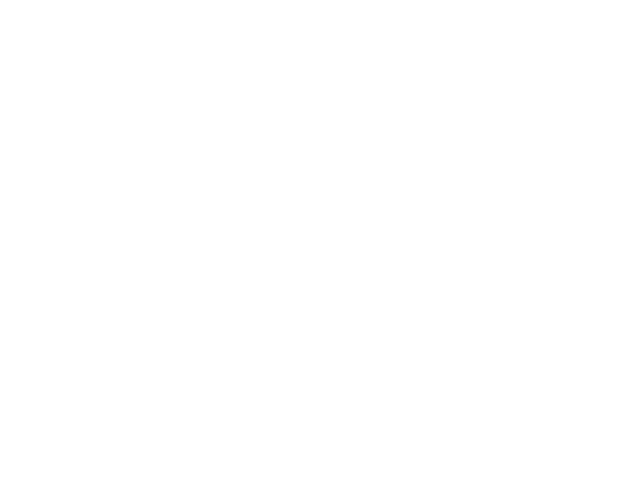

Sensor 30190
Errors:  17  ( 0.161904761905 )
BIC - raw: 82.1977094114  BIC - clean: 56.5501723597


<IPython.core.display.Javascript object>


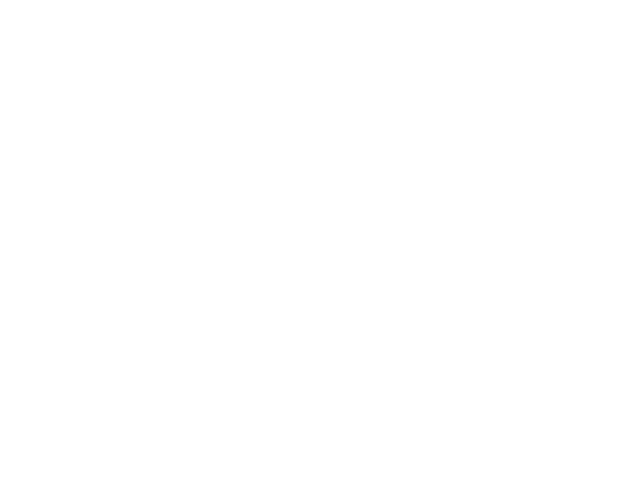

Chosen 30020
Predict is run


<IPython.core.display.Javascript object>


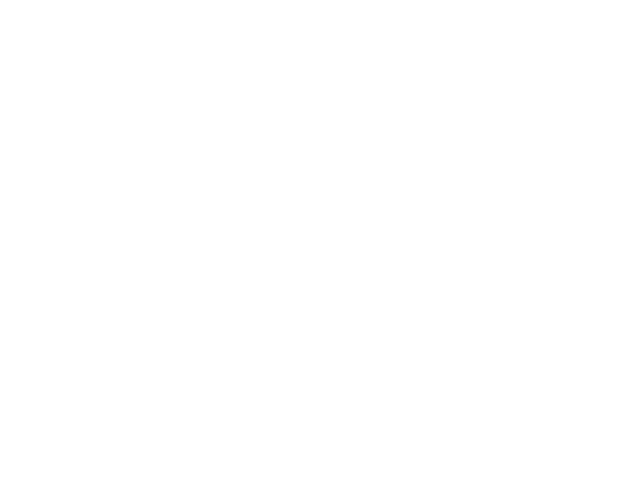

Sensor 30020
Errors:  13  ( 0.0722222222222 )
BIC - raw: -1.95389032495  BIC - clean: -7.70957192959


<IPython.core.display.Javascript object>


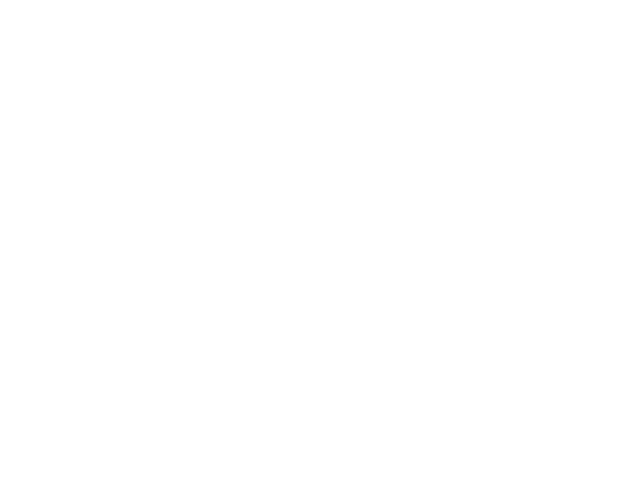

Chosen 30101
Predict is run


<IPython.core.display.Javascript object>


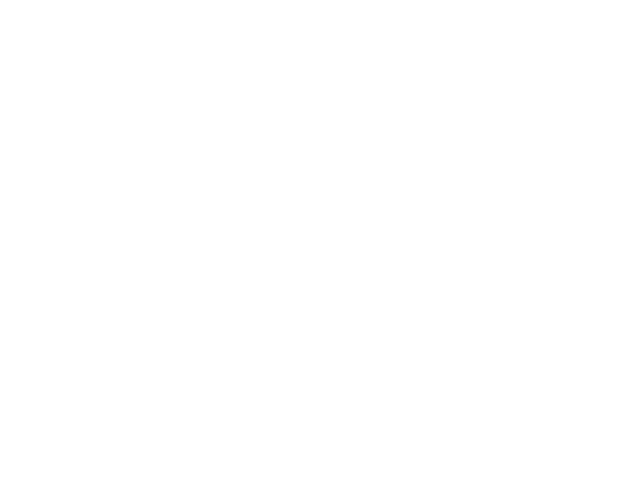

Sensor 30101
Errors:  191  ( 0.112352941176 )
BIC - raw: 583.962480384  BIC - clean: 337.956281124


<IPython.core.display.Javascript object>


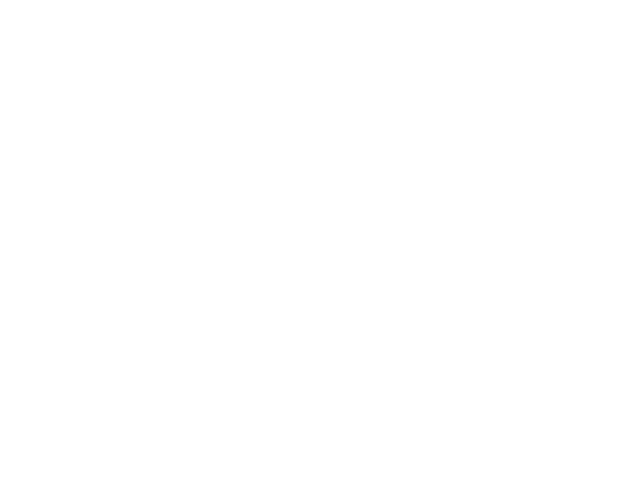

Chosen 30103
Predict is run


<IPython.core.display.Javascript object>


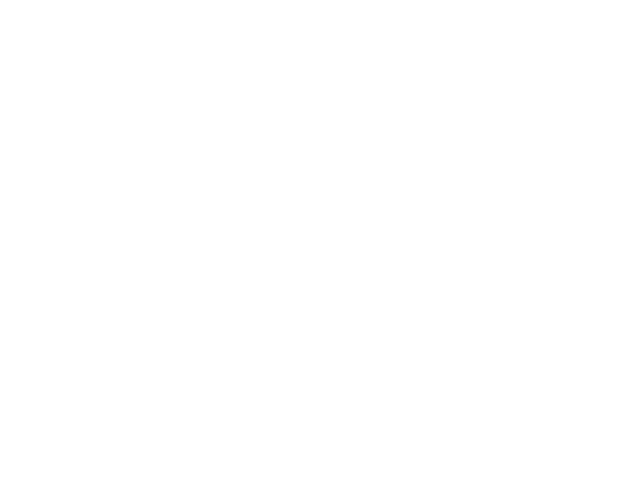

Sensor 30103
Errors:  32  ( 0.666666666667 )
BIC - raw: 125.53860571  BIC - clean: 137.858244146


<IPython.core.display.Javascript object>


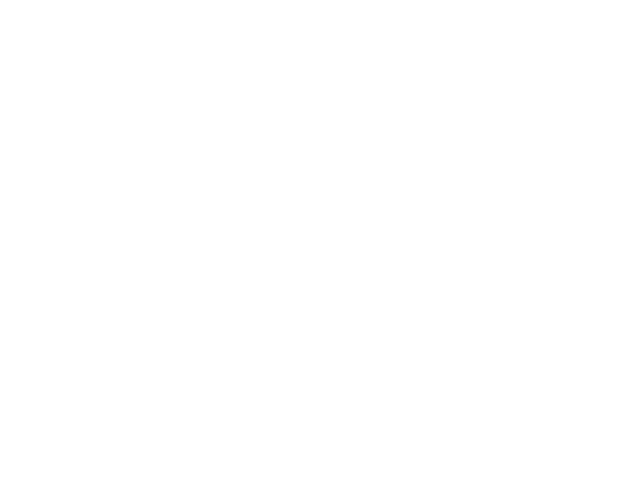

Chosen 30185
Predict is run


<IPython.core.display.Javascript object>


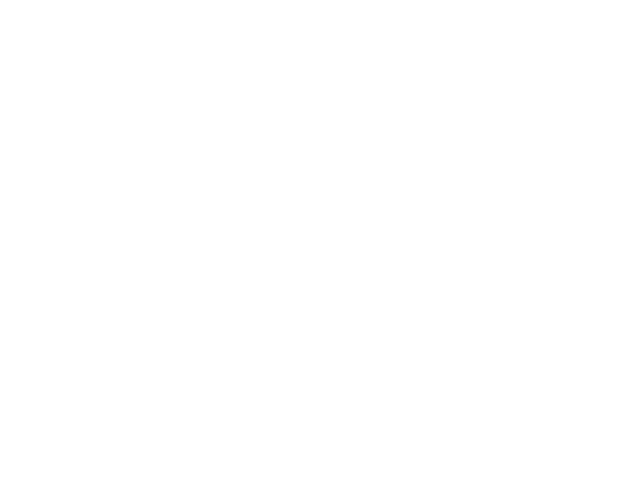

Sensor 30185
Errors:  80  ( 0.45197740113 )
BIC - raw: 1324.14728896  BIC - clean: 572.933571902


<IPython.core.display.Javascript object>


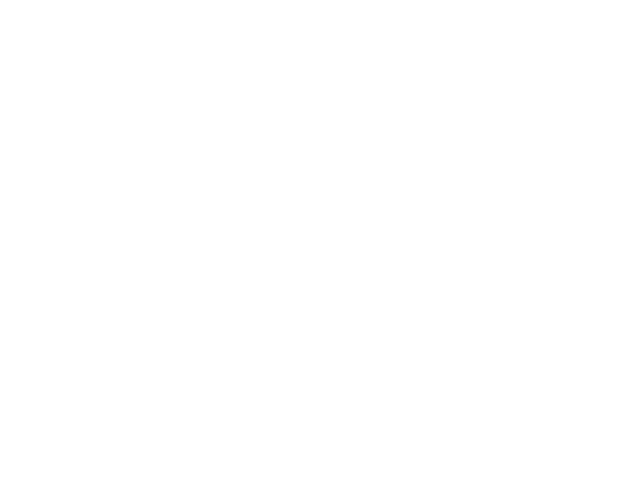

Chosen 30177
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30196
Predict is run


<IPython.core.display.Javascript object>


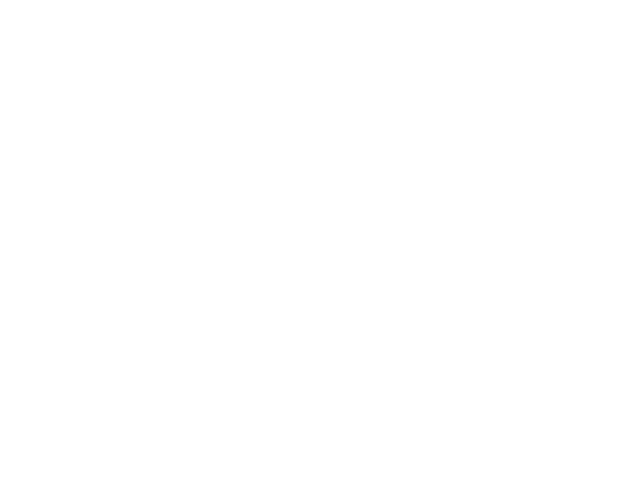

Sensor 30196
Errors:  20  ( 0.135135135135 )
BIC - raw: 40.0251720712  BIC - clean: -15.3199489432


<IPython.core.display.Javascript object>


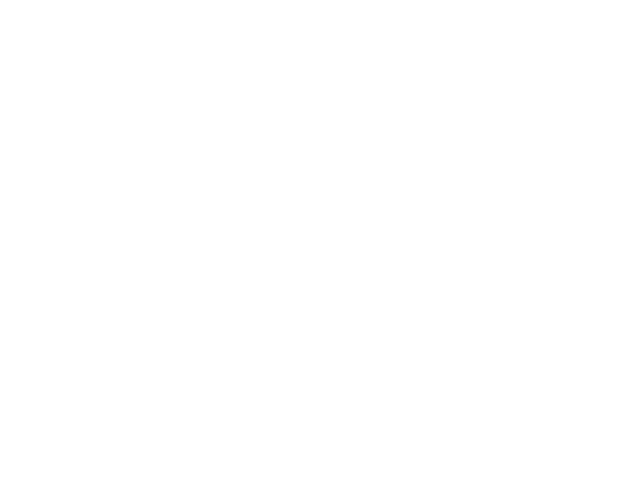

Chosen 30195
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30173
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30178
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30171
Predict is run


<IPython.core.display.Javascript object>


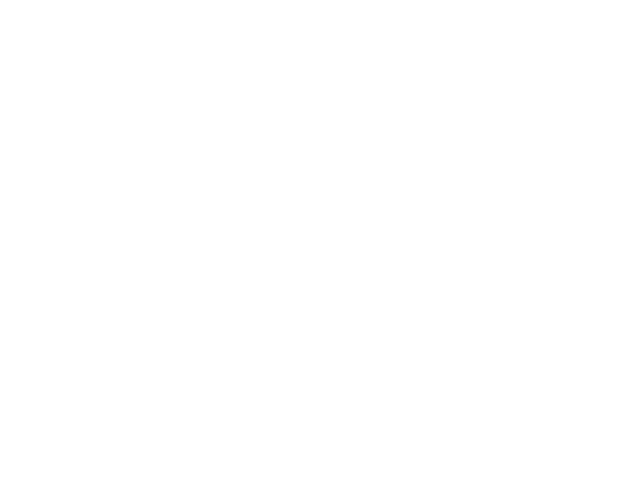

Sensor 30171
Errors:  4  ( 0.0325203252033 )
BIC - raw: -138.153196868  BIC - clean: -138.153196868


<IPython.core.display.Javascript object>


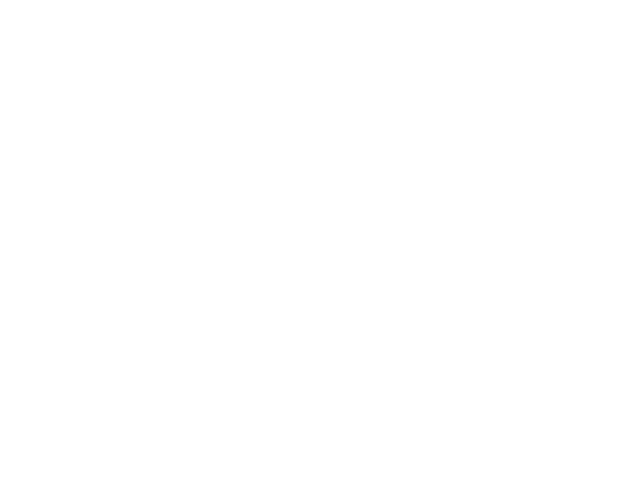

Chosen 95053
Predict is run


<IPython.core.display.Javascript object>


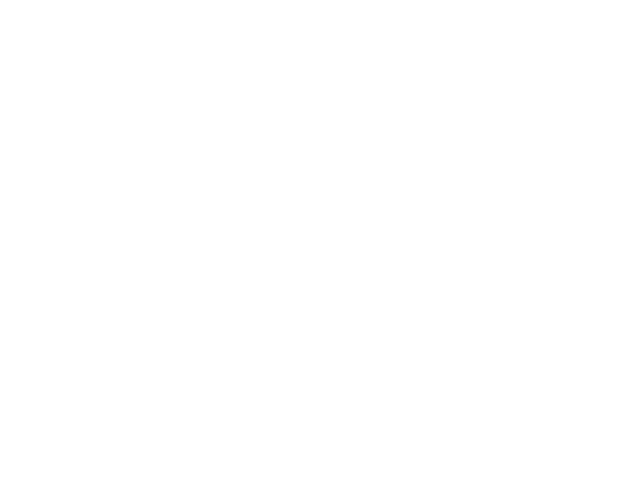

Sensor 95053
Errors:  52  ( 0.444444444444 )
BIC - raw: 157.7272007  BIC - clean: 236.972041115


<IPython.core.display.Javascript object>


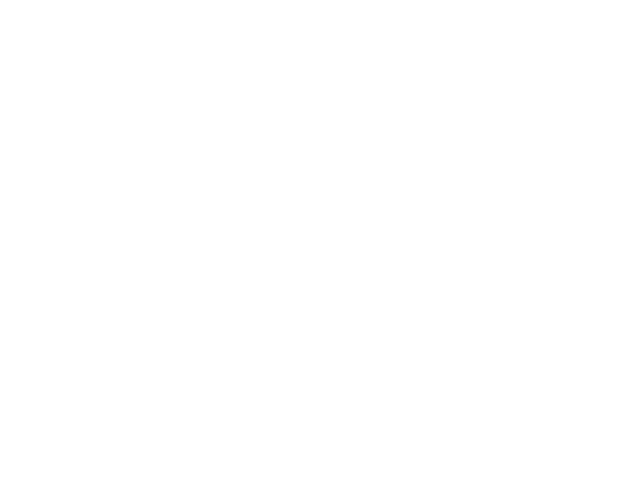

Chosen 30186
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30104
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30040
Predict is run


<IPython.core.display.Javascript object>


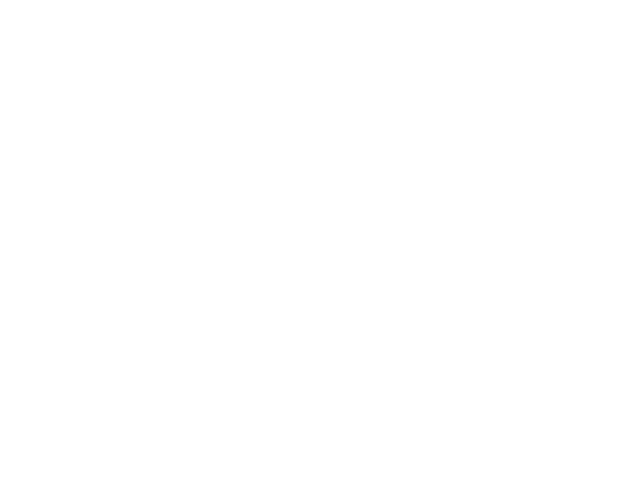

Sensor 30040
Errors:  1512  ( 0.194845360825 )
BIC - raw: 939.434414843  BIC - clean: 5332.54386747


<IPython.core.display.Javascript object>


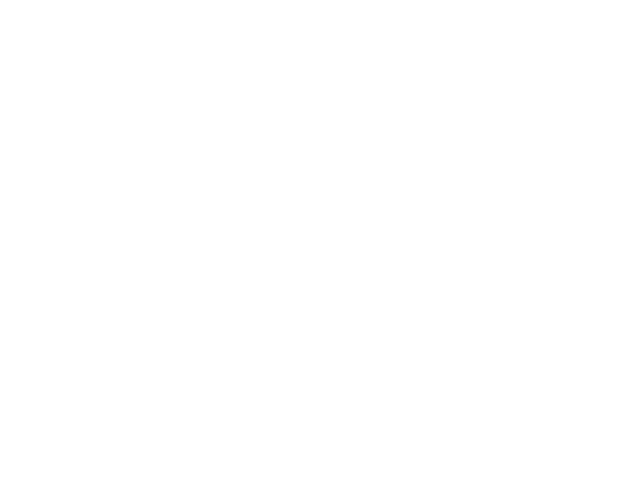

Chosen 30041
Predict is run


<IPython.core.display.Javascript object>


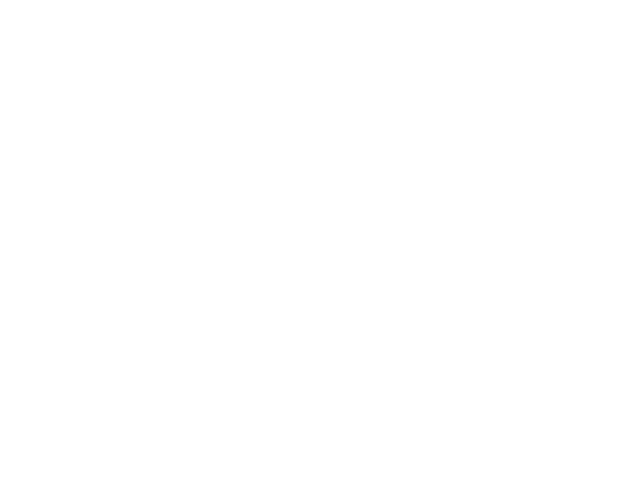

Sensor 30041
Errors:  31  ( 0.172222222222 )
BIC - raw: 74.8183973511  BIC - clean: 48.3716459132


<IPython.core.display.Javascript object>


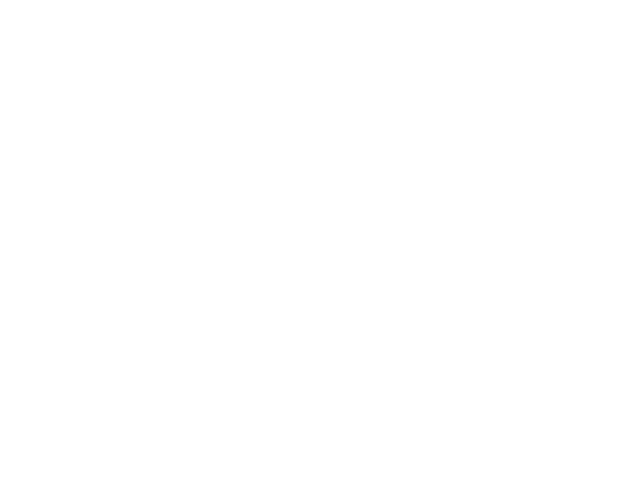

Chosen 80030
Predict is run


<IPython.core.display.Javascript object>


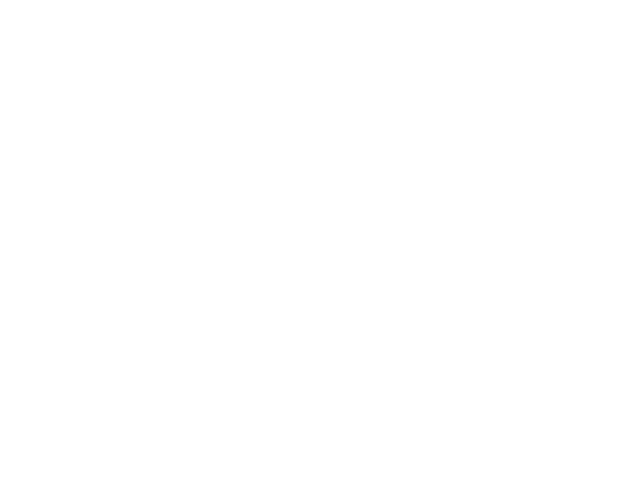

Sensor 80030
Errors:  286  ( 0.0283673874231 )
BIC - raw: -7749.44359446  BIC - clean: -11862.5496003


<IPython.core.display.Javascript object>


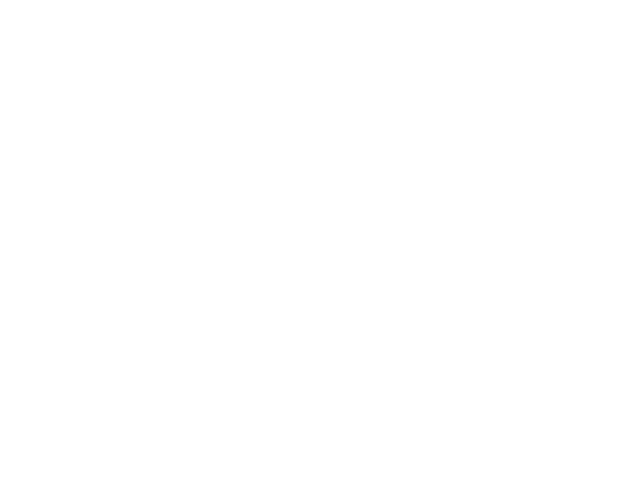

Chosen 30175
Predict is run


<IPython.core.display.Javascript object>


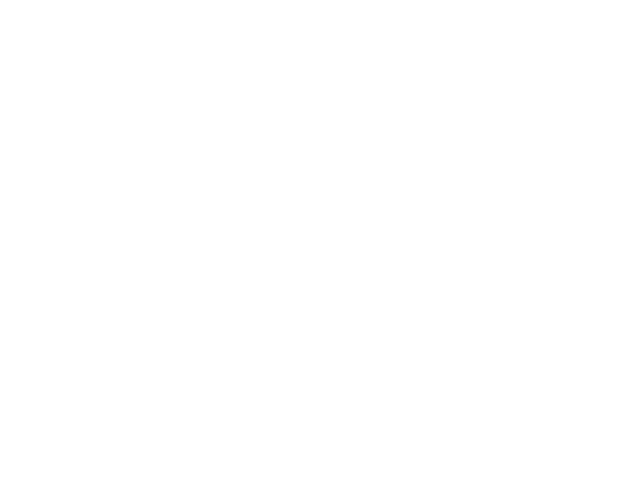

Sensor 30175
Errors:  4  ( 0.043956043956 )
BIC - raw: -287.887616721  BIC - clean: -287.887616721


<IPython.core.display.Javascript object>


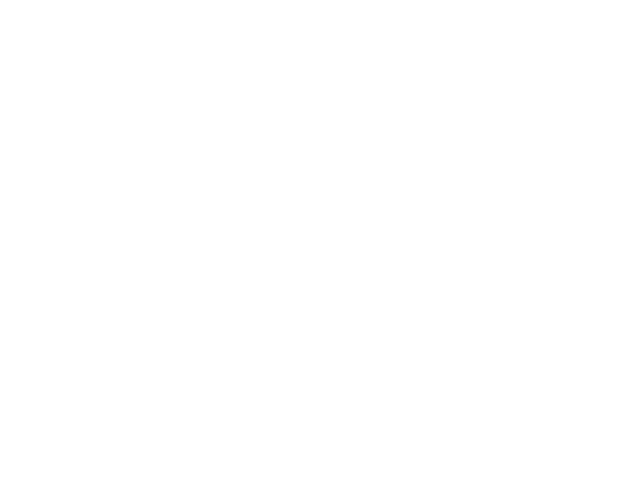

Chosen 80080
Predict is run


<IPython.core.display.Javascript object>


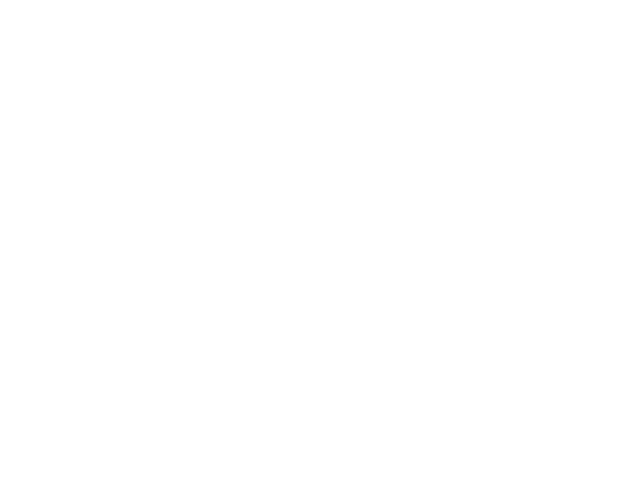

Sensor 80080
Errors:  399  ( 0.0340327533265 )
BIC - raw: -29635.9959175  BIC - clean: -26918.7169561


<IPython.core.display.Javascript object>


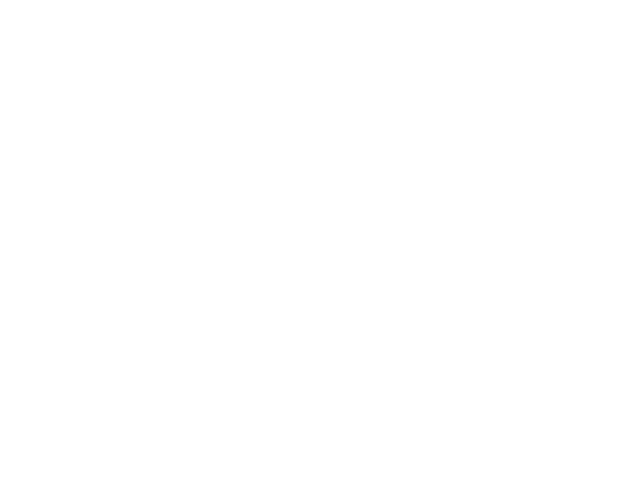

Chosen 80055
Predict is run


<IPython.core.display.Javascript object>


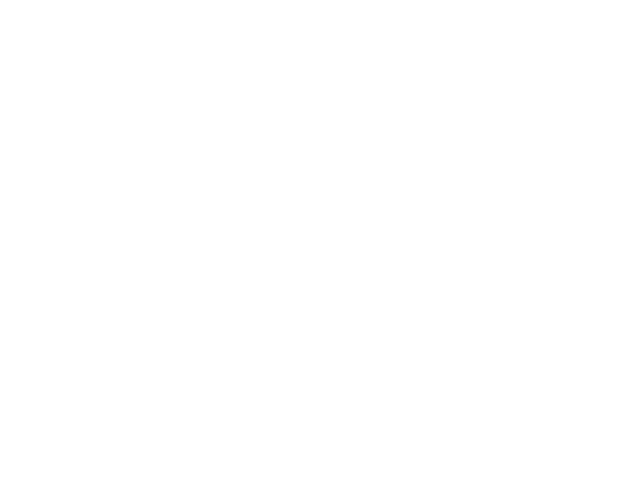

Sensor 80055
Errors:  252  ( 0.0243878834801 )
BIC - raw: -14463.1712278  BIC - clean: -7412.76186203


<IPython.core.display.Javascript object>


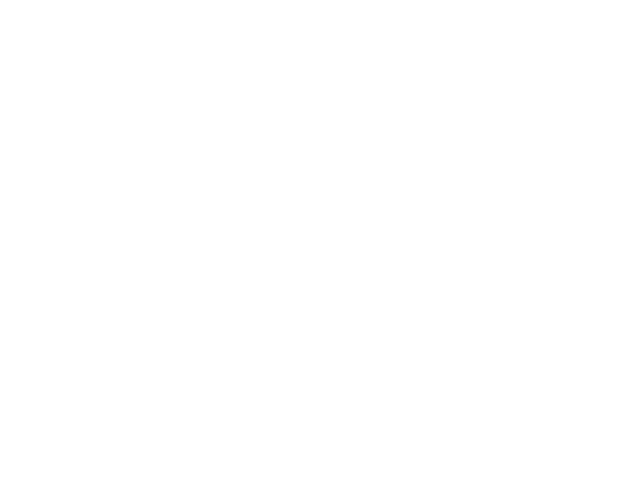

Chosen 80073
Predict is run


<IPython.core.display.Javascript object>


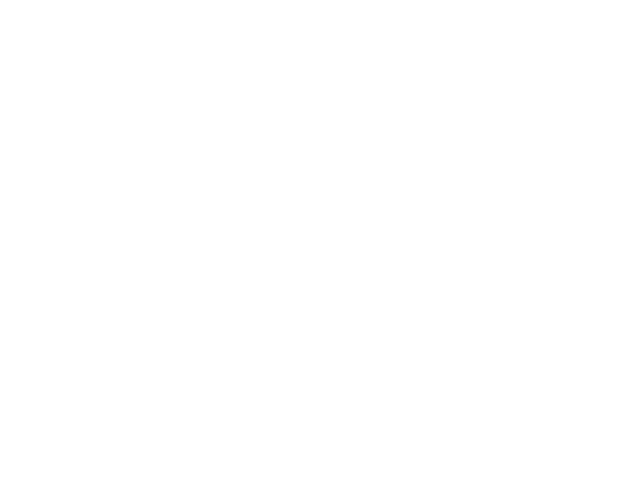

Sensor 80073
Errors:  6  ( 0.00547445255474 )
BIC - raw: -5865.69428151  BIC - clean: -5009.4367776


<IPython.core.display.Javascript object>


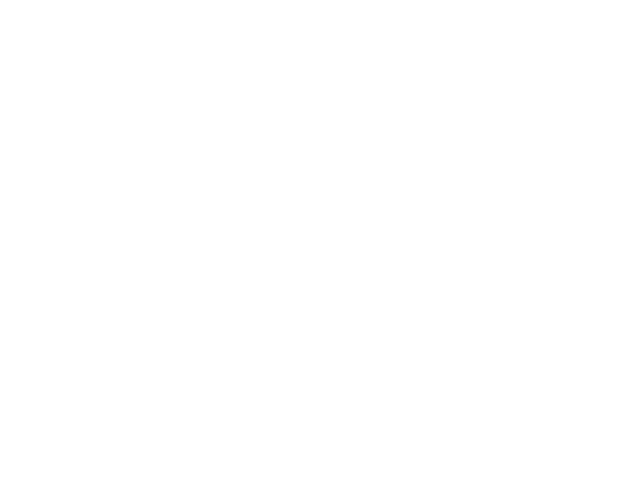

Chosen 80069
Predict is run


<IPython.core.display.Javascript object>


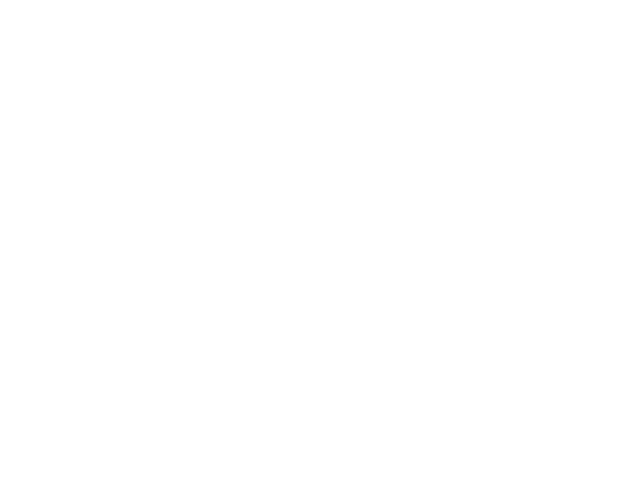

Sensor 80069
Errors:  5  ( 0.0480769230769 )
BIC - raw: -103.76095924  BIC - clean: -103.76095924


<IPython.core.display.Javascript object>


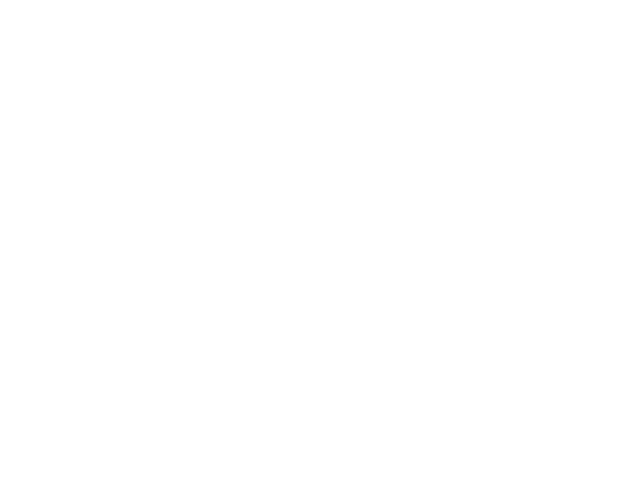

Chosen 80075
Predict is run


<IPython.core.display.Javascript object>


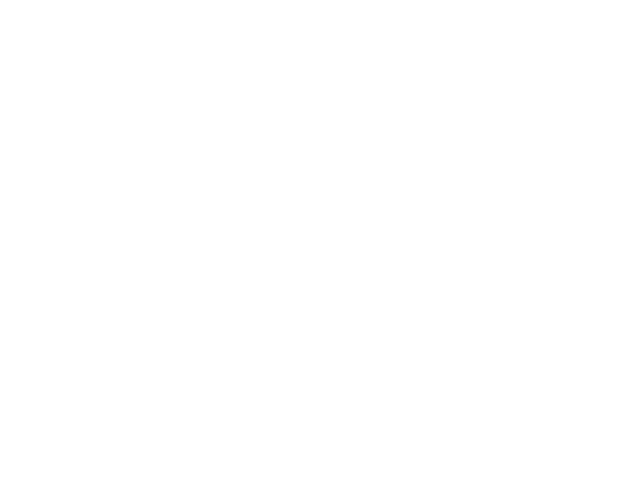

Sensor 80075
Errors:  176  ( 0.018204385602 )
BIC - raw: -26495.1100355  BIC - clean: -21720.7974751


<IPython.core.display.Javascript object>


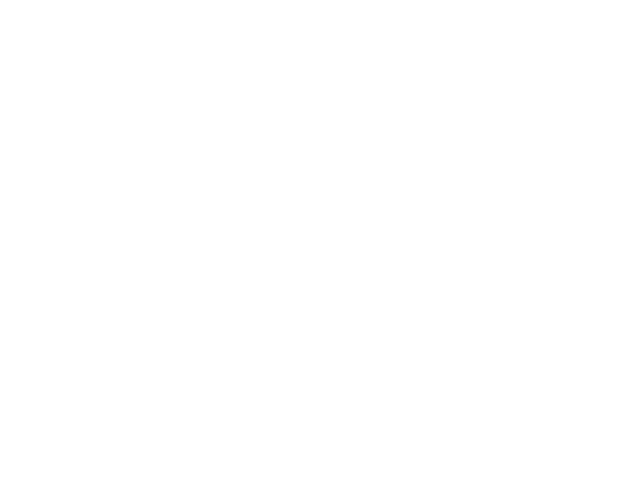

Chosen 80012
Predict is run


<IPython.core.display.Javascript object>


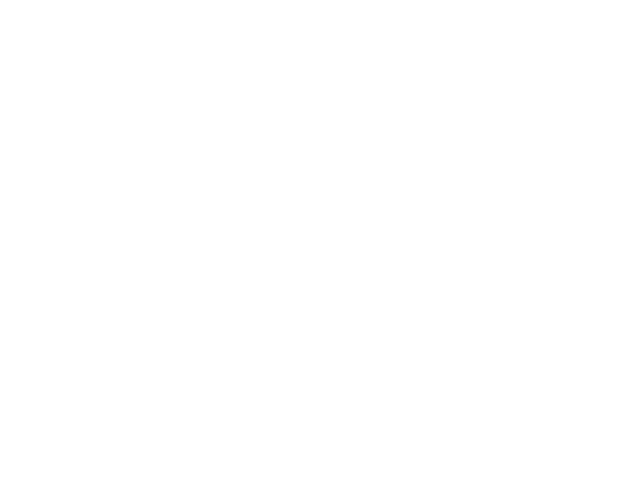

Sensor 80012
Errors:  6  ( 0.00633579725449 )
BIC - raw: -4304.49056528  BIC - clean: -3680.2702816


<IPython.core.display.Javascript object>


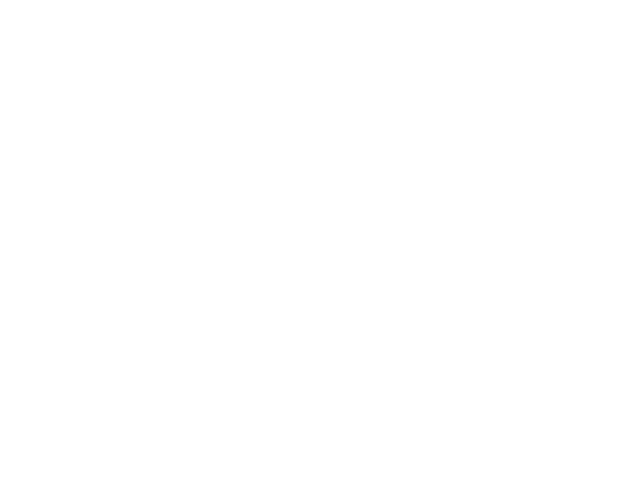

Chosen 80020
Predict is run


<IPython.core.display.Javascript object>


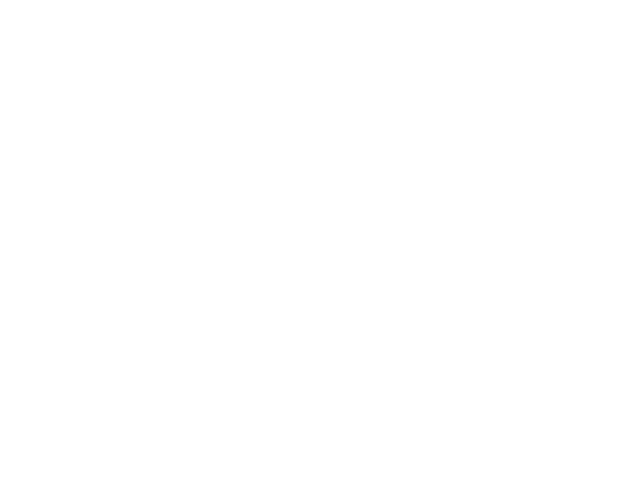

Sensor 80020
Errors:  1308  ( 0.078842676311 )
BIC - raw: -27104.7782934  BIC - clean: -13664.9316029


<IPython.core.display.Javascript object>


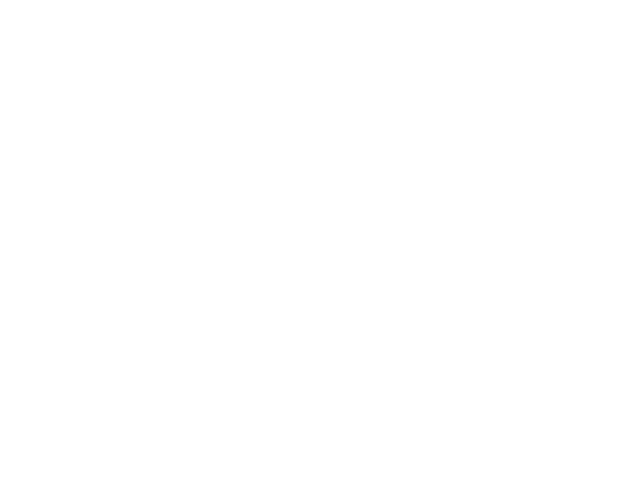

Chosen 72021
Predict is run


<IPython.core.display.Javascript object>


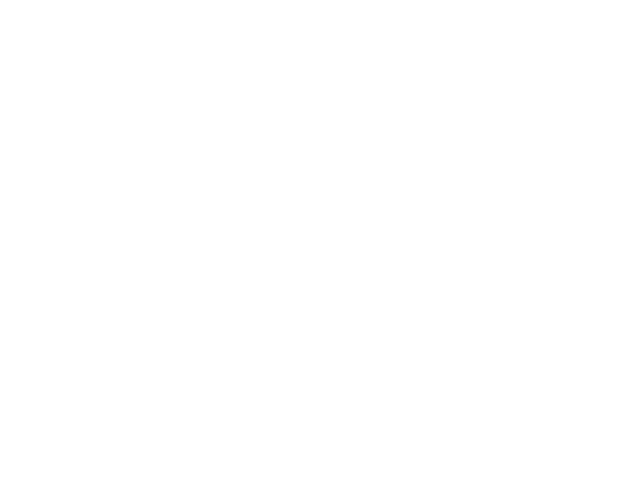

Sensor 72021
Errors:  5  ( 0.00456204379562 )
BIC - raw: -5982.97421098  BIC - clean: -5982.97421098


<IPython.core.display.Javascript object>


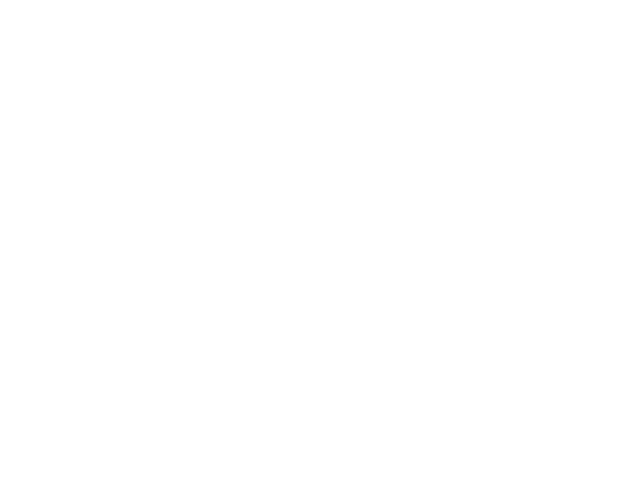

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 15049
Predict is run


<IPython.core.display.Javascript object>


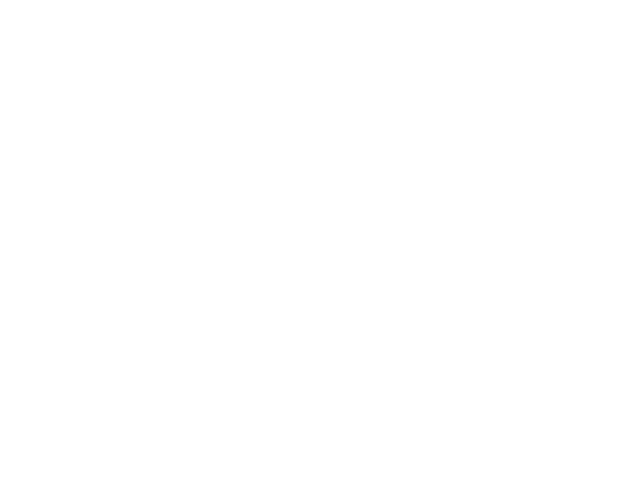

Sensor 15049
Errors:  32  ( 0.142222222222 )
BIC - raw: 2.84603226646  BIC - clean: 70.959661621


<IPython.core.display.Javascript object>


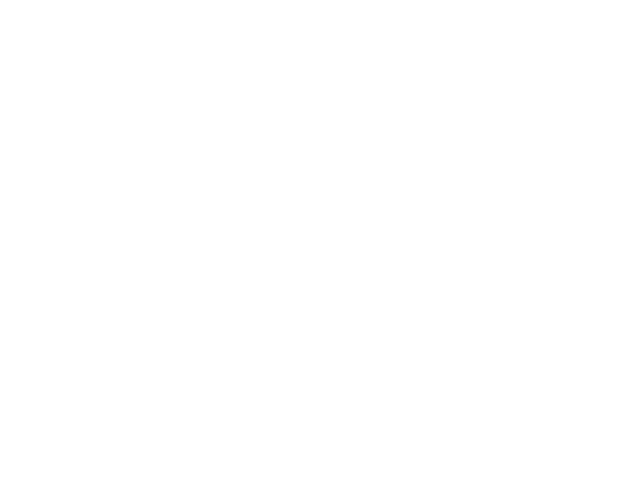

Chosen 15051
Predict is run


<IPython.core.display.Javascript object>


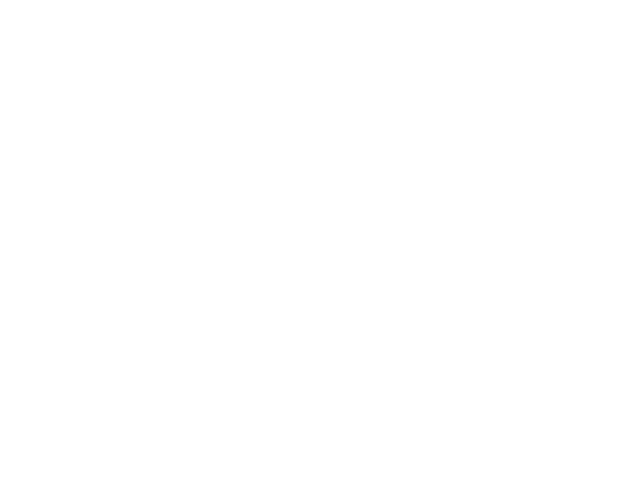

Sensor 15051
Errors:  33  ( 0.126436781609 )
BIC - raw: -84.1707305337  BIC - clean: -14.4431012155


<IPython.core.display.Javascript object>


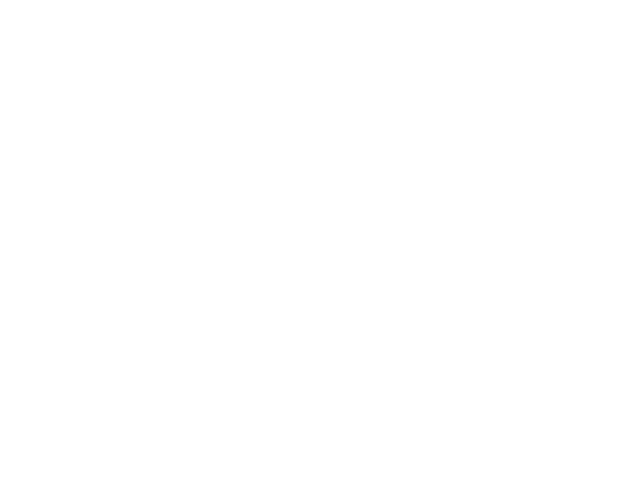

Chosen 15021
Predict is run


<IPython.core.display.Javascript object>


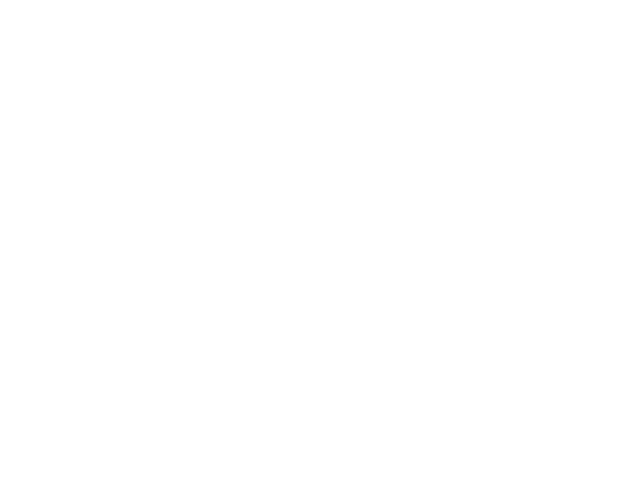

Sensor 15021
Errors:  5  ( 0.00741839762611 )
BIC - raw: -4294.71793996  BIC - clean: -4294.71793996


<IPython.core.display.Javascript object>


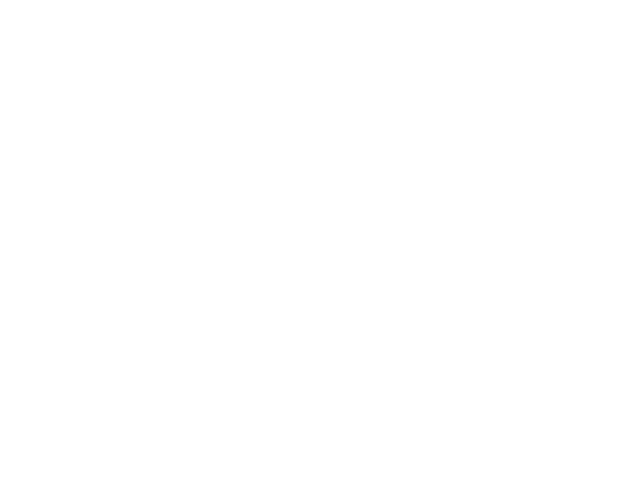

Chosen 15102
Predict is run


<IPython.core.display.Javascript object>


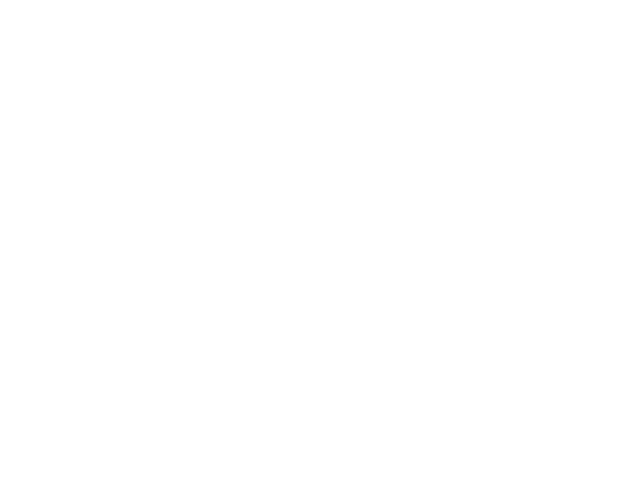

Sensor 15102
Errors:  33  ( 0.0208728652751 )
BIC - raw: -4484.8456724  BIC - clean: -3964.33716538


<IPython.core.display.Javascript object>


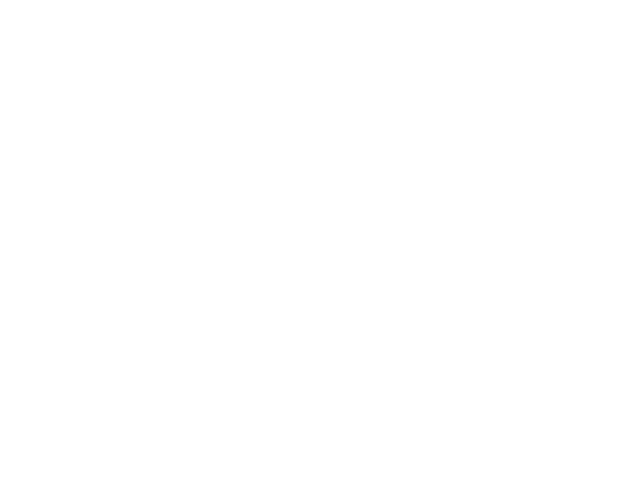

Chosen 95060
Predict is run


<IPython.core.display.Javascript object>


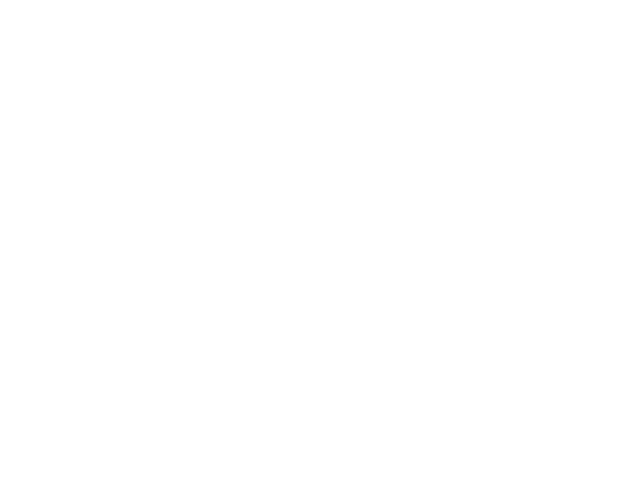

Sensor 95060
Errors:  78  ( 0.0105107128419 )
BIC - raw: 106753.593566  BIC - clean: 106642.30601


<IPython.core.display.Javascript object>


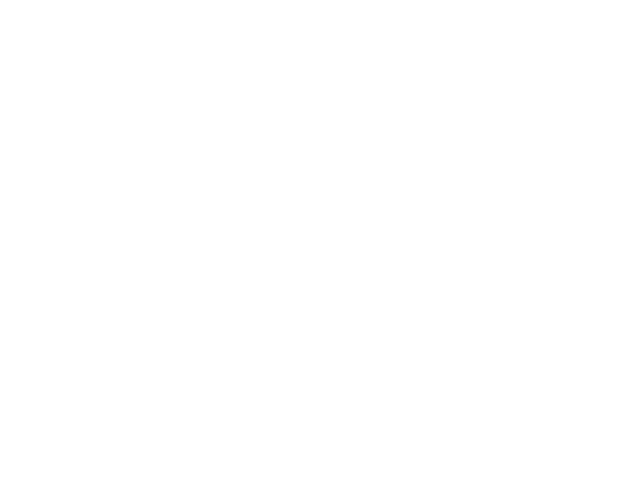

Chosen 15002
Predict is run


<IPython.core.display.Javascript object>


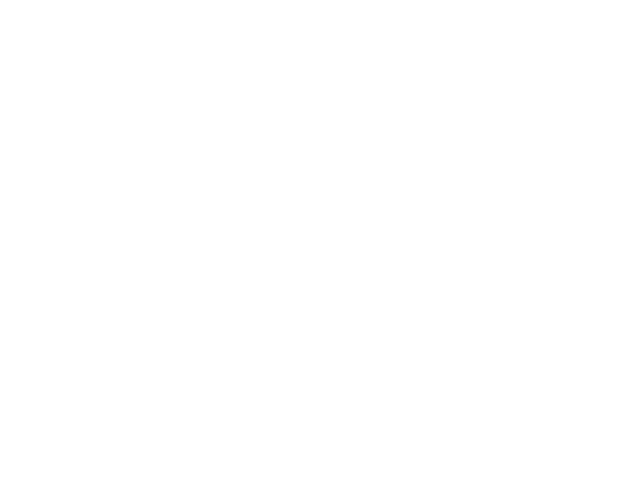

Sensor 15002
Errors:  11  ( 0.0428015564202 )
BIC - raw: -206.010803503  BIC - clean: -409.779700737


<IPython.core.display.Javascript object>


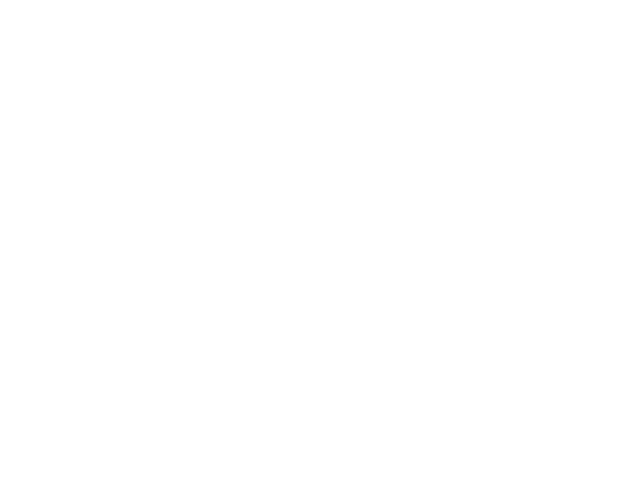

Chosen 15050
Predict is run


<IPython.core.display.Javascript object>


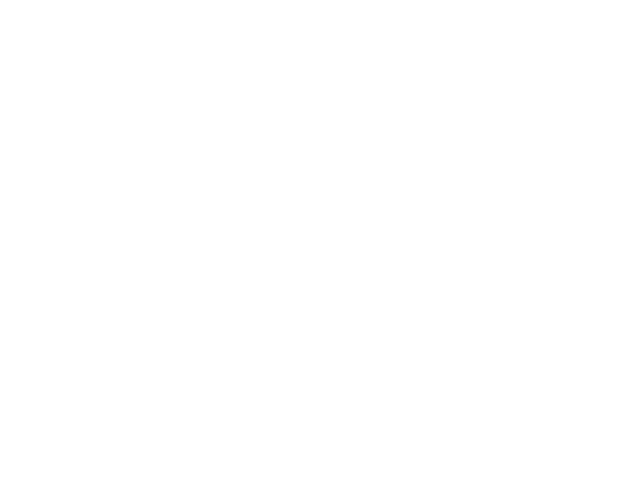

Sensor 15050
Errors:  43  ( 0.191964285714 )
BIC - raw: 218.394674901  BIC - clean: 223.757859444


<IPython.core.display.Javascript object>


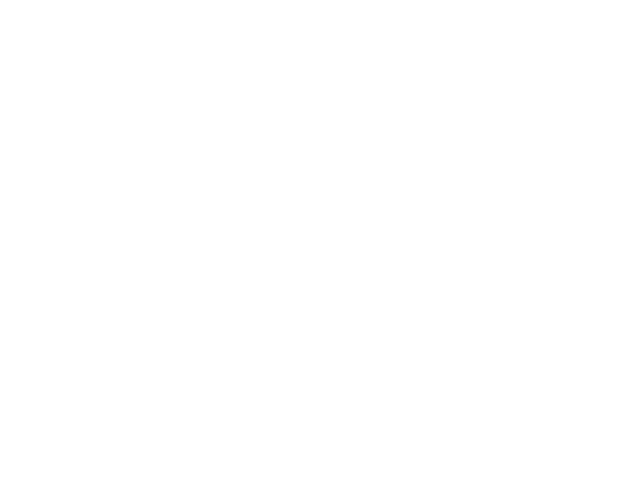

Chosen 15025
Predict is run


<IPython.core.display.Javascript object>


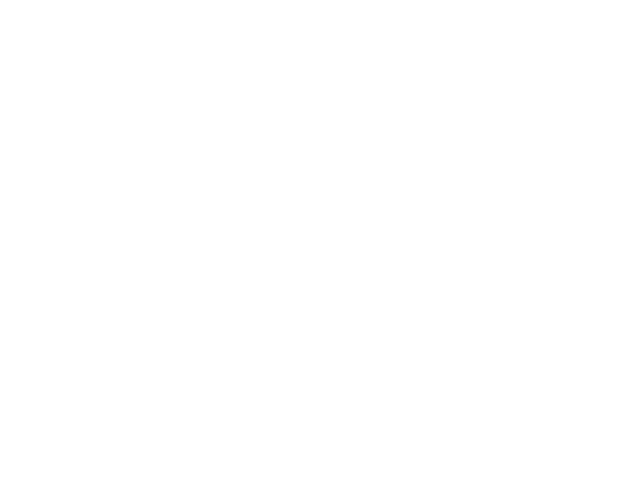

Sensor 15025
Errors:  7  ( 0.0777777777778 )
BIC - raw: -38.278874387  BIC - clean: -36.9778036515


<IPython.core.display.Javascript object>


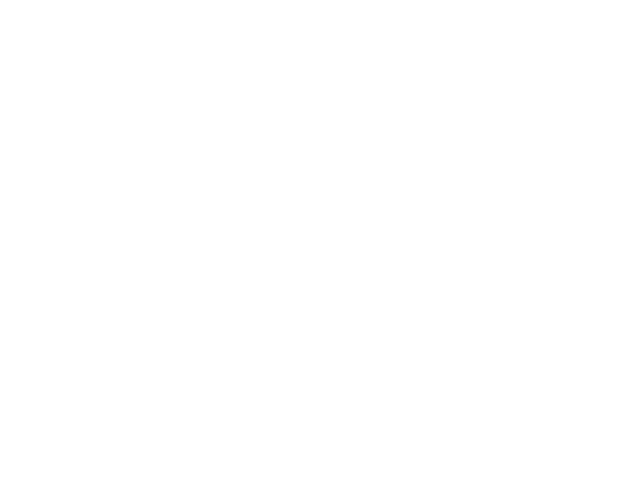

Chosen 15026
Predict is run


<IPython.core.display.Javascript object>


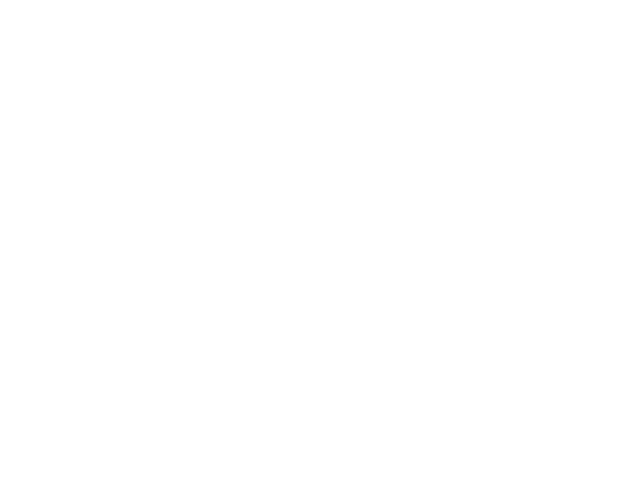

Sensor 15026
Errors:  18  ( 0.0596026490066 )
BIC - raw: -131.947254048  BIC - clean: -151.0324307


<IPython.core.display.Javascript object>


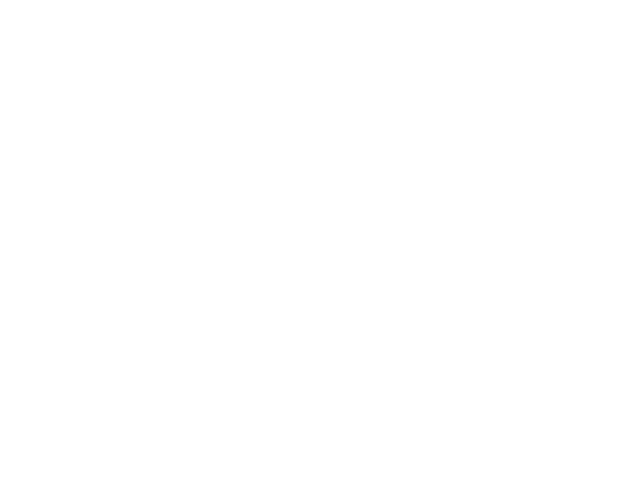

Chosen 15015
Predict is run


<IPython.core.display.Javascript object>


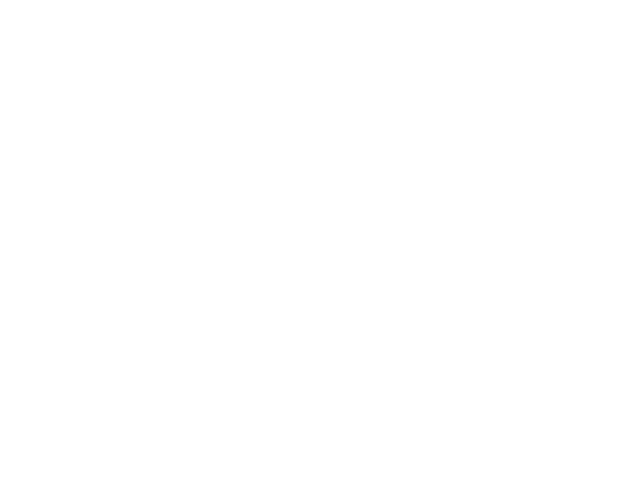

Sensor 15015
Errors:  5  ( 0.0340136054422 )
BIC - raw: -245.292401956  BIC - clean: -242.314529148


<IPython.core.display.Javascript object>


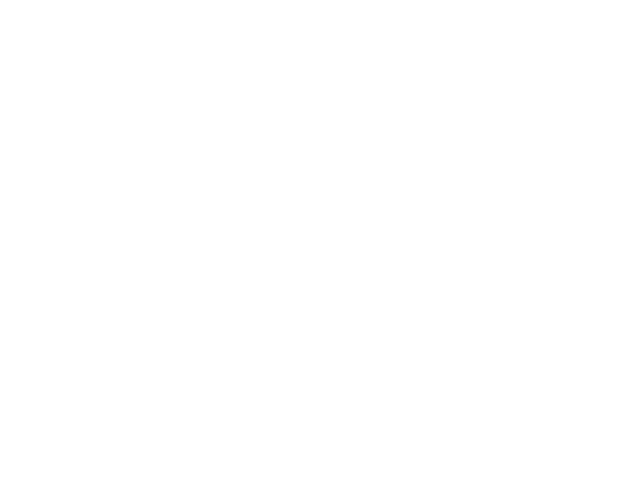

Chosen 15101
Predict is run


<IPython.core.display.Javascript object>


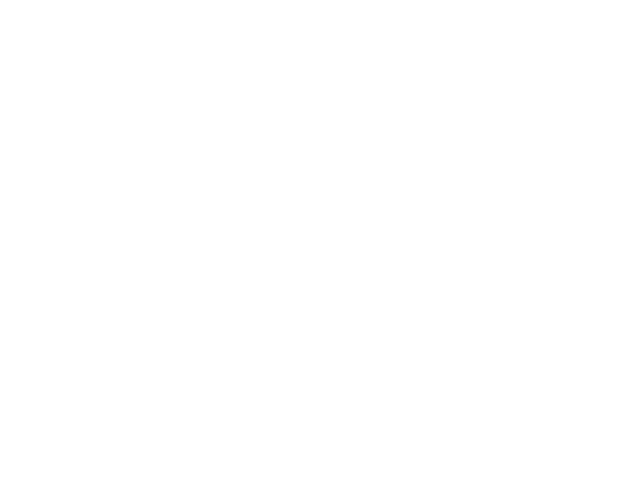

Sensor 15101
Errors:  5  ( 0.00416666666667 )
BIC - raw: 17514.7445377  BIC - clean: 761.960654639


<IPython.core.display.Javascript object>


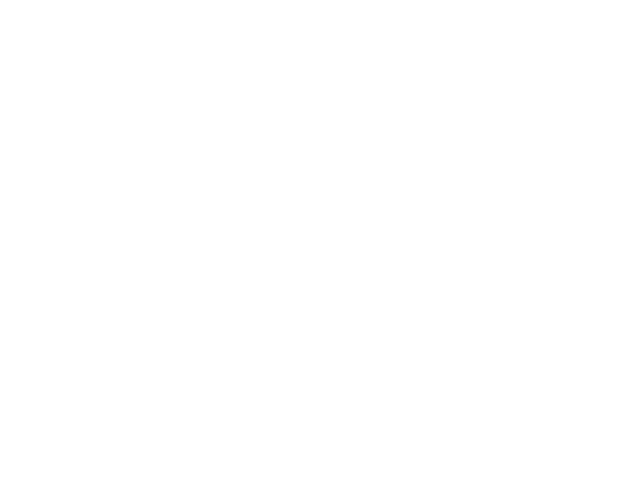

Chosen 15070
Predict is run


<IPython.core.display.Javascript object>


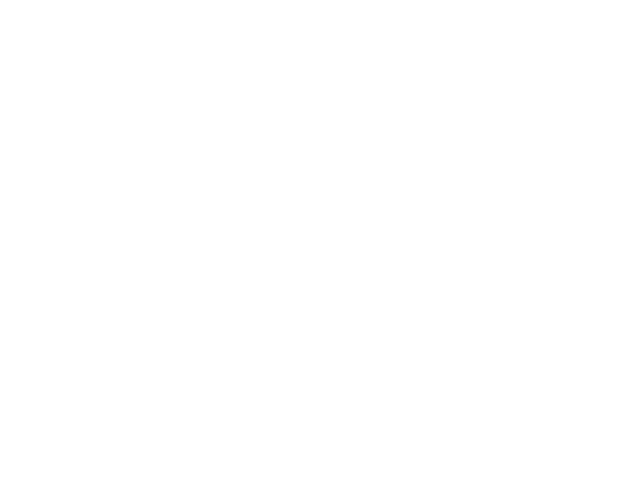

Sensor 15070
Errors:  44  ( 0.169884169884 )
BIC - raw: 88.9963815436  BIC - clean: -43.9270300154


<IPython.core.display.Javascript object>


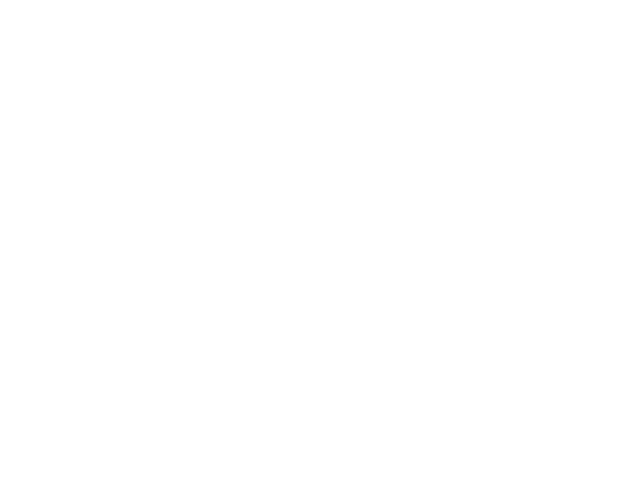

Chosen 95054
Predict is run


<IPython.core.display.Javascript object>


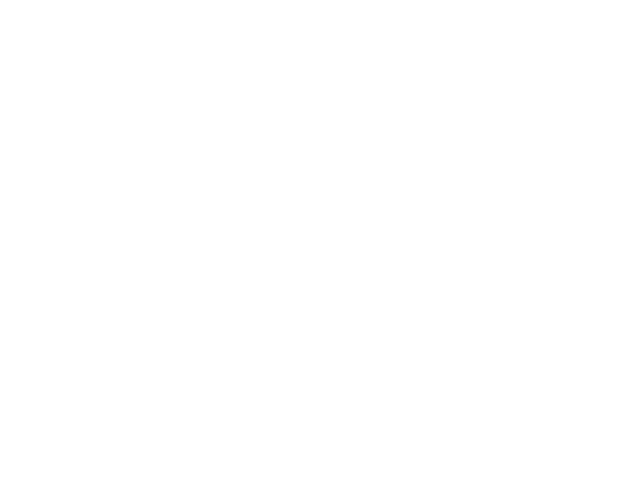

Sensor 95054
Errors:  102  ( 0.435897435897 )
BIC - raw: 455.888743136  BIC - clean: 448.007806187


<IPython.core.display.Javascript object>


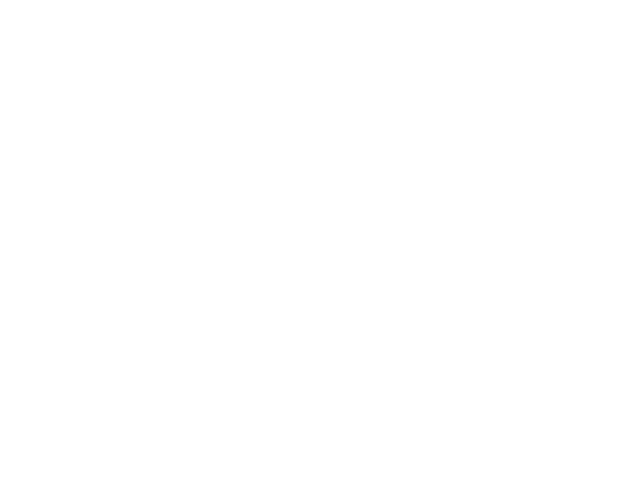

Chosen 15011
Predict is run


<IPython.core.display.Javascript object>


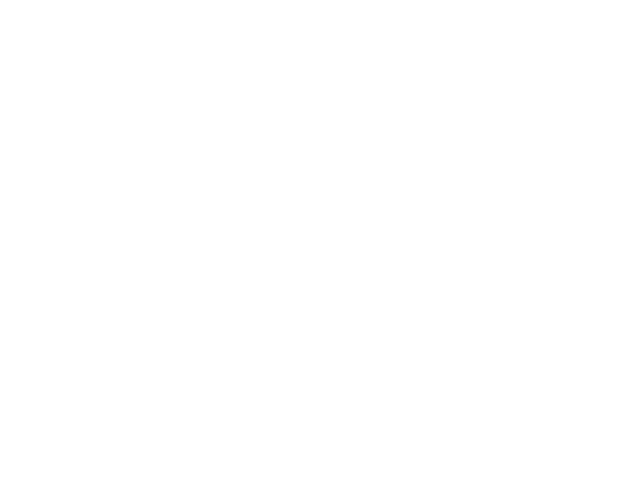

Sensor 15011
Errors:  8  ( 0.00413650465357 )
BIC - raw: -10536.3395137  BIC - clean: -10111.9633079


<IPython.core.display.Javascript object>


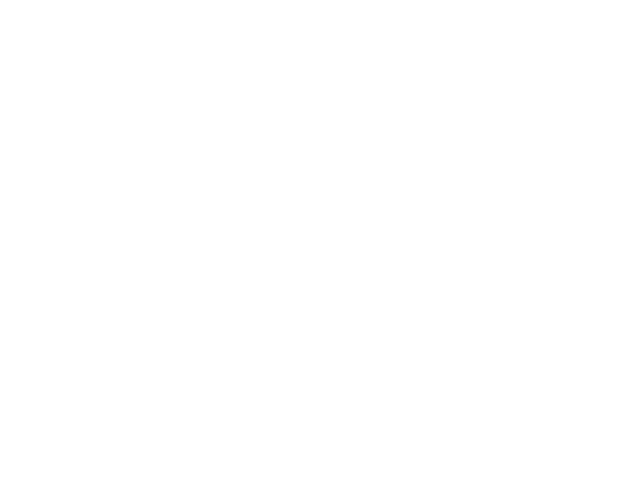

Chosen 15060
Predict is run


<IPython.core.display.Javascript object>


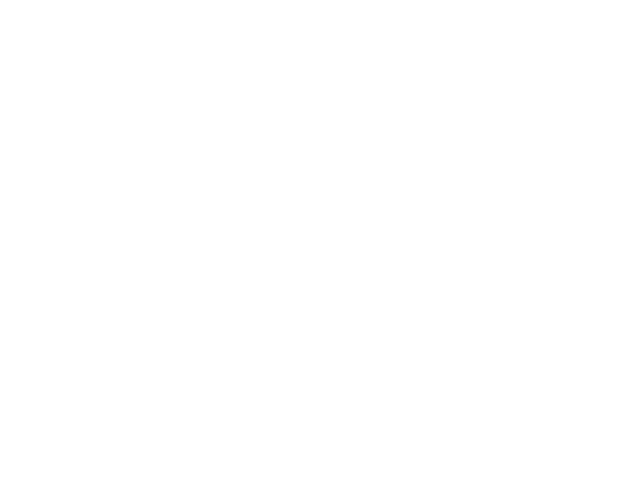

Sensor 15060
Errors:  96  ( 0.0891364902507 )
BIC - raw: 18336.9223097  BIC - clean: 17656.1350447


<IPython.core.display.Javascript object>


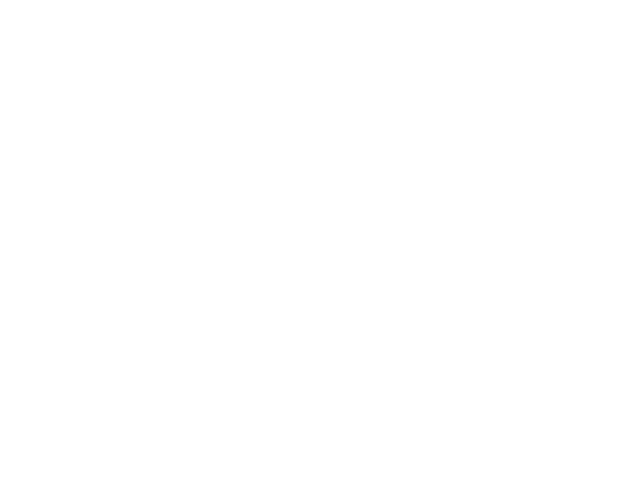

Chosen 60102
Predict is run


<IPython.core.display.Javascript object>


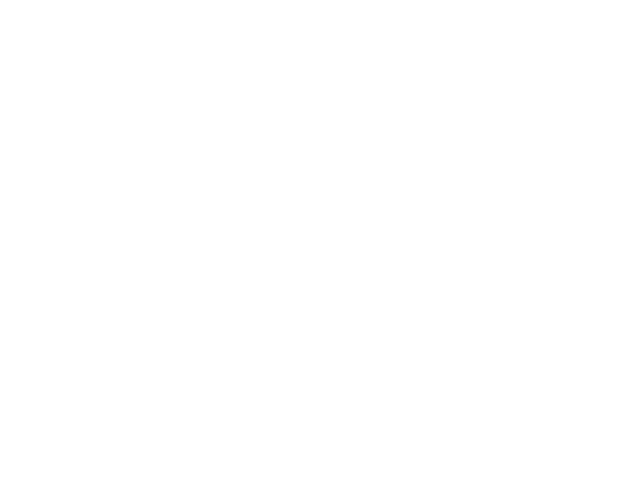

Sensor 60102
Errors:  263  ( 0.0959153902261 )
BIC - raw: 14217.8300944  BIC - clean: -1046.33377857


<IPython.core.display.Javascript object>


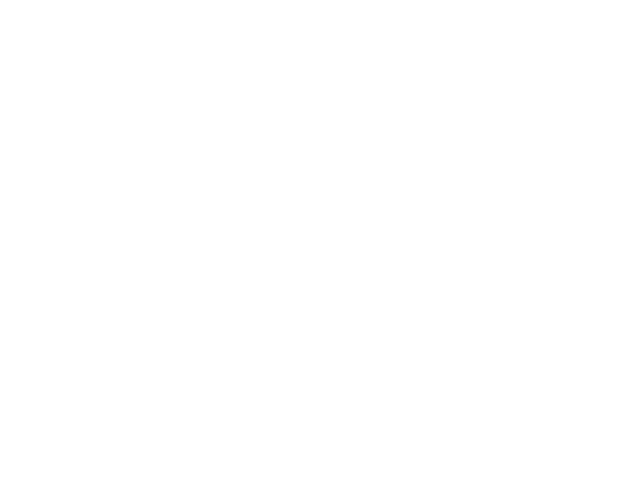

Chosen 15061
Predict is run


<IPython.core.display.Javascript object>


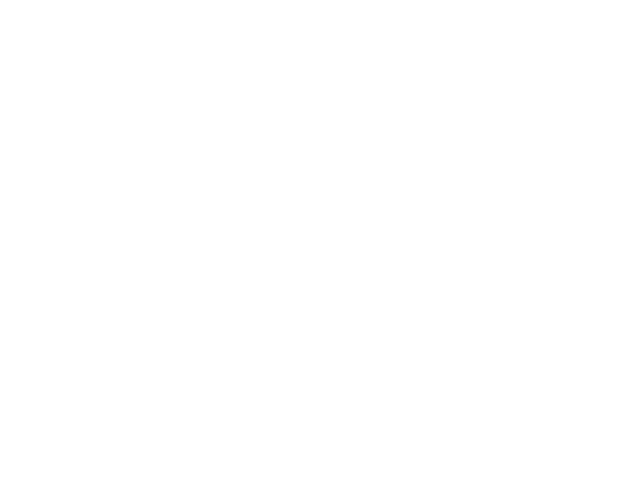

Sensor 15061
Errors:  30  ( 0.16393442623 )
BIC - raw: 12.3353498568  BIC - clean: 25.4868866187


<IPython.core.display.Javascript object>


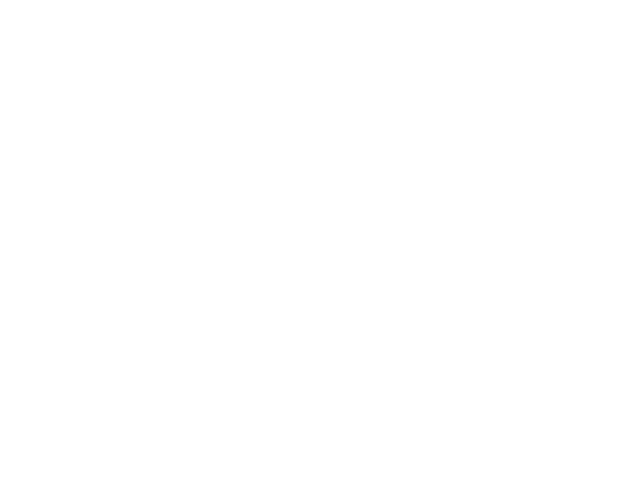

Chosen 30194
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 30025
Predict is run


<IPython.core.display.Javascript object>


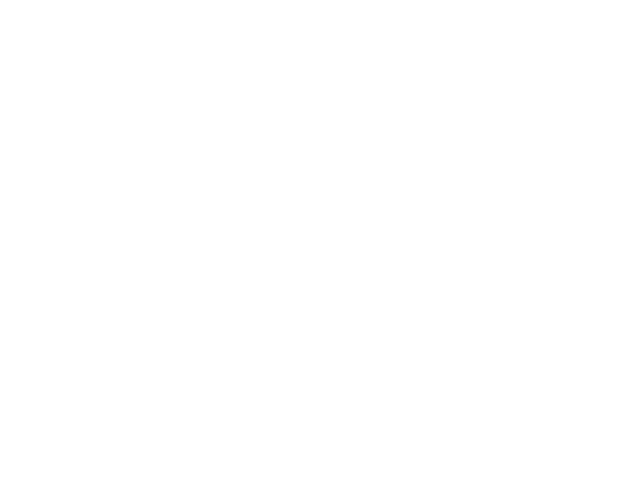

Sensor 30025
Errors:  242  ( 0.0203995616623 )
BIC - raw: -31028.8039976  BIC - clean: -22339.268125


<IPython.core.display.Javascript object>


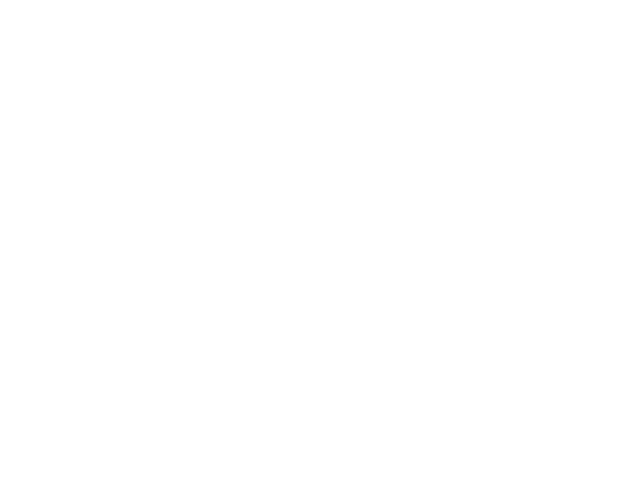

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 95021
Predict is run


<IPython.core.display.Javascript object>


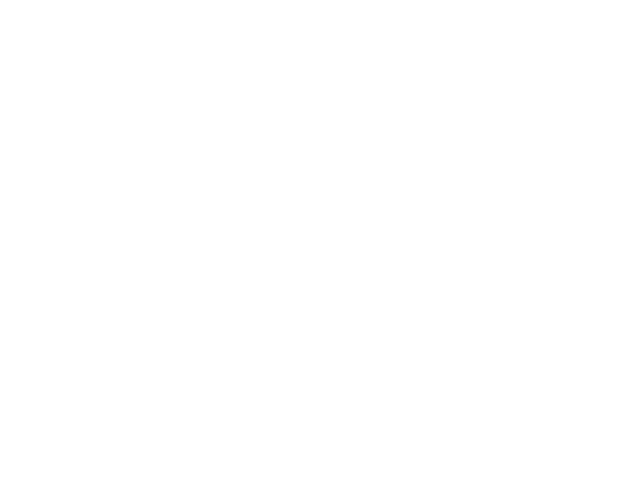

Sensor 95021
Errors:  42  ( 0.35 )
BIC - raw: 55.1487718053  BIC - clean: 105.041826081


<IPython.core.display.Javascript object>


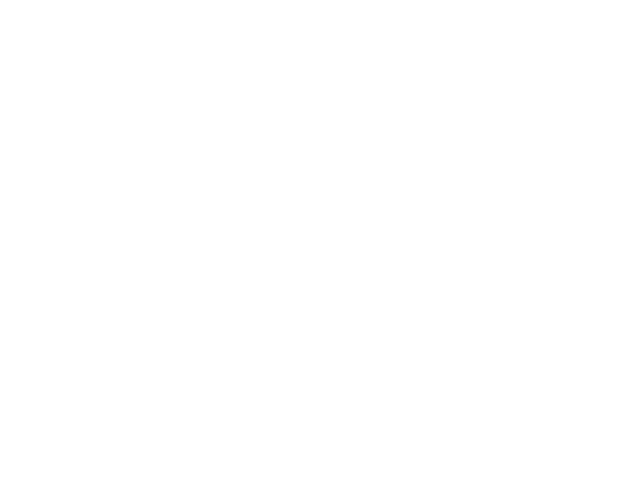

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 80052
Predict is run


<IPython.core.display.Javascript object>


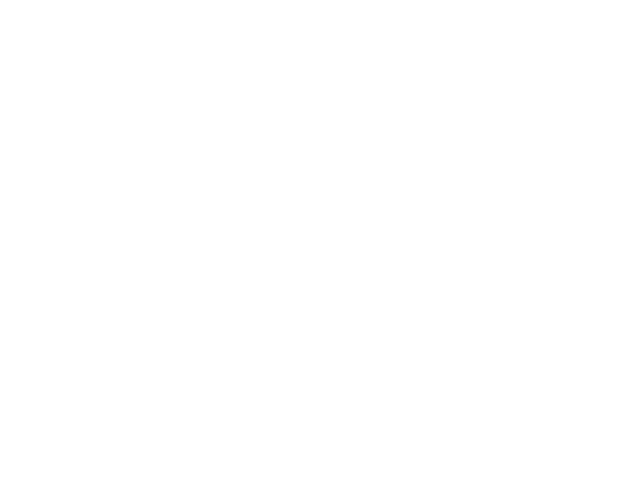

Sensor 80052
Errors:  112  ( 0.0613026819923 )
BIC - raw: -3020.82924603  BIC - clean: -2575.81013842


<IPython.core.display.Javascript object>


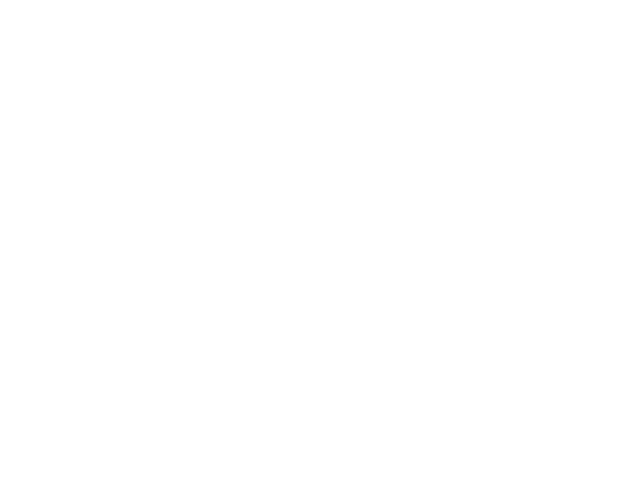

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 60060
Predict is run


<IPython.core.display.Javascript object>


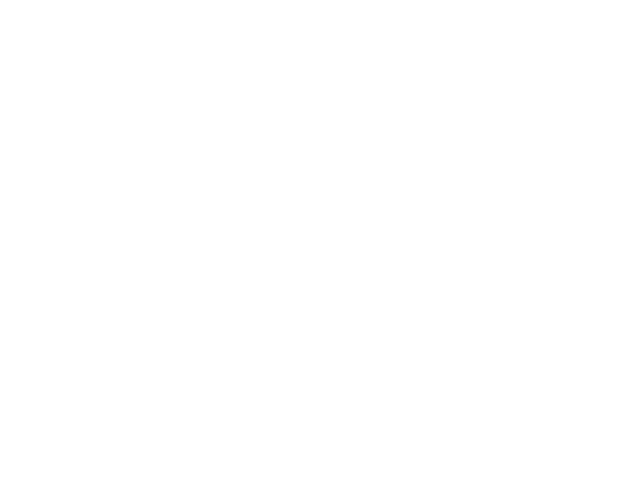

Sensor 60060
Errors:  164  ( 0.443243243243 )
BIC - raw: 861.417959552  BIC - clean: 1039.8852804


<IPython.core.display.Javascript object>


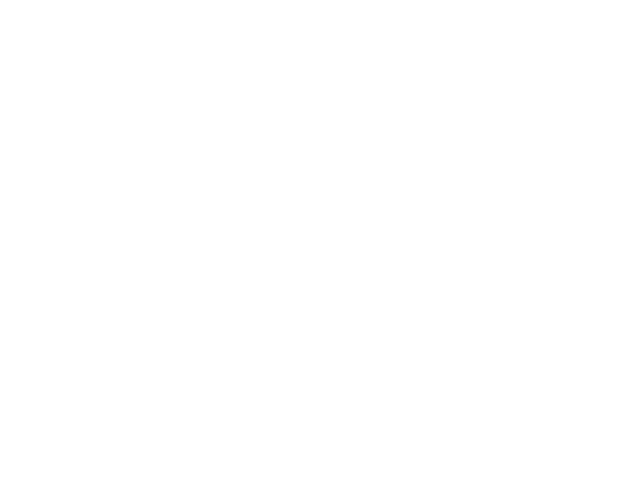

<class 'KeyError'>
('Value',)
Chosen 80015
Predict is run


<IPython.core.display.Javascript object>


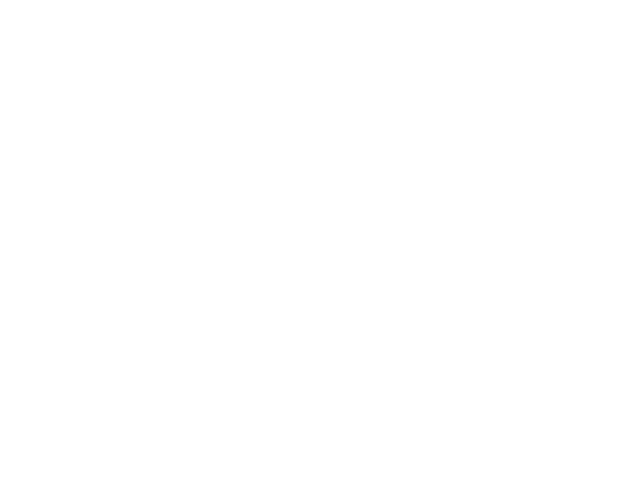

Sensor 80015
Errors:  1011  ( 0.481657932349 )
BIC - raw: 7153.71982667  BIC - clean: 8808.37224098


<IPython.core.display.Javascript object>


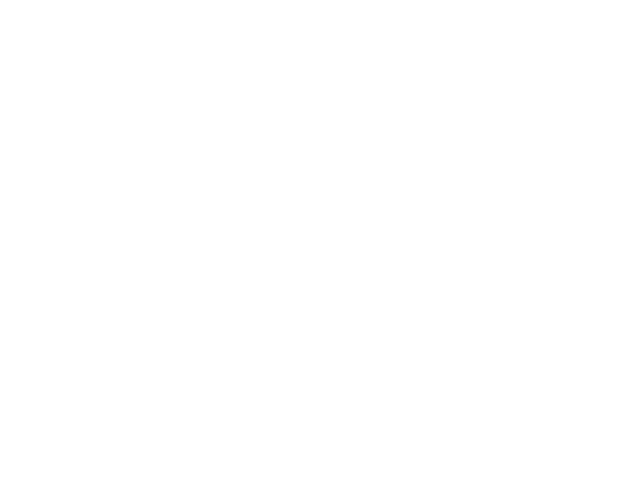

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 80062
Predict is run


<IPython.core.display.Javascript object>


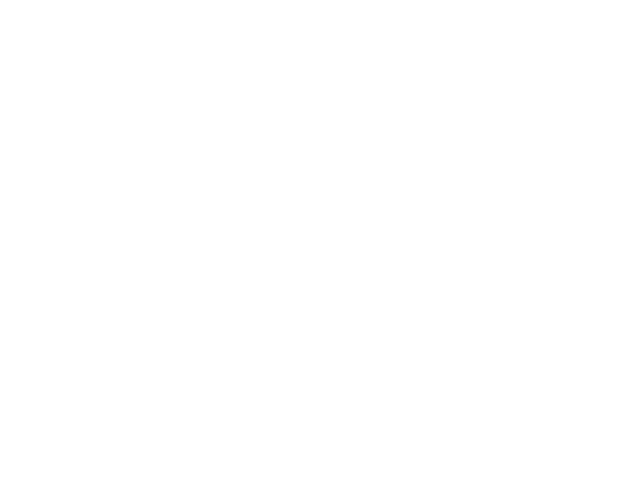

Sensor 80062
Errors:  50  ( 0.00917936478796 )
BIC - raw: -18484.9184581  BIC - clean: -16561.6166798


<IPython.core.display.Javascript object>


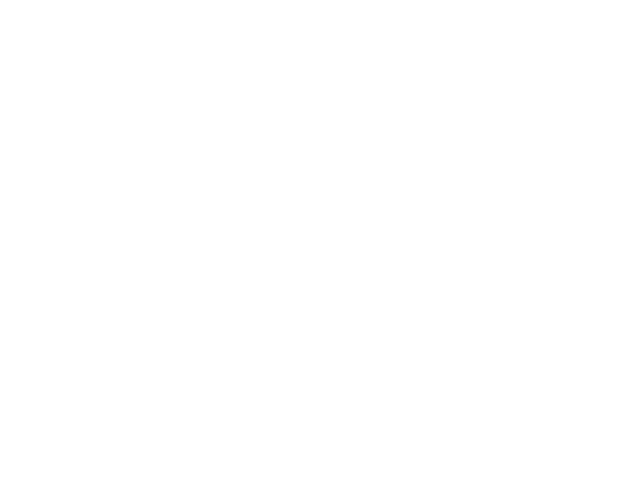

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 95080
Predict is run


<IPython.core.display.Javascript object>


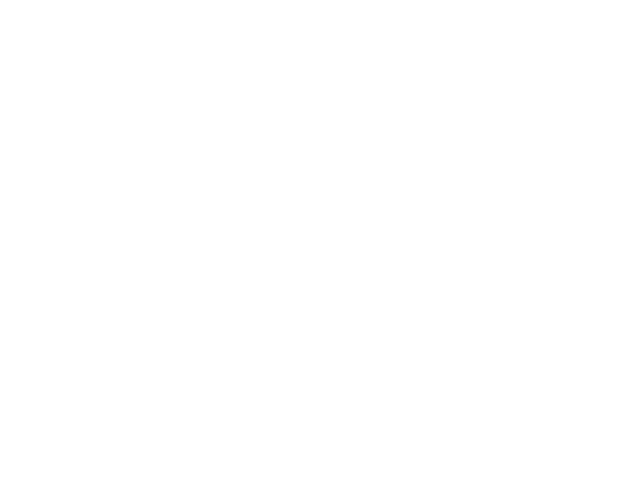

Sensor 95080
Errors:  2  ( 0.0285714285714 )
BIC - raw: 370.386944284  BIC - clean: 370.386944284


<IPython.core.display.Javascript object>


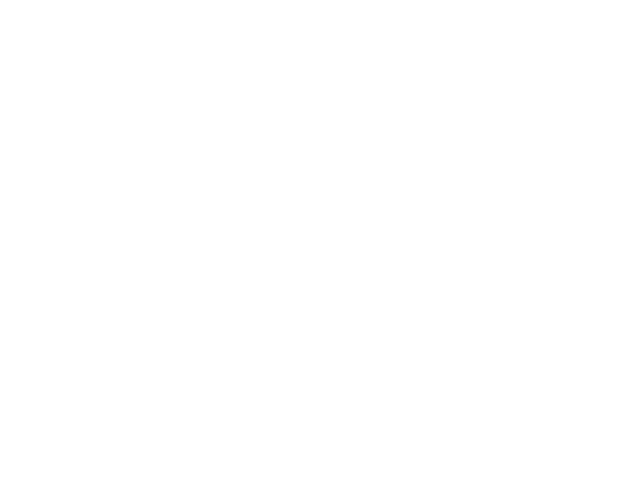

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 30193
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 55071
Predict is run


<IPython.core.display.Javascript object>


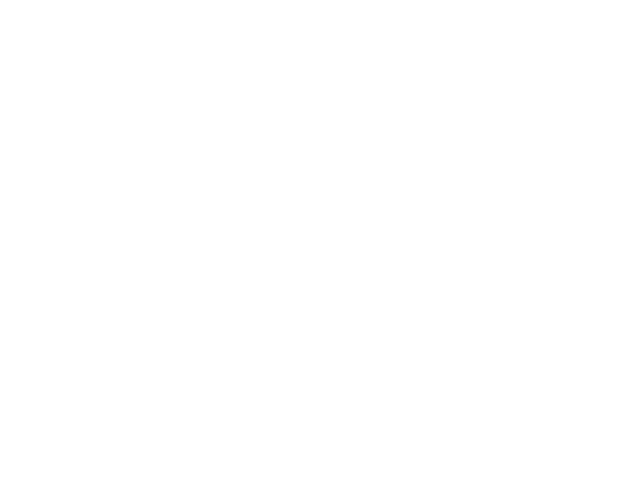

Sensor 55071
Errors:  3  ( 0.0833333333333 )
BIC - raw: -5.50585333327  BIC - clean: -5.50585333327


<IPython.core.display.Javascript object>


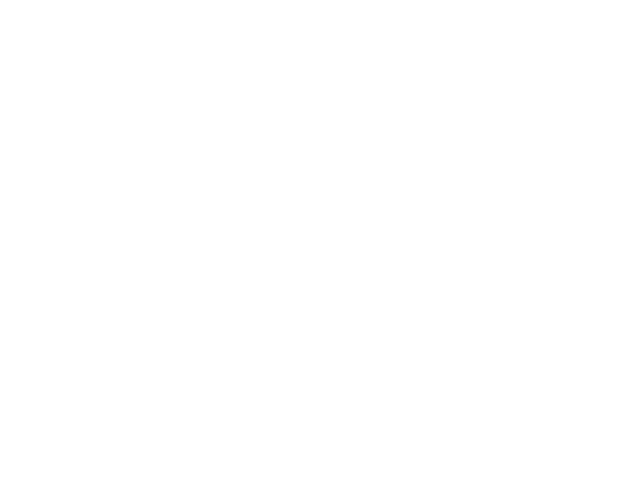

Chosen 55084
Predict is run


<IPython.core.display.Javascript object>


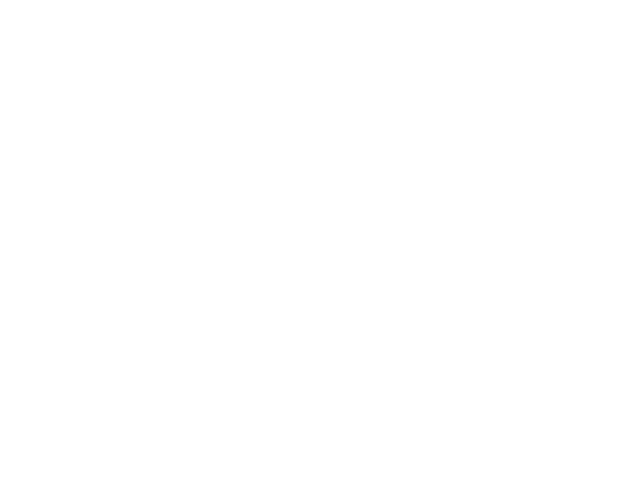

Sensor 55084
Errors:  102  ( 0.1632 )
BIC - raw: -332.482052957  BIC - clean: -254.503614392


<IPython.core.display.Javascript object>


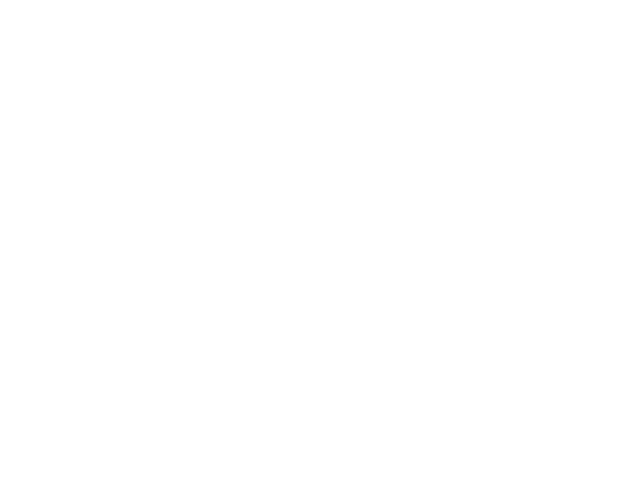

<class 'KeyError'>
('Value',)
Chosen 55015
Predict is run


<IPython.core.display.Javascript object>


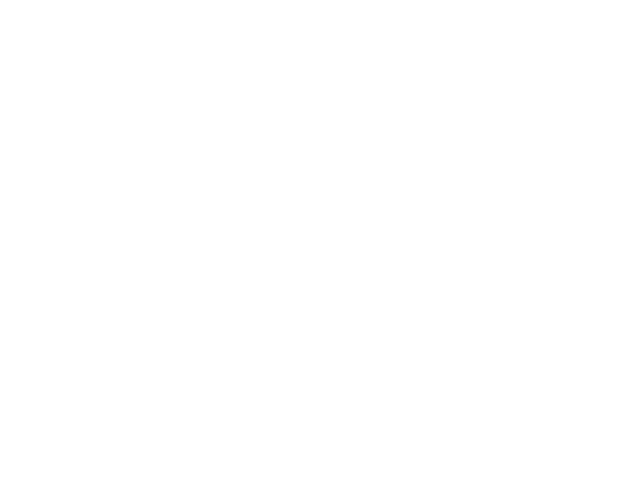

Sensor 55015
Errors:  70  ( 0.457516339869 )
BIC - raw: 339.530981952  BIC - clean: 367.232560374


<IPython.core.display.Javascript object>


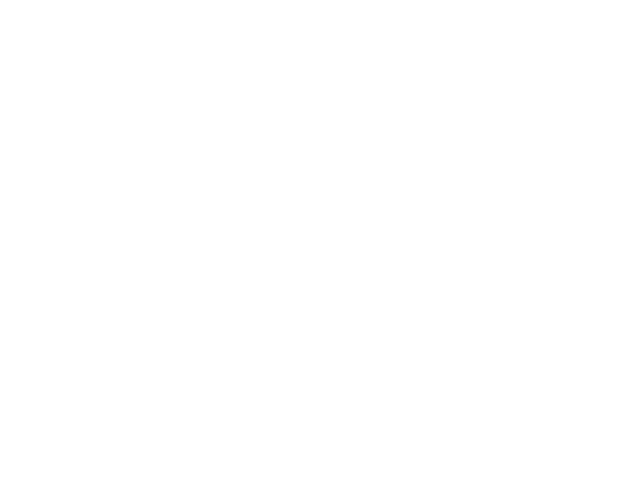

<class 'KeyError'>
('Value',)
Chosen 55103
Predict is run


<IPython.core.display.Javascript object>


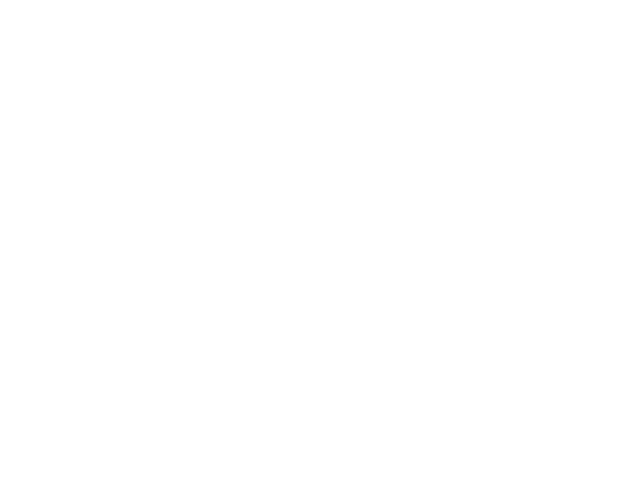

Sensor 55103
Errors:  49  ( 0.224770642202 )
BIC - raw: 102.080737947  BIC - clean: 205.646539611


<IPython.core.display.Javascript object>


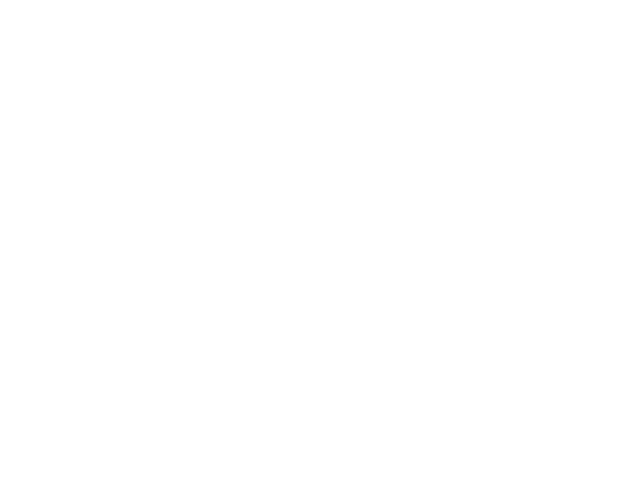

Chosen 55065
Predict is run


<IPython.core.display.Javascript object>


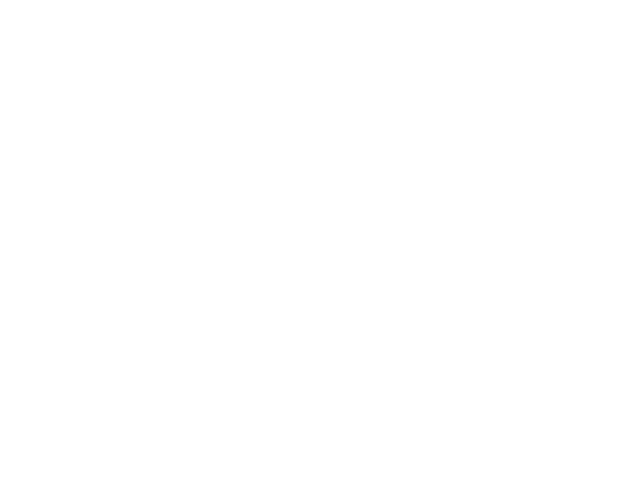

Sensor 55065
Errors:  111  ( 0.438735177866 )
BIC - raw: 474.822919614  BIC - clean: 566.496449964


<IPython.core.display.Javascript object>


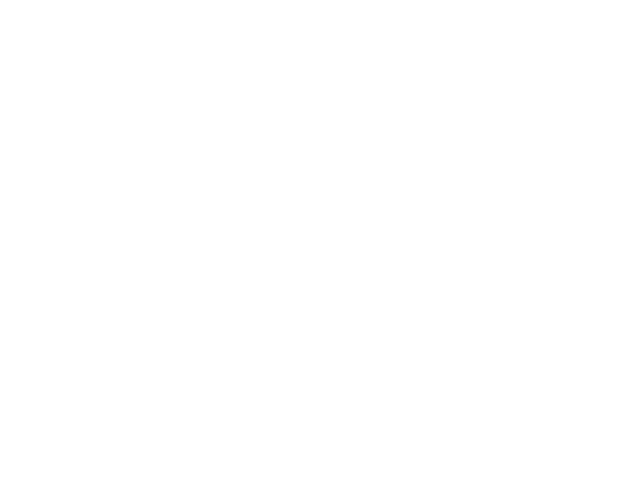

Chosen 55010
Predict is run


<IPython.core.display.Javascript object>


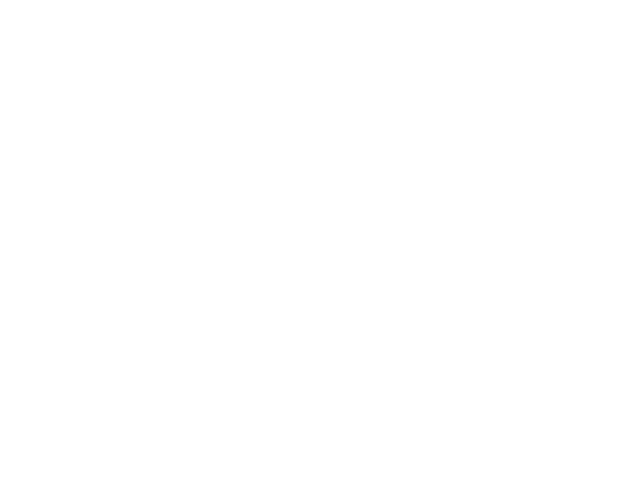

Sensor 55010
Errors:  654  ( 0.11056635672 )
BIC - raw: -6042.84905619  BIC - clean: -2316.63477361


<IPython.core.display.Javascript object>


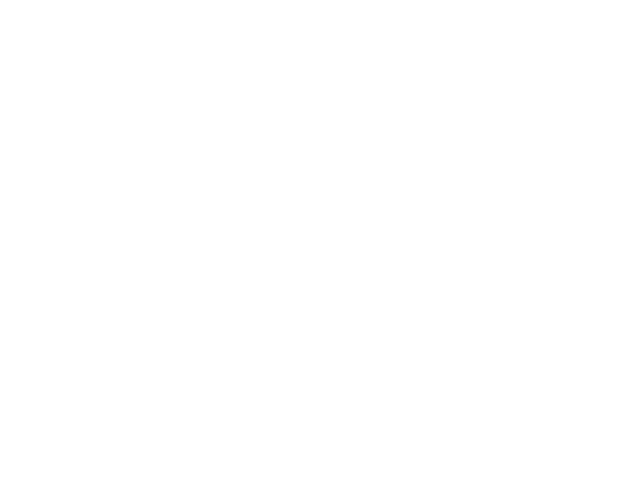

Chosen 55102
Predict is run


<IPython.core.display.Javascript object>


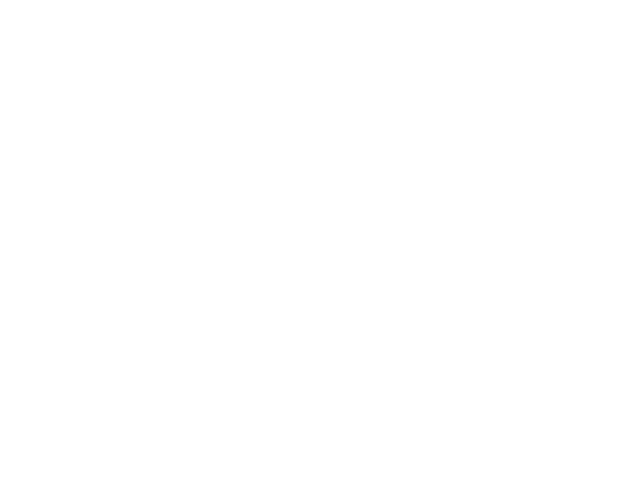

Sensor 55102
Errors:  253  ( 0.377611940299 )
BIC - raw: 1003.09977851  BIC - clean: 1225.18841767


<IPython.core.display.Javascript object>


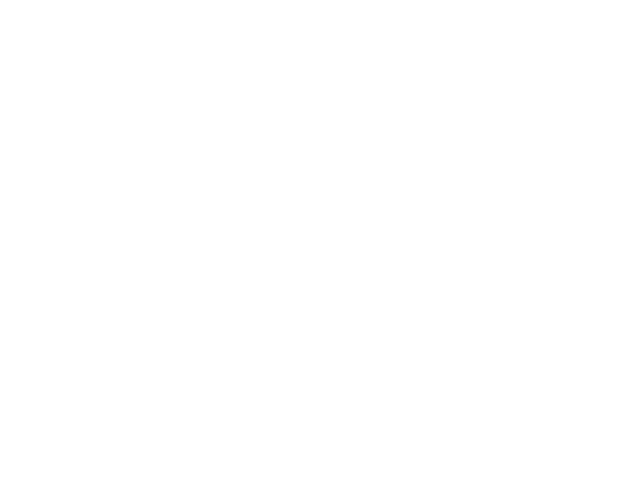

<class 'KeyError'>
('Value',)
Chosen 30182
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 80070
Predict is run


<IPython.core.display.Javascript object>


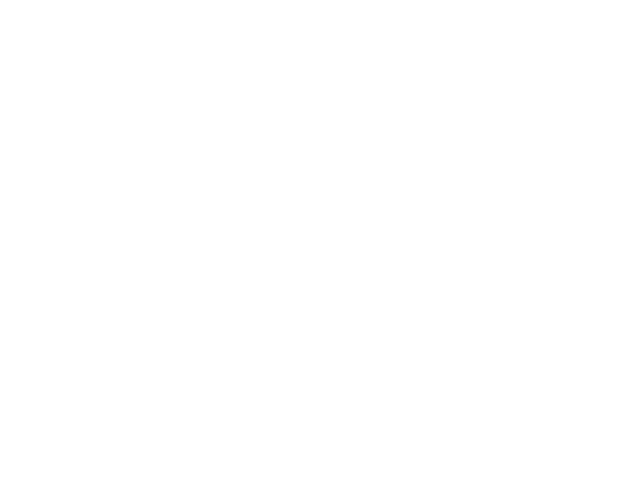

Sensor 80070
Errors:  37  ( 0.00288364118151 )
BIC - raw: -61399.4381534  BIC - clean: -54714.211447


<IPython.core.display.Javascript object>


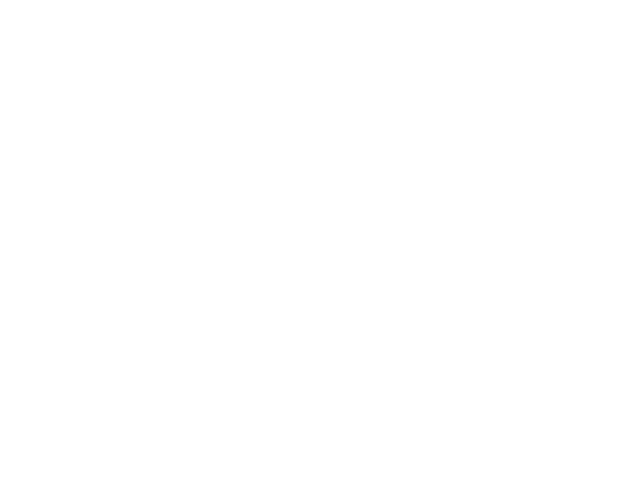

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 60010
Predict is run


<IPython.core.display.Javascript object>


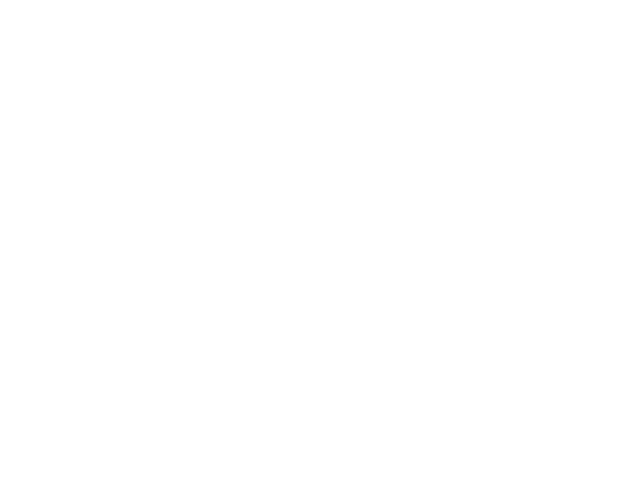

Sensor 60010
Errors:  103  ( 0.40873015873 )
BIC - raw: 412.99068379  BIC - clean: 490.825526422


<IPython.core.display.Javascript object>


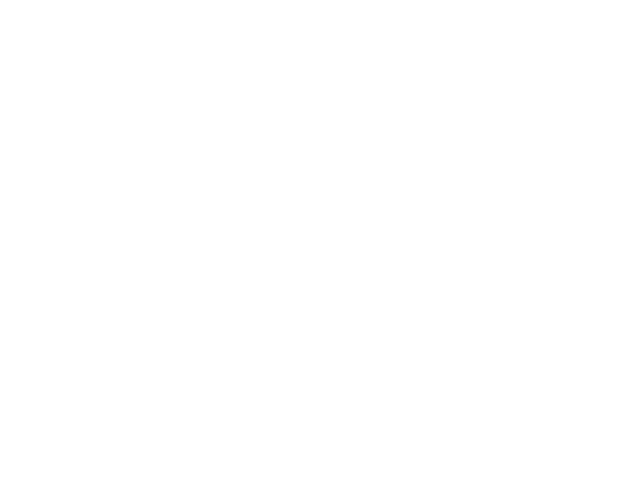

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 85071
Predict is run


<IPython.core.display.Javascript object>


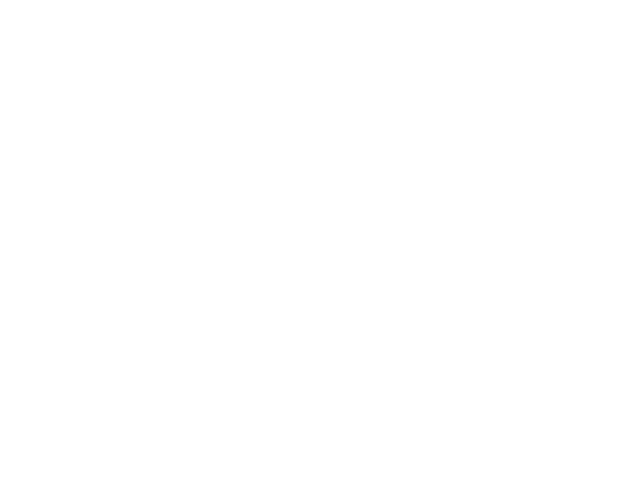

Sensor 85071
Errors:  9  ( 0.0523255813953 )
BIC - raw: -112.665680085  BIC - clean: -112.671160029


<IPython.core.display.Javascript object>


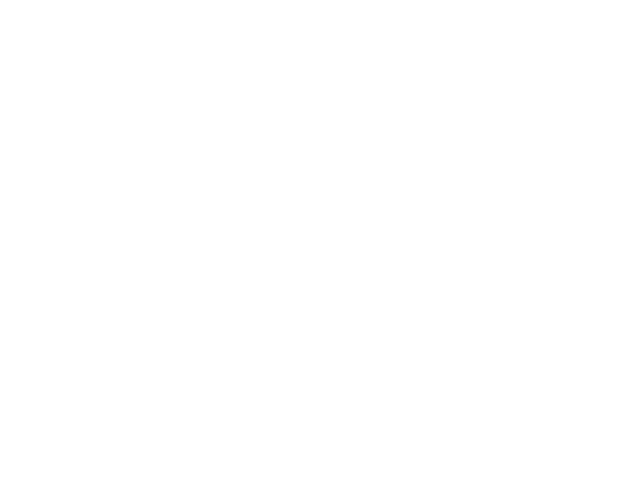

Chosen 85062
Predict is run


<IPython.core.display.Javascript object>


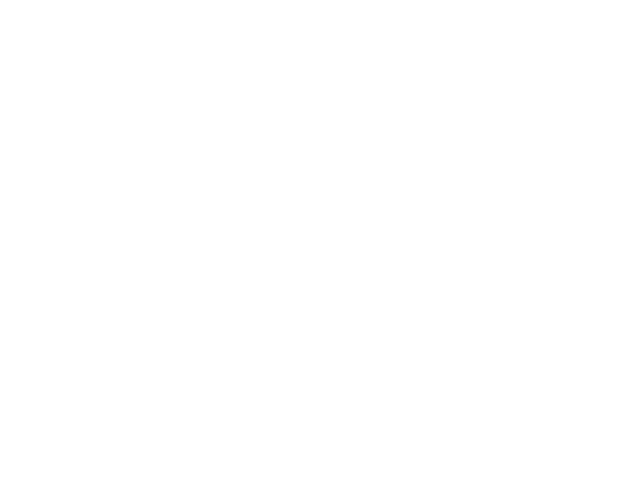

Sensor 85062
Errors:  7  ( 0.0409356725146 )
BIC - raw: -129.450552961  BIC - clean: -140.652646932


<IPython.core.display.Javascript object>


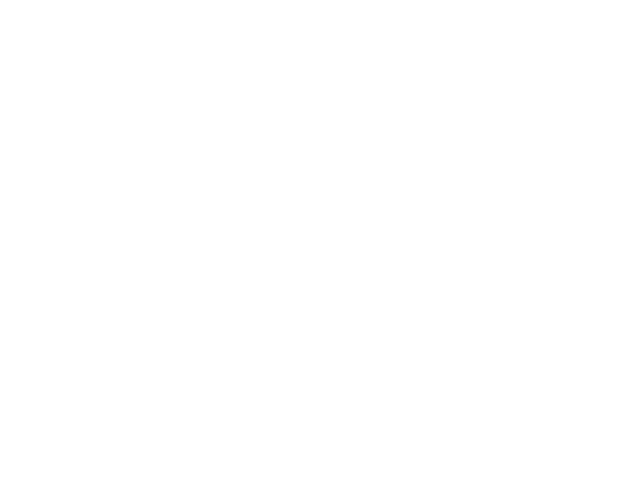

Chosen 30179
Predict is run


<IPython.core.display.Javascript object>


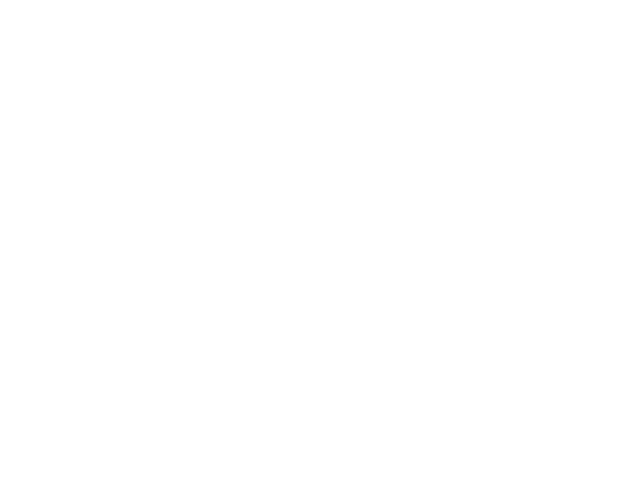

Sensor 30179
Errors:  7  ( 0.0636363636364 )
BIC - raw: 2.20785191281  BIC - clean: 5.39326225173


<IPython.core.display.Javascript object>


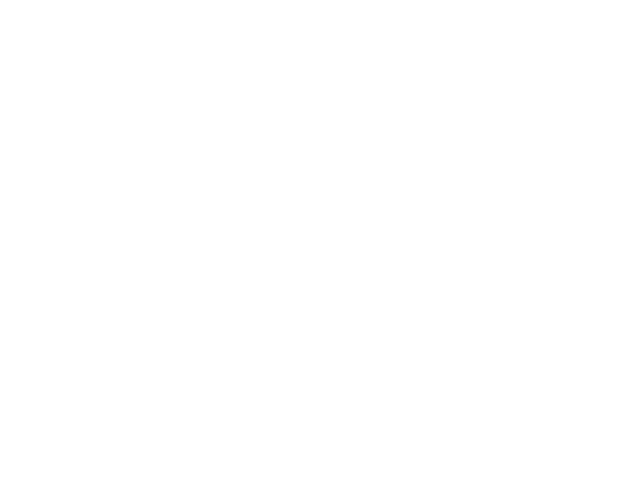

Chosen 85061
Predict is run


<IPython.core.display.Javascript object>


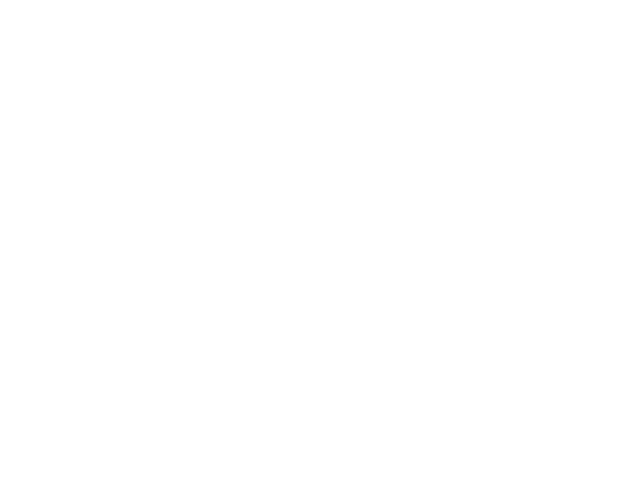

Sensor 85061
Errors:  3  ( 0.0384615384615 )
BIC - raw: 4.40202053284  BIC - clean: 4.40202053284


<IPython.core.display.Javascript object>


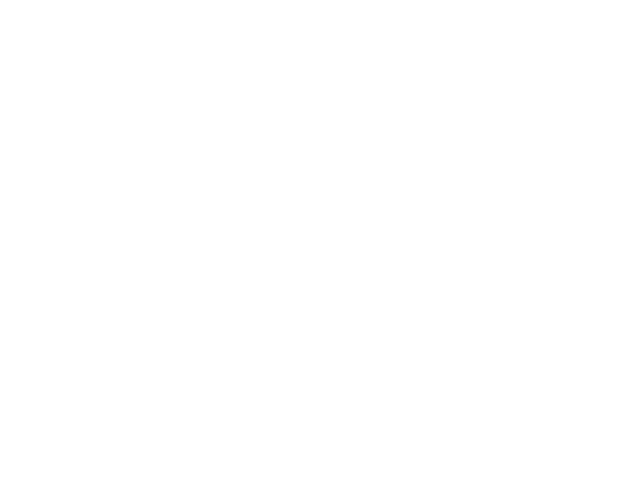

Chosen 85063
Predict is run


<IPython.core.display.Javascript object>


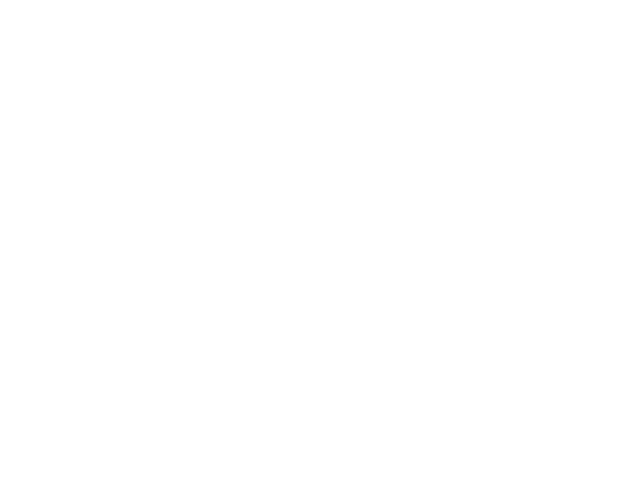

Sensor 85063
Errors:  62  ( 0.0155544405419 )
BIC - raw: 3057.5706778  BIC - clean: 4826.34216983


<IPython.core.display.Javascript object>


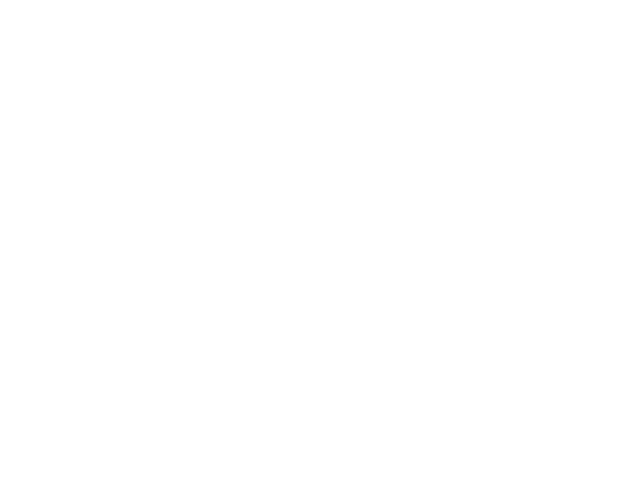

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 85022
Predict is run


<IPython.core.display.Javascript object>


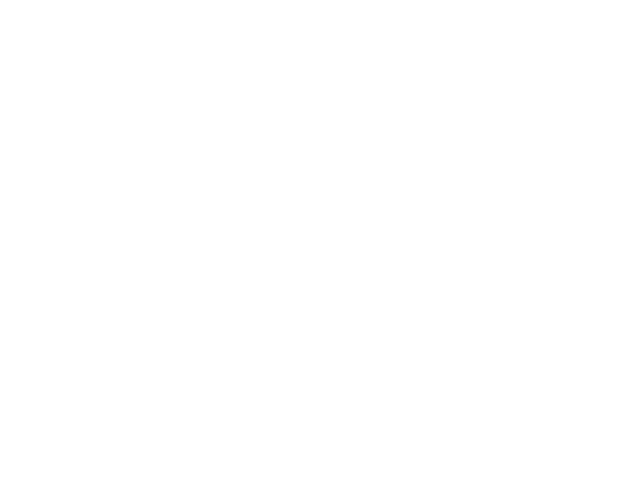

Sensor 85022
Errors:  74  ( 0.342592592593 )
BIC - raw: 486.475786759  BIC - clean: 603.2983099


<IPython.core.display.Javascript object>


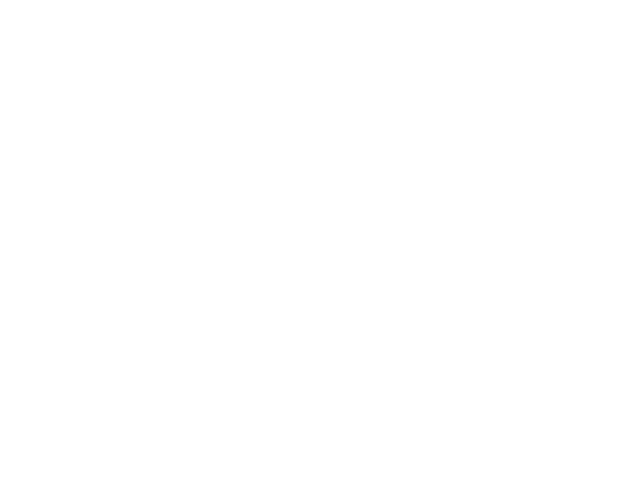

Chosen 85020
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 85053
Predict is run


<IPython.core.display.Javascript object>


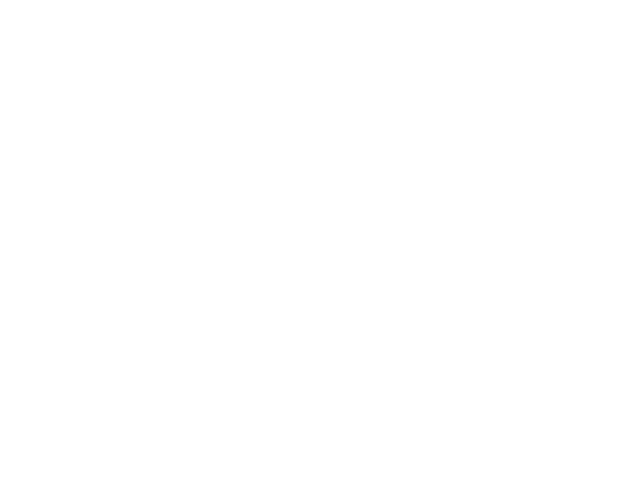

Sensor 85053
Errors:  48  ( 0.190476190476 )
BIC - raw: 272.205435428  BIC - clean: 207.25049565


<IPython.core.display.Javascript object>


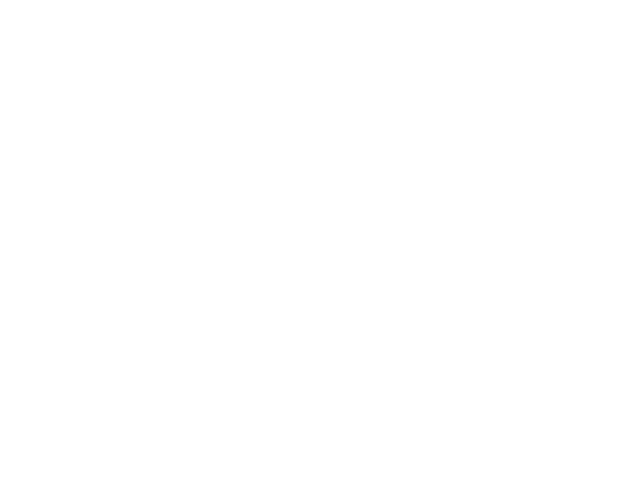

Chosen 95051
Predict is run


<IPython.core.display.Javascript object>


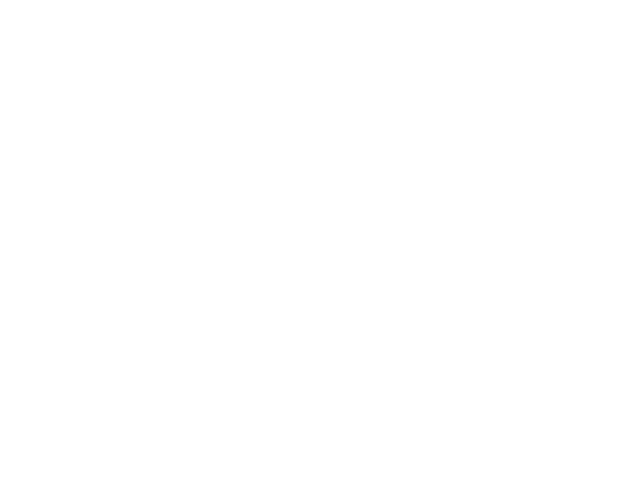

Sensor 95051
Errors:  64  ( 0.533333333333 )
BIC - raw: 270.166119944  BIC - clean: 368.053895306


<IPython.core.display.Javascript object>


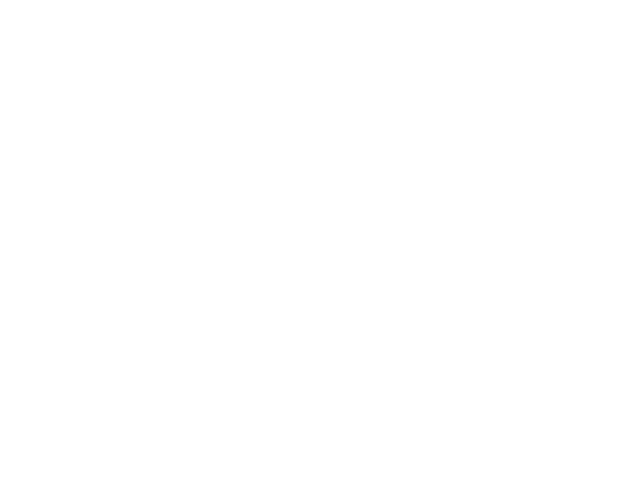

Chosen 85051
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 95045
Predict is run


<IPython.core.display.Javascript object>


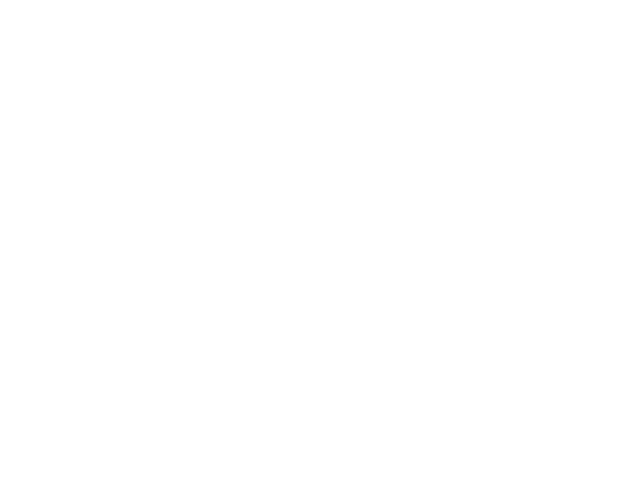

Sensor 95045
Errors:  40  ( 0.00415886878769 )
BIC - raw: 122607.024748  BIC - clean: 123912.444211


<IPython.core.display.Javascript object>


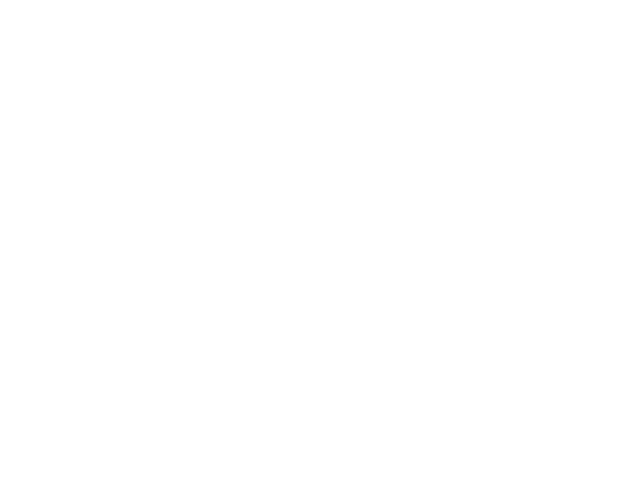

Chosen 85042
Predict is run


<IPython.core.display.Javascript object>


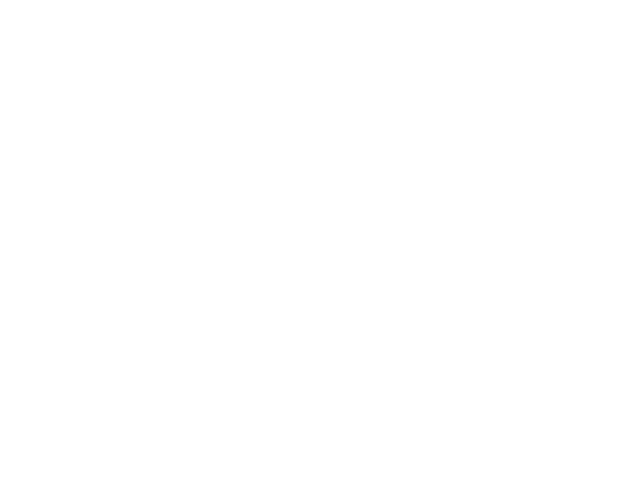

Sensor 85042
Errors:  15  ( 0.0909090909091 )
BIC - raw: 31.3462078645  BIC - clean: -18.3325581602


<IPython.core.display.Javascript object>


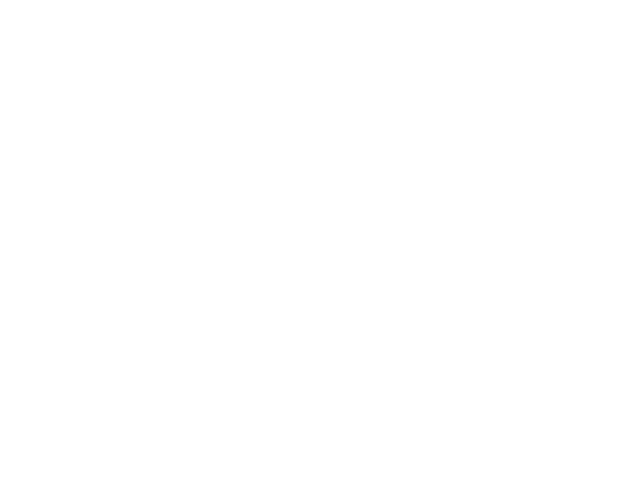

Chosen 85019
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 85002
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
Chosen 85041
Predict is run


<IPython.core.display.Javascript object>


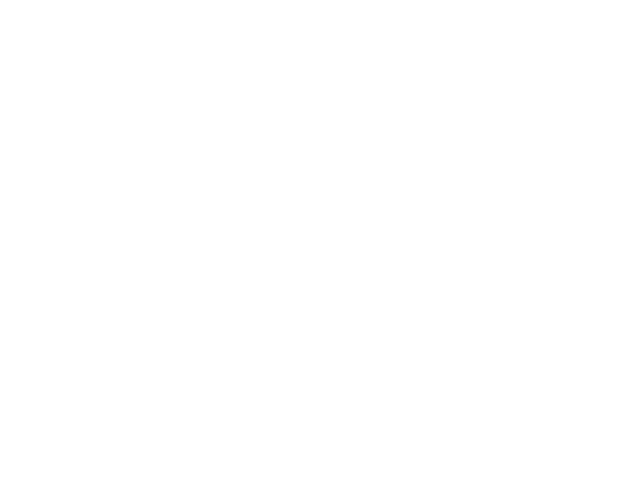

Sensor 85041
Errors:  3  ( 0.0294117647059 )
BIC - raw: 1453.43063903  BIC - clean: -108.864215949


<IPython.core.display.Javascript object>


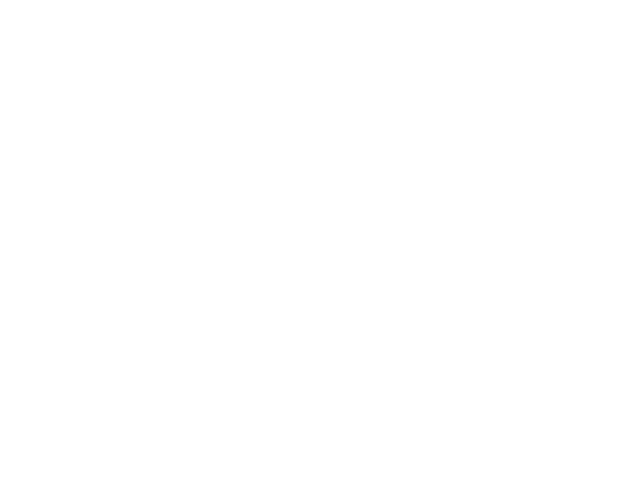

Chosen 95070
Predict is run


<IPython.core.display.Javascript object>


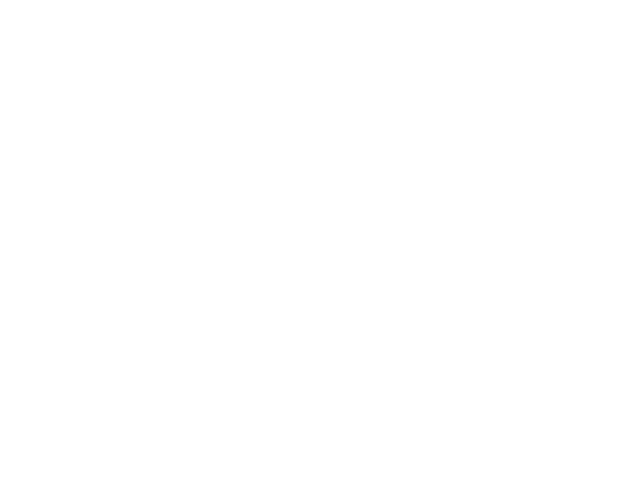

Sensor 95070
Errors:  46  ( 0.383333333333 )
BIC - raw: 201.805013363  BIC - clean: 213.481198411


<IPython.core.display.Javascript object>


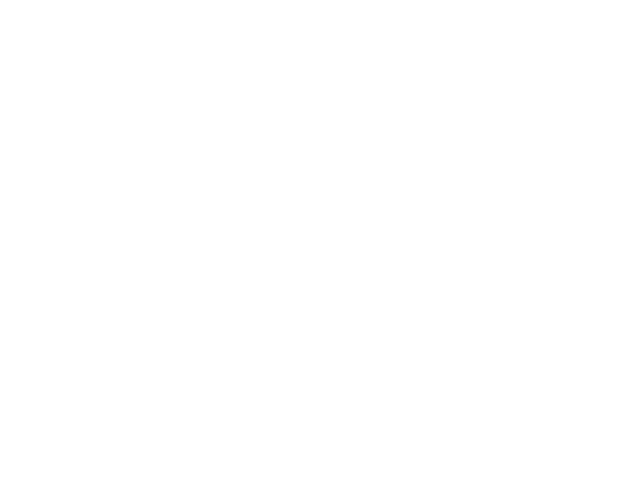

Chosen 85065
Predict is run


<IPython.core.display.Javascript object>


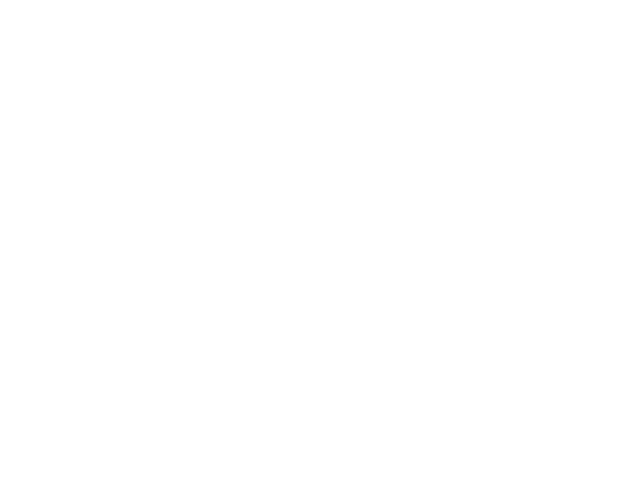

Sensor 85065
Errors:  15  ( 0.00373412994772 )
BIC - raw: -19816.5429498  BIC - clean: -14821.8105705


<IPython.core.display.Javascript object>


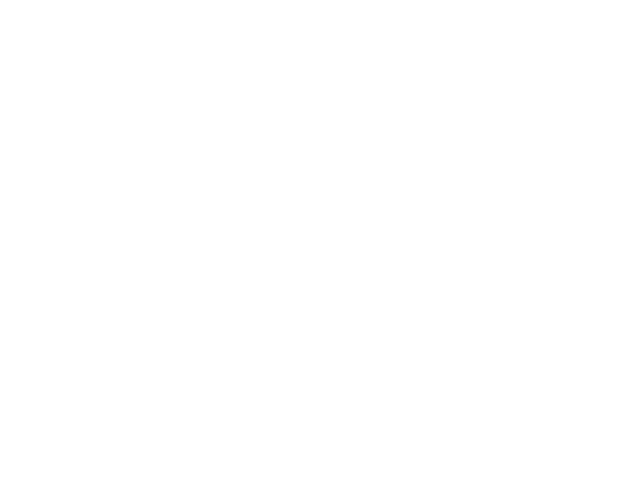

<class 'KeyError'>
('Value',)
Chosen 95032
Predict is run


<IPython.core.display.Javascript object>


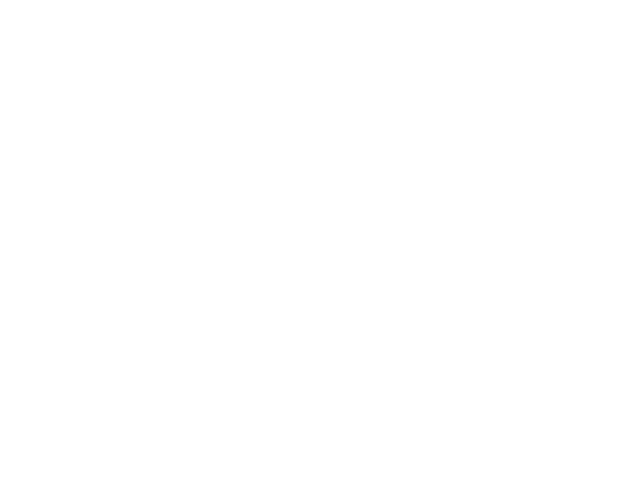

Sensor 95032
Errors:  30  ( 0.25 )
BIC - raw: -65.2207649893  BIC - clean: -58.947579065


<IPython.core.display.Javascript object>


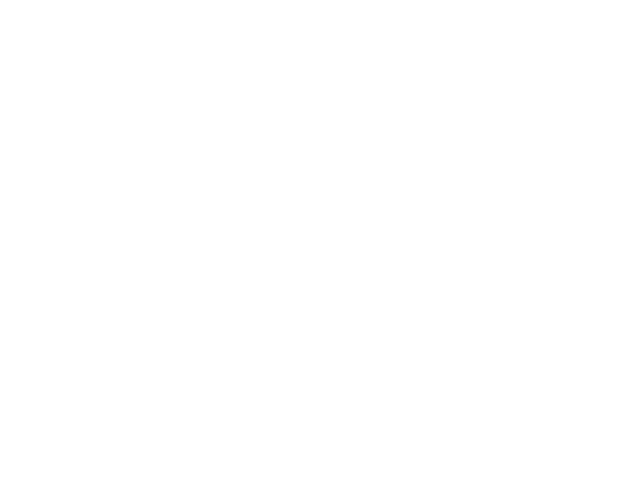

Chosen 85040
Predict is run


<IPython.core.display.Javascript object>


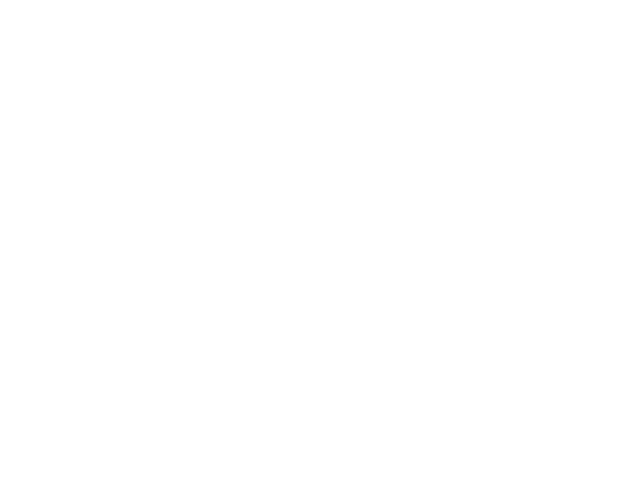

Sensor 85040
Errors:  193  ( 0.0120414275019 )
BIC - raw: -59820.0307487  BIC - clean: -45466.4540787


<IPython.core.display.Javascript object>


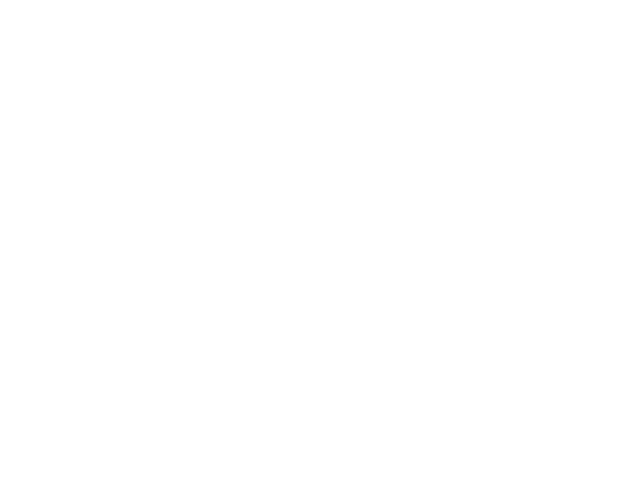

Chosen 17020
Predict is run


<IPython.core.display.Javascript object>


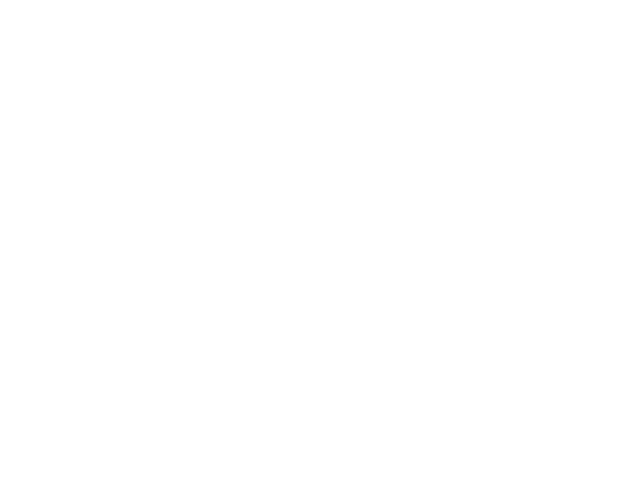

Sensor 17020
Errors:  6  ( 0.00890207715134 )
BIC - raw: -3408.18382465  BIC - clean: -3318.2675888


<IPython.core.display.Javascript object>


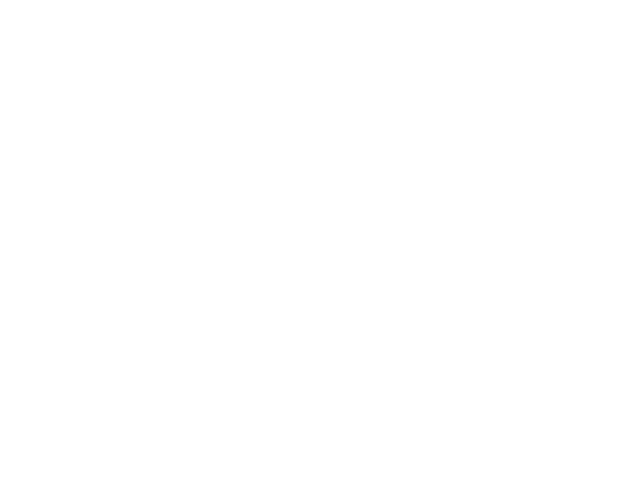

Chosen 85069
Predict is run


<IPython.core.display.Javascript object>


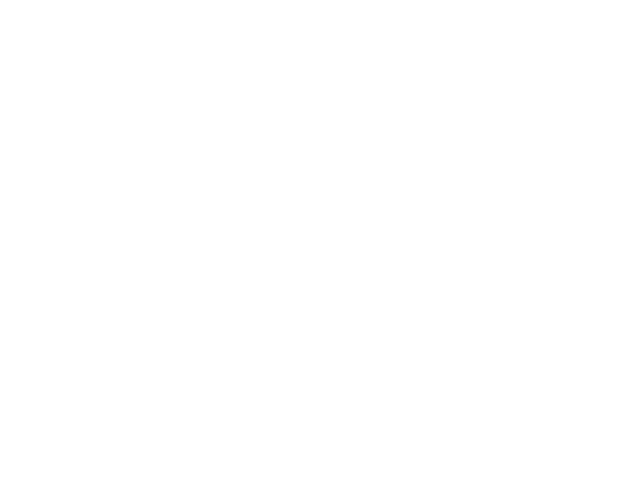

Sensor 85069
Errors:  5  ( 0.00683994528044 )
BIC - raw: -4322.66161952  BIC - clean: -4322.66161952


<IPython.core.display.Javascript object>


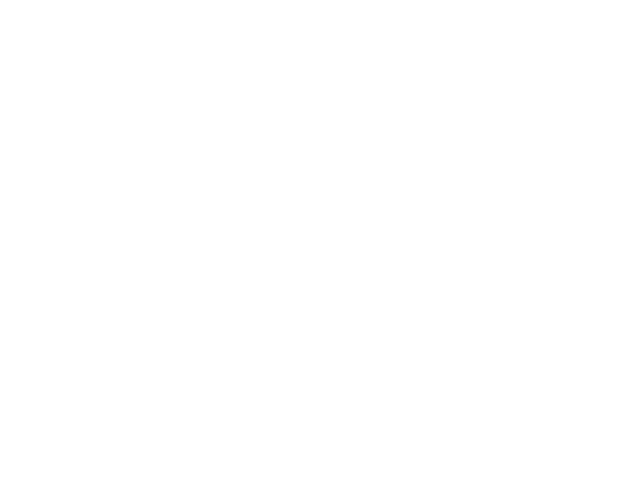

Chosen 85050
Predict is run


<IPython.core.display.Javascript object>


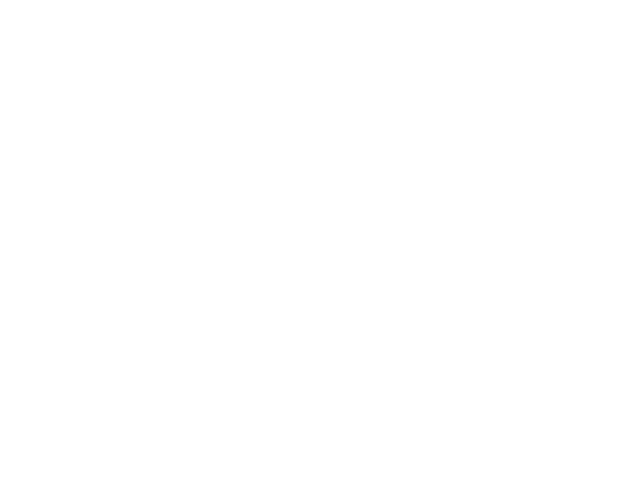

Sensor 85050
Errors:  152  ( 0.0189148830264 )
BIC - raw: -25452.5834899  BIC - clean: -15864.2495345


<IPython.core.display.Javascript object>


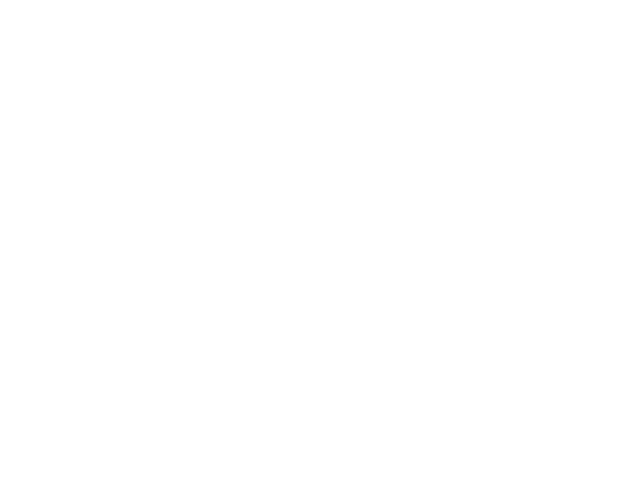

Chosen 85054
Predict is run


<IPython.core.display.Javascript object>


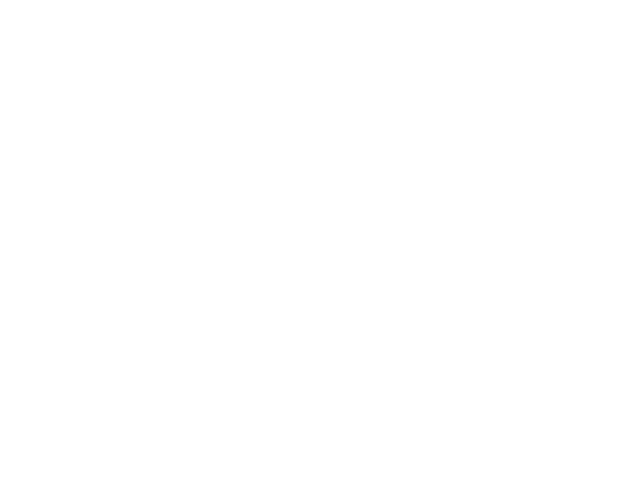

Sensor 85054
Errors:  13  ( 0.00243309002433 )
BIC - raw: -27577.8468082  BIC - clean: -25396.8351179


<IPython.core.display.Javascript object>


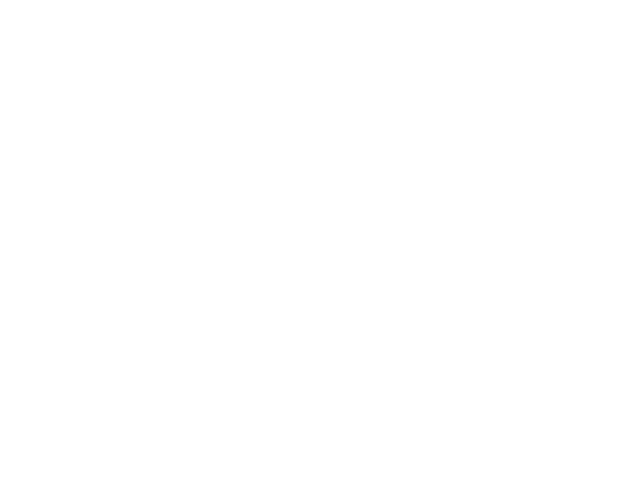

Chosen 90090
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 90022
Predict is run


<IPython.core.display.Javascript object>


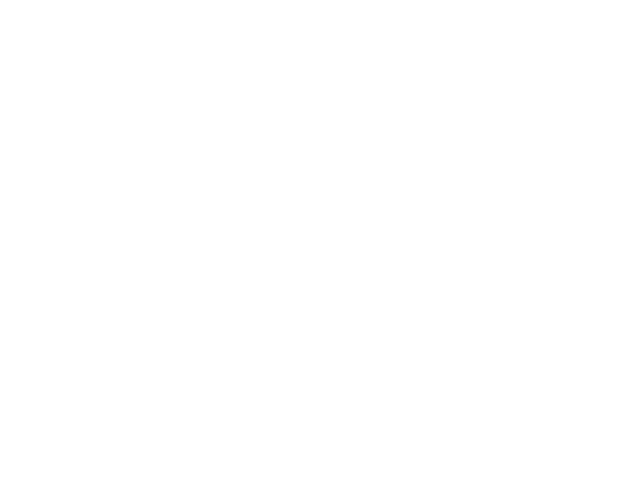

Sensor 90022
Errors:  8  ( 0.0555555555556 )
BIC - raw: -61.6790439834  BIC - clean: -57.3150311901


<IPython.core.display.Javascript object>


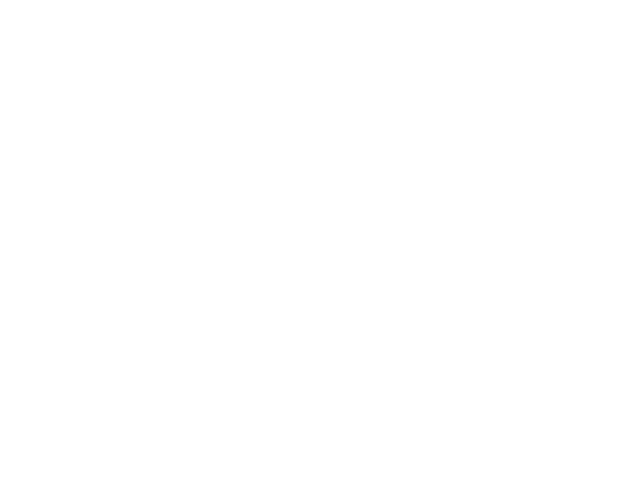

Chosen 30184
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 90026
Predict is run


<IPython.core.display.Javascript object>


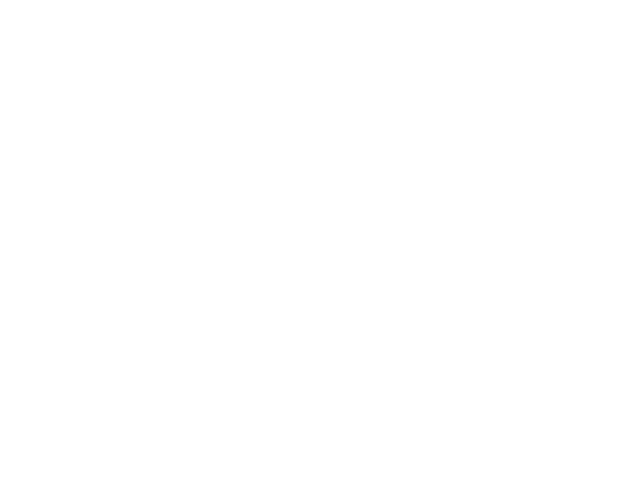

Sensor 90026
Errors:  19  ( 0.131944444444 )
BIC - raw: 83.9404013779  BIC - clean: 94.1829810364


<IPython.core.display.Javascript object>


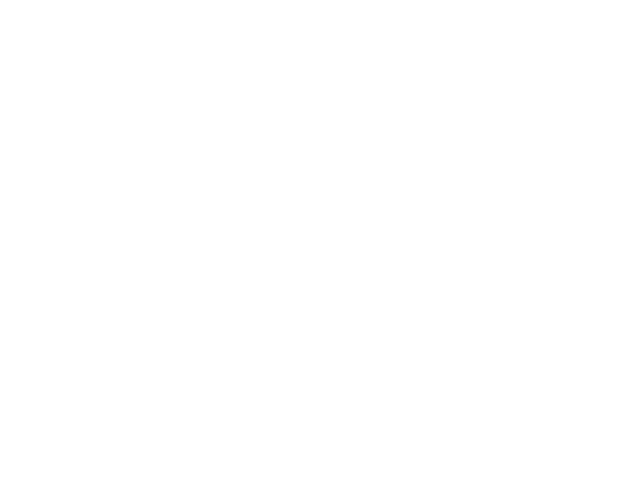

Chosen 90048
Predict is run


<IPython.core.display.Javascript object>


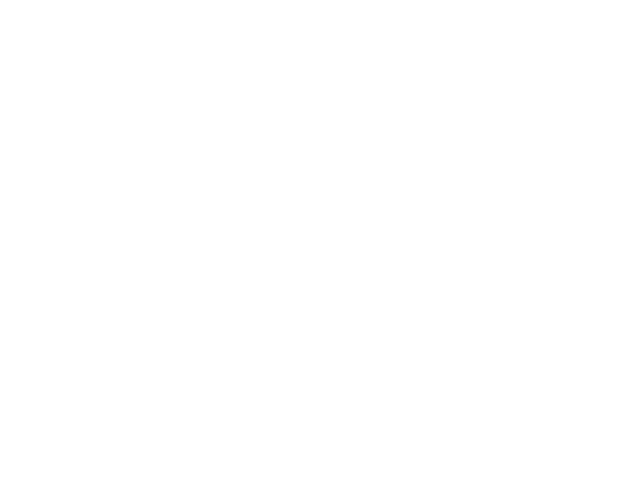

Sensor 90048
Errors:  5  ( 0.0126262626263 )
BIC - raw: -2092.87508835  BIC - clean: -2092.87508835


<IPython.core.display.Javascript object>


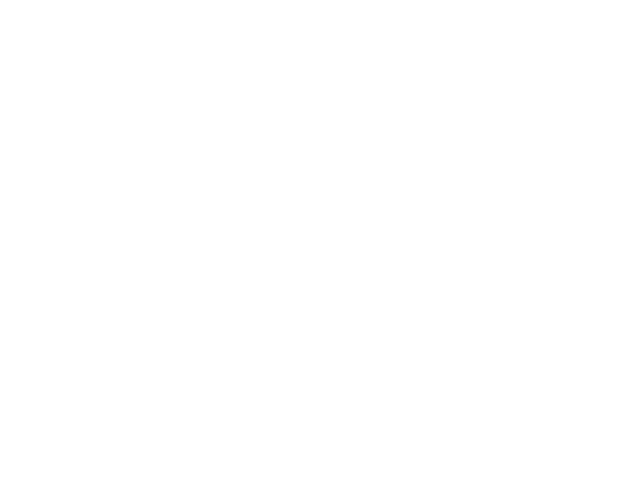

Chosen 90096
Predict is run


<IPython.core.display.Javascript object>


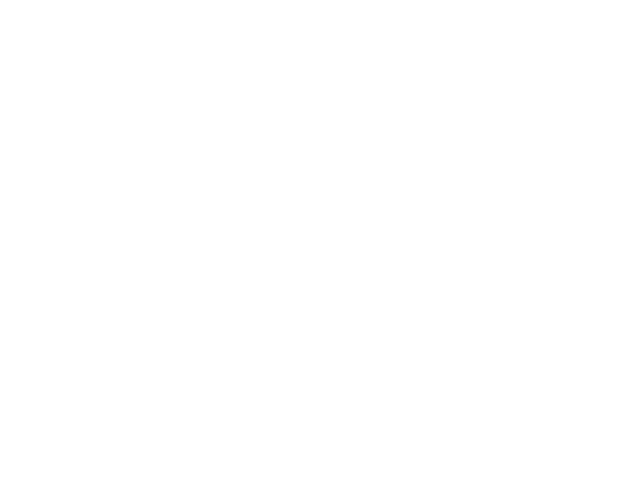

Sensor 90096
Errors:  21  ( 0.144827586207 )
BIC - raw: 110.831807961  BIC - clean: 97.9480418046


<IPython.core.display.Javascript object>


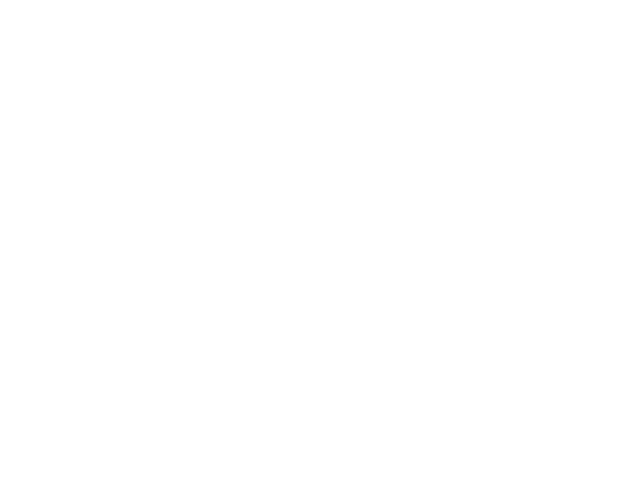

Chosen 90097
Predict is run


<IPython.core.display.Javascript object>


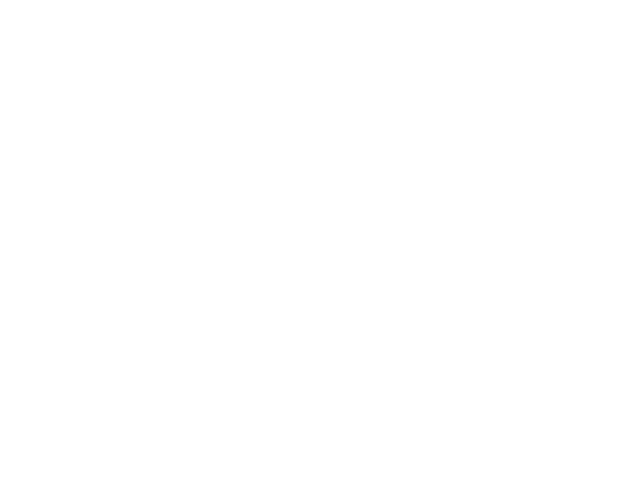

Sensor 90097
Errors:  11  ( 0.0753424657534 )
BIC - raw: 12.010910561  BIC - clean: -19.6634300171


<IPython.core.display.Javascript object>


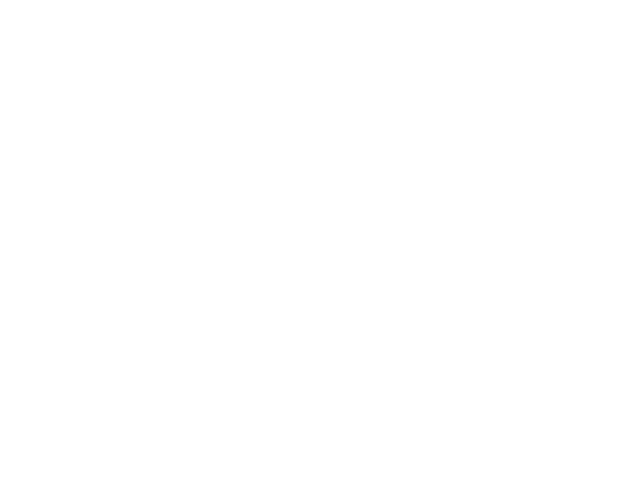

Chosen 85011
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 90042
Predict is run


<IPython.core.display.Javascript object>


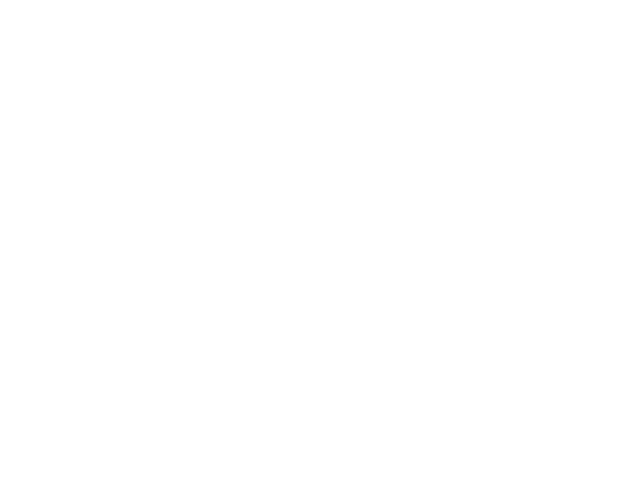

Sensor 90042
Errors:  13  ( 0.0902777777778 )
BIC - raw: 88.2422622809  BIC - clean: 85.3315779668


<IPython.core.display.Javascript object>


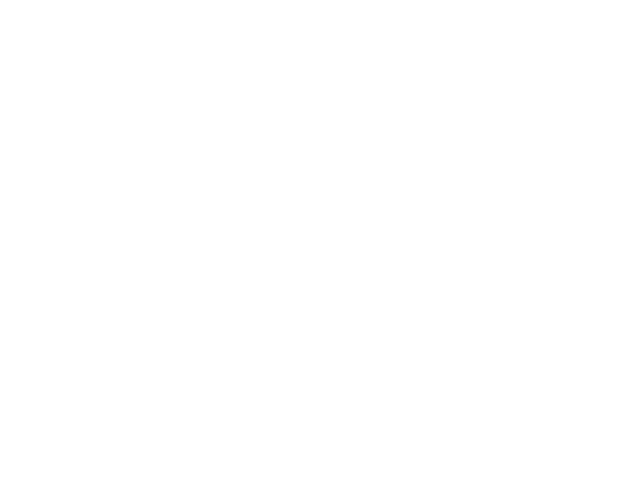

<class 'KeyError'>
('Value',)
Chosen 90079
Predict is run


<IPython.core.display.Javascript object>


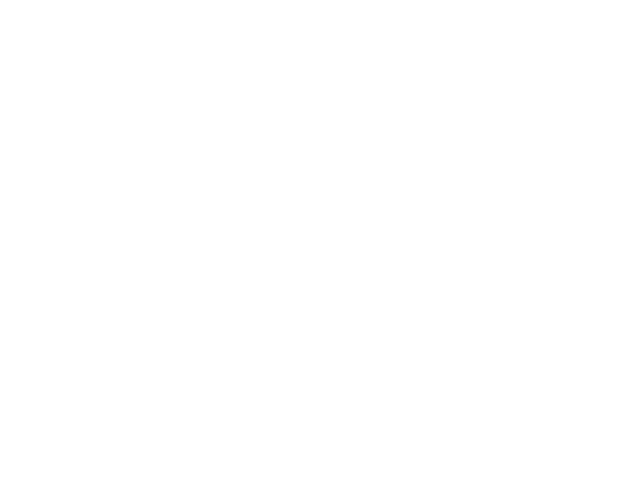

Sensor 90079
Errors:  5  ( 0.0462962962963 )
BIC - raw: -46.6642643094  BIC - clean: -45.9534745753


<IPython.core.display.Javascript object>


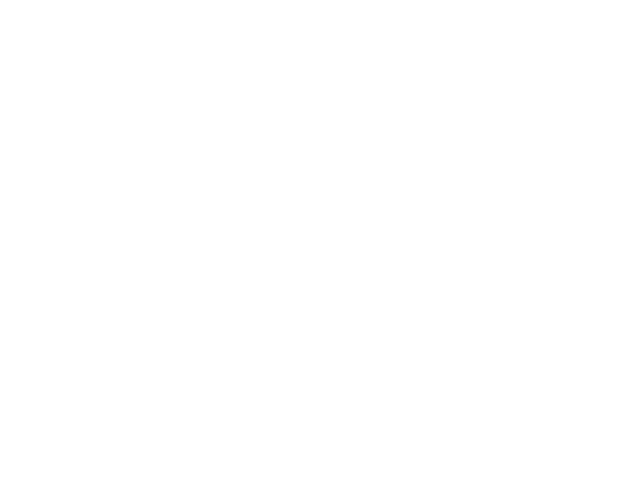

<class 'KeyError'>
('Value',)
Chosen 90103
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
Chosen 90030
Predict is run


<IPython.core.display.Javascript object>


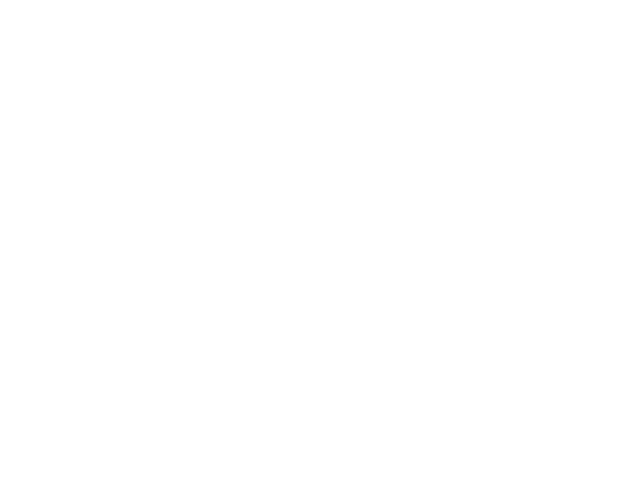

Sensor 90030
Errors:  33  ( 0.634615384615 )
BIC - raw: 177.876393952  BIC - clean: 176.121974187


<IPython.core.display.Javascript object>


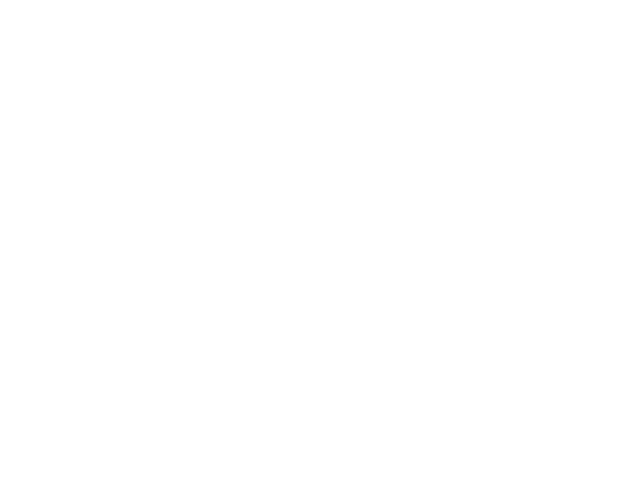

Chosen 80101
Predict is run


<IPython.core.display.Javascript object>


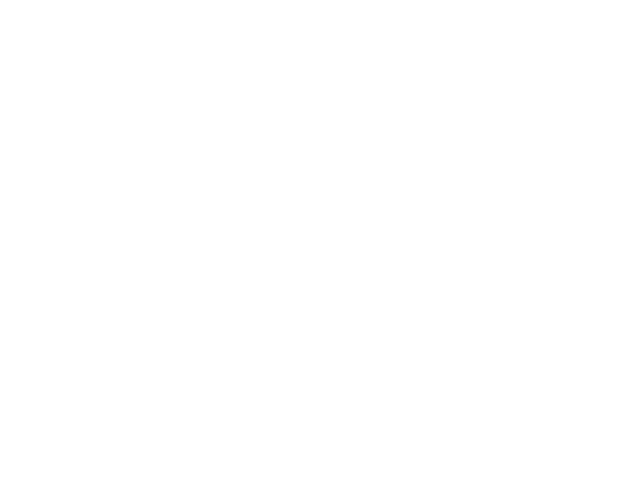

Sensor 80101
Errors:  80  ( 0.0558659217877 )
BIC - raw: -1977.98532394  BIC - clean: -1636.53112858


<IPython.core.display.Javascript object>


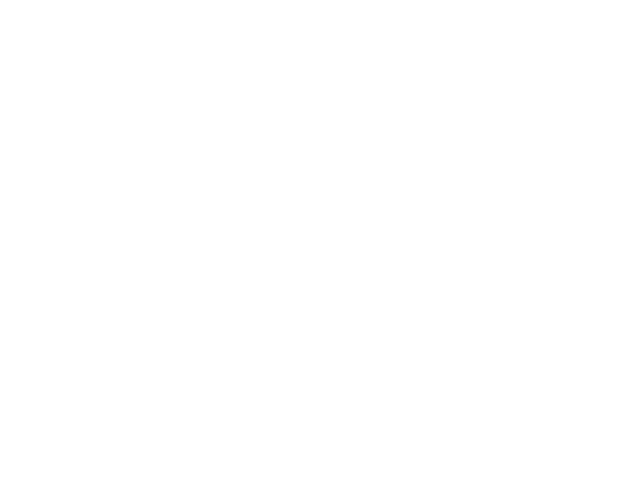

Chosen 90015
Predict is run


<IPython.core.display.Javascript object>


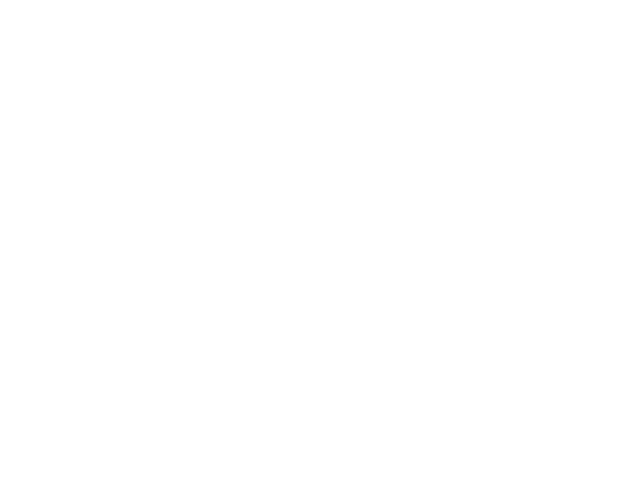

Sensor 90015
Errors:  5  ( 0.0161290322581 )
BIC - raw: -1034.96718439  BIC - clean: -1034.96718439


<IPython.core.display.Javascript object>


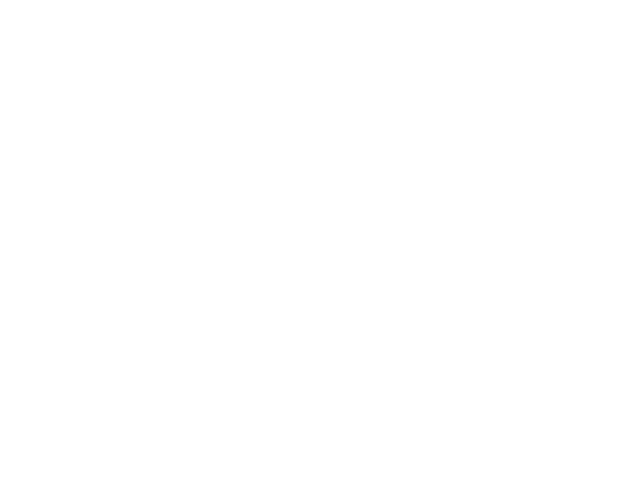

Chosen 85032
Predict is run


<IPython.core.display.Javascript object>


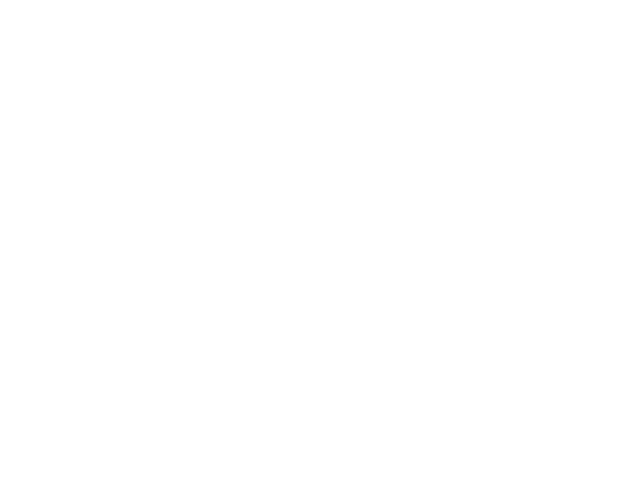

Sensor 85032
Errors:  6  ( 0.00831024930748 )
BIC - raw: -2086.14182767  BIC - clean: -2139.45941473


<IPython.core.display.Javascript object>


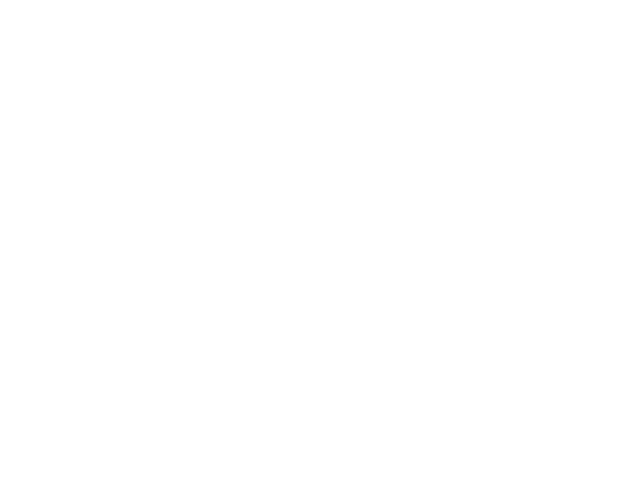

Chosen 50012
Predict is run


<IPython.core.display.Javascript object>


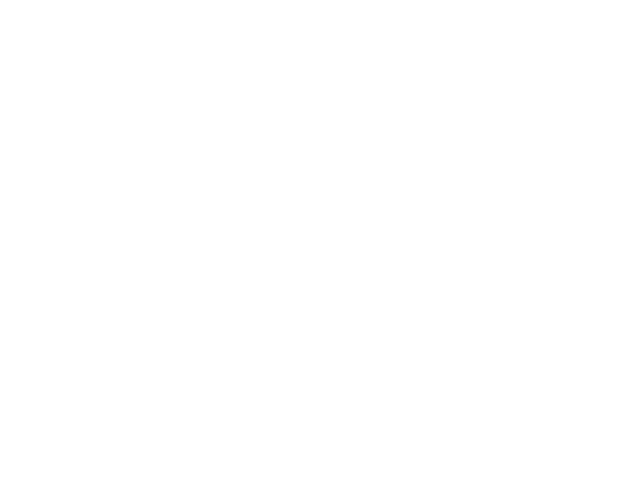

Sensor 50012
Errors:  5  ( 0.0125 )
BIC - raw: -2508.54286288  BIC - clean: -2508.54286288


<IPython.core.display.Javascript object>


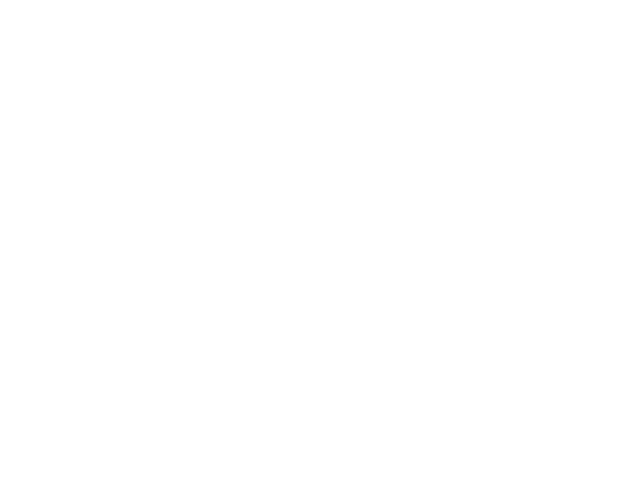

Chosen 90055
Predict is run


<IPython.core.display.Javascript object>


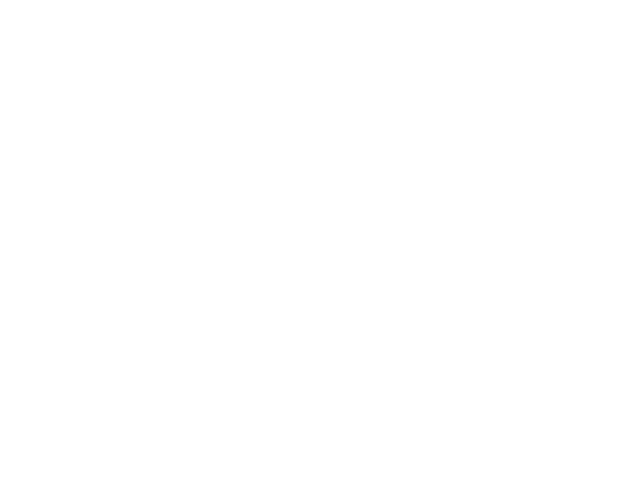

Sensor 90055
Errors:  20  ( 0.666666666667 )
BIC - raw: 59.9243227115  BIC - clean: 59.0067576686


<IPython.core.display.Javascript object>


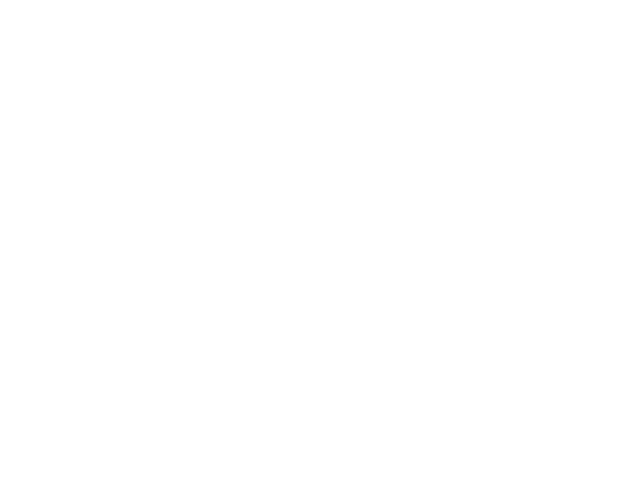

Chosen 90101
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 95049
Predict is run


<IPython.core.display.Javascript object>


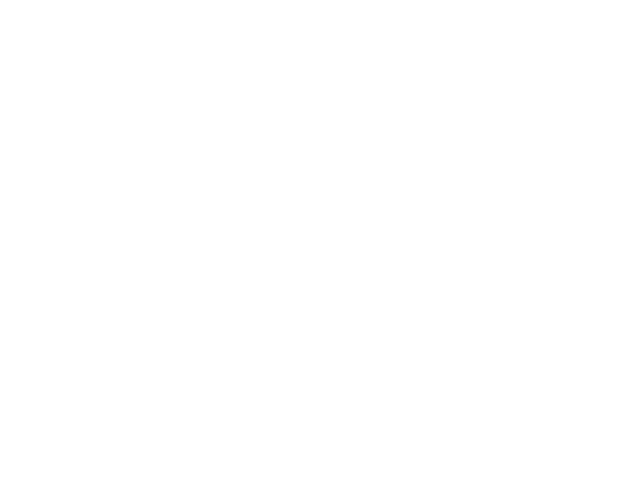

Sensor 95049
Errors:  41  ( 0.341666666667 )
BIC - raw: 105.300241019  BIC - clean: 151.982915783


<IPython.core.display.Javascript object>


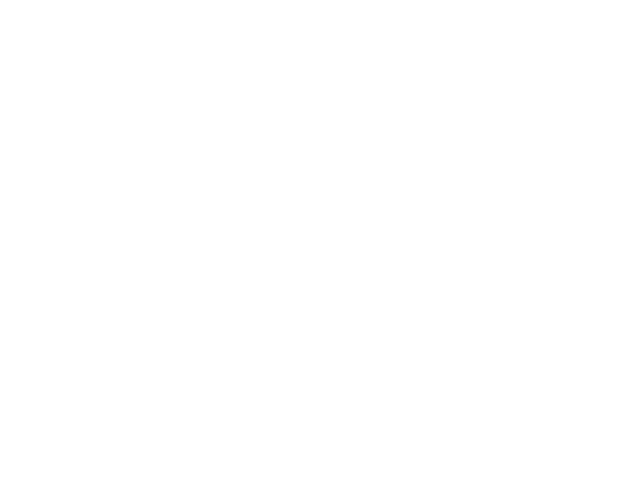

Chosen 50005
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 50032
Predict is run


<IPython.core.display.Javascript object>


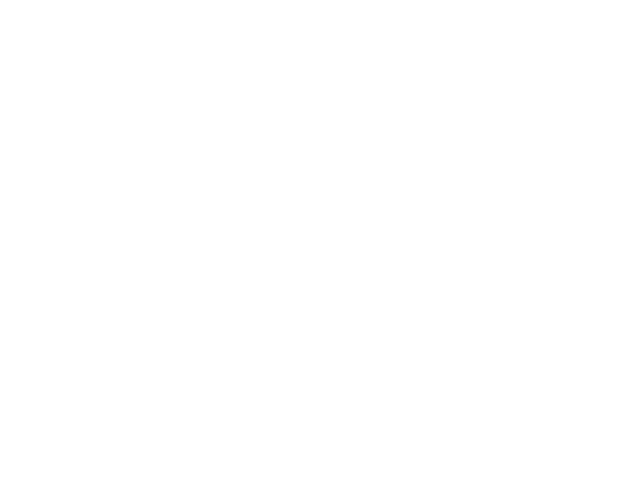

Sensor 50032
Errors:  14  ( 0.0305010893246 )
BIC - raw: 7339.0560485  BIC - clean: 6680.98816835


<IPython.core.display.Javascript object>


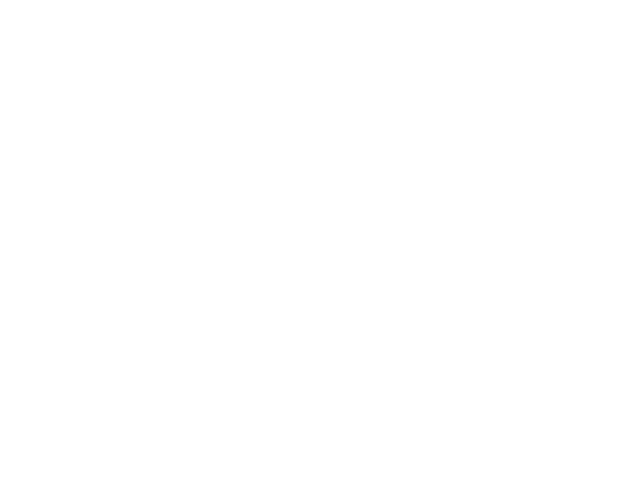

Chosen 50052
Predict is run


<IPython.core.display.Javascript object>


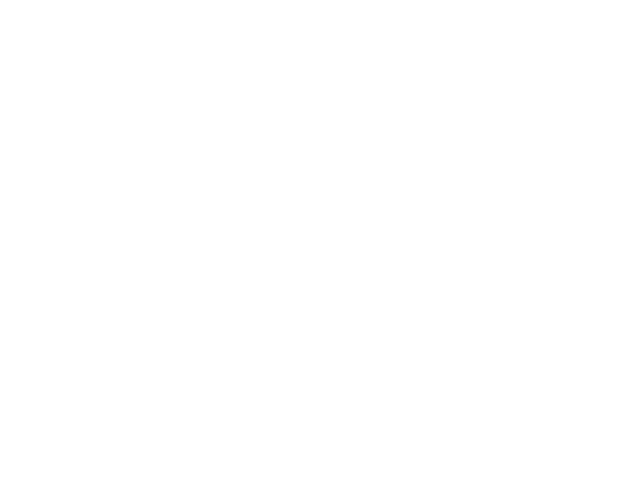

Sensor 50052
Errors:  6  ( 0.0130718954248 )
BIC - raw: -2846.18505263  BIC - clean: -2846.18505263


<IPython.core.display.Javascript object>


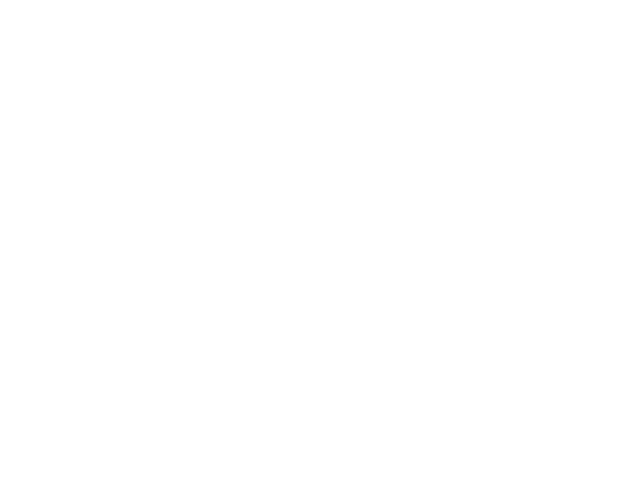

Chosen 85073
<class 'TypeError'>
("Cannot cast ufunc subtract output from dtype('float64') to dtype('int64') with casting rule 'same_kind'",)
Chosen 50075
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30170
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 50065
Predict is run


<IPython.core.display.Javascript object>


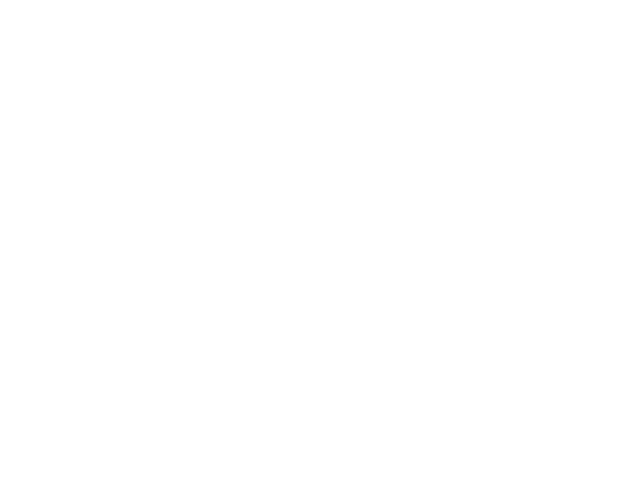

Sensor 50065
Errors:  62  ( 0.00546111160046 )
BIC - raw: 160900.026536  BIC - clean: 153206.805258


<IPython.core.display.Javascript object>


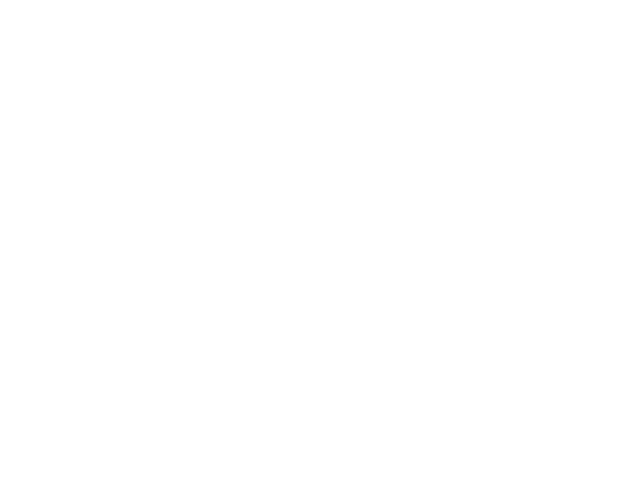

Chosen 50025
Predict is run


<IPython.core.display.Javascript object>


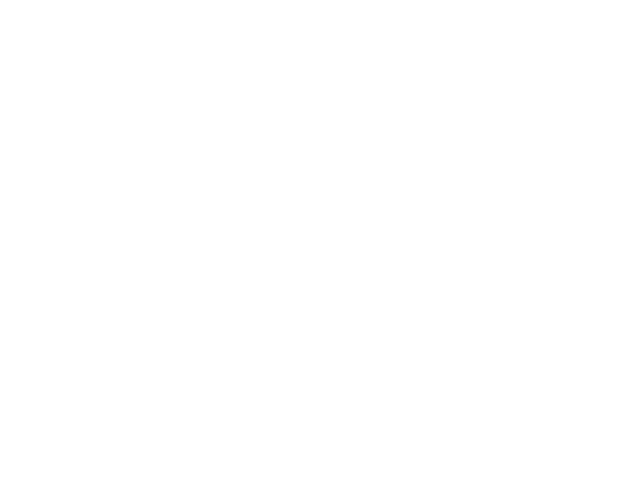

Sensor 50025
Errors:  161  ( 0.132838283828 )
BIC - raw: 6935.94564058  BIC - clean: 7530.01188292


<IPython.core.display.Javascript object>


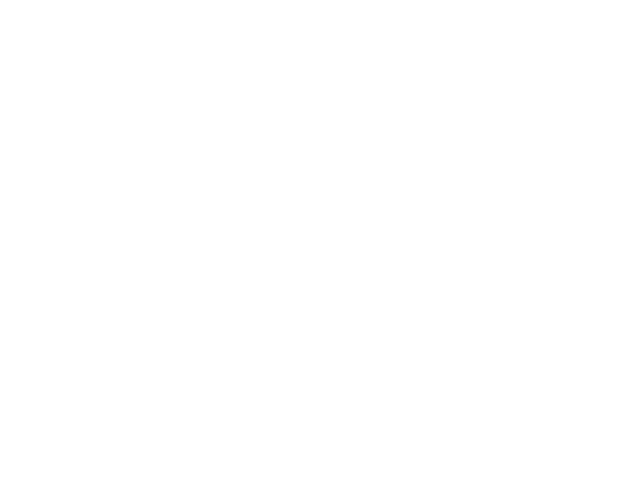

<class 'KeyError'>
('Value',)
Chosen 85064
Predict is run


<IPython.core.display.Javascript object>


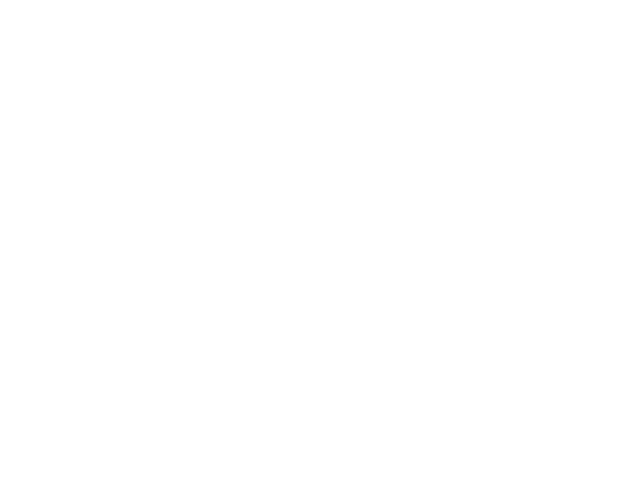

Sensor 85064
Errors:  24  ( 0.00597460791636 )
BIC - raw: -17298.9098862  BIC - clean: -12561.584824


<IPython.core.display.Javascript object>


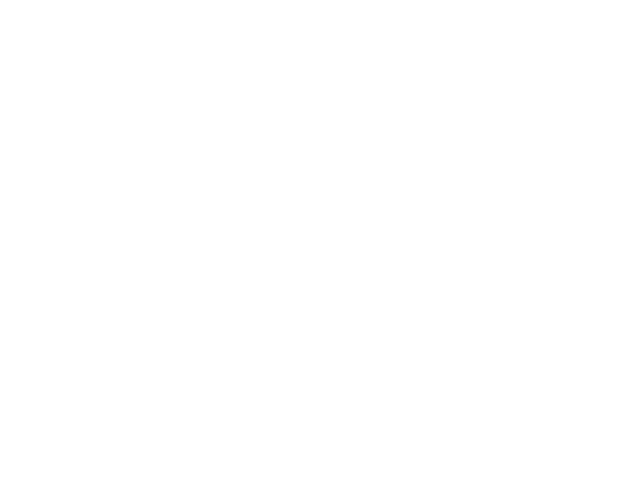

Chosen 50018
Predict is run


<IPython.core.display.Javascript object>


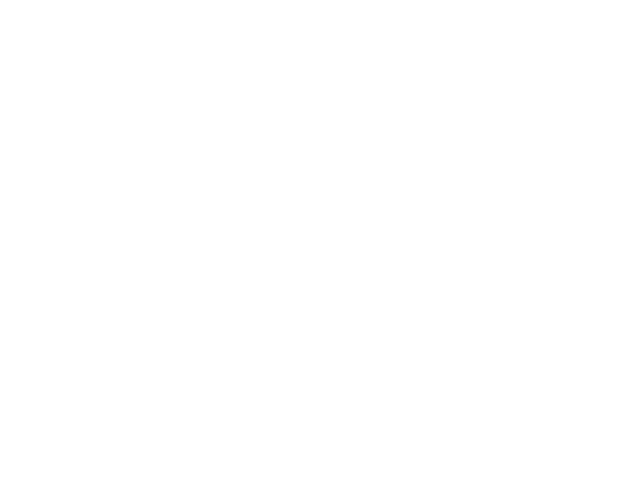

Sensor 50018
Errors:  98  ( 0.291666666667 )
BIC - raw: 145.18773856  BIC - clean: 301.073178713


<IPython.core.display.Javascript object>


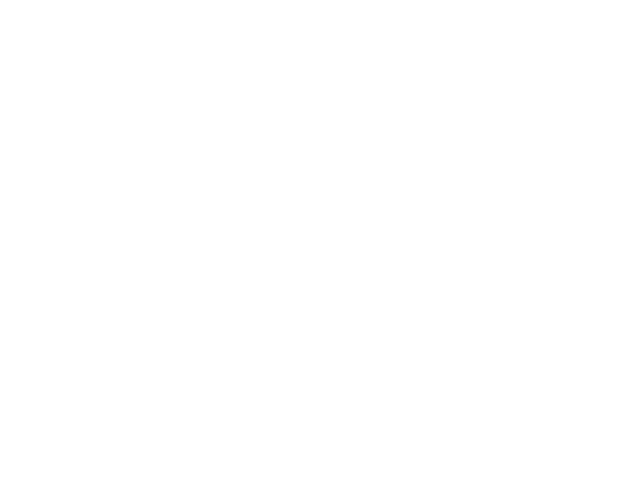

Chosen 50088
Predict is run


<IPython.core.display.Javascript object>


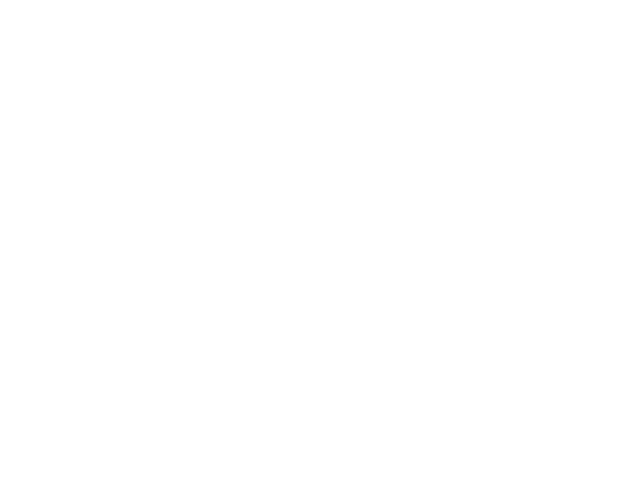

Sensor 50088
Errors:  12  ( 0.0261437908497 )
BIC - raw: -1711.34012002  BIC - clean: -1304.00119485


<IPython.core.display.Javascript object>


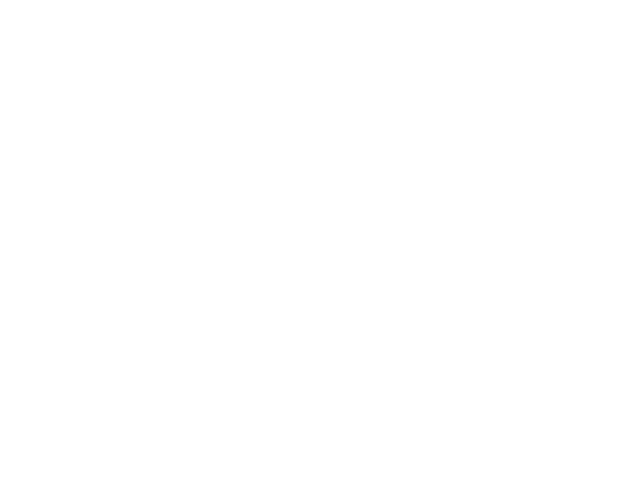

Chosen 90095
Predict is run


<IPython.core.display.Javascript object>


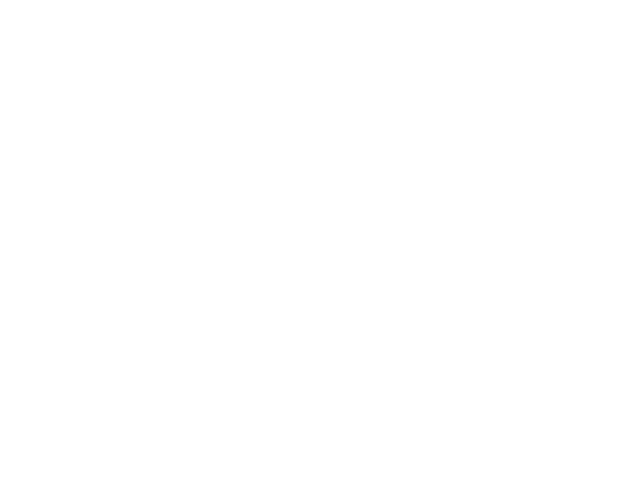

Sensor 90095
Errors:  13  ( 0.0915492957746 )
BIC - raw: 39.941078965  BIC - clean: 44.4316770944


<IPython.core.display.Javascript object>


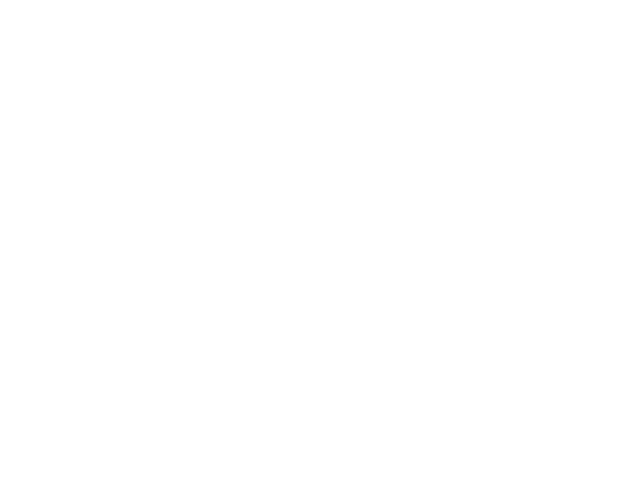

Chosen 90099
Predict is run


<IPython.core.display.Javascript object>


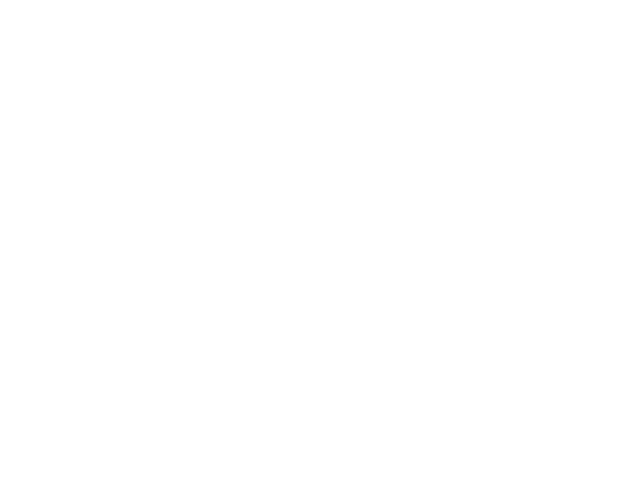

Sensor 90099
Errors:  11  ( 0.00252062328139 )
BIC - raw: -20933.5071912  BIC - clean: -15498.4338931


<IPython.core.display.Javascript object>


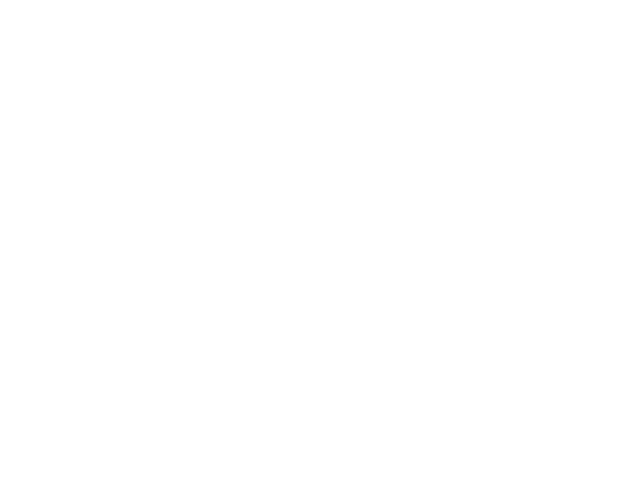

Chosen 50103
Predict is run


<IPython.core.display.Javascript object>


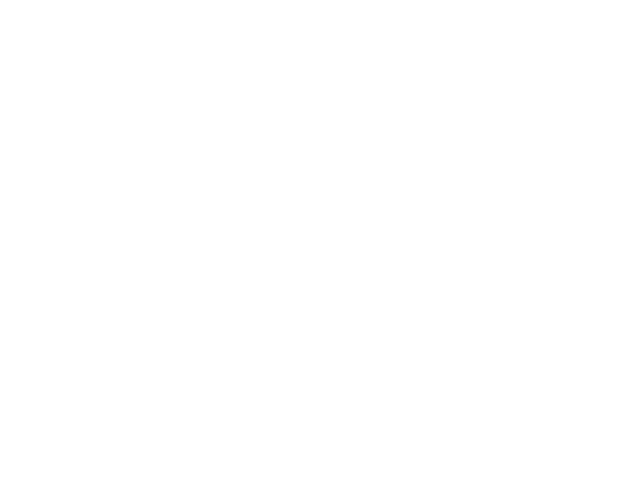

Sensor 50103
Errors:  263  ( 0.283100107643 )
BIC - raw: 585.971995003  BIC - clean: 1067.00976954


<IPython.core.display.Javascript object>


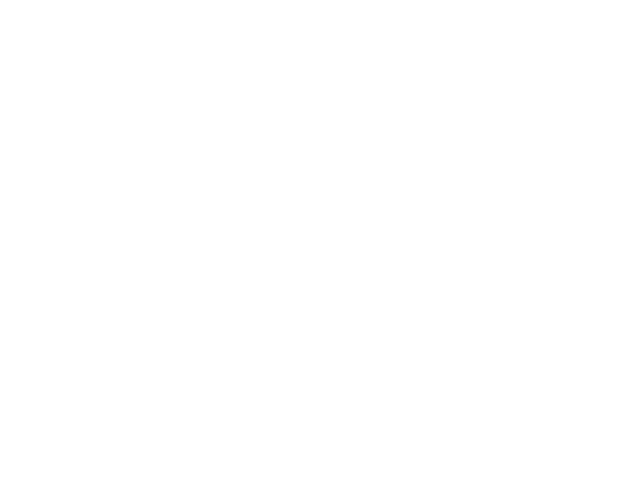

Chosen 50101
Predict is run


<IPython.core.display.Javascript object>


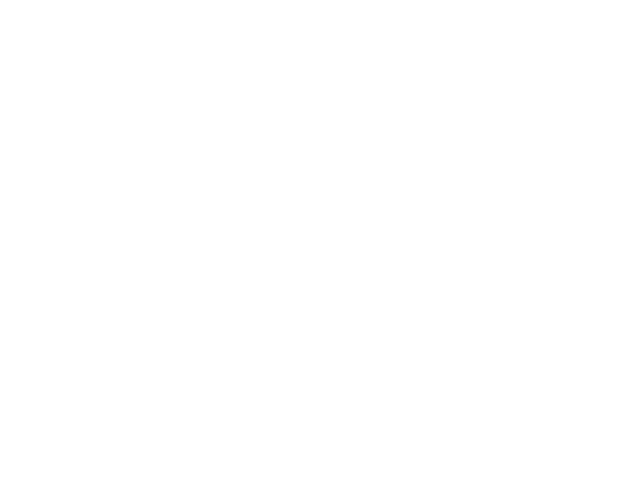

Sensor 50101
Errors:  12  ( 0.0181268882175 )
BIC - raw: -1701.15228763  BIC - clean: -1569.96889656


<IPython.core.display.Javascript object>


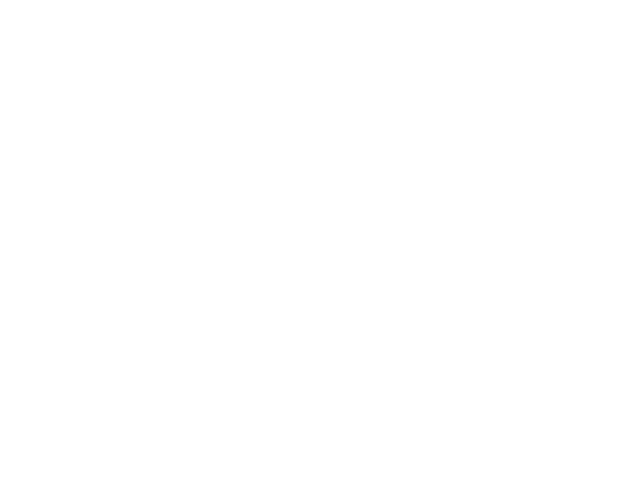

Chosen 50015
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 90089
Predict is run


<IPython.core.display.Javascript object>


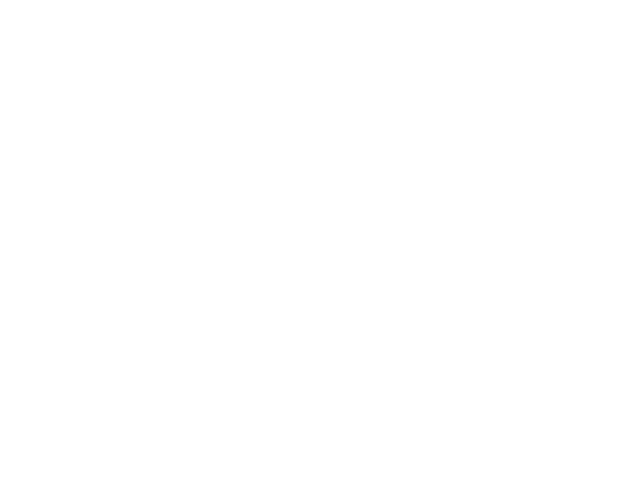

Sensor 90089
Errors:  4  ( 0.037037037037 )
BIC - raw: -103.327450064  BIC - clean: -103.327450064


<IPython.core.display.Javascript object>


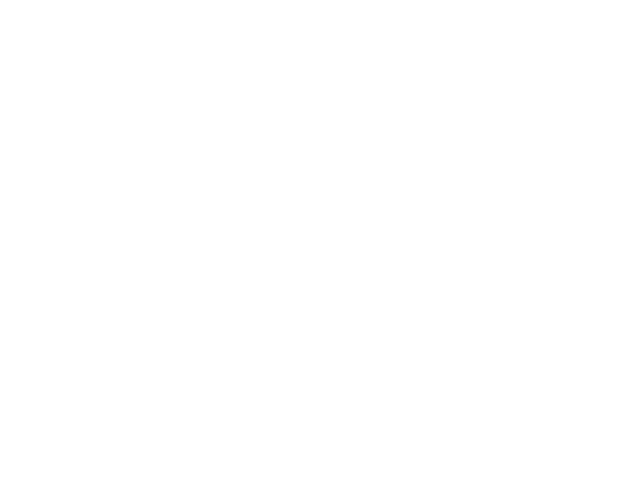

Chosen 15035
Predict is run


<IPython.core.display.Javascript object>


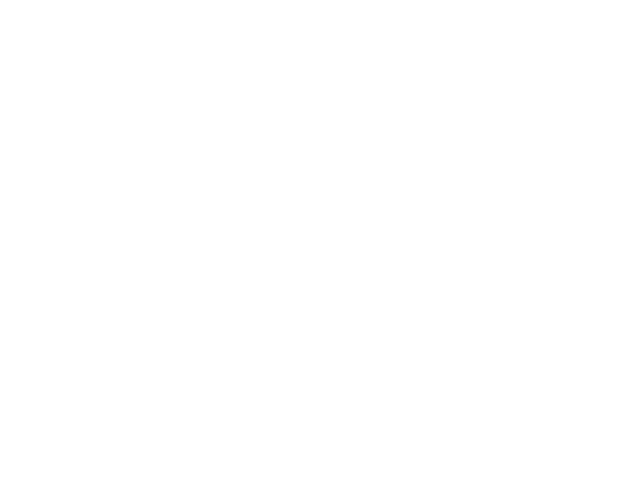

Sensor 15035
Errors:  22  ( 0.0698412698413 )
BIC - raw: -339.539432275  BIC - clean: -289.021409734


<IPython.core.display.Javascript object>


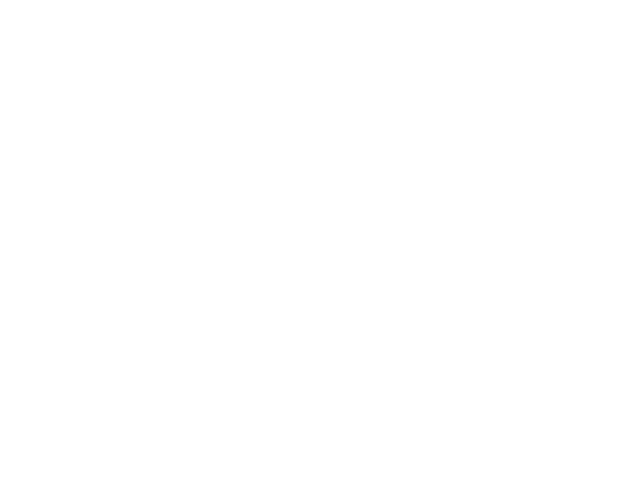

Chosen 50061
Predict is run


<IPython.core.display.Javascript object>


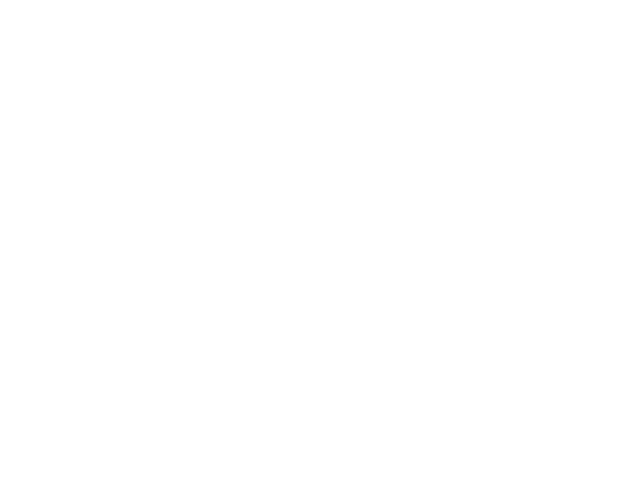

Sensor 50061
Errors:  43  ( 0.00313639679066 )
BIC - raw: -68108.3856992  BIC - clean: -63639.503625


<IPython.core.display.Javascript object>


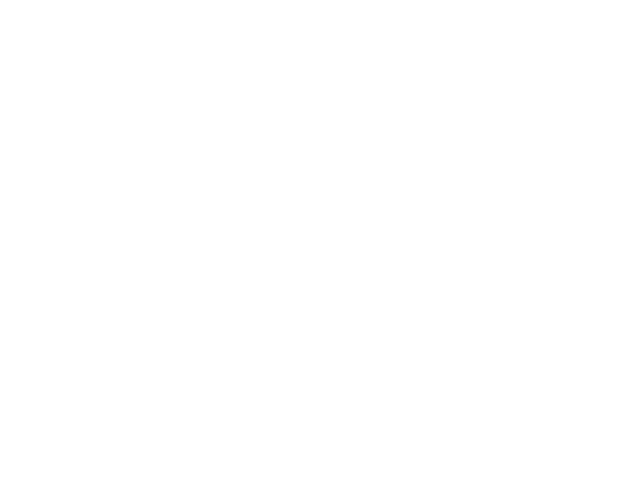

Chosen 85076
<class 'TypeError'>
("Cannot cast ufunc subtract output from dtype('float64') to dtype('int64') with casting rule 'same_kind'",)
Chosen 50087
Predict is run


<IPython.core.display.Javascript object>


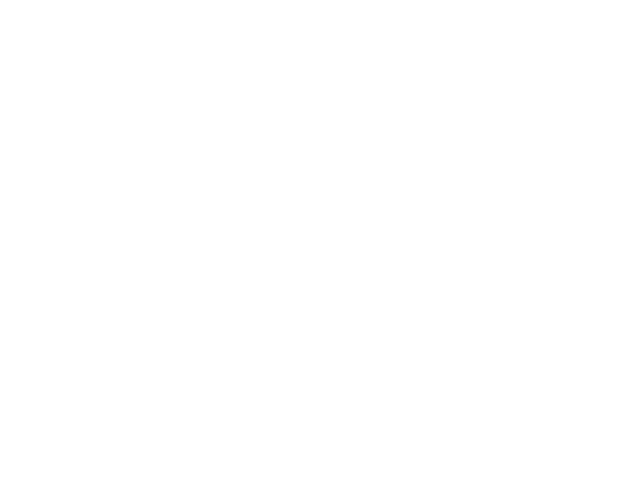

Sensor 50087
Errors:  17  ( 0.0787037037037 )
BIC - raw: -277.948032574  BIC - clean: -227.373546887


<IPython.core.display.Javascript object>


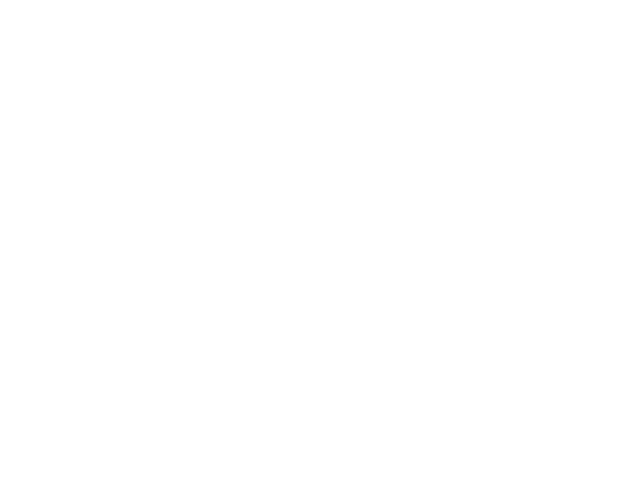

Chosen 70036
Predict is run


<IPython.core.display.Javascript object>


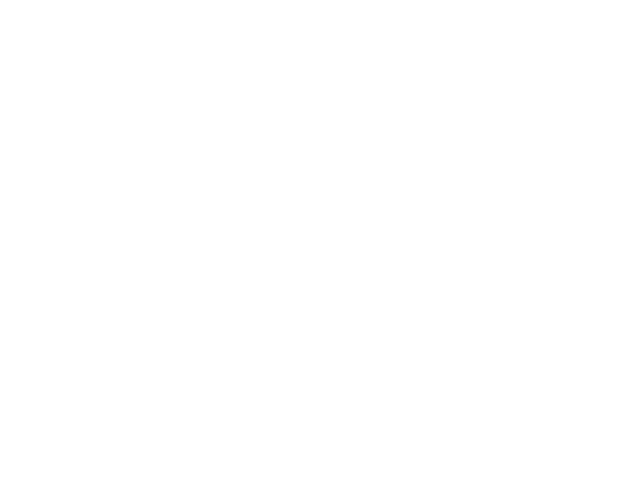

Sensor 70036
Errors:  8  ( 0.00729927007299 )
BIC - raw: -4789.47909605  BIC - clean: -3647.01722267


<IPython.core.display.Javascript object>


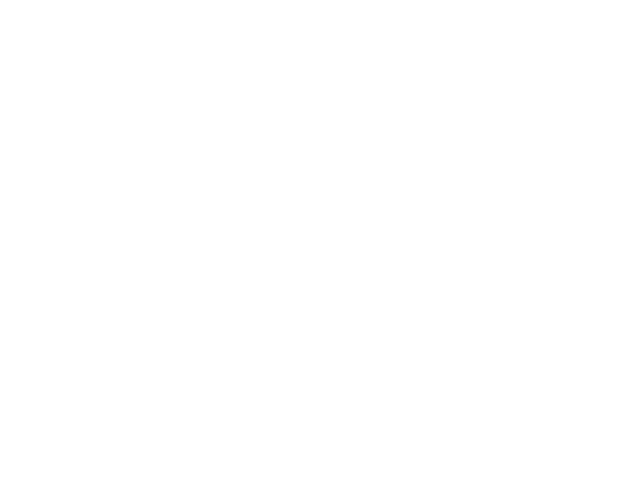

<class 'KeyError'>
('Value',)
Chosen 85039
Predict is run


<IPython.core.display.Javascript object>


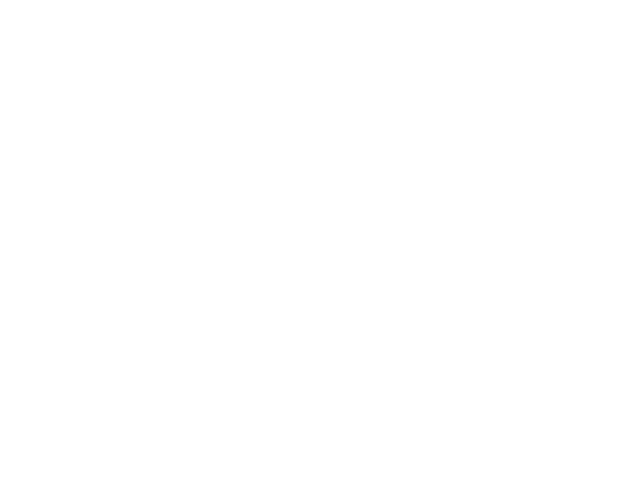

Sensor 85039
Errors:  41  ( 0.264516129032 )
BIC - raw: 2570.3806697  BIC - clean: 2571.08535823


<IPython.core.display.Javascript object>


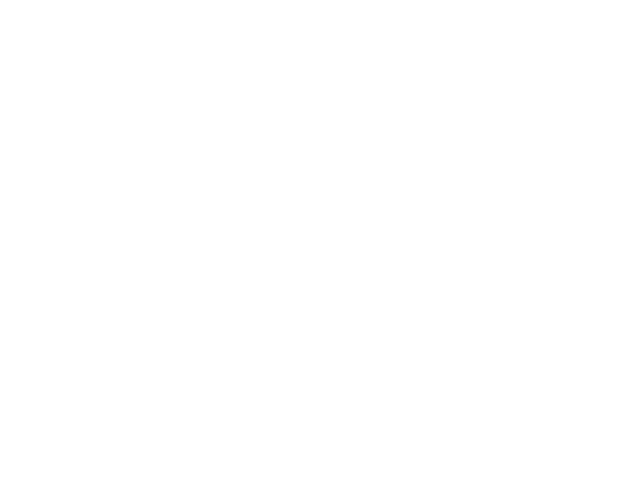

Chosen 70013
Predict is run


<IPython.core.display.Javascript object>


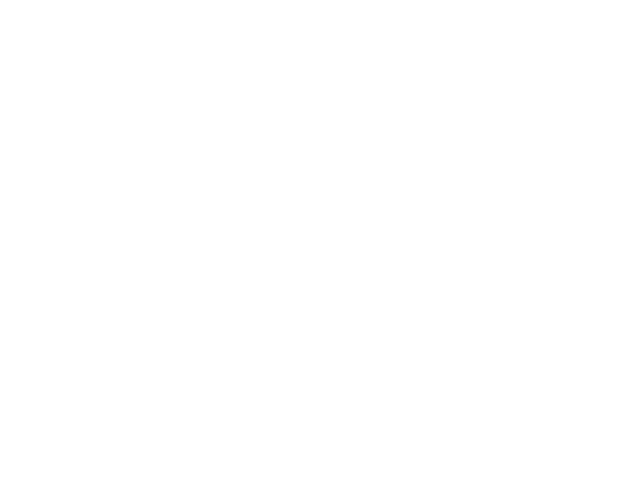

Sensor 70013
Errors:  4  ( 0.0126984126984 )
BIC - raw: -939.164896026  BIC - clean: -939.164896026


<IPython.core.display.Javascript object>


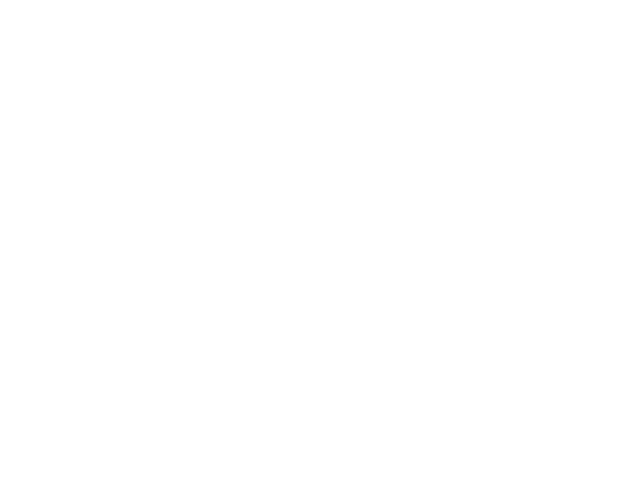

Chosen 70045
Predict is run


<IPython.core.display.Javascript object>


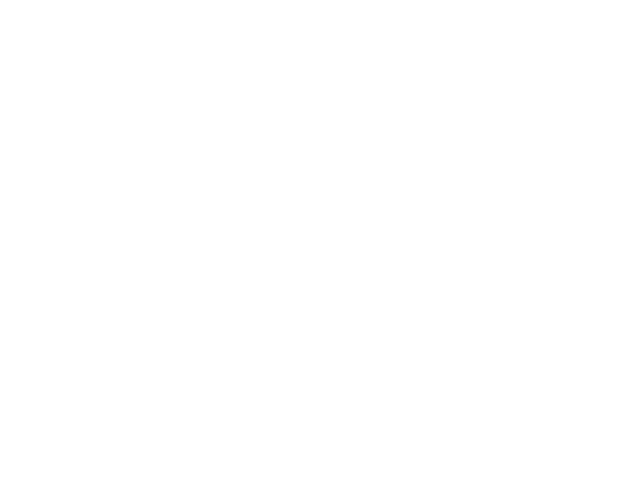

Sensor 70045
Errors:  513  ( 0.0433789954338 )
BIC - raw: -28379.2270756  BIC - clean: -21017.0535869


<IPython.core.display.Javascript object>


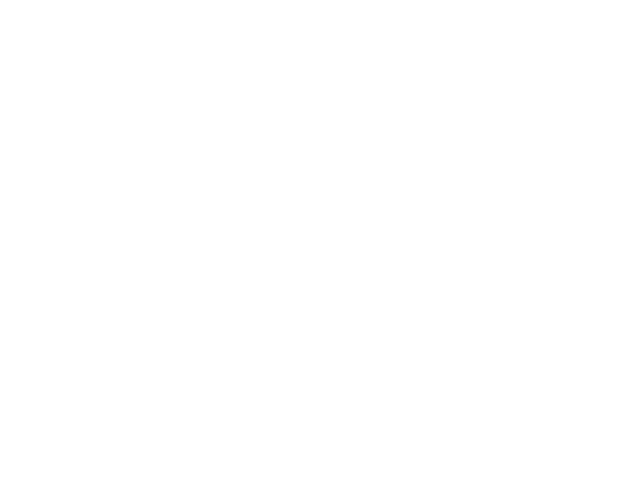

Chosen 15103
Predict is run


<IPython.core.display.Javascript object>


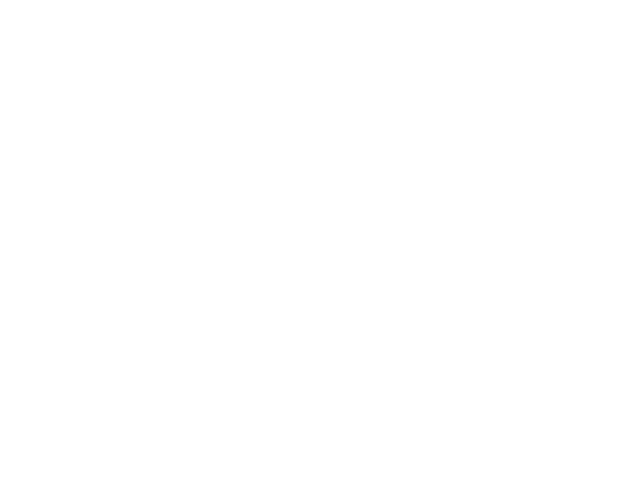

Sensor 15103
Errors:  25  ( 0.0374251497006 )
BIC - raw: -1313.62016315  BIC - clean: -1186.83067141


<IPython.core.display.Javascript object>


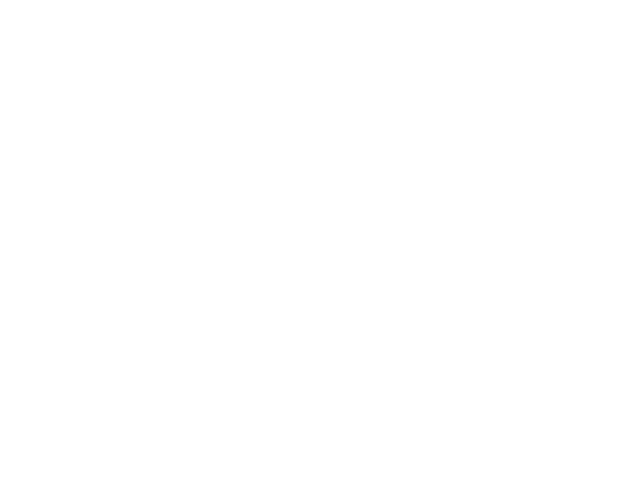

<class 'KeyError'>
('Value',)
Chosen 85006
Predict is run


<IPython.core.display.Javascript object>


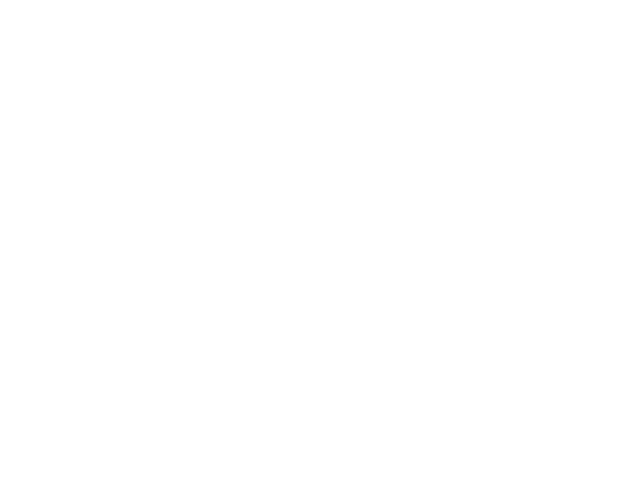

Sensor 85006
Errors:  5  ( 0.013698630137 )
BIC - raw: -1603.8330436  BIC - clean: -1603.8330436


<IPython.core.display.Javascript object>


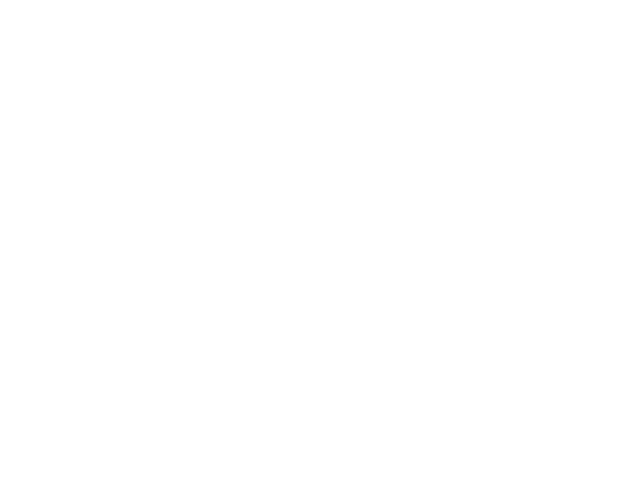

Chosen 70102
Predict is run


<IPython.core.display.Javascript object>


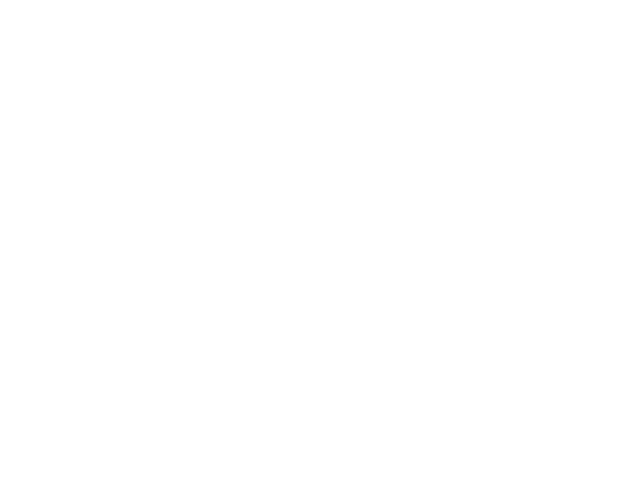

Sensor 70102
Errors:  454  ( 0.199911933069 )
BIC - raw: 678.82015056  BIC - clean: 1744.13979453


<IPython.core.display.Javascript object>


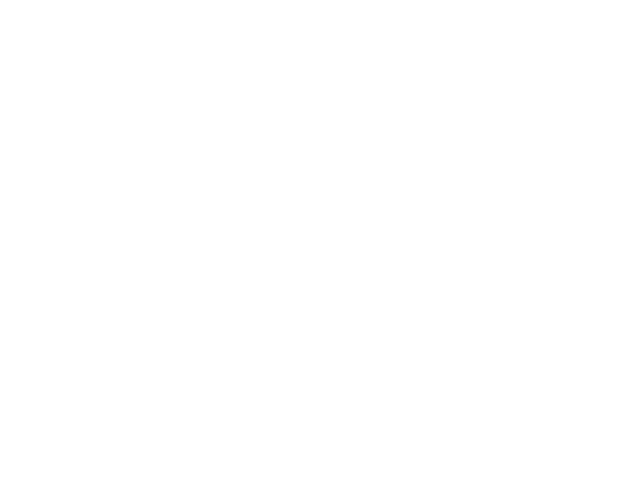

Chosen 70070
Predict is run


<IPython.core.display.Javascript object>


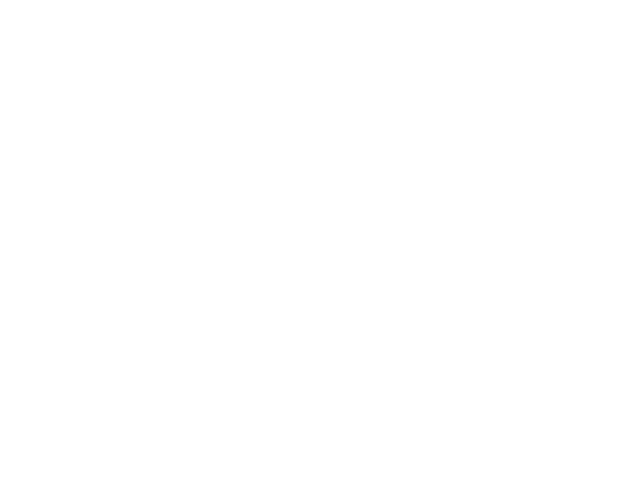

Sensor 70070
Errors:  108  ( 0.00717417297728 )
BIC - raw: 205319.554657  BIC - clean: 208361.974445


<IPython.core.display.Javascript object>


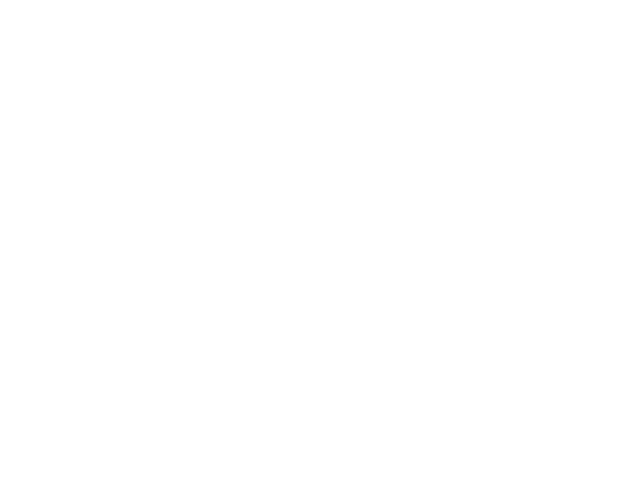

Chosen 80108
Predict is run


<IPython.core.display.Javascript object>


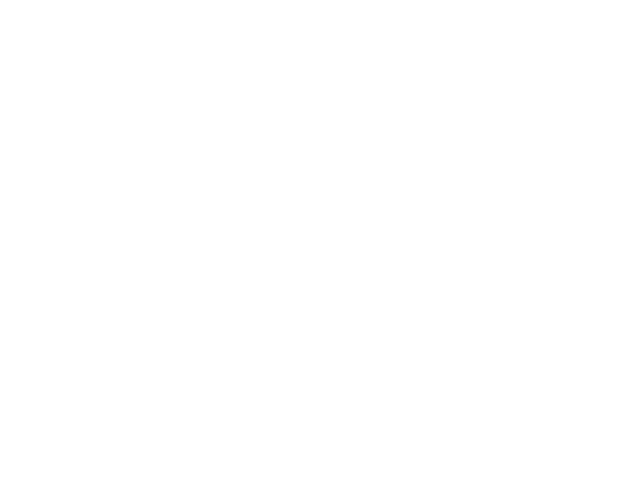

Sensor 80108
Errors:  18  ( 0.111111111111 )
BIC - raw: 365.287112309  BIC - clean: 296.904568131


<IPython.core.display.Javascript object>


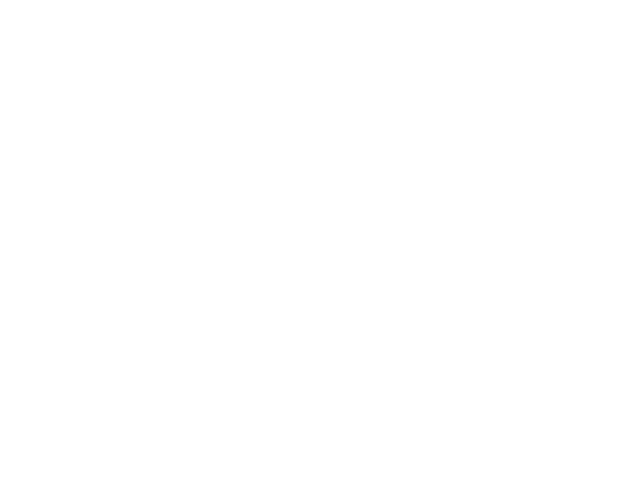

Chosen 85004
Predict is run


<IPython.core.display.Javascript object>


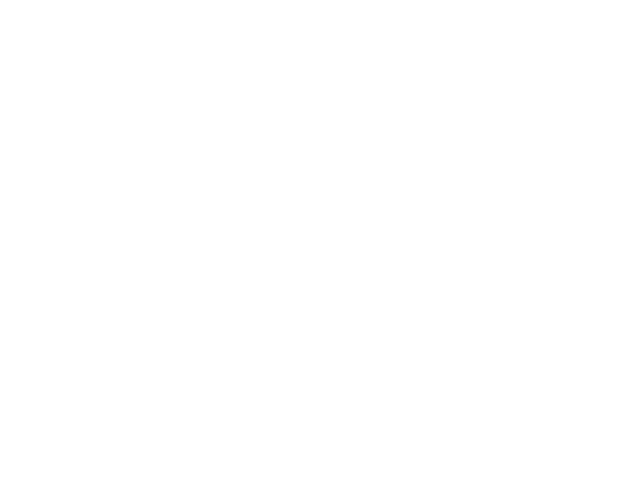

Sensor 85004
Errors:  19  ( 0.00621727748691 )
BIC - raw: -8145.71060185  BIC - clean: -7669.25351877


<IPython.core.display.Javascript object>


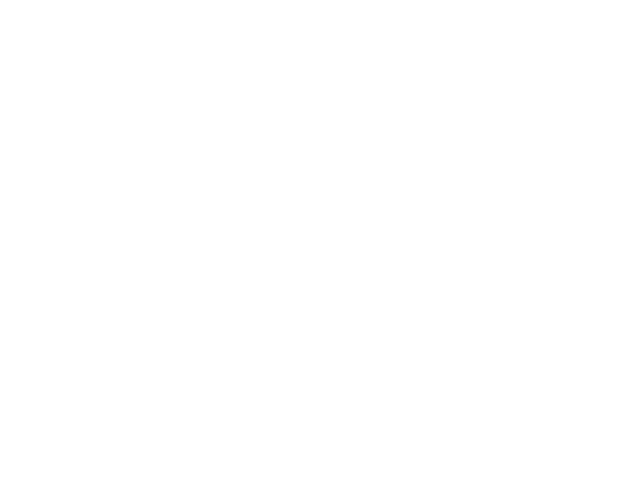

Chosen 80105
Predict is run


<IPython.core.display.Javascript object>


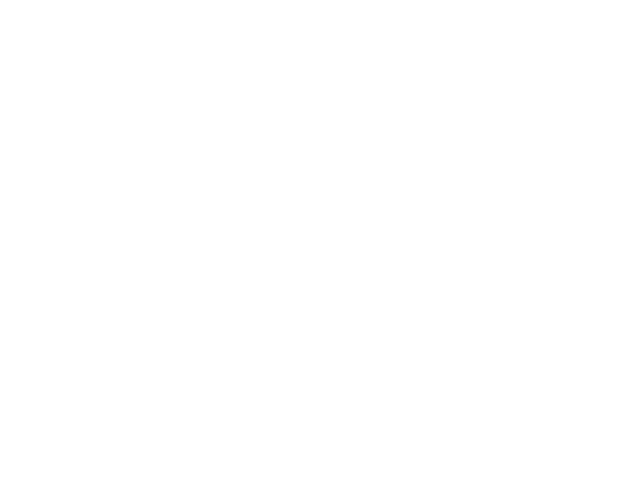

Sensor 80105
Errors:  15  ( 0.0931677018634 )
BIC - raw: 135.873137149  BIC - clean: 127.203118801


<IPython.core.display.Javascript object>


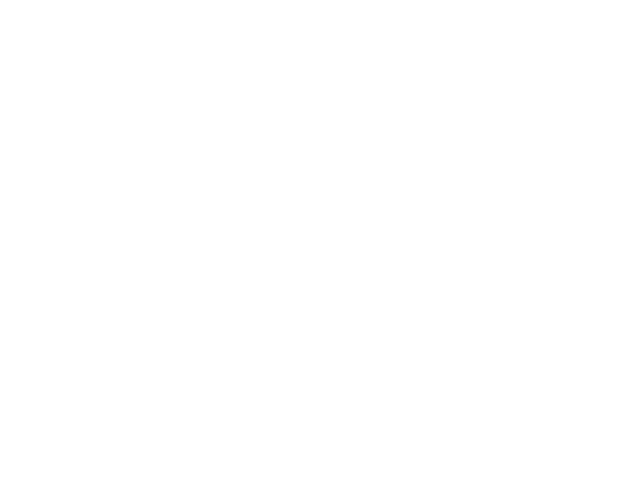

Chosen 70065
Predict is run


<IPython.core.display.Javascript object>


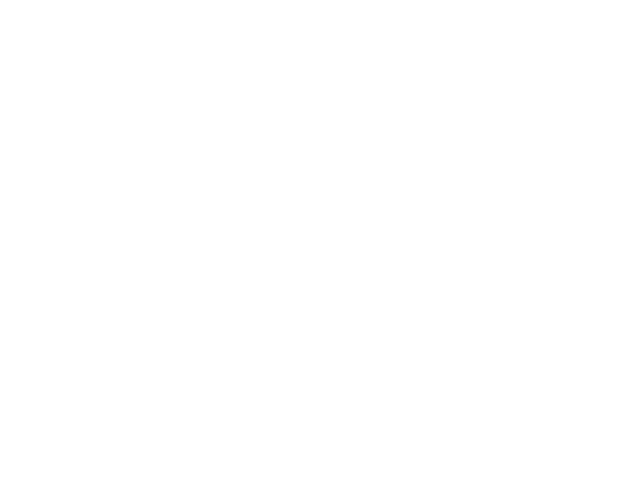

Sensor 70065
Errors:  34  ( 0.228187919463 )
BIC - raw: 301.968899422  BIC - clean: 349.683506555


<IPython.core.display.Javascript object>


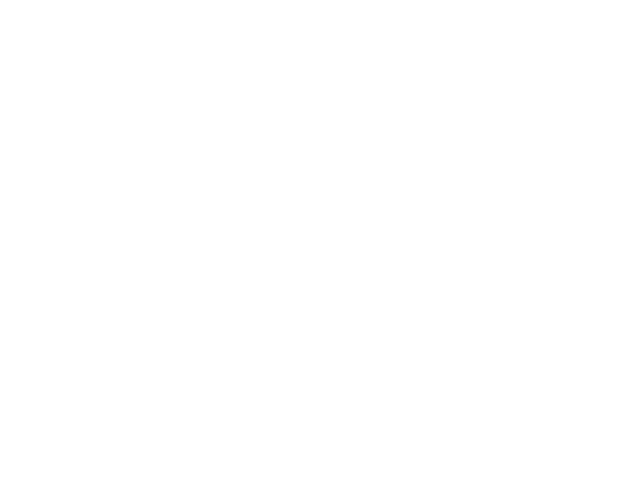

Chosen 50060
Predict is run


<IPython.core.display.Javascript object>


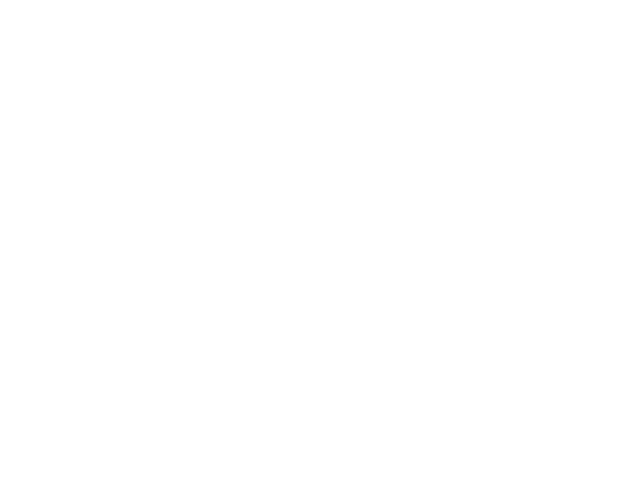

Sensor 50060
Errors:  42  ( 0.0408163265306 )
BIC - raw: -1543.00327314  BIC - clean: -1670.51856533


<IPython.core.display.Javascript object>


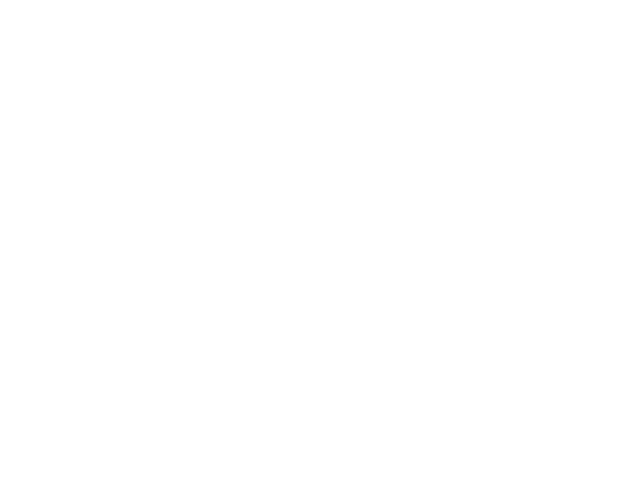

Chosen 70030
Predict is run


<IPython.core.display.Javascript object>


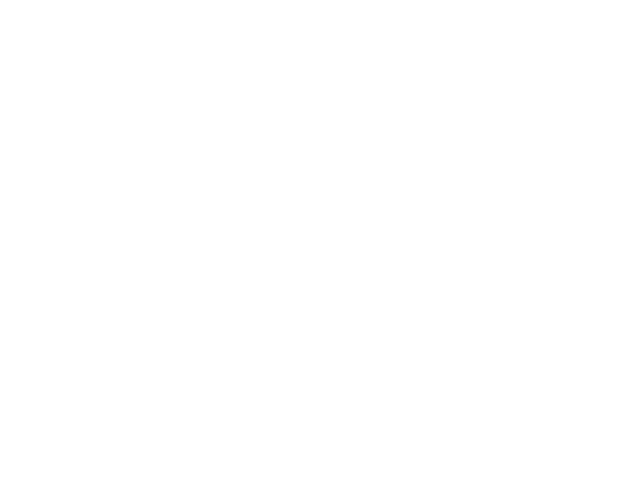

Sensor 70030
Errors:  462  ( 0.0290675726689 )
BIC - raw: 6359.28873168  BIC - clean: -23085.1560312


<IPython.core.display.Javascript object>


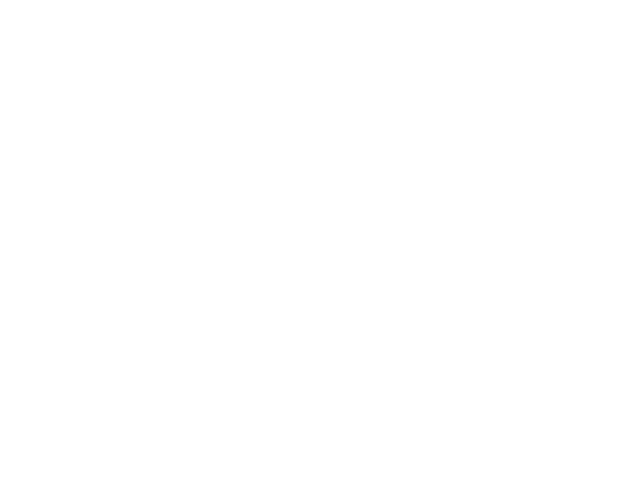

Chosen 50104
Predict is run


<IPython.core.display.Javascript object>


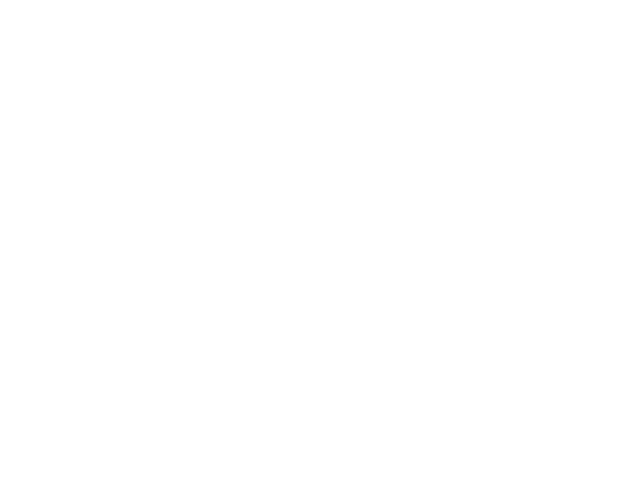

Sensor 50104
Errors:  18  ( 0.134328358209 )
BIC - raw: 6.79138281001  BIC - clean: -76.9128708579


<IPython.core.display.Javascript object>


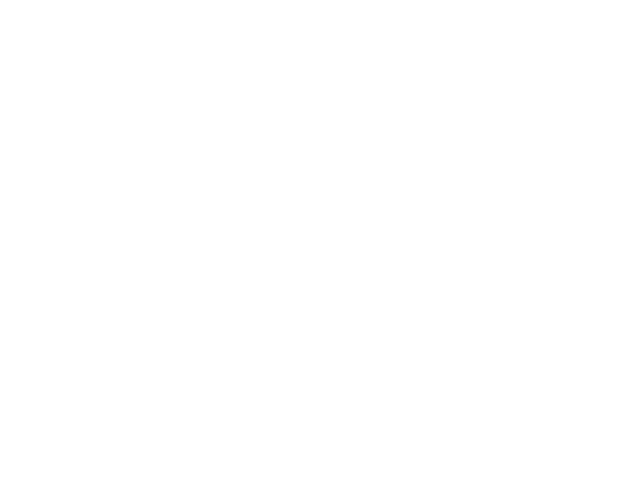

Chosen 70103
Predict is run


<IPython.core.display.Javascript object>


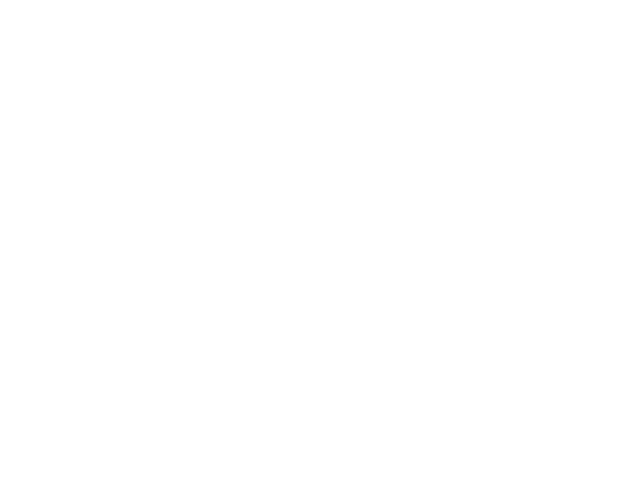

Sensor 70103
Errors:  12  ( 0.0821917808219 )
BIC - raw: 88.1060649935  BIC - clean: 81.4729807989


<IPython.core.display.Javascript object>


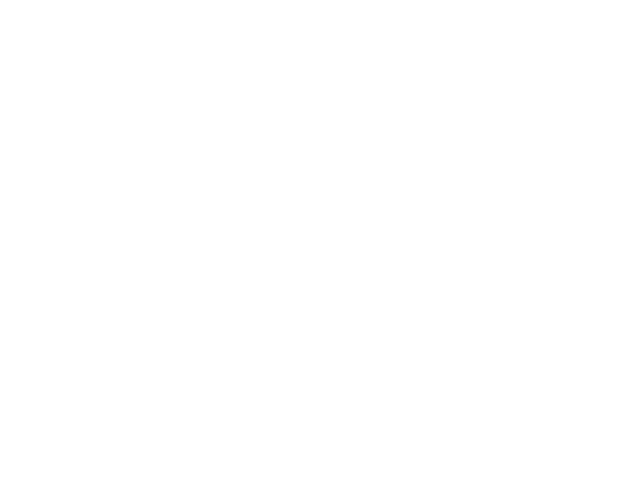

Chosen 95048
Predict is run


<IPython.core.display.Javascript object>


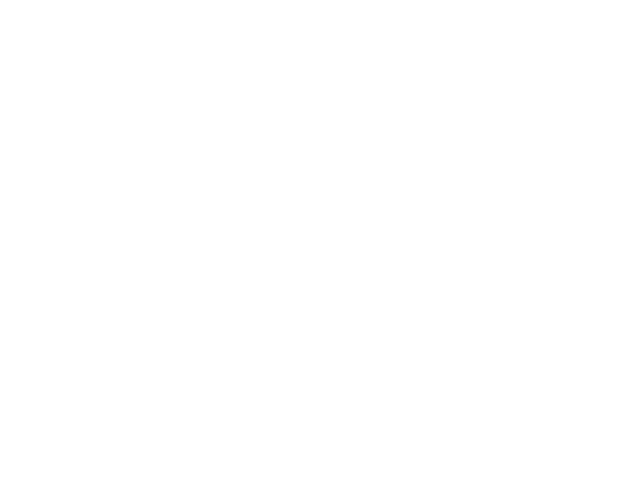

Sensor 95048
Errors:  394  ( 0.0656338497418 )
BIC - raw: 3069.31319911  BIC - clean: 7543.56534648


<IPython.core.display.Javascript object>


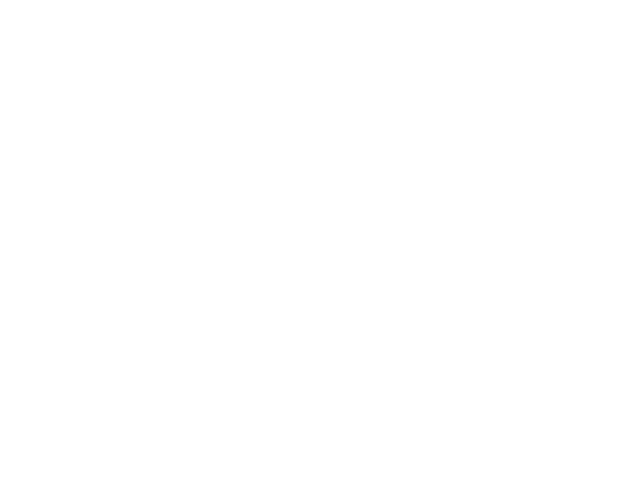

Chosen 70015
Predict is run


<IPython.core.display.Javascript object>


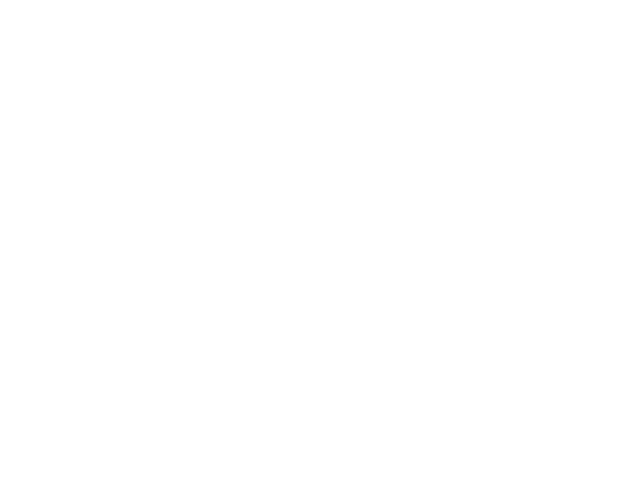

Sensor 70015
Errors:  114  ( 0.01743919229 )
BIC - raw: 98055.6112988  BIC - clean: 95866.6539485


<IPython.core.display.Javascript object>


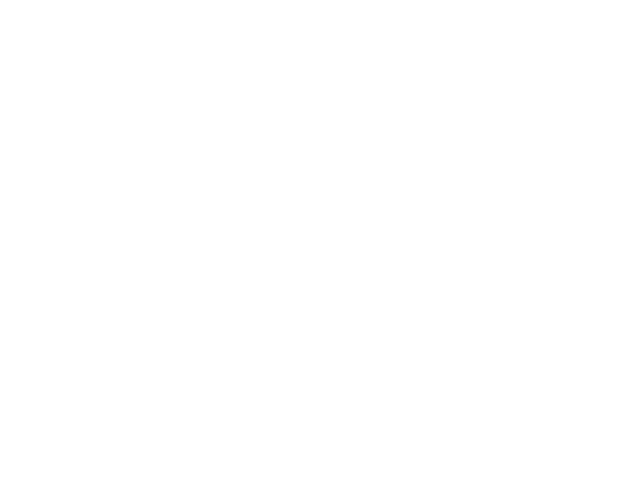

Chosen 55101
Predict is run


<IPython.core.display.Javascript object>


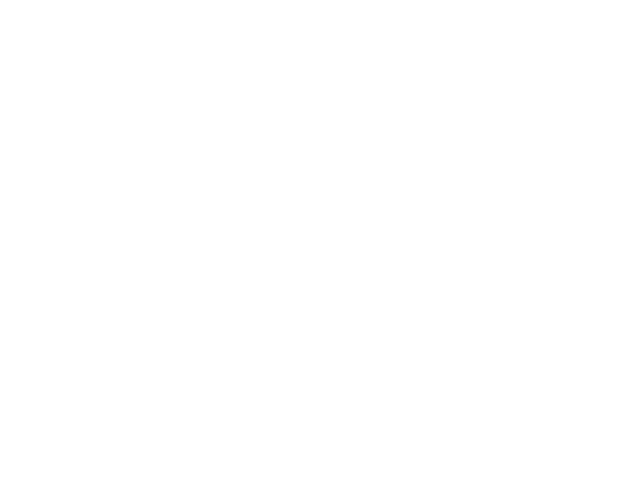

Sensor 55101
Errors:  194  ( 0.293939393939 )
BIC - raw: 355.498093384  BIC - clean: 719.287306855


<IPython.core.display.Javascript object>


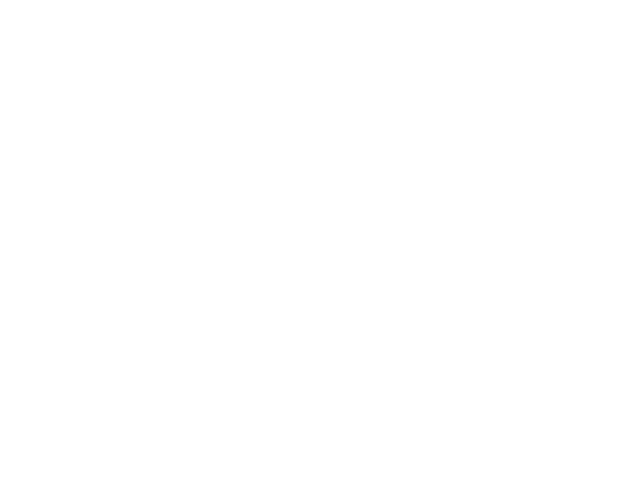

Chosen 70027
Predict is run


<IPython.core.display.Javascript object>


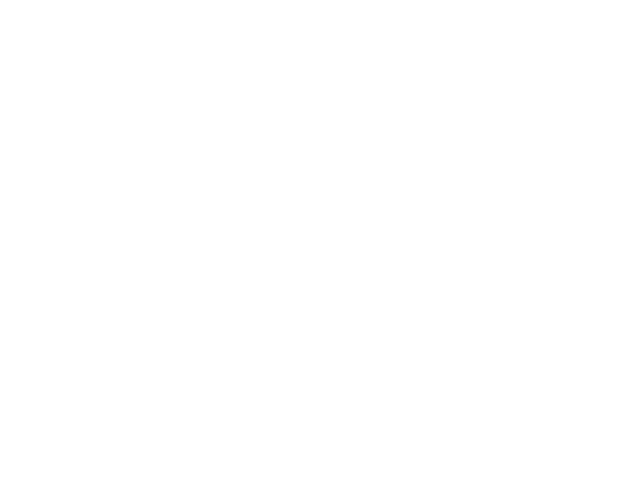

Sensor 70027
Errors:  29  ( 0.0306230200634 )
BIC - raw: -1375.10296928  BIC - clean: 79.1673834419


<IPython.core.display.Javascript object>


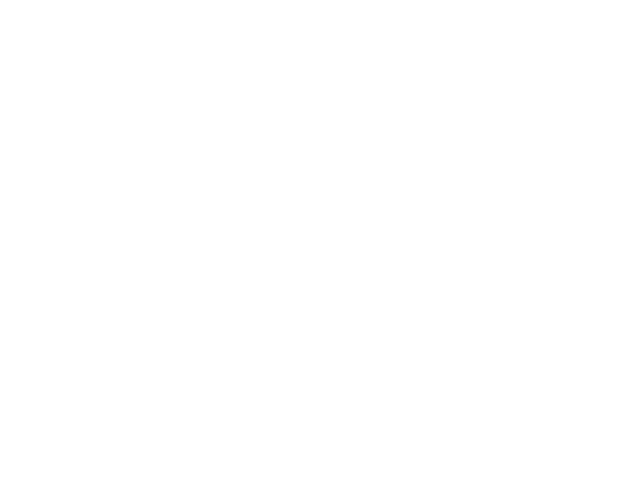

Chosen 20015
Predict is run


<IPython.core.display.Javascript object>


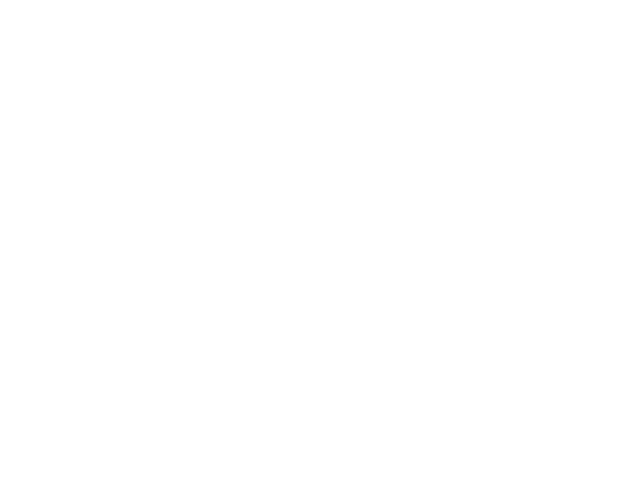

Sensor 20015
Errors:  95  ( 0.0111020217366 )
BIC - raw: -25275.9245138  BIC - clean: -24966.5838116


<IPython.core.display.Javascript object>


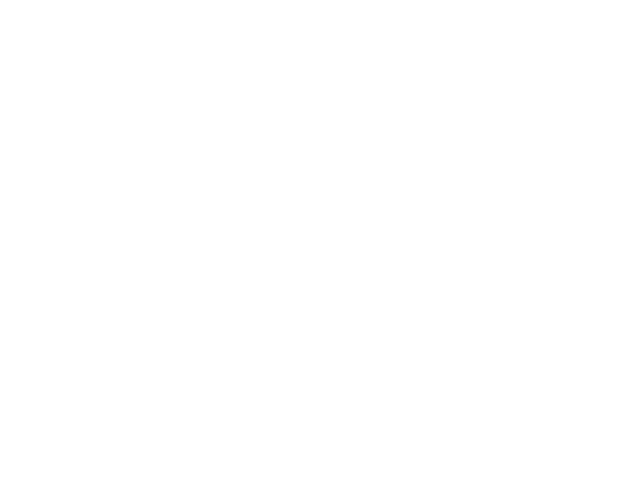

Chosen 20033
Predict is run


<IPython.core.display.Javascript object>


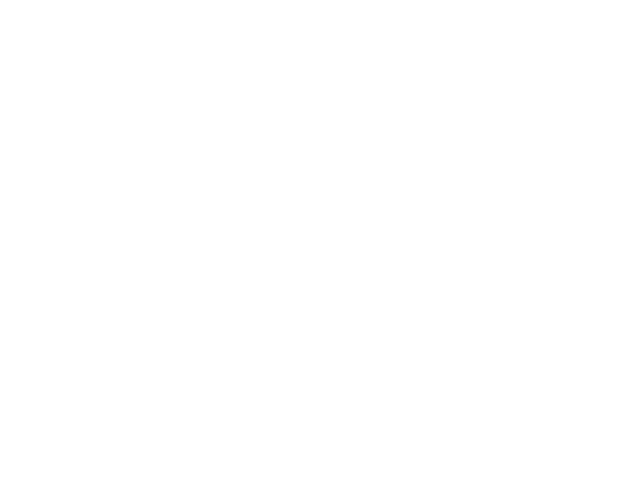

Sensor 20033
Errors:  7  ( 0.00421179302046 )
BIC - raw: -11142.9443788  BIC - clean: -11142.9443788


<IPython.core.display.Javascript object>


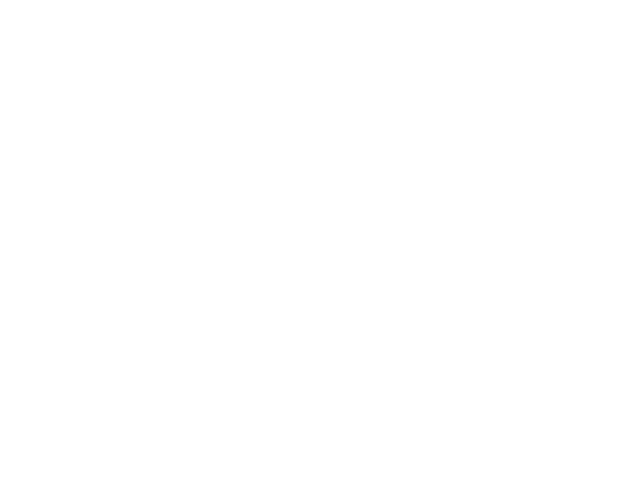

Chosen 95023
Predict is run


<IPython.core.display.Javascript object>


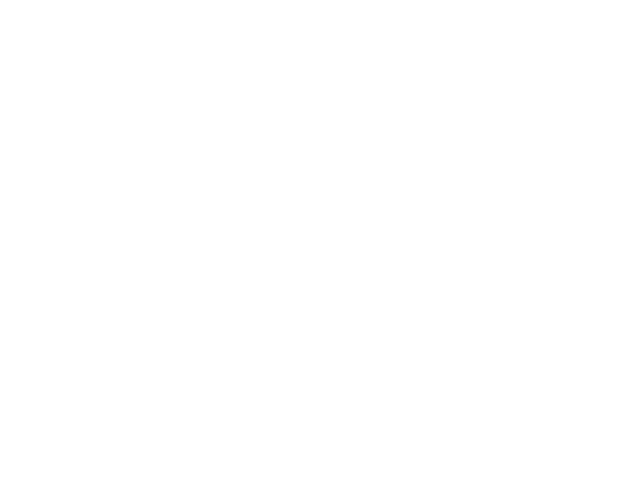

Sensor 95023
Errors:  27  ( 0.228813559322 )
BIC - raw: -37.8894770767  BIC - clean: -52.6974906091


<IPython.core.display.Javascript object>


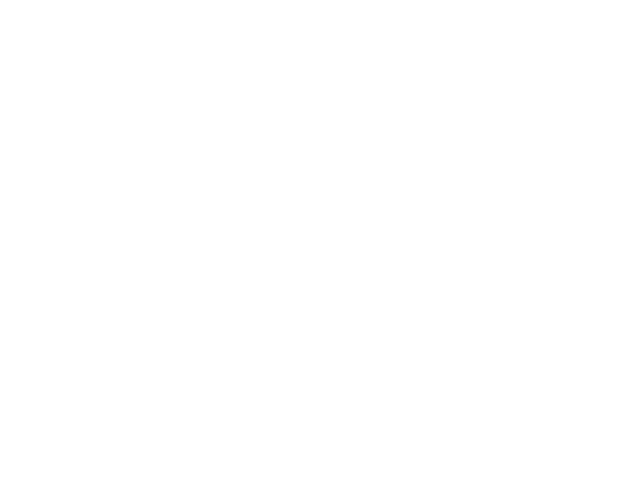

Chosen 70040
Predict is run


<IPython.core.display.Javascript object>


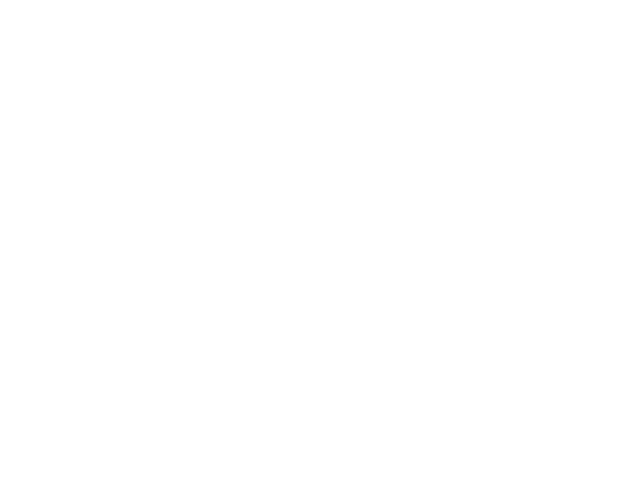

Sensor 70040
Errors:  80  ( 0.0610221205187 )
BIC - raw: 85.1622921111  BIC - clean: 448.560037061


<IPython.core.display.Javascript object>


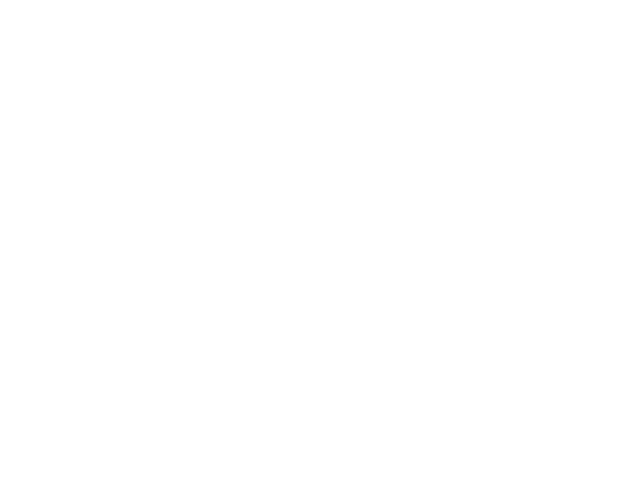

Chosen 20081
Predict is run


<IPython.core.display.Javascript object>


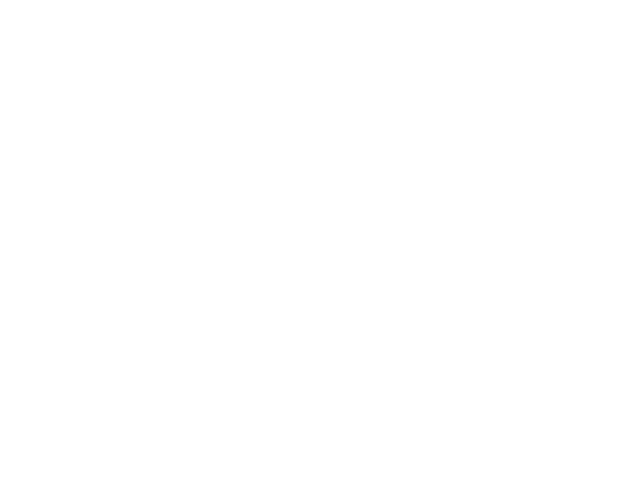

Sensor 20081
Errors:  5  ( 0.00741839762611 )
BIC - raw: -4225.44433143  BIC - clean: -4225.44433143


<IPython.core.display.Javascript object>


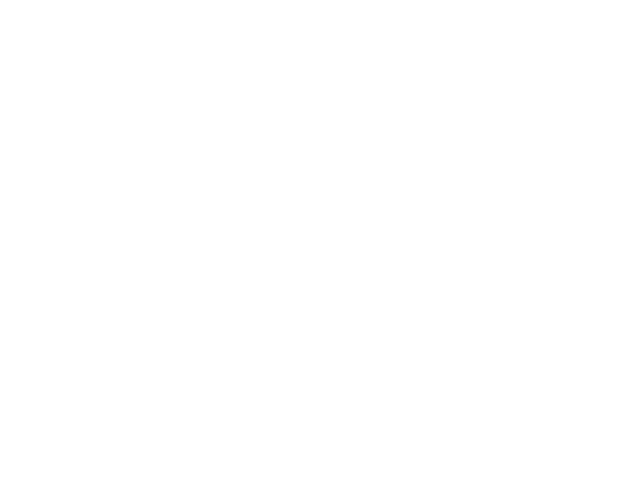

Chosen 85030
Predict is run


<IPython.core.display.Javascript object>


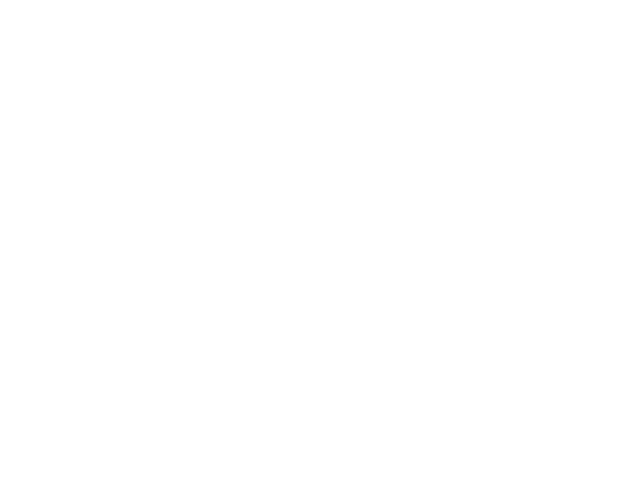

Sensor 85030
Errors:  64  ( 0.00407487584363 )
BIC - raw: -63934.9146397  BIC - clean: -58610.7291089


<IPython.core.display.Javascript object>


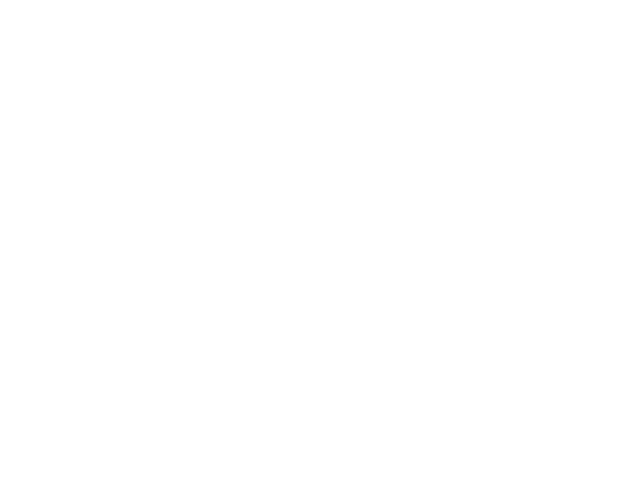

Chosen 20046
Predict is run


<IPython.core.display.Javascript object>


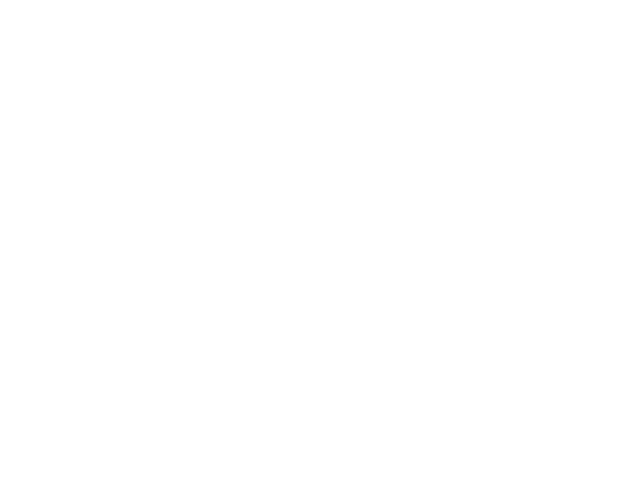

Sensor 20046
Errors:  10  ( 0.10101010101 )
BIC - raw: 40.5696793243  BIC - clean: 42.0743488395


<IPython.core.display.Javascript object>


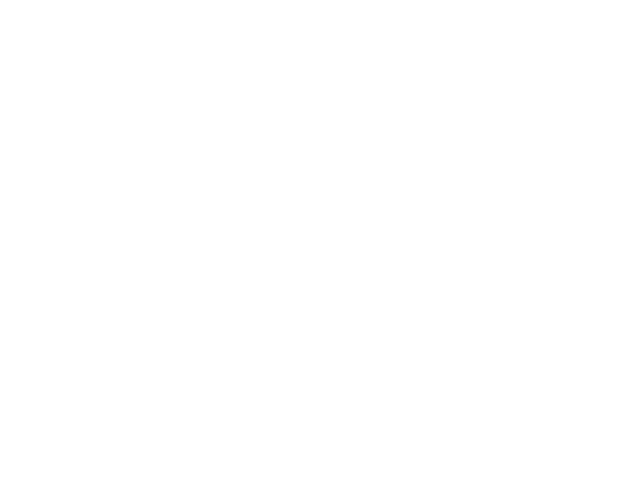

Chosen 20036
Predict is run


<IPython.core.display.Javascript object>


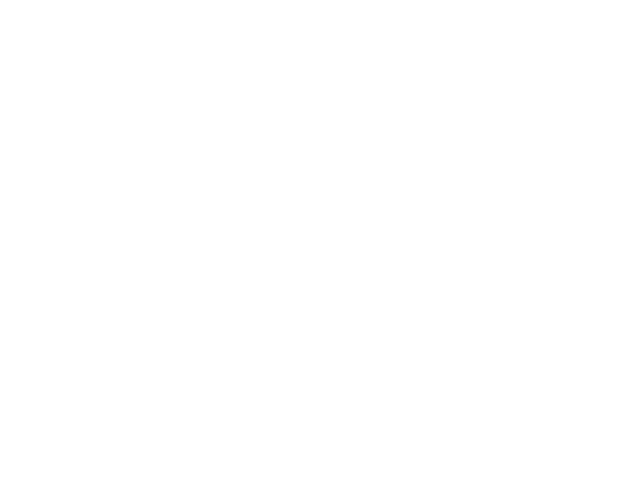

Sensor 20036
Errors:  6  ( 0.0576923076923 )
BIC - raw: -86.8305759432  BIC - clean: -86.0631813696


<IPython.core.display.Javascript object>


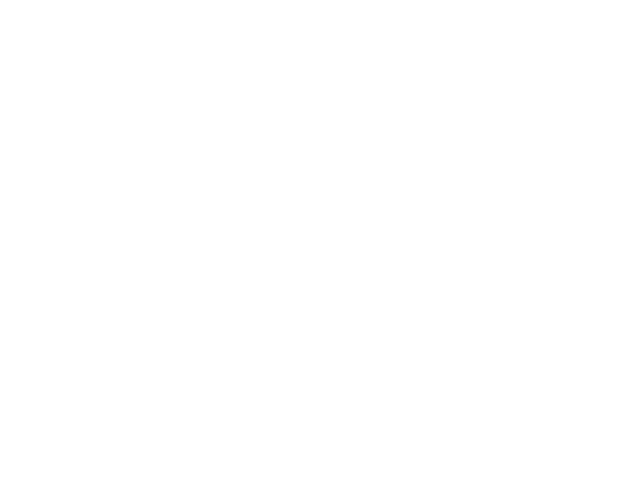

Chosen 20022
Predict is run


<IPython.core.display.Javascript object>


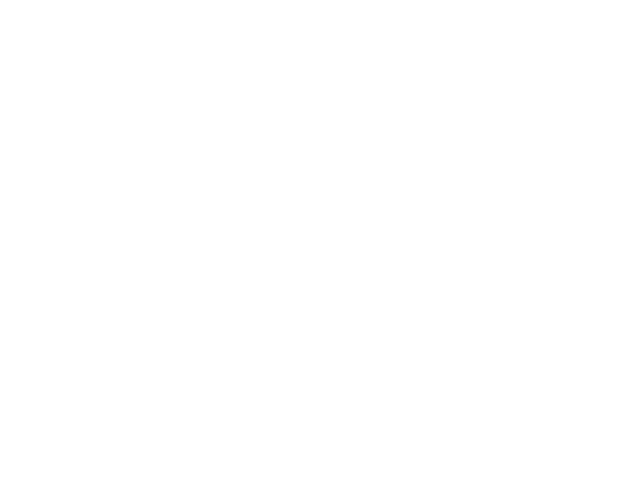

Sensor 20022
Errors:  7  ( 0.00421179302046 )
BIC - raw: -11172.5771317  BIC - clean: -11172.5771317


<IPython.core.display.Javascript object>


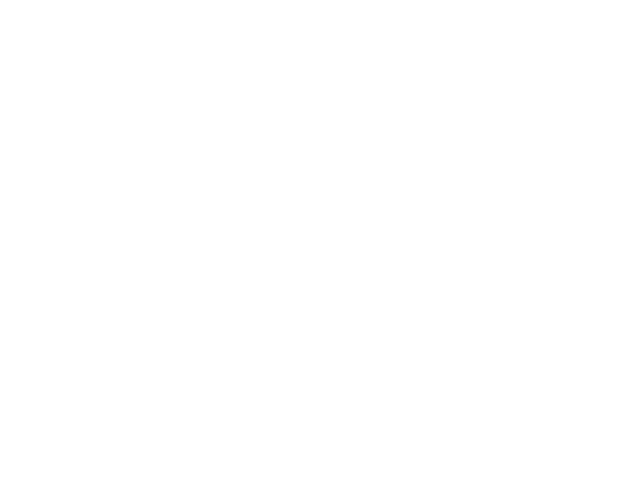

<class 'KeyError'>
('Value',)
Chosen 20030
Predict is run


<IPython.core.display.Javascript object>


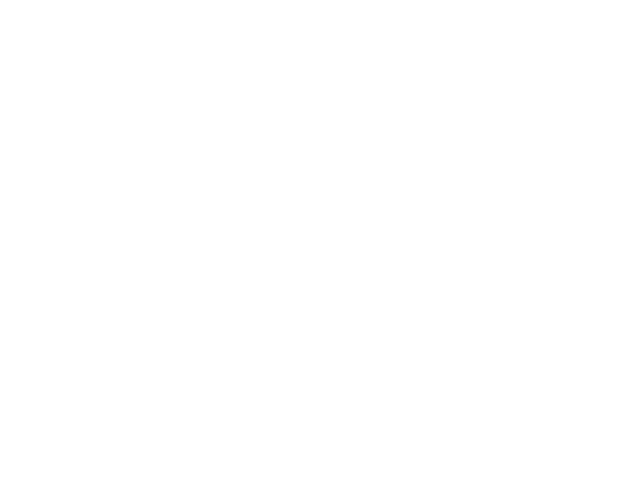

Sensor 20030
Errors:  14  ( 0.00210811624755 )
BIC - raw: -36841.5847088  BIC - clean: -37694.0901627


<IPython.core.display.Javascript object>


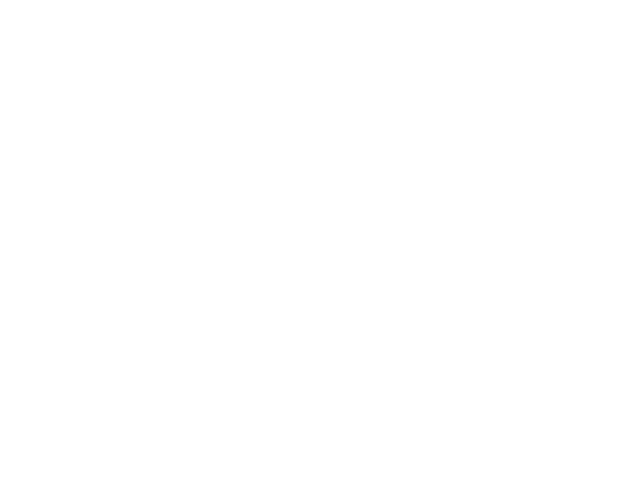

<class 'KeyError'>
('Value',)
Chosen 20066
Predict is run


<IPython.core.display.Javascript object>


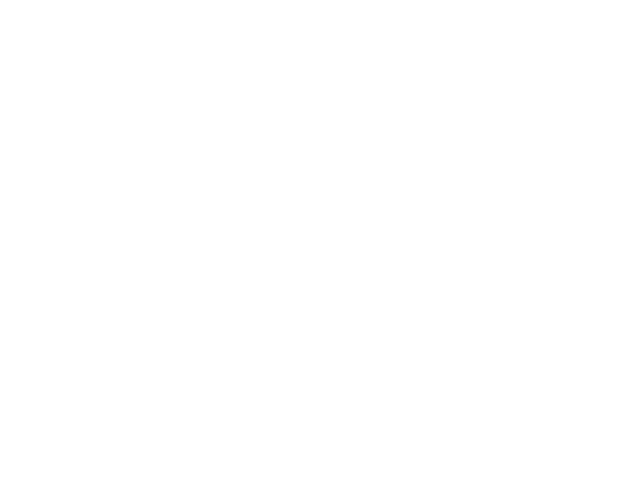

Sensor 20066
Errors:  9  ( 0.00205291970803 )
BIC - raw: -23421.9226407  BIC - clean: -22618.0974994


<IPython.core.display.Javascript object>


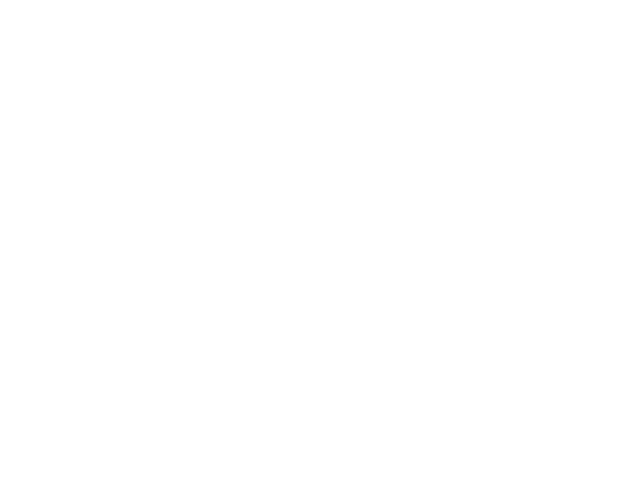

Chosen 20071
Predict is run


<IPython.core.display.Javascript object>


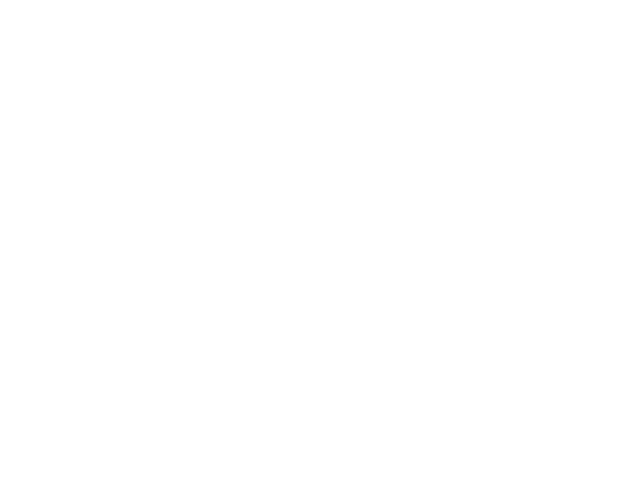

Sensor 20071
Errors:  56  ( 0.010498687664 )
BIC - raw: 74516.3964086  BIC - clean: 75187.8942821


<IPython.core.display.Javascript object>


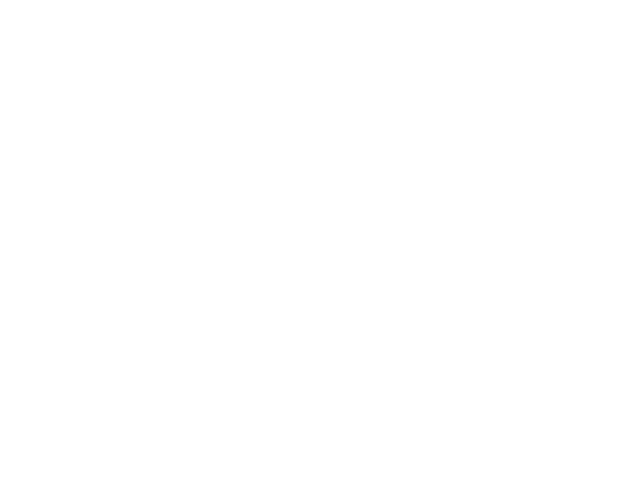

<class 'KeyError'>
('Value',)
Chosen 80035
Predict is run


<IPython.core.display.Javascript object>


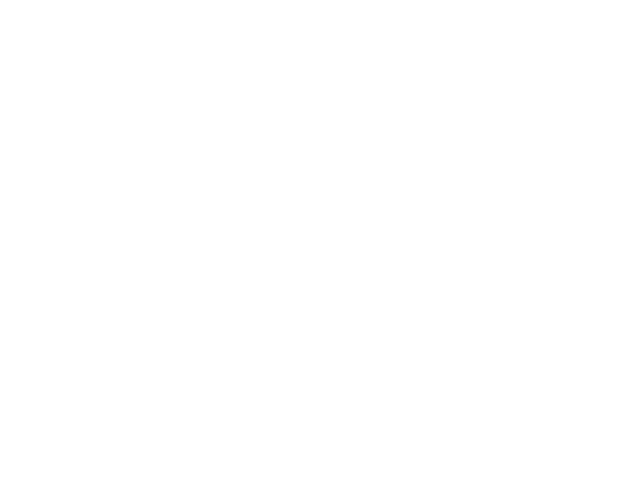

Sensor 80035
Errors:  60  ( 0.00356358021025 )
BIC - raw: -82724.7453476  BIC - clean: -70058.4784132


<IPython.core.display.Javascript object>


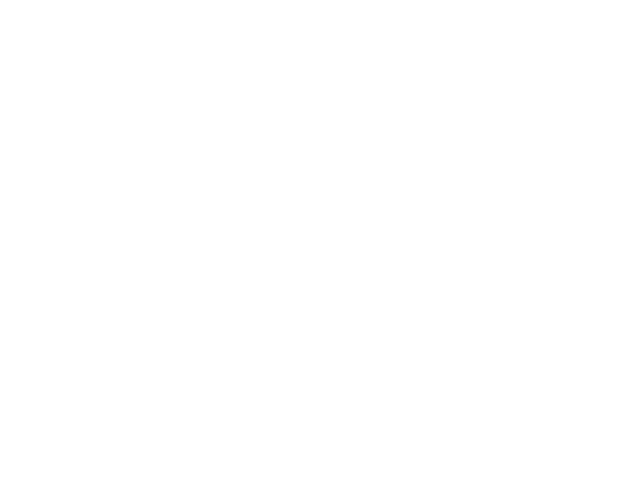

Chosen 80050
Predict is run


<IPython.core.display.Javascript object>


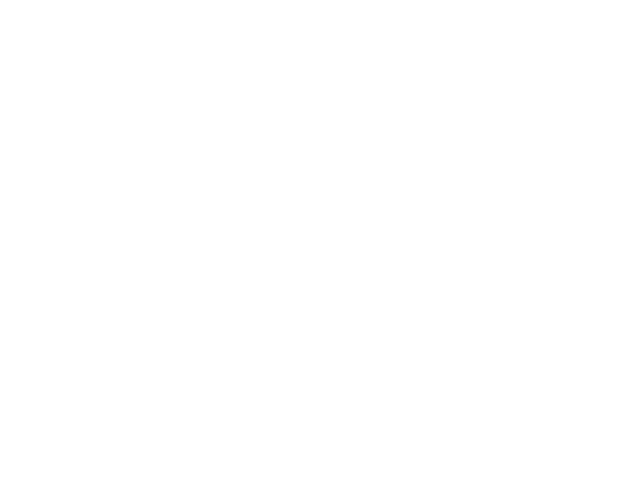

Sensor 80050
Errors:  52  ( 0.00643883110451 )
BIC - raw: 109403.238851  BIC - clean: 111542.391253


<IPython.core.display.Javascript object>


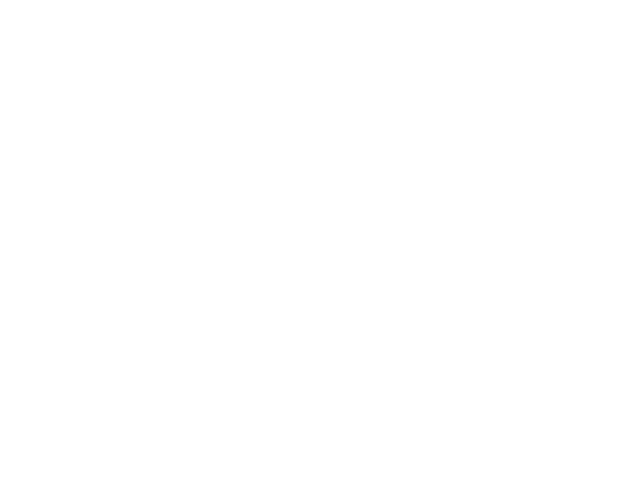

Chosen 90041
Predict is run


<IPython.core.display.Javascript object>


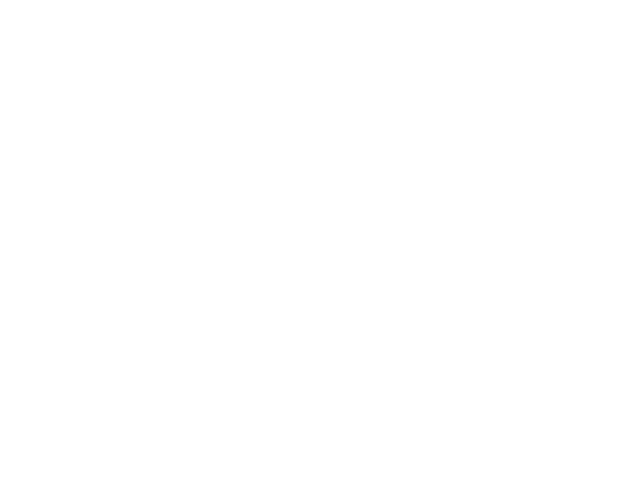

Sensor 90041
Errors:  18  ( 0.125 )
BIC - raw: 126.290868652  BIC - clean: 118.705113796


<IPython.core.display.Javascript object>


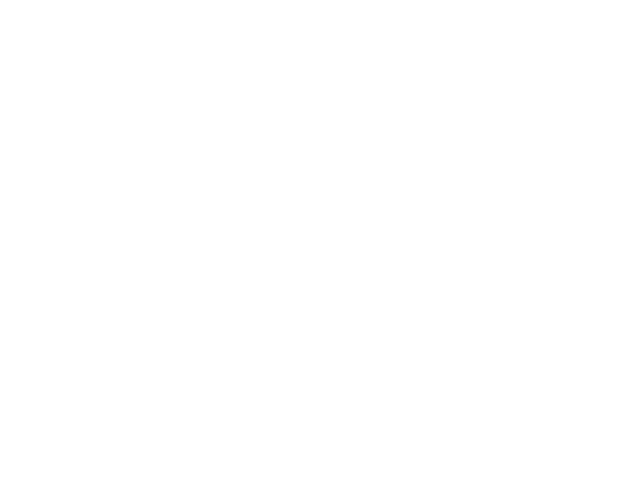

Chosen 20070
Predict is run


<IPython.core.display.Javascript object>


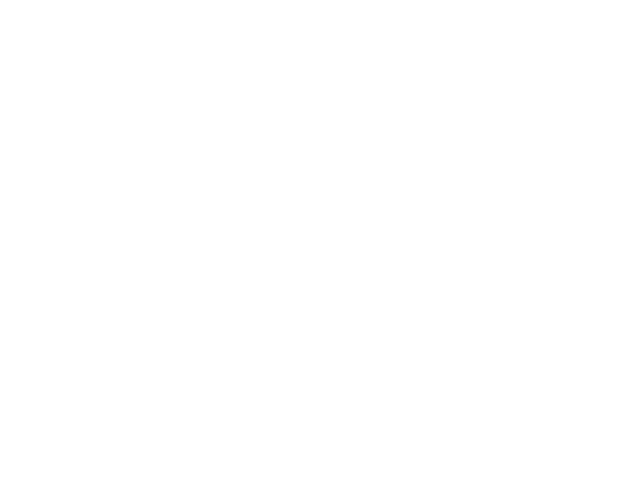

Sensor 20070
Errors:  26  ( 0.0148401826484 )
BIC - raw: 25032.932422  BIC - clean: 25232.4119711


<IPython.core.display.Javascript object>


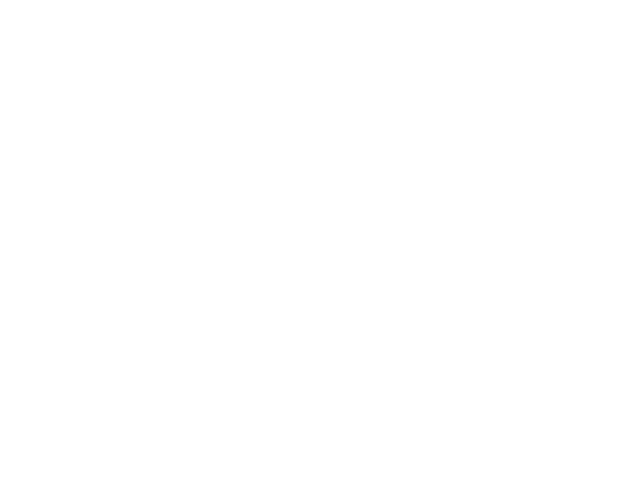

Chosen 20038
Predict is run


<IPython.core.display.Javascript object>


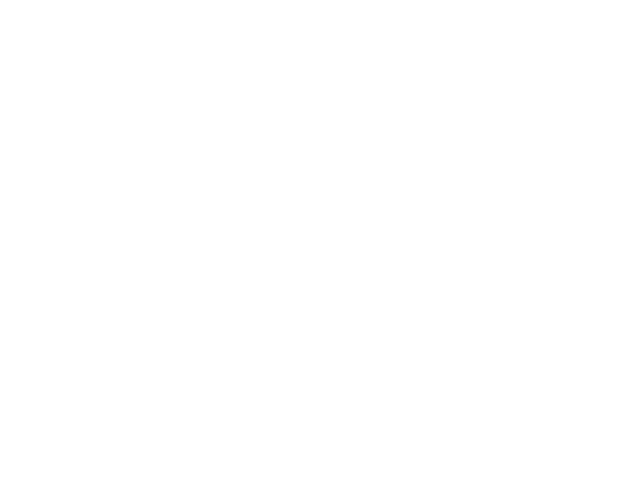

Sensor 20038
Errors:  4  ( 0.0223463687151 )
BIC - raw: -419.027040899  BIC - clean: -419.027040899


<IPython.core.display.Javascript object>


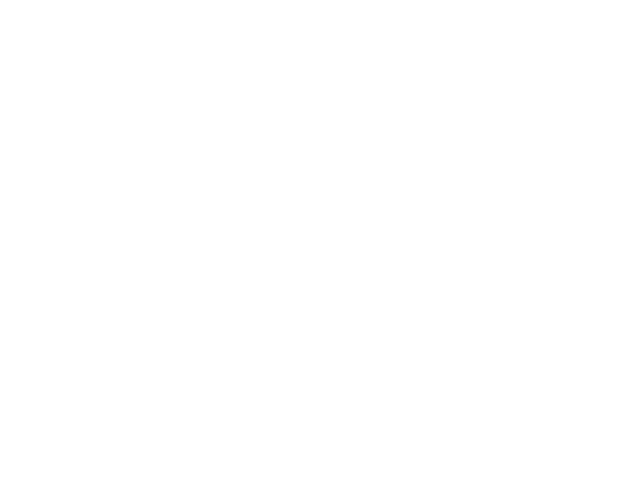

Chosen 90016
Predict is run


<IPython.core.display.Javascript object>


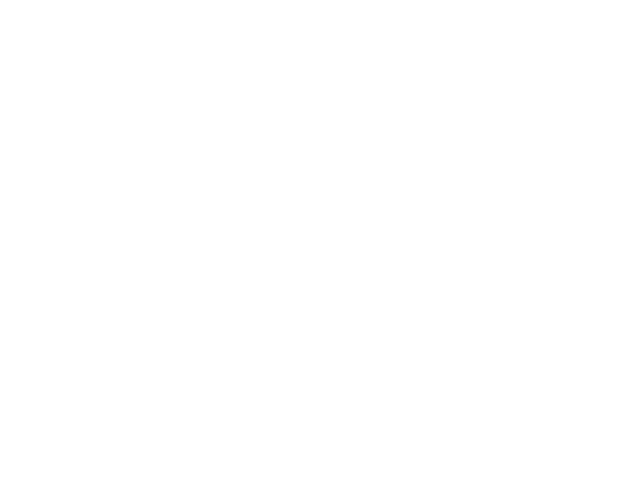

Sensor 90016
Errors:  5  ( 0.0126262626263 )
BIC - raw: -1597.67739609  BIC - clean: -1597.67739609


<IPython.core.display.Javascript object>


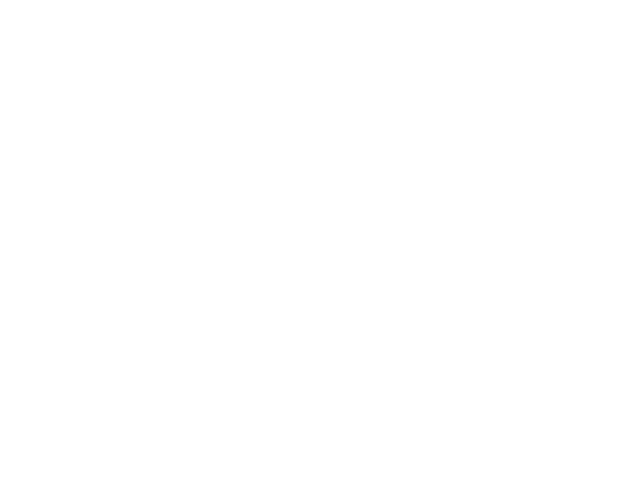

Chosen 15032
Predict is run


<IPython.core.display.Javascript object>


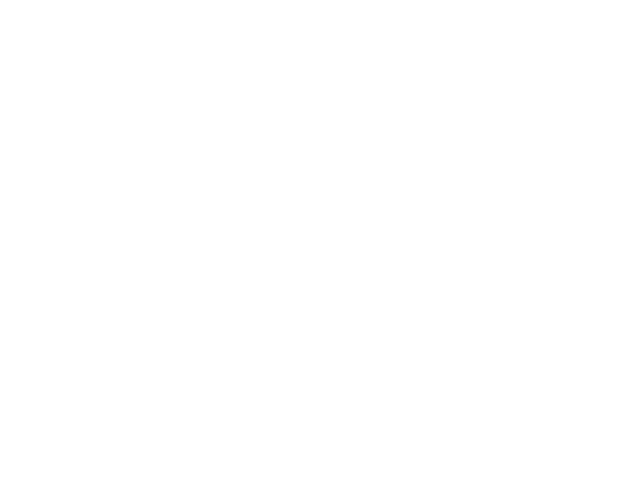

Sensor 15032
Errors:  5  ( 0.00741839762611 )
BIC - raw: -3892.37219416  BIC - clean: -3892.37219416


<IPython.core.display.Javascript object>


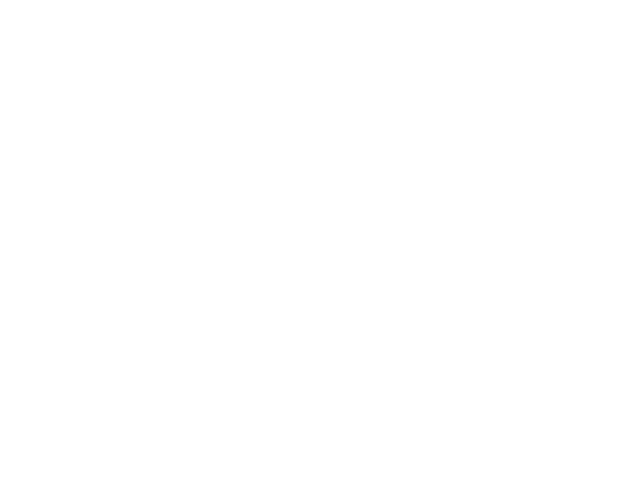

Chosen 20031
Predict is run


<IPython.core.display.Javascript object>


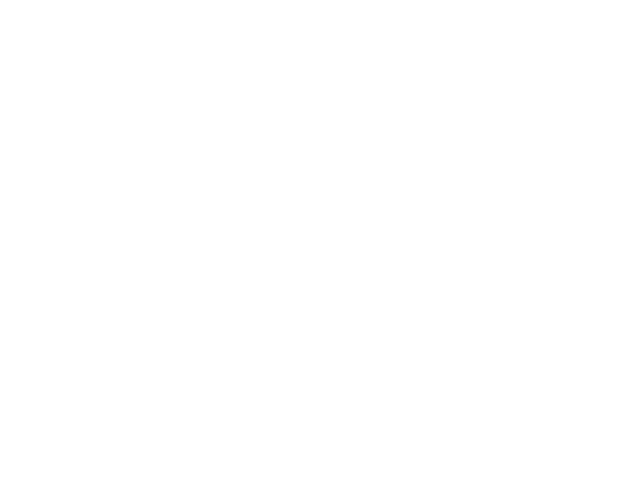

Sensor 20031
Errors:  23  ( 0.0138805069403 )
BIC - raw: -5551.7783766  BIC - clean: -4456.86456687


<IPython.core.display.Javascript object>


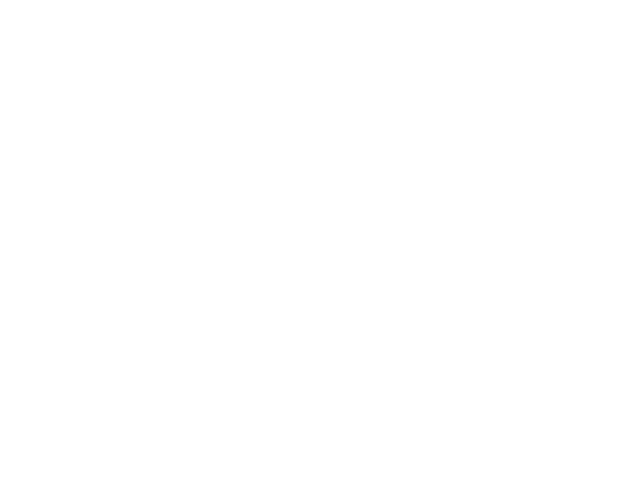

Chosen 55051
Predict is run


<IPython.core.display.Javascript object>


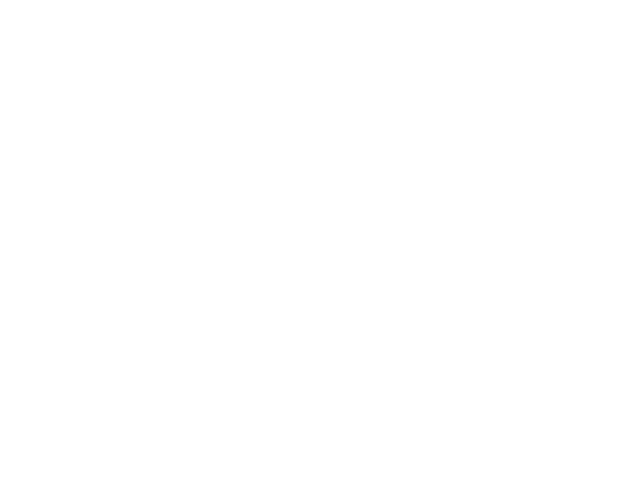

Sensor 55051
Errors:  100  ( 0.346020761246 )
BIC - raw: 371.650758101  BIC - clean: 367.296037628


<IPython.core.display.Javascript object>


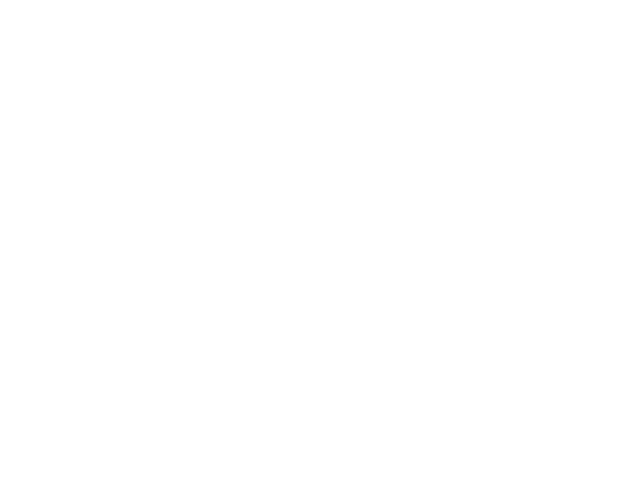

<class 'KeyError'>
('Value',)
Chosen 20025
Predict is run


<IPython.core.display.Javascript object>


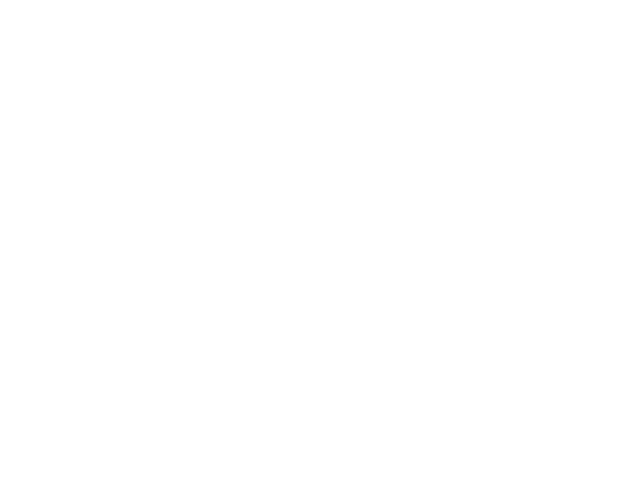

Sensor 20025
Errors:  156  ( 0.0165939793639 )
BIC - raw: 136477.251374  BIC - clean: 137531.579103


<IPython.core.display.Javascript object>


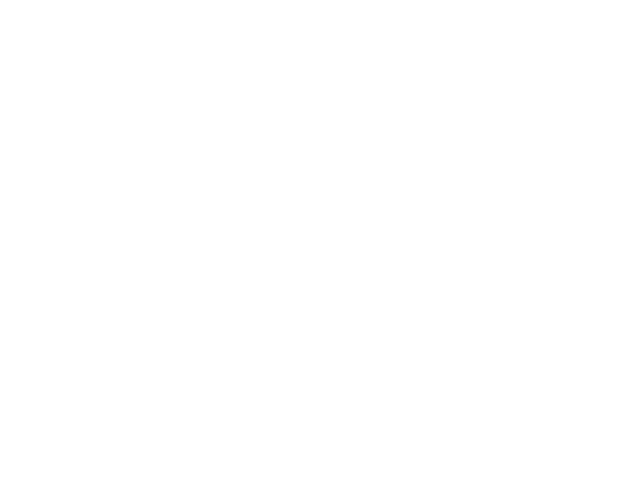

Chosen 70020
Predict is run


<IPython.core.display.Javascript object>


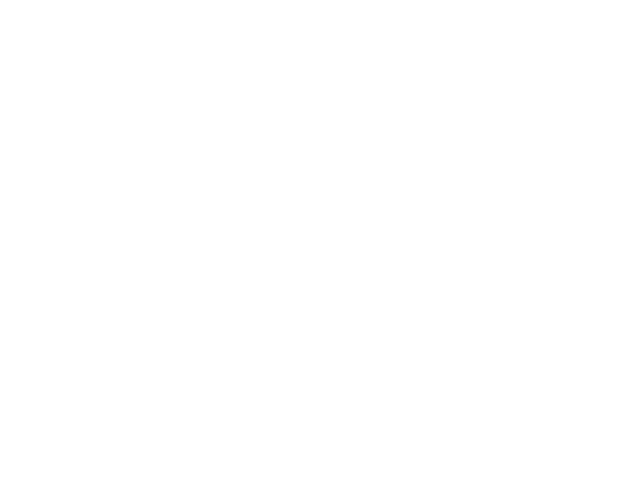

Sensor 70020
Errors:  63  ( 0.00570548813621 )
BIC - raw: 146242.982098  BIC - clean: 148603.10193


<IPython.core.display.Javascript object>


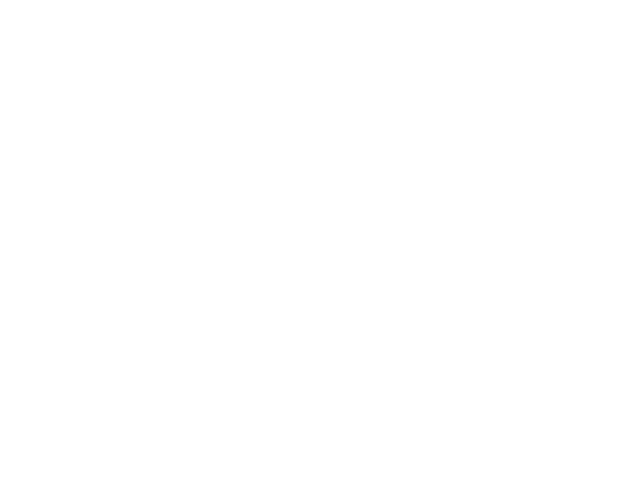

Chosen 20040
Predict is run


<IPython.core.display.Javascript object>


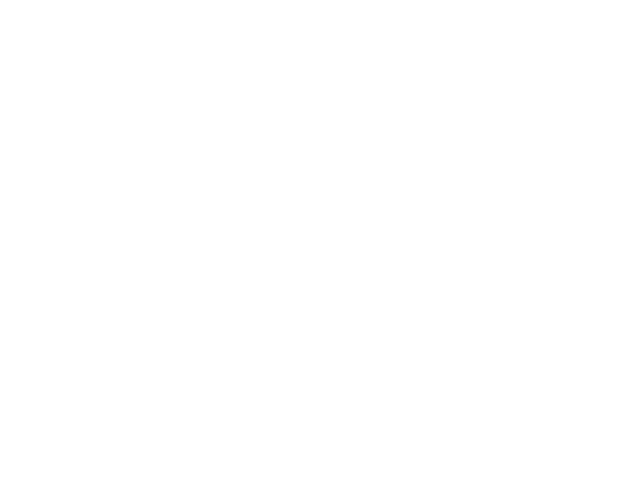

Sensor 20040
Errors:  108  ( 0.012164902005 )
BIC - raw: 127779.497824  BIC - clean: 126828.993526


<IPython.core.display.Javascript object>


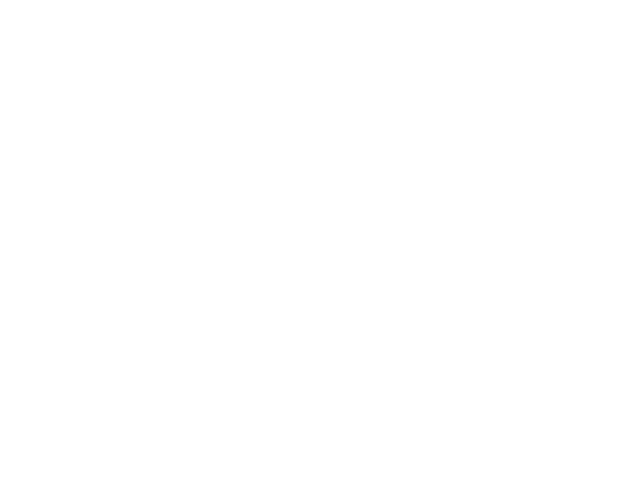

Chosen 65104
Predict is run


<IPython.core.display.Javascript object>


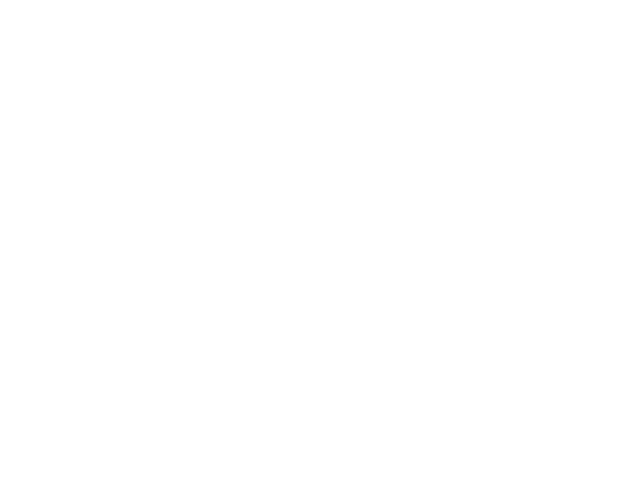

Sensor 65104
Errors:  70  ( 0.0312221231044 )
BIC - raw: -4539.12295216  BIC - clean: -3046.10878849


<IPython.core.display.Javascript object>


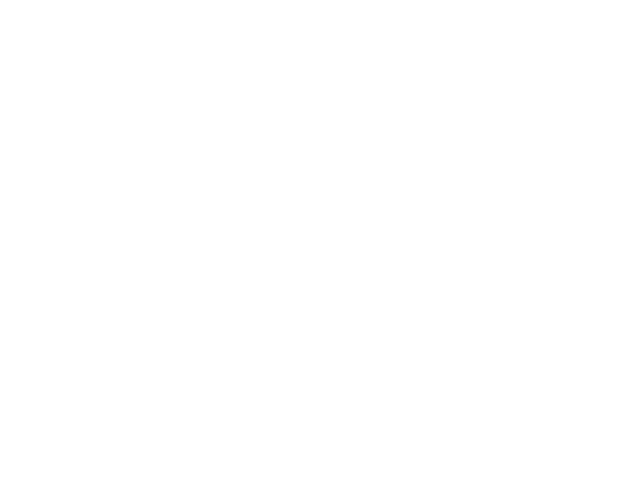

Chosen 65065
Predict is run


<IPython.core.display.Javascript object>


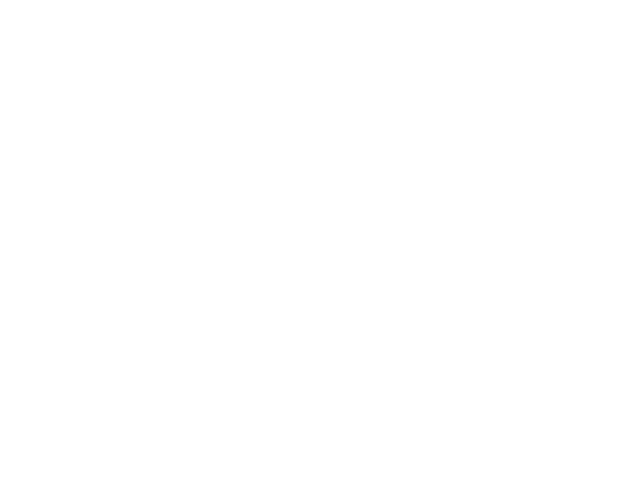

Sensor 65065
Errors:  175  ( 0.0110236220472 )
BIC - raw: -51844.9505937  BIC - clean: -35099.5765101


<IPython.core.display.Javascript object>


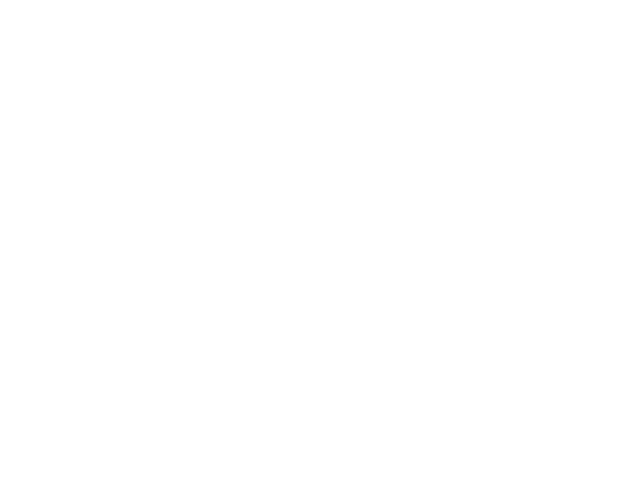

Chosen 20090
Predict is run


<IPython.core.display.Javascript object>


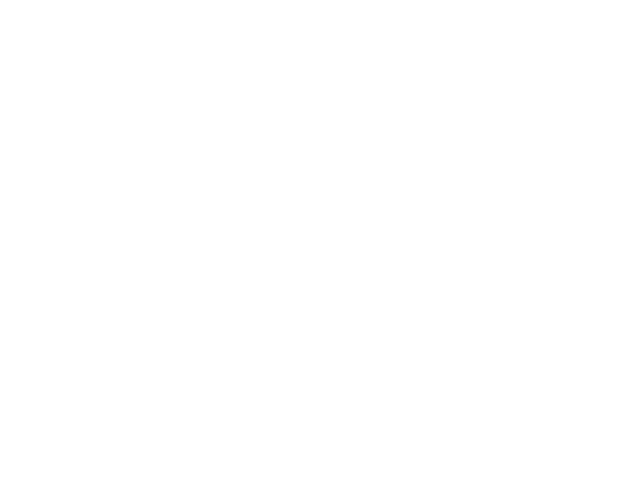

Sensor 20090
Errors:  8  ( 0.000891762345335 )
BIC - raw: -59475.0613908  BIC - clean: -58645.3135766


<IPython.core.display.Javascript object>


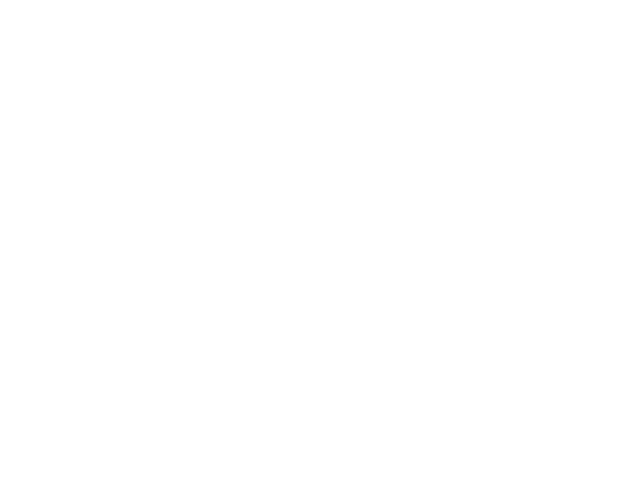

Chosen 70101
Predict is run


<IPython.core.display.Javascript object>


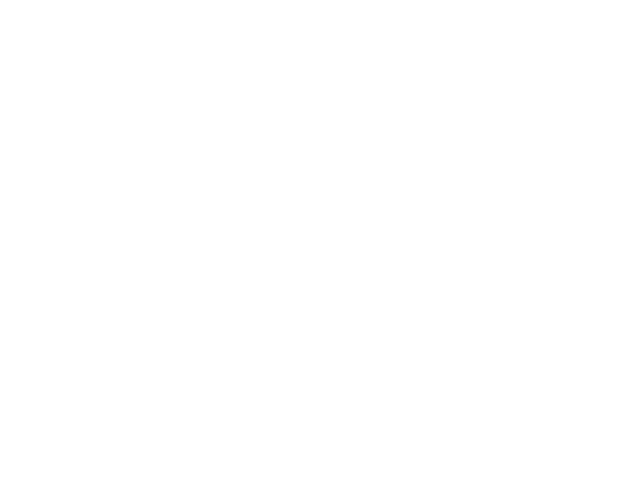

Sensor 70101
Errors:  16  ( 0.0108108108108 )
BIC - raw: -4034.46550932  BIC - clean: -4476.76876278


<IPython.core.display.Javascript object>


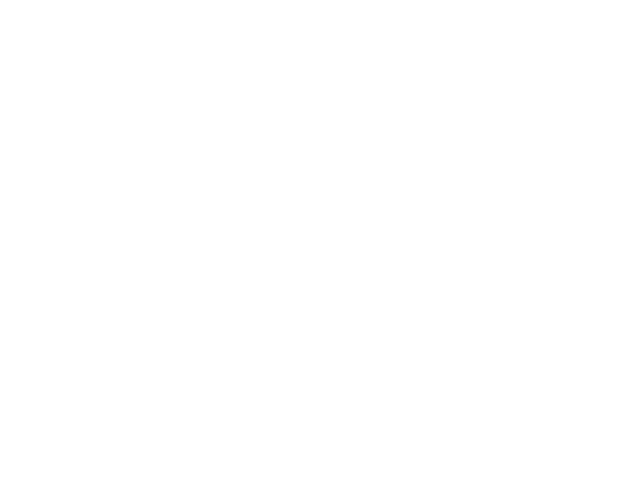

Chosen 70017
Predict is run


<IPython.core.display.Javascript object>


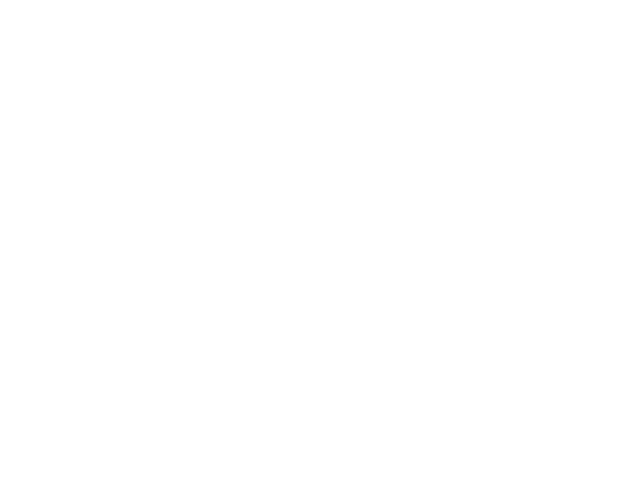

Sensor 70017
Errors:  34  ( 0.033203125 )
BIC - raw: -2261.85423721  BIC - clean: -160.022460685


<IPython.core.display.Javascript object>


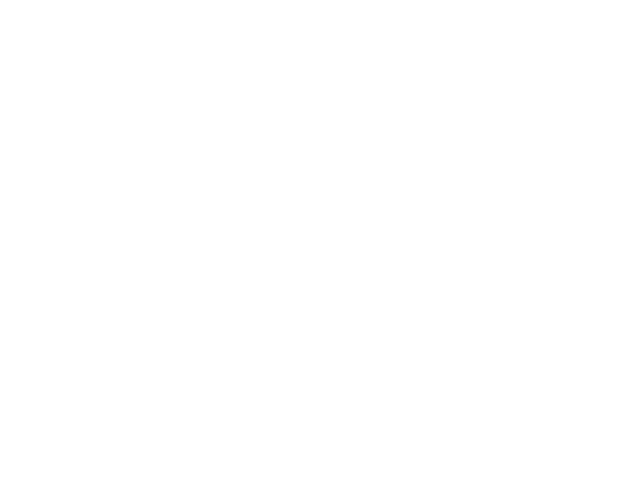

Chosen 65021
Predict is run


<IPython.core.display.Javascript object>


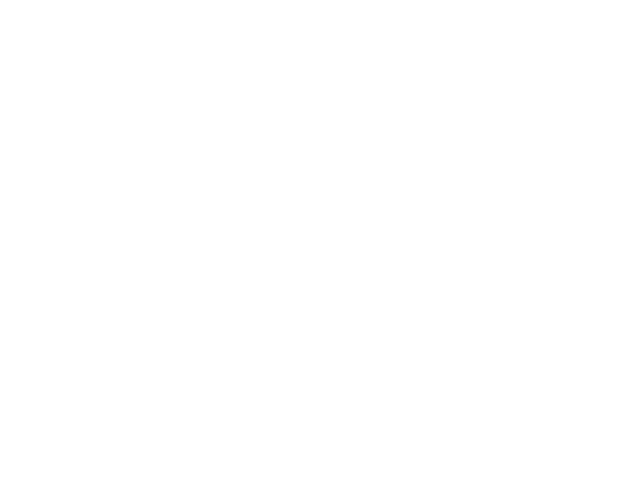

Sensor 65021
Errors:  27  ( 0.0148924434639 )
BIC - raw: -3813.75961177  BIC - clean: -3686.62803316


<IPython.core.display.Javascript object>


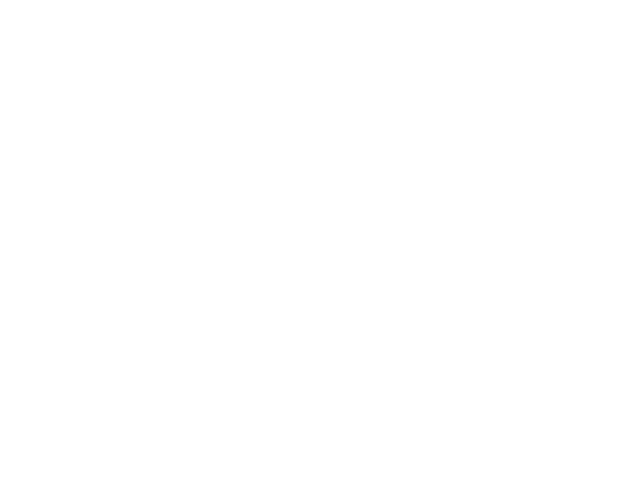

Chosen 65024
Predict is run


<IPython.core.display.Javascript object>


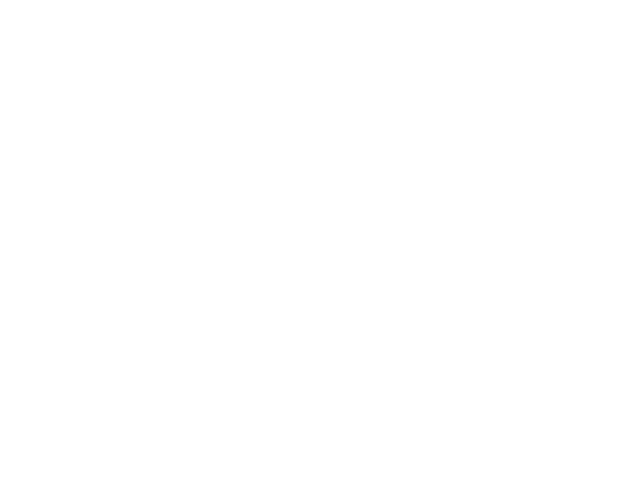

Sensor 65024
Errors:  31  ( 0.208053691275 )
BIC - raw: 253.888820239  BIC - clean: 364.261587569


<IPython.core.display.Javascript object>


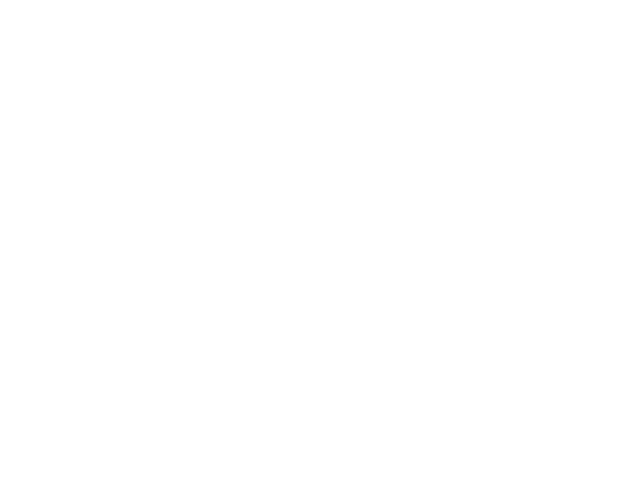

Chosen 95104
Predict is run


<IPython.core.display.Javascript object>


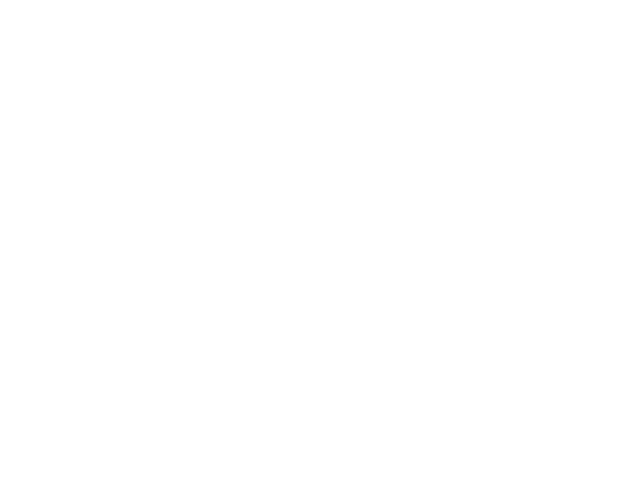

Sensor 95104
Errors:  441  ( 0.388204225352 )
BIC - raw: 980.8839822  BIC - clean: 1265.05047746


<IPython.core.display.Javascript object>


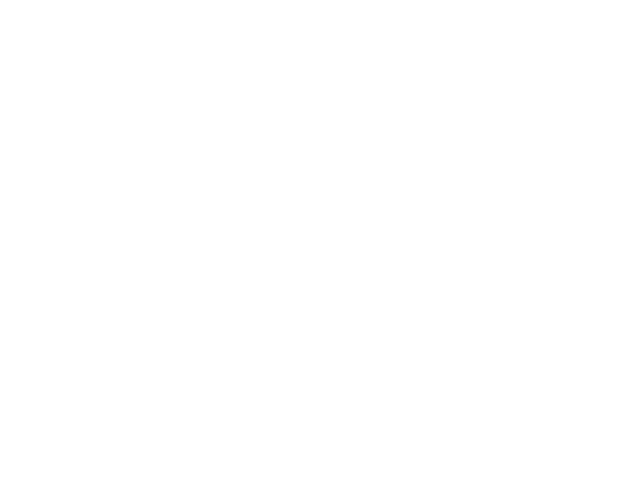

Chosen 65046
Predict is run


<IPython.core.display.Javascript object>


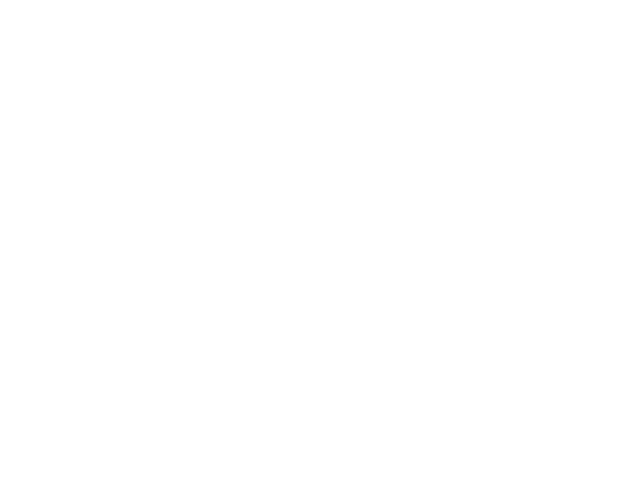

Sensor 65046
Errors:  19  ( 0.126666666667 )
BIC - raw: 132.476385303  BIC - clean: 93.8838990625


<IPython.core.display.Javascript object>


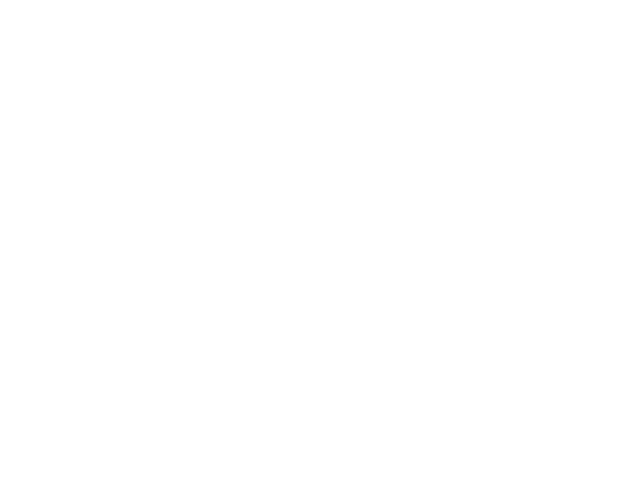

Chosen 65101
Predict is run


<IPython.core.display.Javascript object>


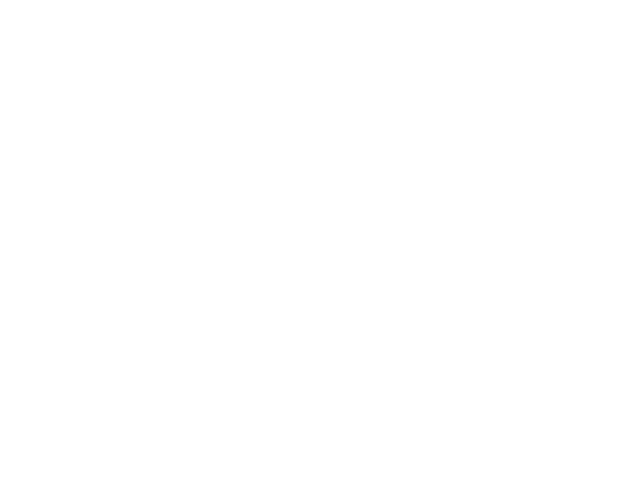

Sensor 65101
Errors:  59  ( 0.268181818182 )
BIC - raw: 1198.94412957  BIC - clean: 1067.78526169


<IPython.core.display.Javascript object>


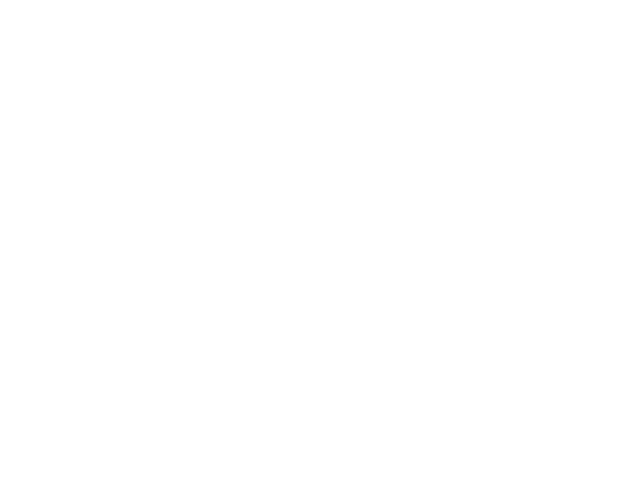

Chosen 65045
Predict is run


<IPython.core.display.Javascript object>


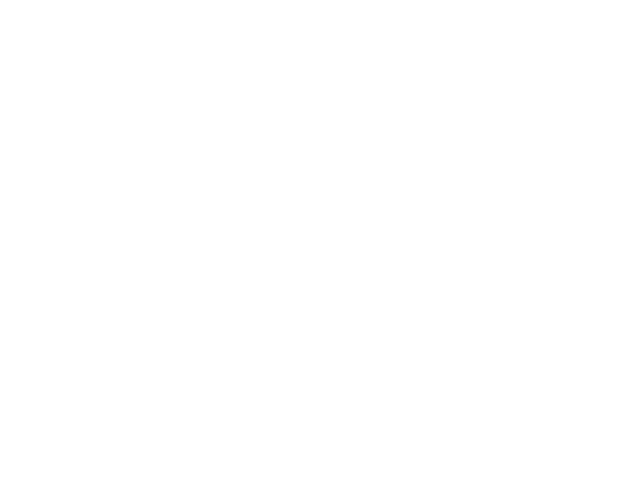

Sensor 65045
Errors:  13  ( 0.0872483221477 )
BIC - raw: 68.769541382  BIC - clean: 56.6249963746


<IPython.core.display.Javascript object>


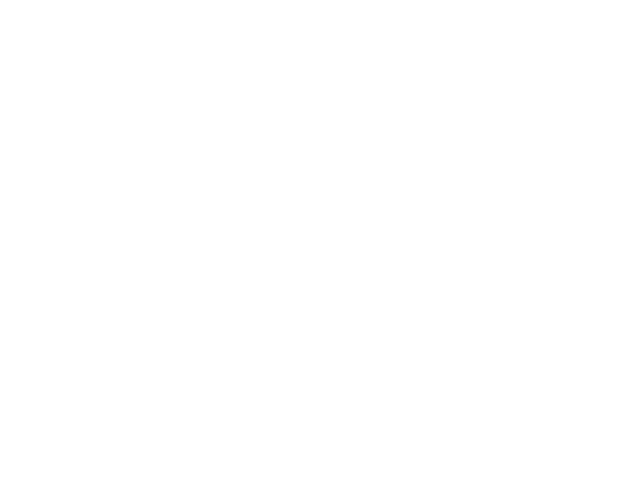

Chosen 30051
Predict is run


<IPython.core.display.Javascript object>


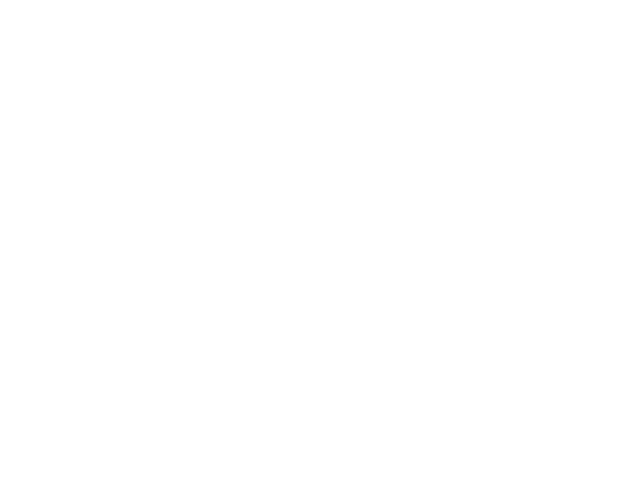

Sensor 30051
Errors:  84  ( 0.0287474332649 )
BIC - raw: -7573.99195693  BIC - clean: -5348.07133129


<IPython.core.display.Javascript object>


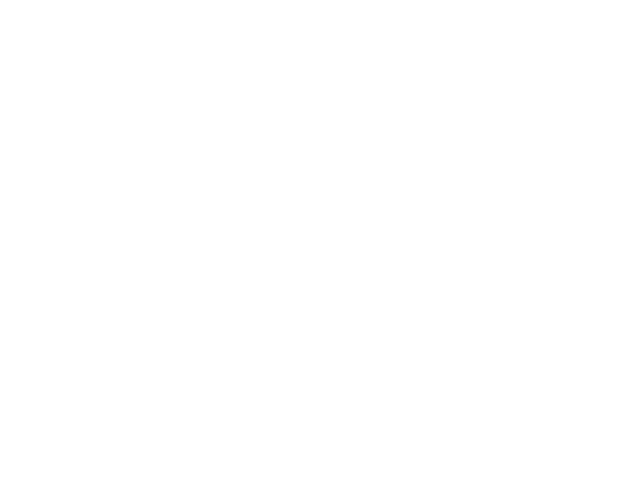

Chosen 85023
Predict is run


<IPython.core.display.Javascript object>


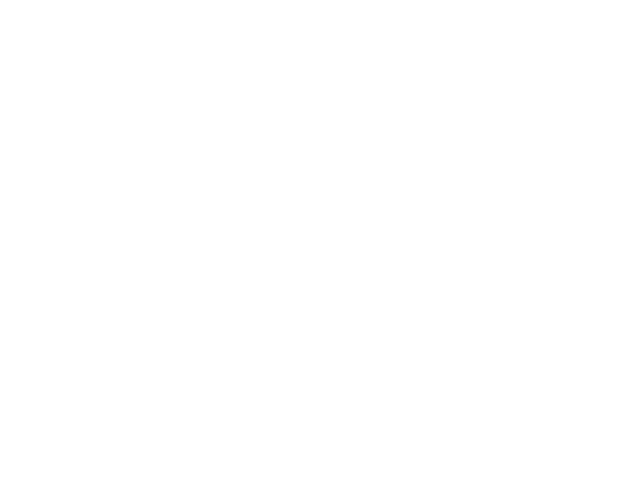

Sensor 85023
Errors:  10  ( 0.0636942675159 )
BIC - raw: -65.1282608948  BIC - clean: -124.71157872


<IPython.core.display.Javascript object>


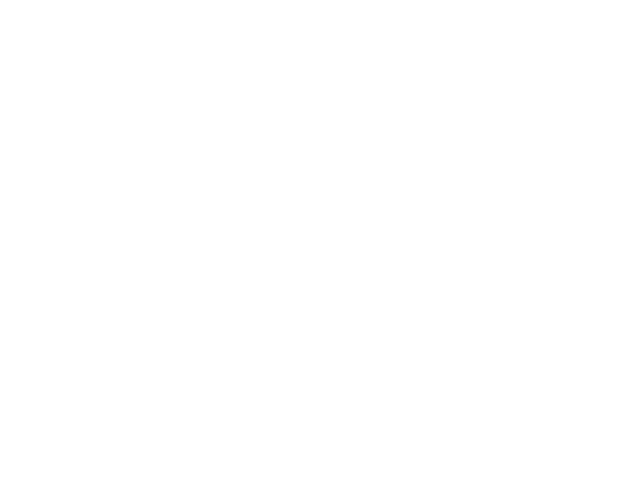

<class 'KeyError'>
('Value',)
Chosen 70066
Predict is run


<IPython.core.display.Javascript object>


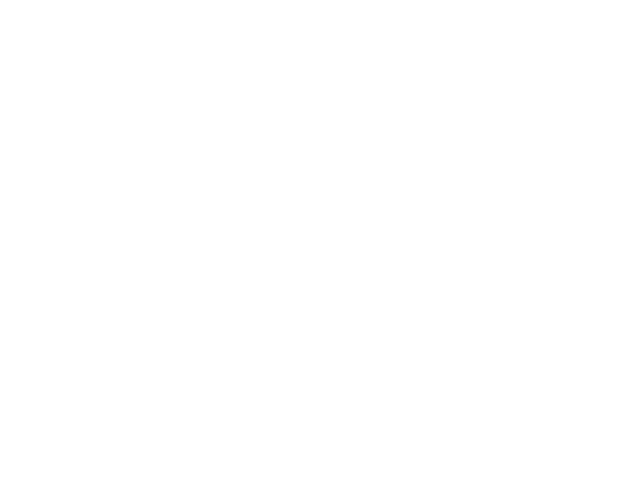

Sensor 70066
Errors:  12  ( 0.0394736842105 )
BIC - raw: -283.966181954  BIC - clean: -307.356513922


<IPython.core.display.Javascript object>


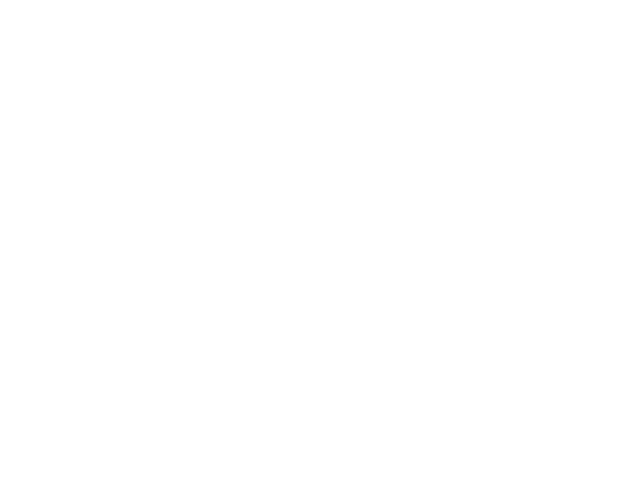

Chosen 65103
Predict is run


<IPython.core.display.Javascript object>


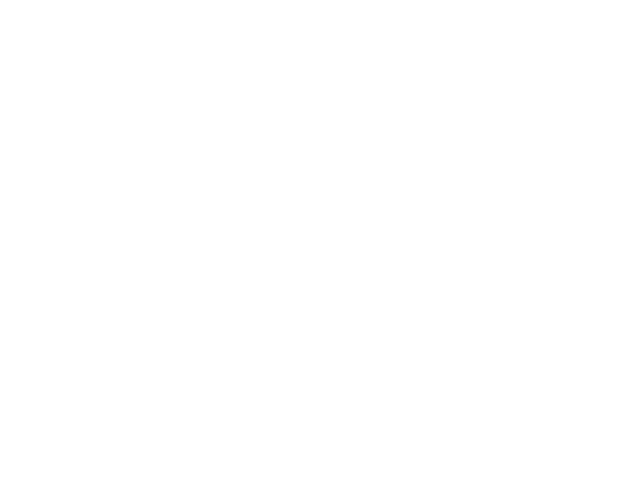

Sensor 65103
Errors:  53  ( 0.0838607594937 )
BIC - raw: -344.717584745  BIC - clean: -221.745316489


<IPython.core.display.Javascript object>


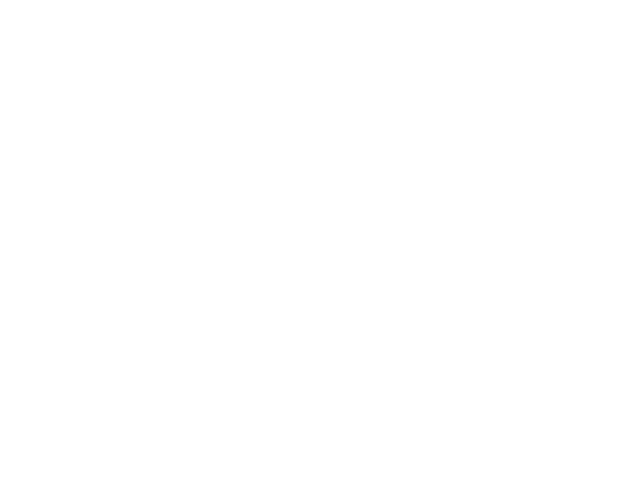

Chosen 65044
Predict is run


<IPython.core.display.Javascript object>


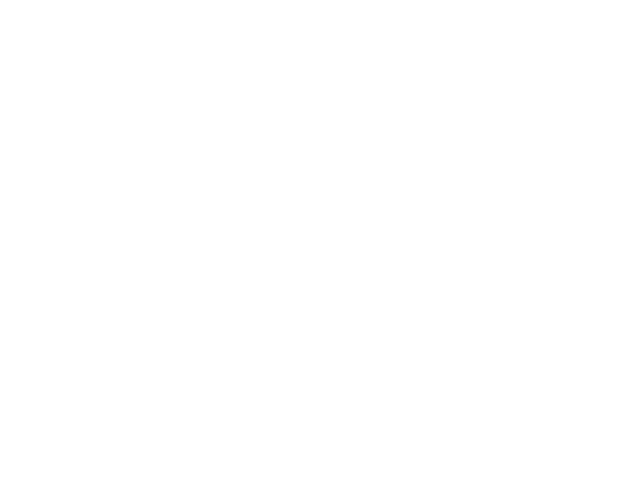

Sensor 65044
Errors:  9  ( 0.125 )
BIC - raw: 74.581086928  BIC - clean: 74.080433371


<IPython.core.display.Javascript object>


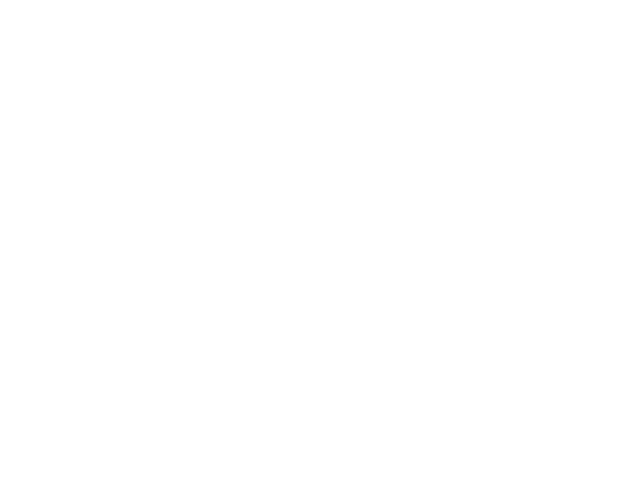

Chosen 65056
Predict is run


<IPython.core.display.Javascript object>


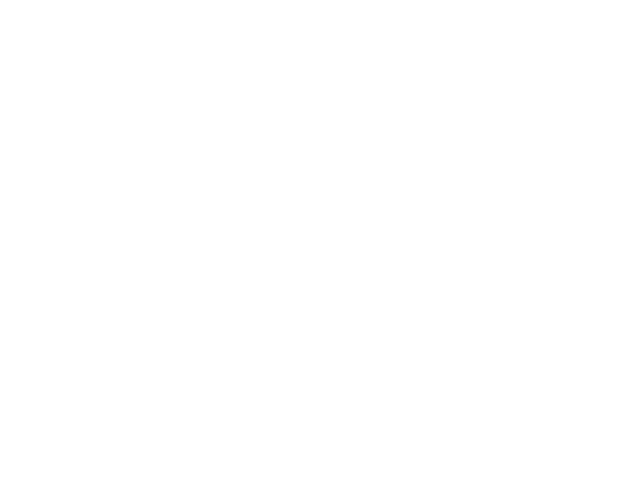

Sensor 65056
Errors:  13  ( 0.117117117117 )
BIC - raw: 105.658152498  BIC - clean: 71.894066221


<IPython.core.display.Javascript object>


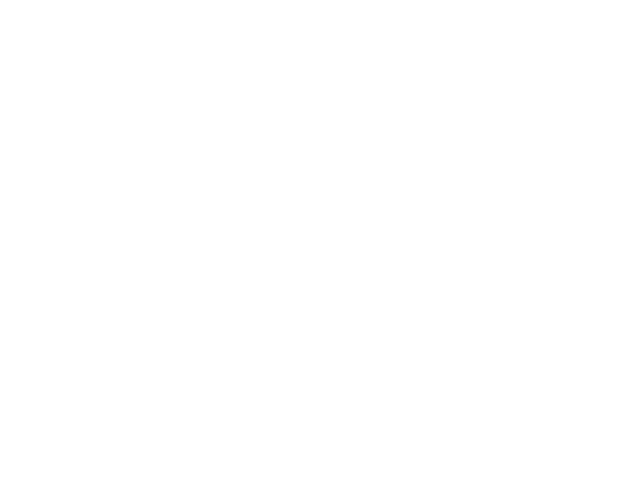

Chosen 25030
Predict is run


<IPython.core.display.Javascript object>


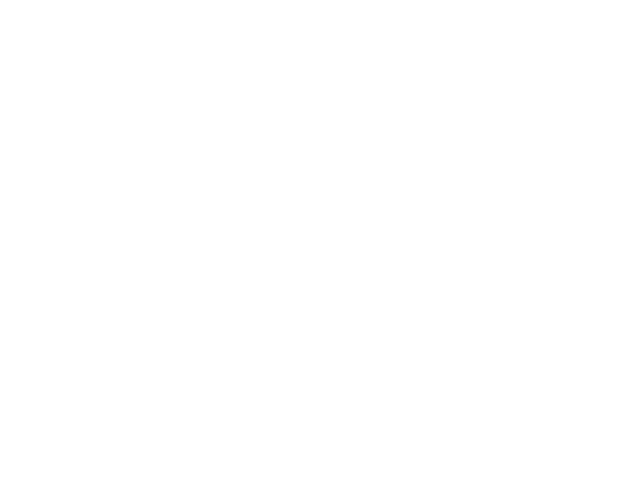

Sensor 25030
Errors:  1198  ( 0.479775730877 )
BIC - raw: 6855.03044331  BIC - clean: 8617.38639659


<IPython.core.display.Javascript object>


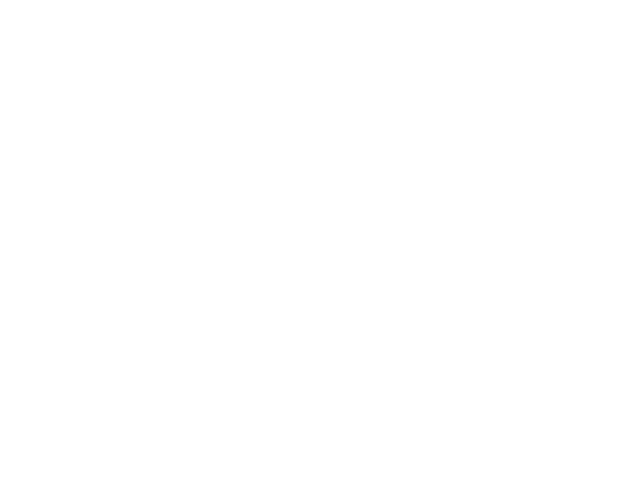

Chosen 65043
Predict is run


<IPython.core.display.Javascript object>


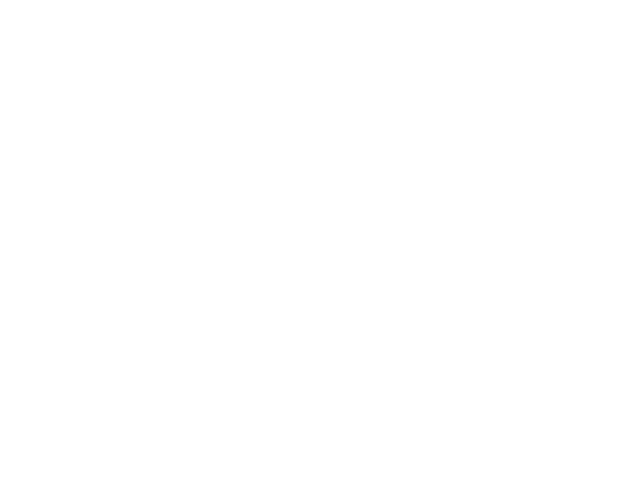

Sensor 65043
Errors:  45  ( 0.3 )
BIC - raw: 317.524052896  BIC - clean: 265.016042337


<IPython.core.display.Javascript object>


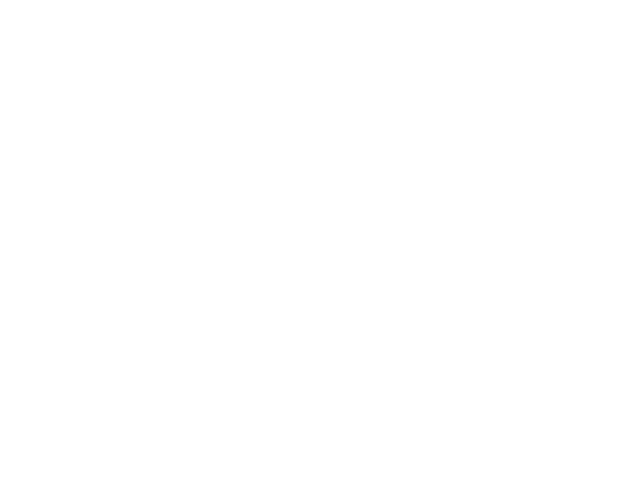

<class 'KeyError'>
('Value',)
Chosen 50062
Predict is run


<IPython.core.display.Javascript object>


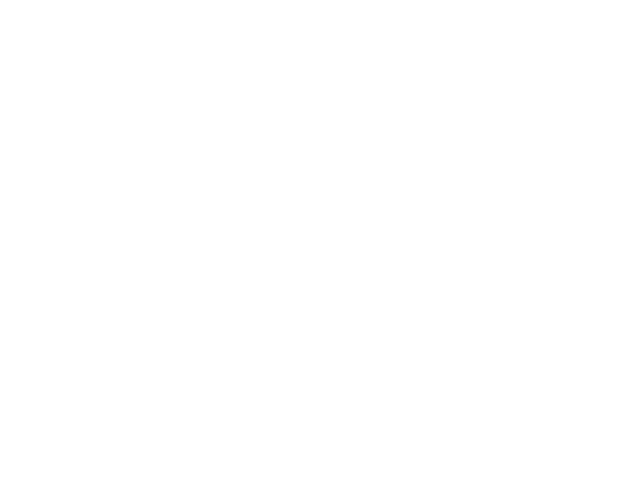

Sensor 50062
Errors:  1  ( 0.00431034482759 )
BIC - raw: 3451.8891729  BIC - clean: 227.111059433


<IPython.core.display.Javascript object>


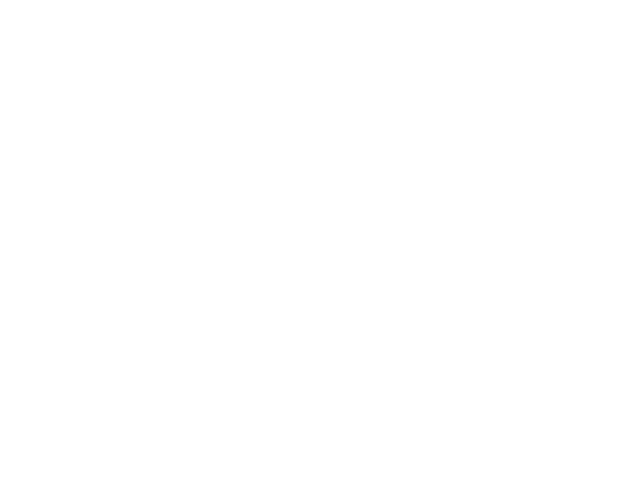

<class 'KeyError'>
('Value',)
Chosen 25004
Predict is run


<IPython.core.display.Javascript object>


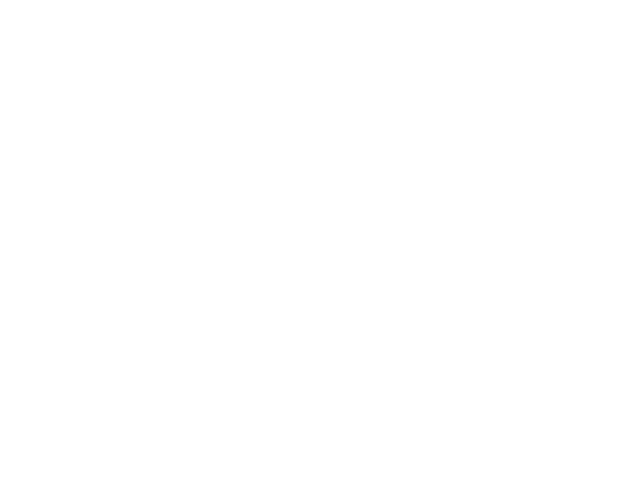

Sensor 25004
Errors:  10  ( 0.03003003003 )
BIC - raw: -479.123702085  BIC - clean: -587.038806185


<IPython.core.display.Javascript object>


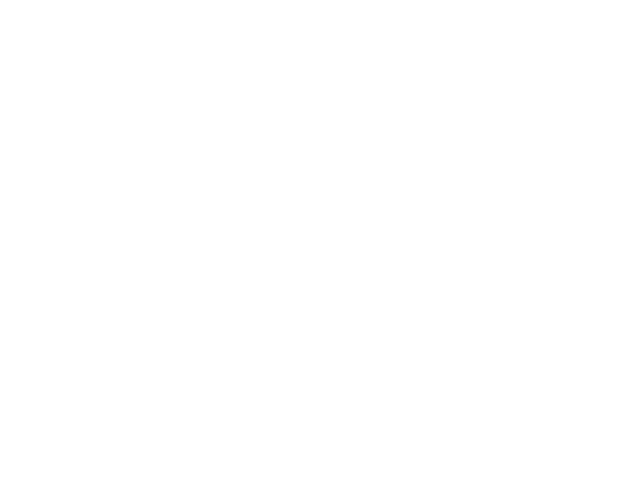

Chosen 15008
Predict is run


<IPython.core.display.Javascript object>


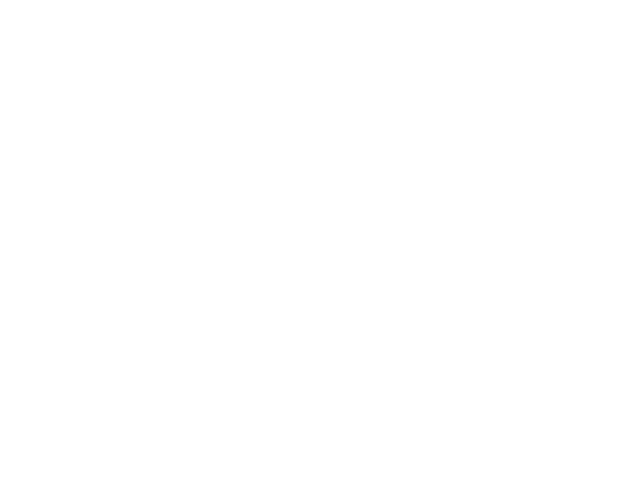

Sensor 15008
Errors:  7  ( 0.0460526315789 )
BIC - raw: -255.618040462  BIC - clean: -323.76679657


<IPython.core.display.Javascript object>


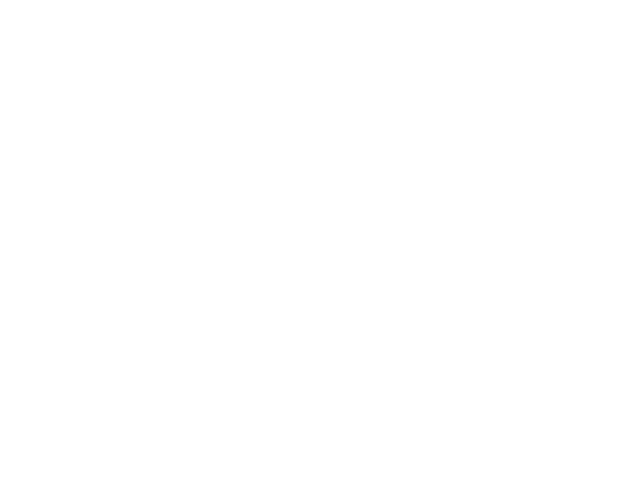

Chosen 65010
Predict is run


<IPython.core.display.Javascript object>


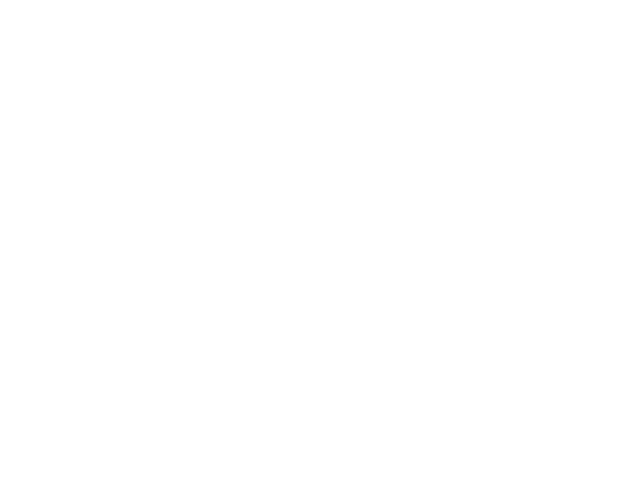

Sensor 65010
Errors:  442  ( 0.0346857098015 )
BIC - raw: -25241.8804832  BIC - clean: -11502.1466201


<IPython.core.display.Javascript object>


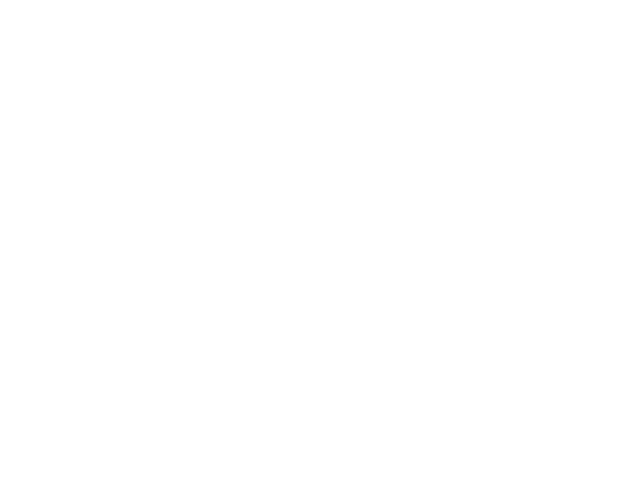

Chosen 65042
Predict is run


<IPython.core.display.Javascript object>


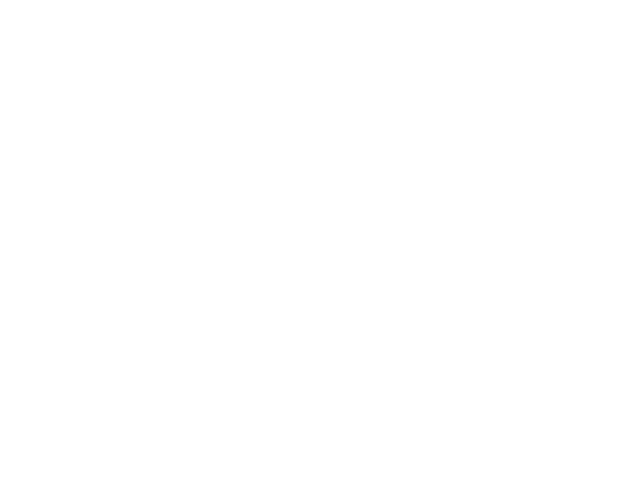

Sensor 65042
Errors:  16  ( 0.106666666667 )
BIC - raw: 119.542415396  BIC - clean: 75.052978526


<IPython.core.display.Javascript object>


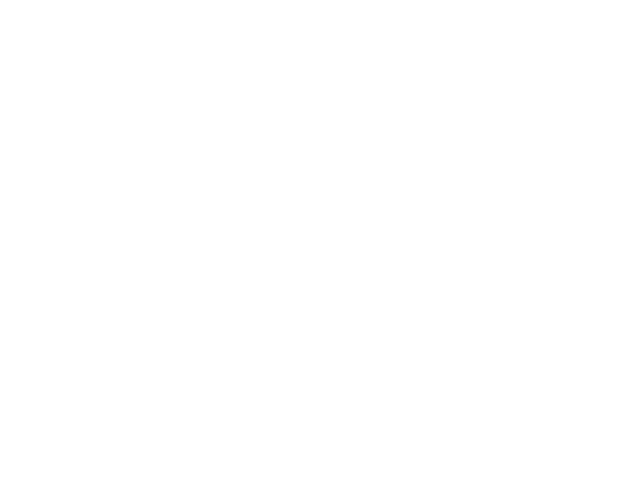

Chosen 25020
Predict is run


<IPython.core.display.Javascript object>


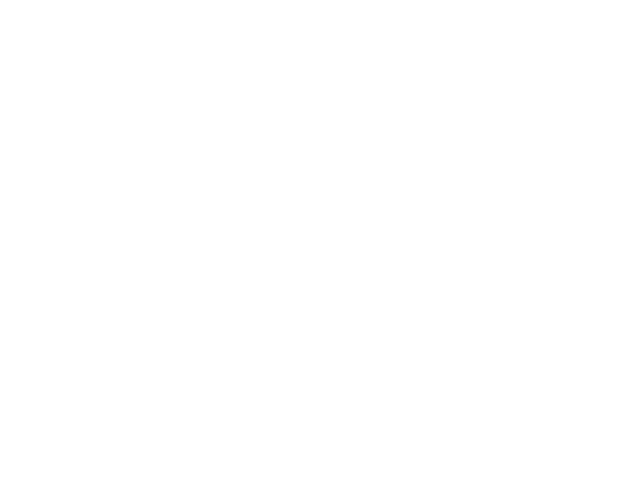

Sensor 25020
Errors:  688  ( 0.33140655106 )
BIC - raw: 2377.52352287  BIC - clean: 3114.11235694


<IPython.core.display.Javascript object>


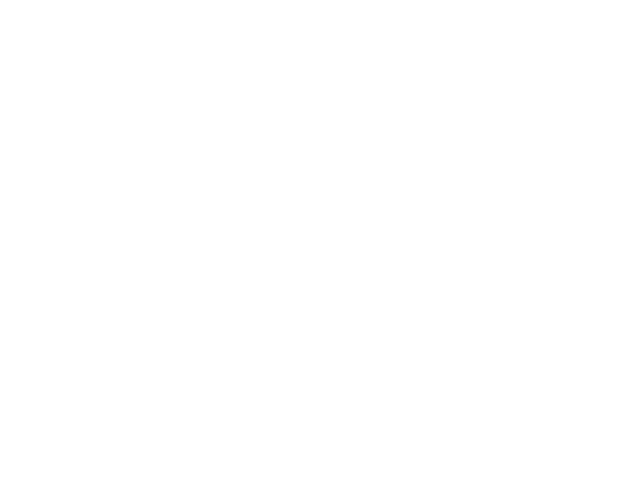

Chosen 25102
Predict is run


<IPython.core.display.Javascript object>


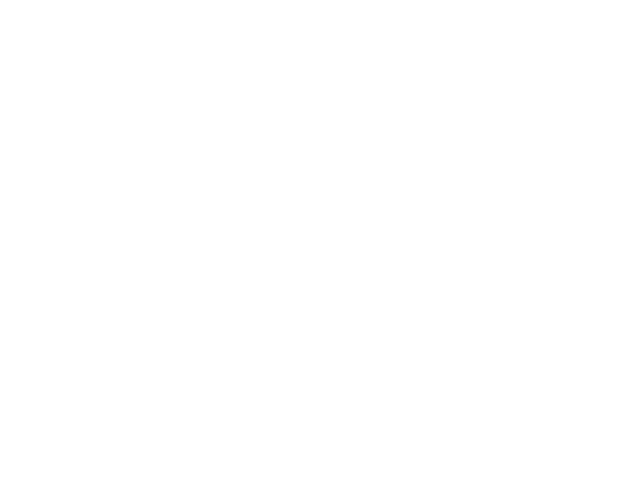

Sensor 25102
Errors:  263  ( 0.209896249002 )
BIC - raw: 598.285556816  BIC - clean: 794.678596783


<IPython.core.display.Javascript object>


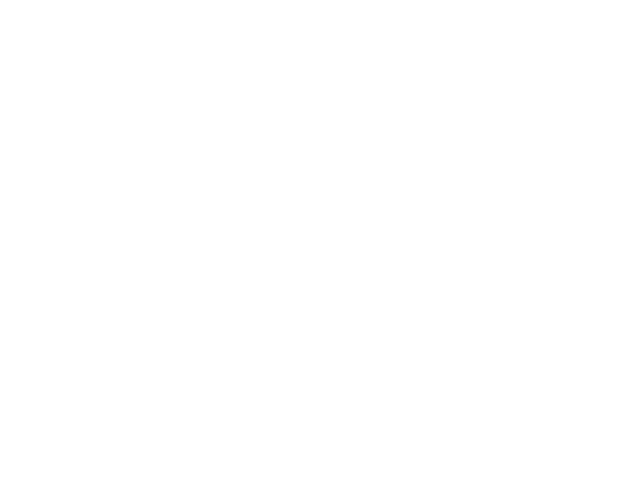

Chosen 25055
Predict is run


<IPython.core.display.Javascript object>


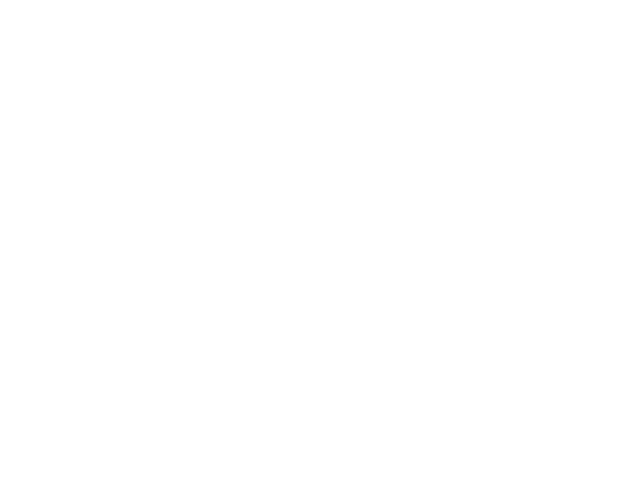

Sensor 25055
Errors:  29  ( 0.261261261261 )
BIC - raw: 199.08282885  BIC - clean: 160.812165111


<IPython.core.display.Javascript object>


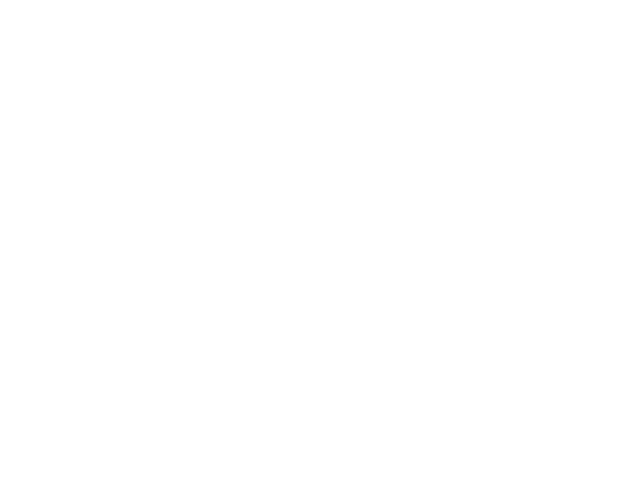

Chosen 25056
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 25050
Predict is run


<IPython.core.display.Javascript object>


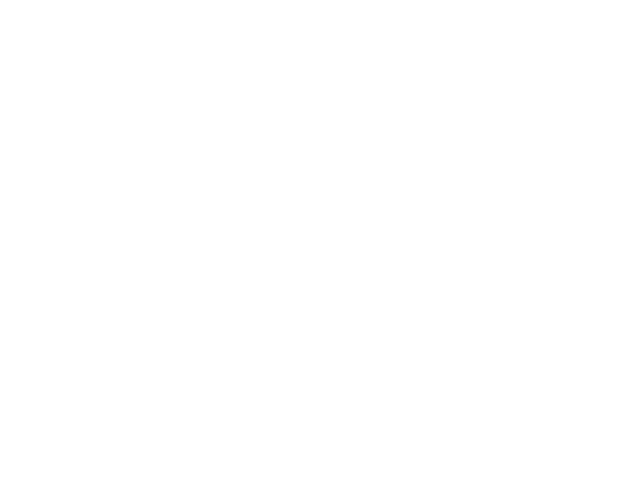

Sensor 25050
Errors:  34  ( 0.22972972973 )
BIC - raw: 188.32264722  BIC - clean: 157.135931658


<IPython.core.display.Javascript object>


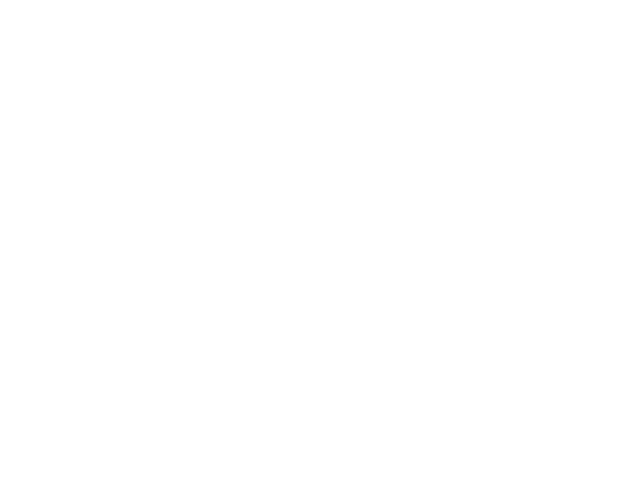

Chosen 25070
Predict is run


<IPython.core.display.Javascript object>


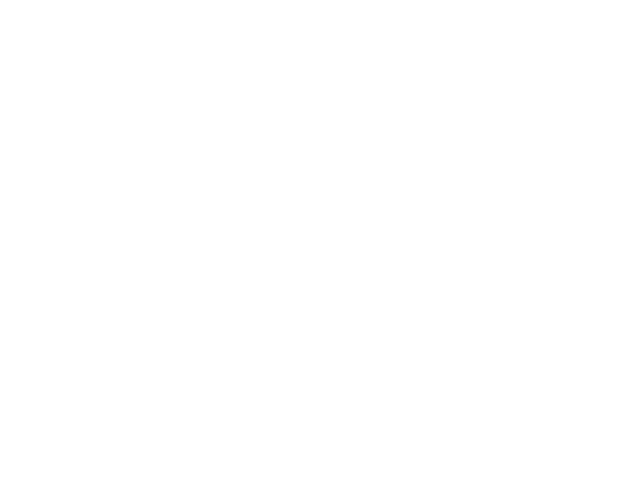

Sensor 25070
Errors:  108  ( 0.232258064516 )
BIC - raw: 89.5586599102  BIC - clean: 240.350586229


<IPython.core.display.Javascript object>


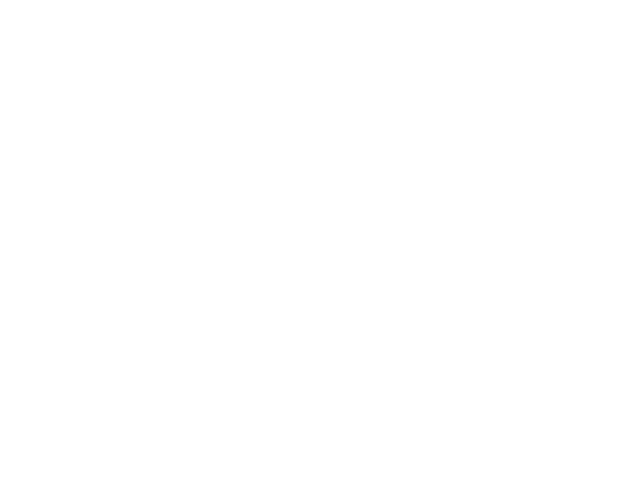

Chosen 90088
Predict is run


<IPython.core.display.Javascript object>


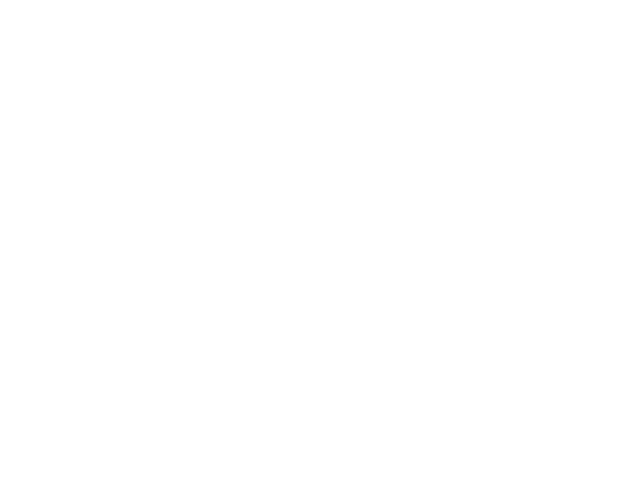

Sensor 90088
Errors:  2  ( 0.0408163265306 )
BIC - raw: -64.0173459738  BIC - clean: -64.0173459738


<IPython.core.display.Javascript object>


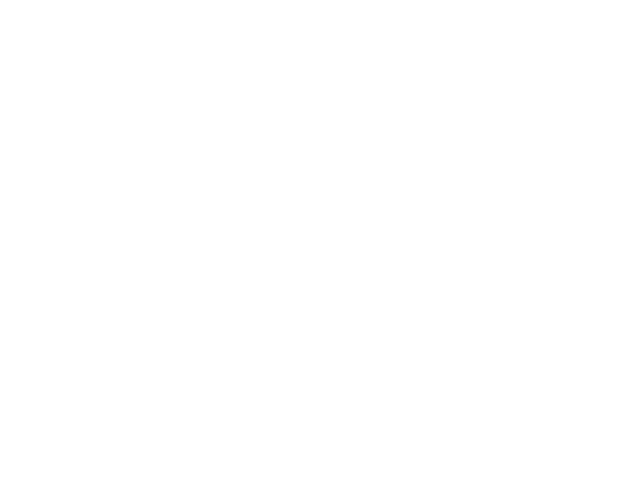

Chosen 25060
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 25040
Predict is run


<IPython.core.display.Javascript object>


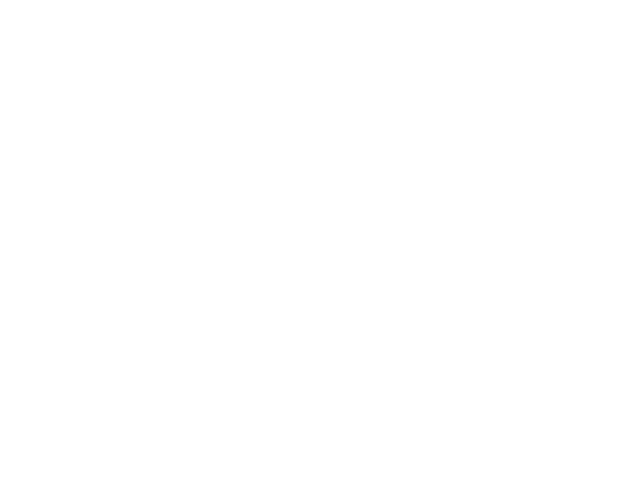

Sensor 25040
Errors:  5  ( 0.0694444444444 )
BIC - raw: 25.3500489353  BIC - clean: 27.5685995865


<IPython.core.display.Javascript object>


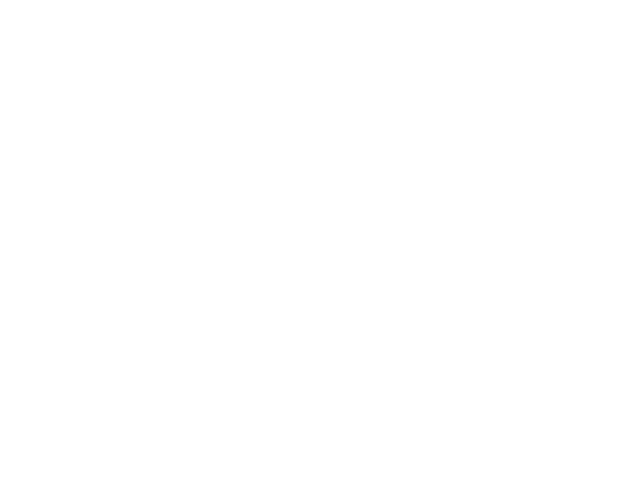

Chosen 50006
Predict is run


<IPython.core.display.Javascript object>


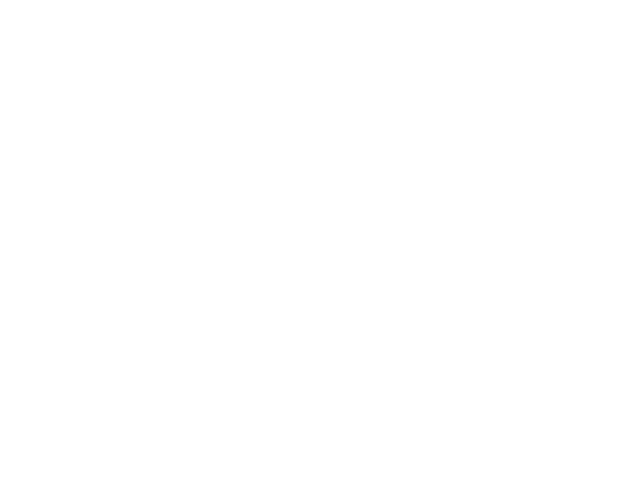

Sensor 50006
Errors:  5  ( 0.0192307692308 )
BIC - raw: 4097.03269604  BIC - clean: -106.905943093


<IPython.core.display.Javascript object>


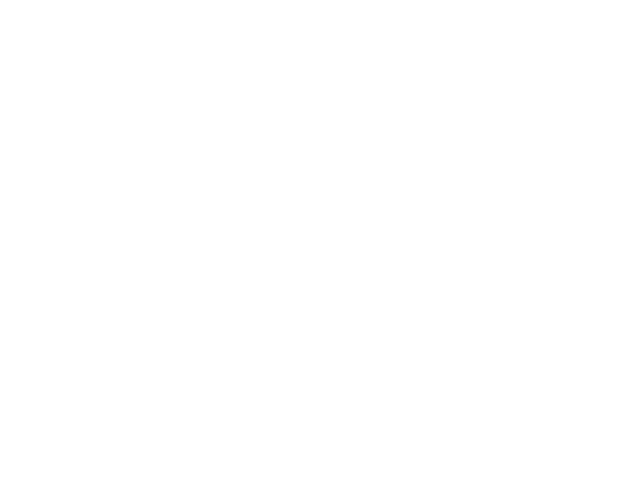

Chosen 25015
Predict is run


<IPython.core.display.Javascript object>


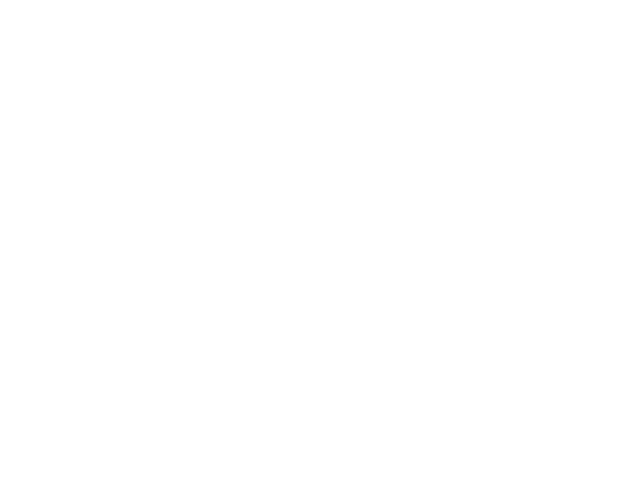

Sensor 25015
Errors:  2  ( 0.0512820512821 )
BIC - raw: -5.14527877451  BIC - clean: -5.14527877451


<IPython.core.display.Javascript object>


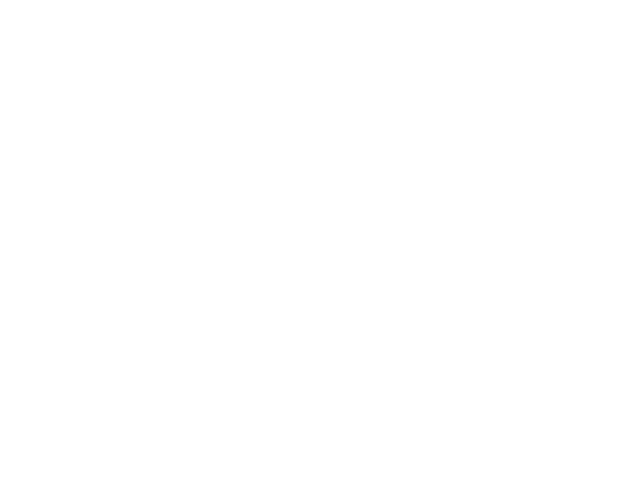

Chosen 25010
Predict is run


<IPython.core.display.Javascript object>


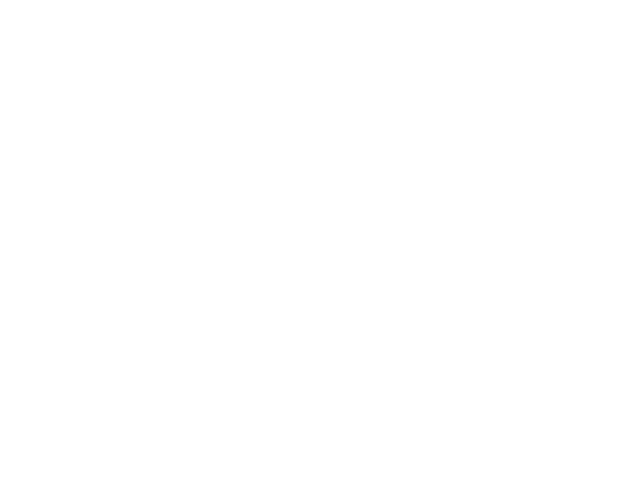

Sensor 25010
Errors:  10  ( 0.138888888889 )
BIC - raw: 73.4738137764  BIC - clean: 84.9063105661


<IPython.core.display.Javascript object>


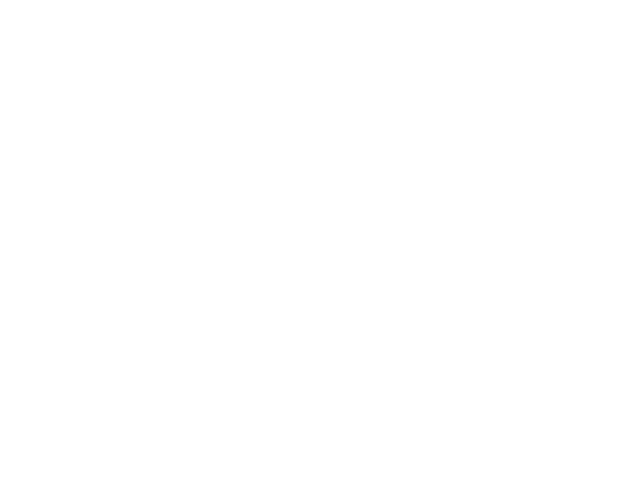

Chosen 95022
Predict is run


<IPython.core.display.Javascript object>


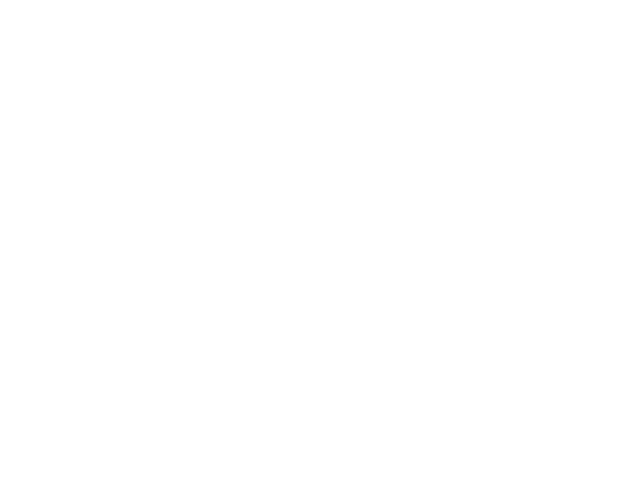

Sensor 95022
Errors:  36  ( 0.307692307692 )
BIC - raw: 56.9440072132  BIC - clean: 19.3511522065


<IPython.core.display.Javascript object>


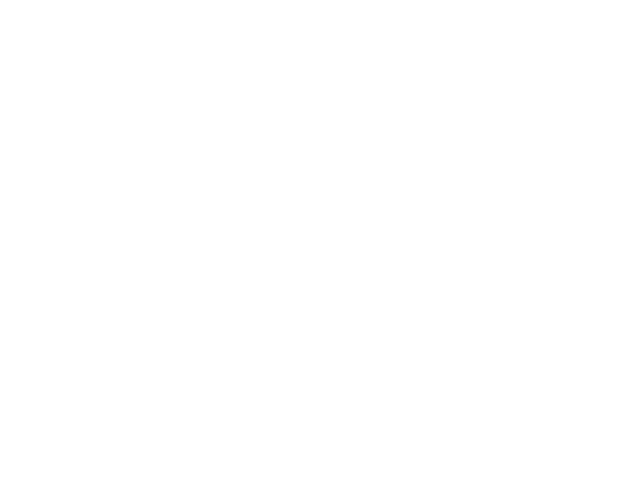

Chosen 30005
Predict is run


<IPython.core.display.Javascript object>


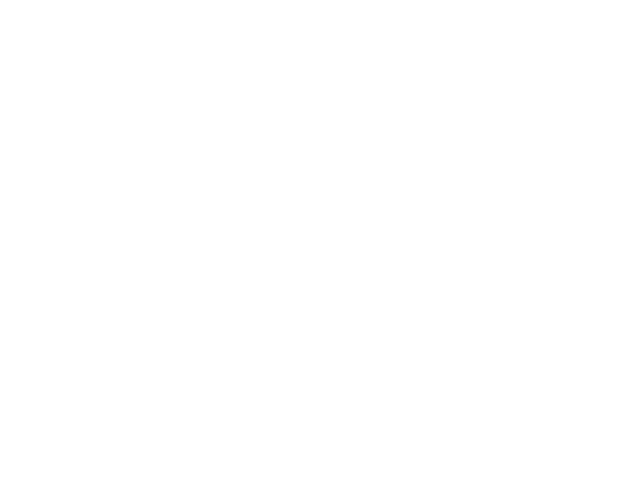

Sensor 30005
Errors:  781  ( 0.0772196954716 )
BIC - raw: -9293.46566059  BIC - clean: -7056.58297626


<IPython.core.display.Javascript object>


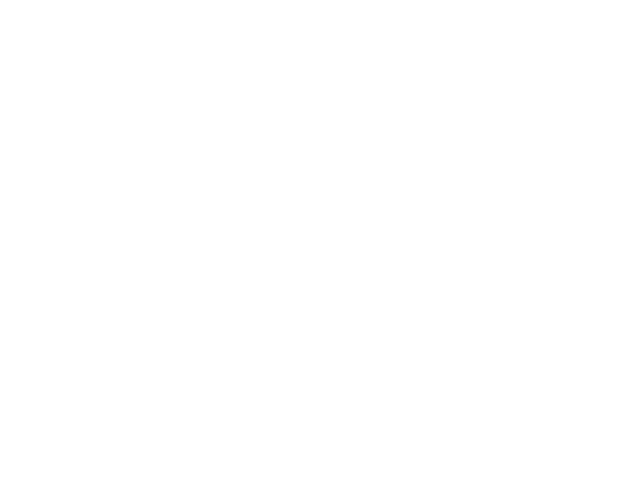

Chosen 90012
Predict is run


<IPython.core.display.Javascript object>


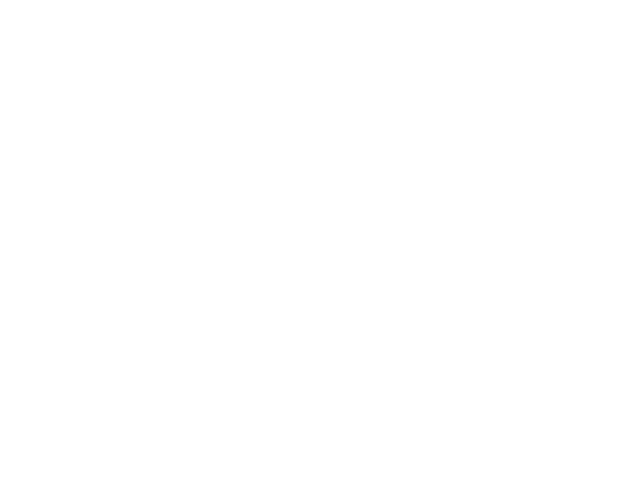

Sensor 90012
Errors:  9  ( 0.0625 )
BIC - raw: 19.04904245  BIC - clean: -41.0024790988


<IPython.core.display.Javascript object>


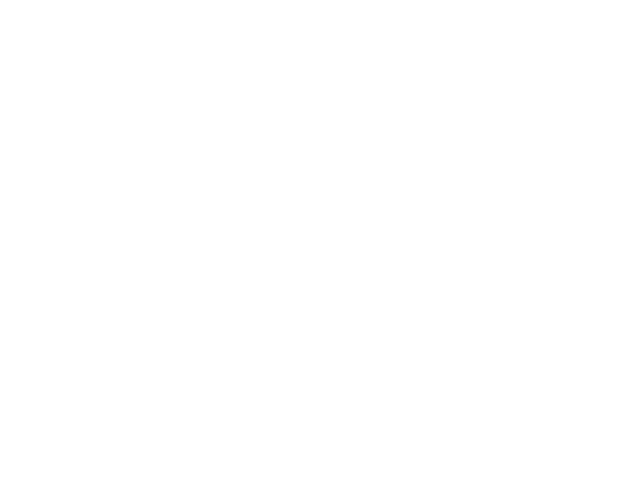

Chosen 65060
Predict is run


<IPython.core.display.Javascript object>


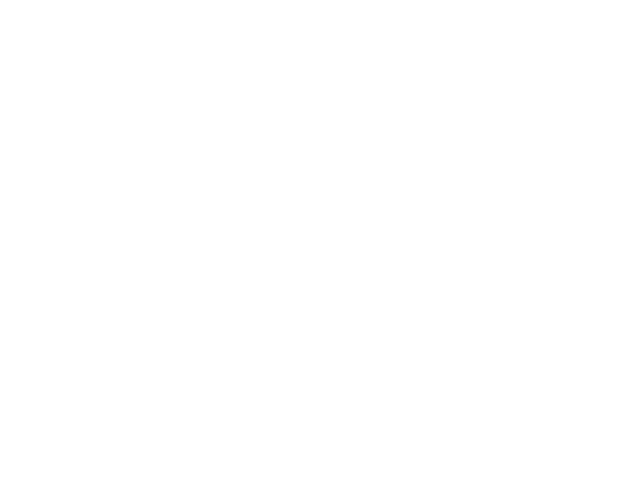

Sensor 65060
Errors:  38  ( 0.0608974358974 )
BIC - raw: 10489.896179  BIC - clean: 9629.3100361


<IPython.core.display.Javascript object>


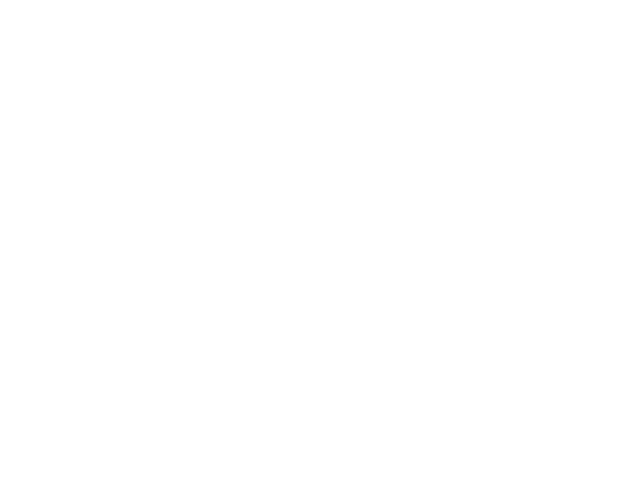

Chosen 70012
Predict is run


<IPython.core.display.Javascript object>


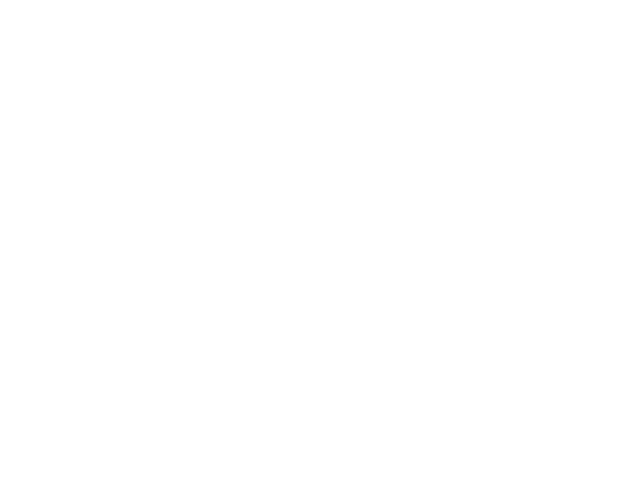

Sensor 70012
Errors:  11  ( 0.0100364963504 )
BIC - raw: -4316.48695913  BIC - clean: -2010.71004697


<IPython.core.display.Javascript object>


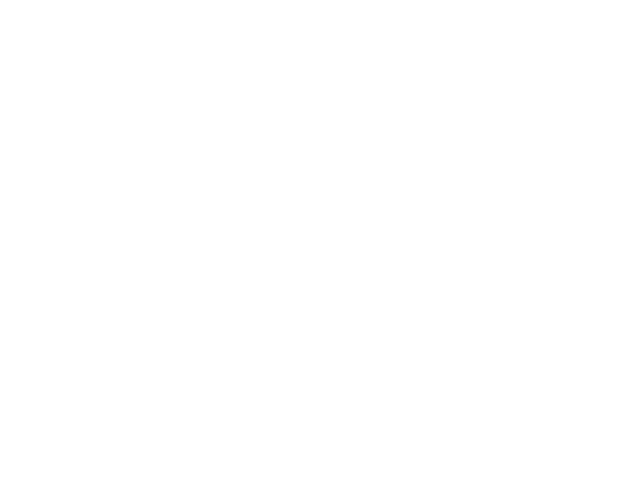

<class 'KeyError'>
('Value',)
Chosen 35022
Predict is run


<IPython.core.display.Javascript object>


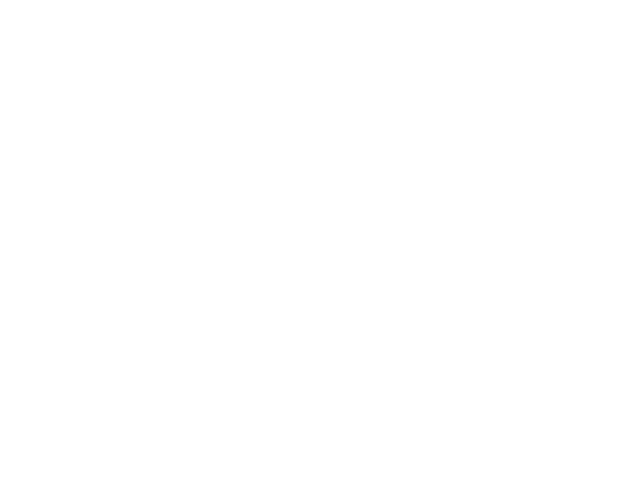

Sensor 35022
Errors:  175  ( 0.254360465116 )
BIC - raw: 762.289602737  BIC - clean: 1085.05131748


<IPython.core.display.Javascript object>


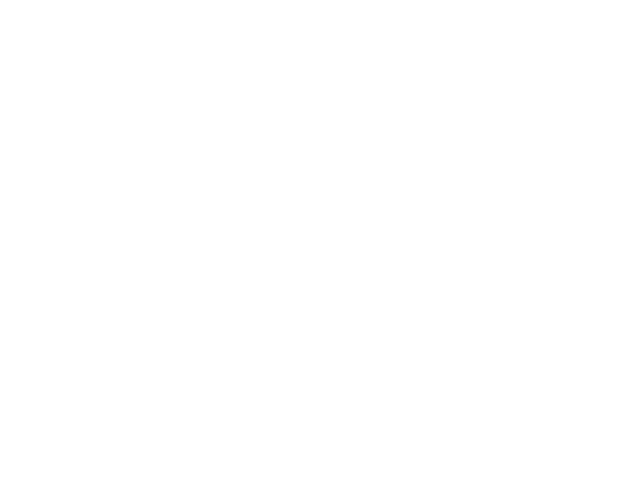

Chosen 35018
Predict is run


<IPython.core.display.Javascript object>


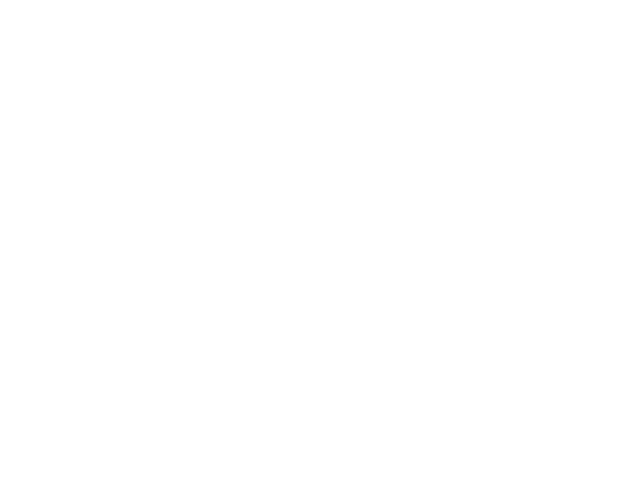

Sensor 35018
Errors:  10  ( 0.0110253583241 )
BIC - raw: -3381.30749634  BIC - clean: -2862.33708119


<IPython.core.display.Javascript object>


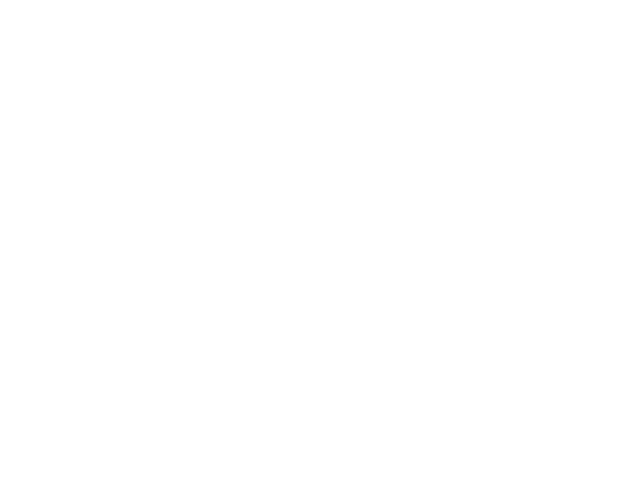

<class 'KeyError'>
('Value',)
Chosen 50090
Predict is run


<IPython.core.display.Javascript object>


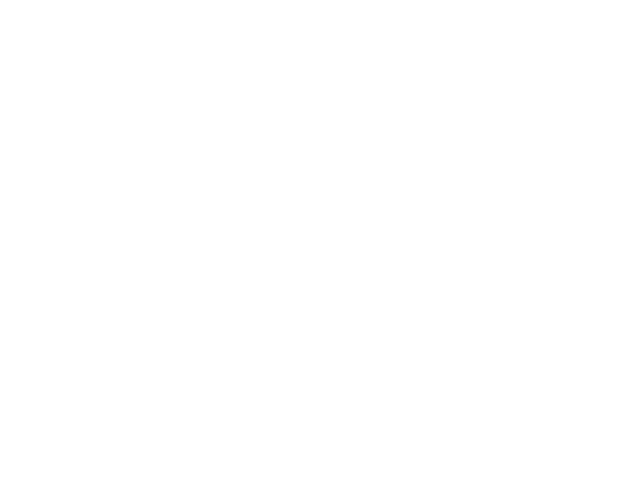

Sensor 50090
Errors:  791  ( 0.0898557310008 )
BIC - raw: 2038.19236098  BIC - clean: 7277.55767509


<IPython.core.display.Javascript object>


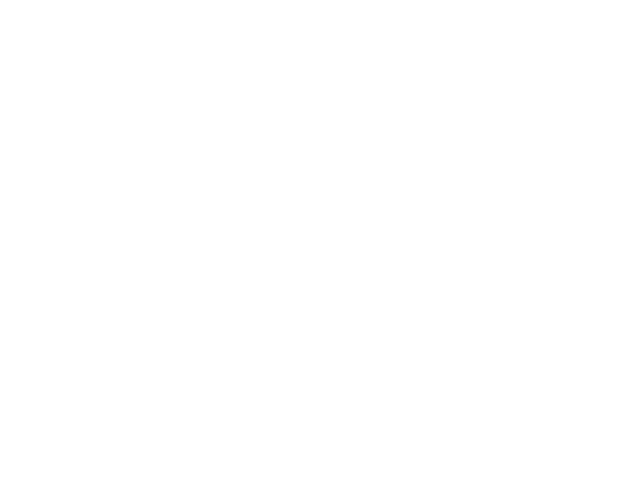

Chosen 55080
Predict is run


<IPython.core.display.Javascript object>


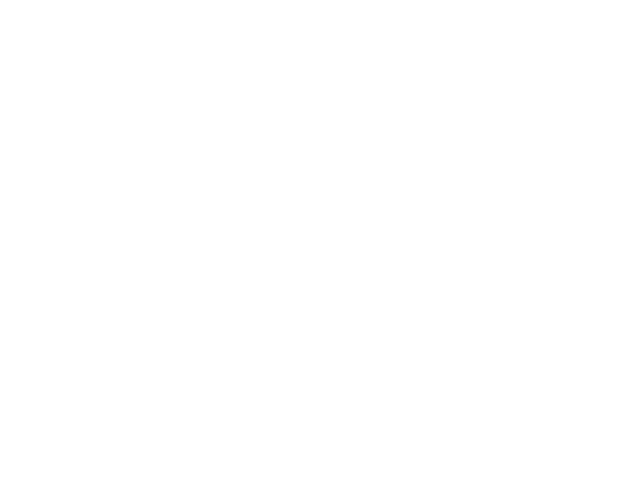

Sensor 55080
Errors:  387  ( 0.0690454950937 )
BIC - raw: -9995.45467626  BIC - clean: -8358.62213102


<IPython.core.display.Javascript object>


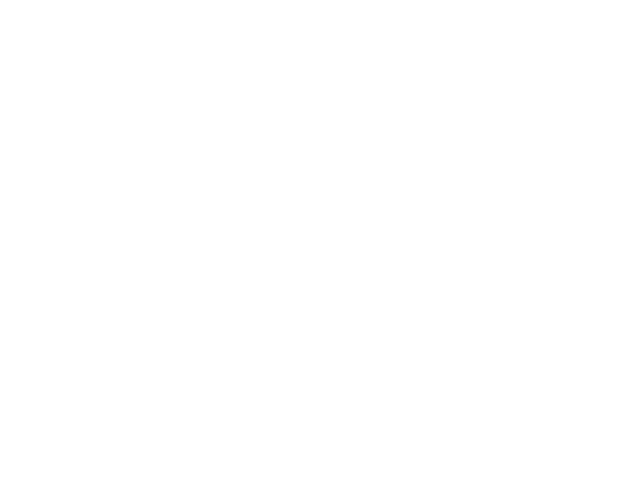

<class 'KeyError'>
('Value',)
Chosen 35035
Predict is run


<IPython.core.display.Javascript object>


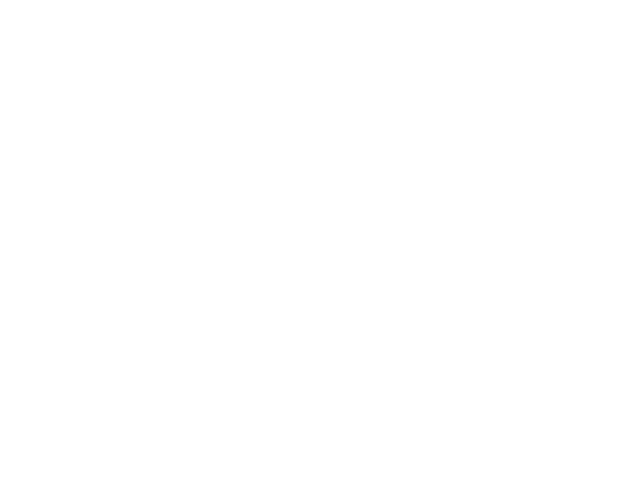

Sensor 35035
Errors:  52  ( 0.285714285714 )
BIC - raw: 313.655041554  BIC - clean: 337.57403303


<IPython.core.display.Javascript object>


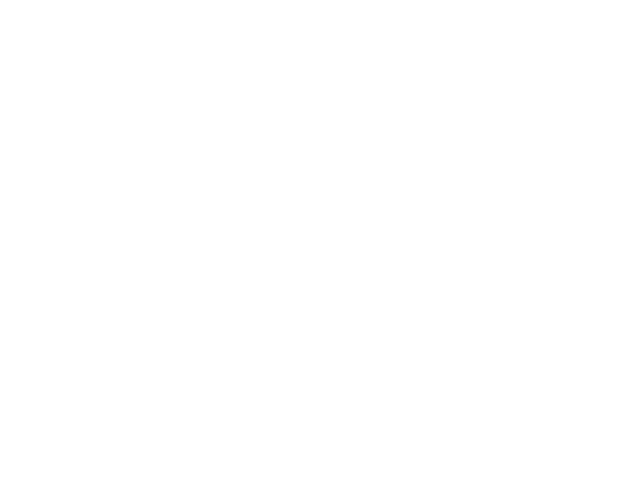

Chosen 25025
Predict is run


<IPython.core.display.Javascript object>


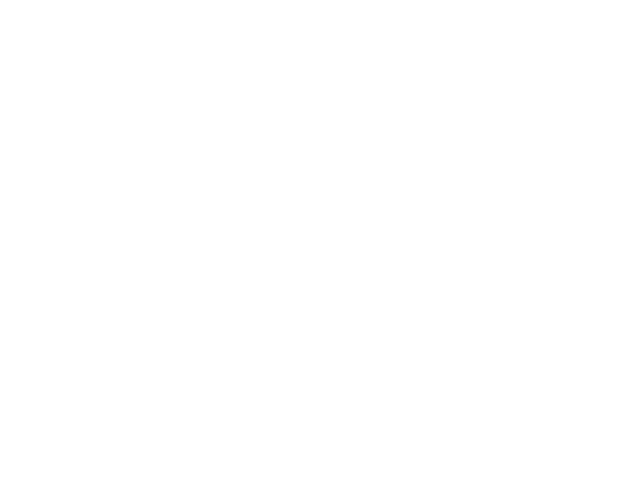

Sensor 25025
Errors:  14  ( 0.194444444444 )
BIC - raw: 127.225471877  BIC - clean: 95.3835500963


<IPython.core.display.Javascript object>


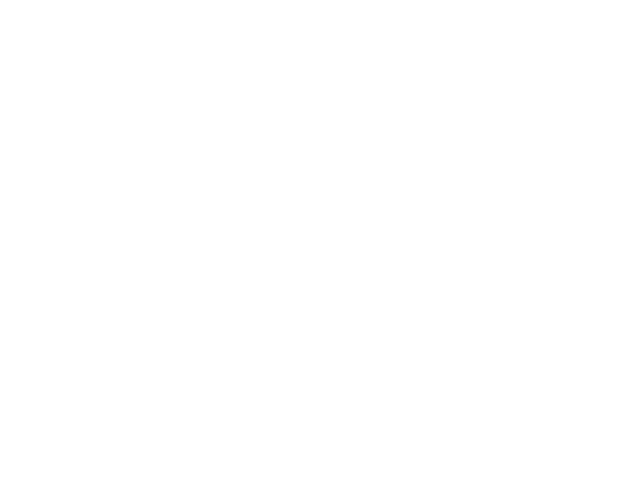

Chosen 35036
Predict is run


<IPython.core.display.Javascript object>


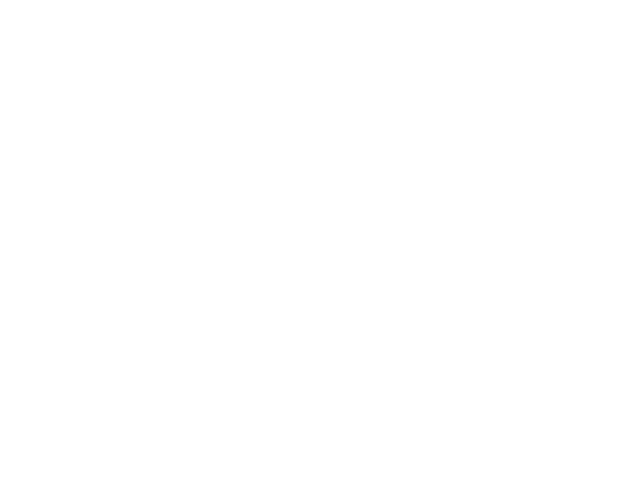

Sensor 35036
Errors:  213  ( 0.0451080050826 )
BIC - raw: -9479.6903833  BIC - clean: -4981.37760749


<IPython.core.display.Javascript object>


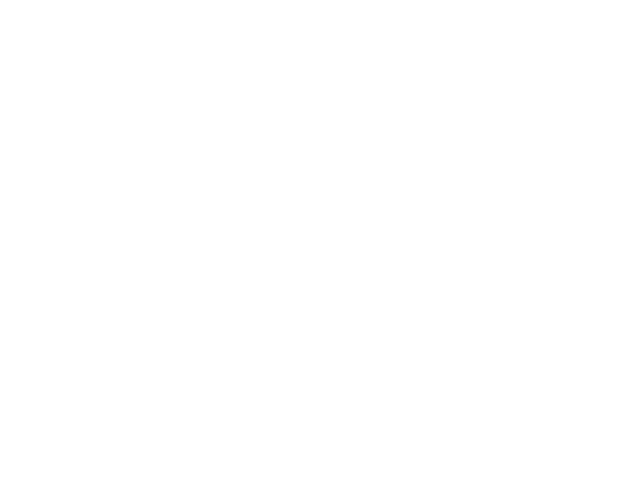

Chosen 20060
Predict is run


<IPython.core.display.Javascript object>


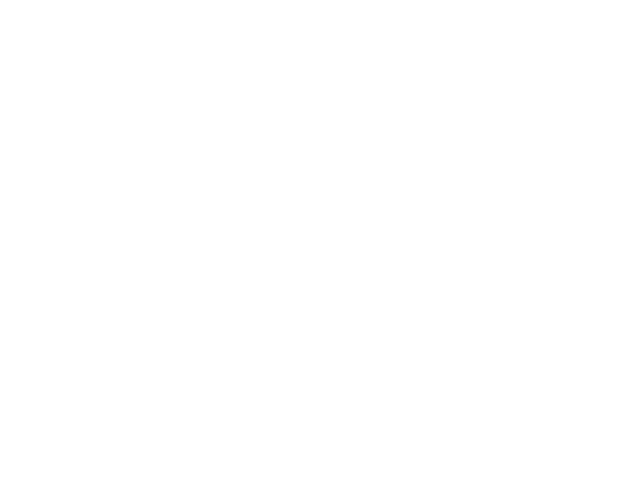

Sensor 20060
Errors:  7  ( 0.0395480225989 )
BIC - raw: -198.207634402  BIC - clean: -213.253627045


<IPython.core.display.Javascript object>


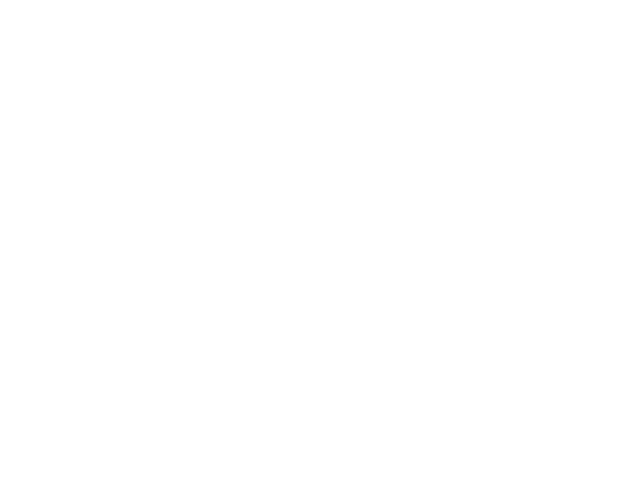

Chosen 35011
Predict is run


<IPython.core.display.Javascript object>


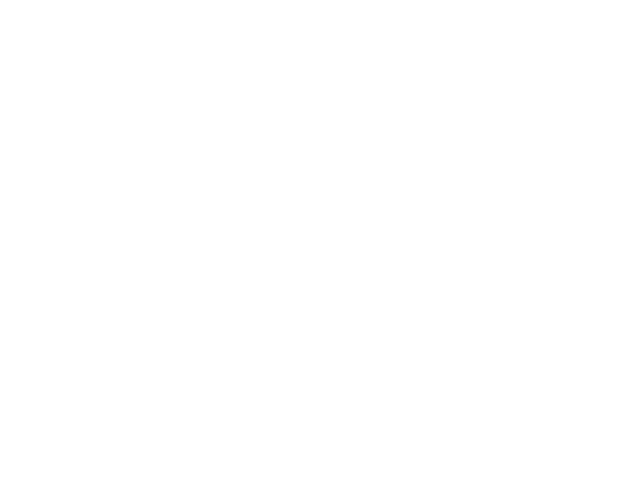

Sensor 35011
Errors:  12  ( 0.0652173913043 )
BIC - raw: 0.94276197703  BIC - clean: -16.6162070118


<IPython.core.display.Javascript object>


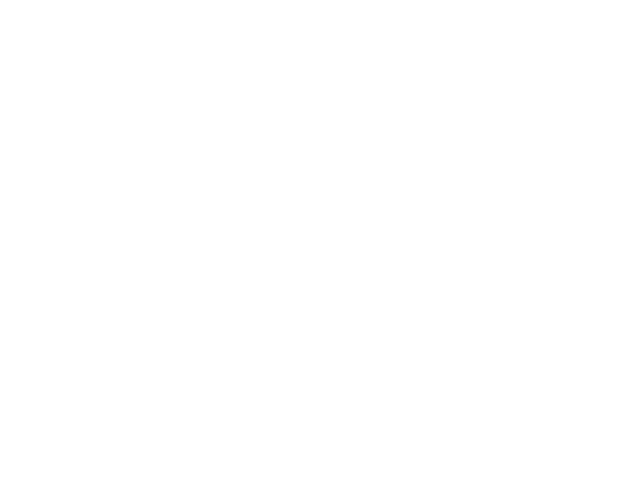

Chosen 35049
Predict is run


<IPython.core.display.Javascript object>


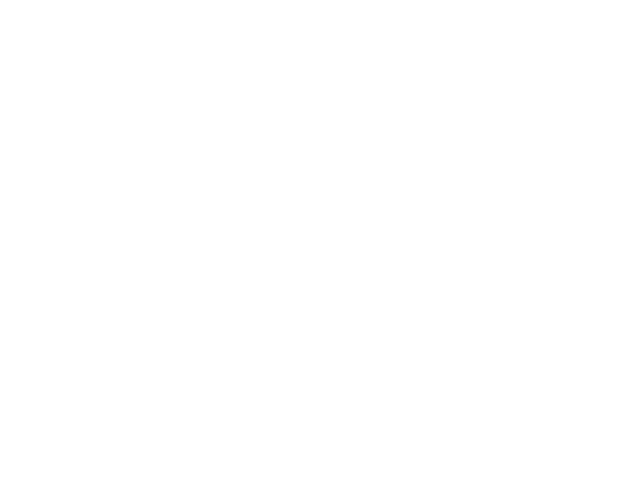

Sensor 35049
Errors:  98  ( 0.110734463277 )
BIC - raw: 15594.5503519  BIC - clean: 14799.3864493


<IPython.core.display.Javascript object>


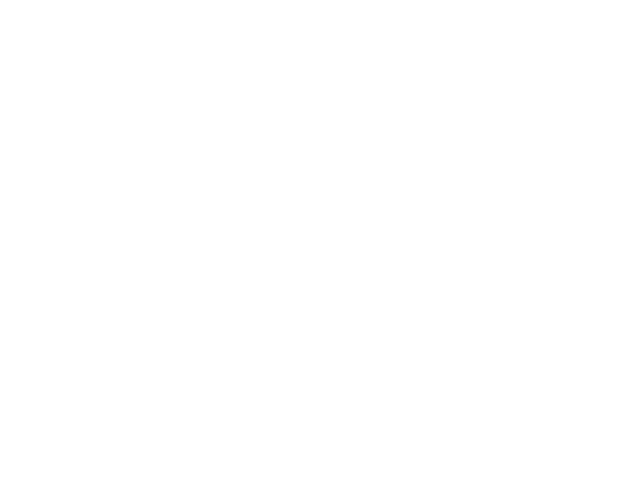

Chosen 80103
Predict is run


<IPython.core.display.Javascript object>


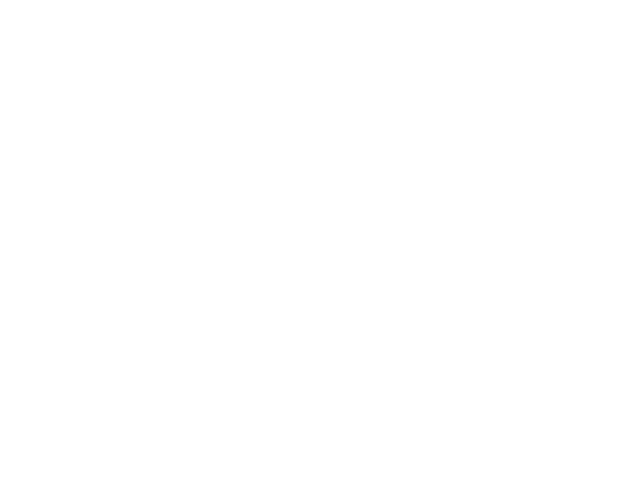

Sensor 80103
Errors:  102  ( 0.0982658959538 )
BIC - raw: -236.341544776  BIC - clean: 9.72819279162


<IPython.core.display.Javascript object>


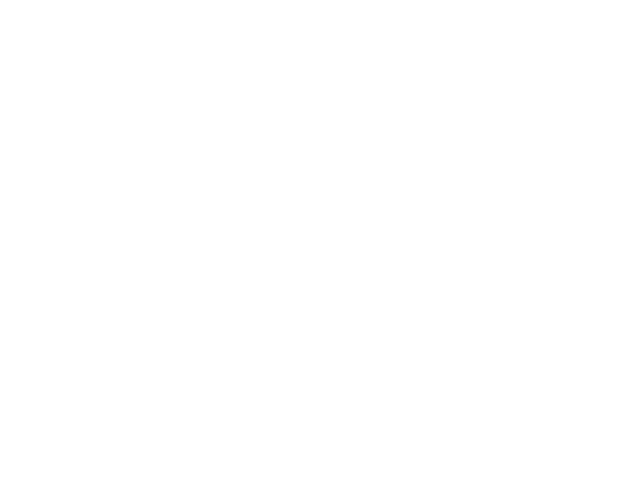

Chosen 35024
Predict is run


<IPython.core.display.Javascript object>


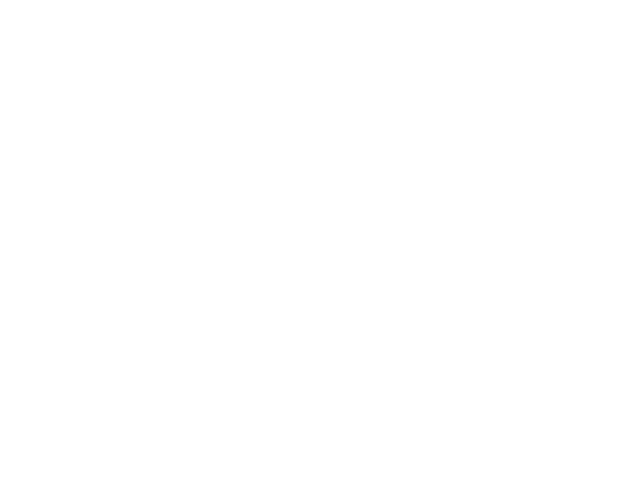

Sensor 35024
Errors:  26  ( 0.329113924051 )
BIC - raw: 92.3778620018  BIC - clean: 108.880867471


<IPython.core.display.Javascript object>


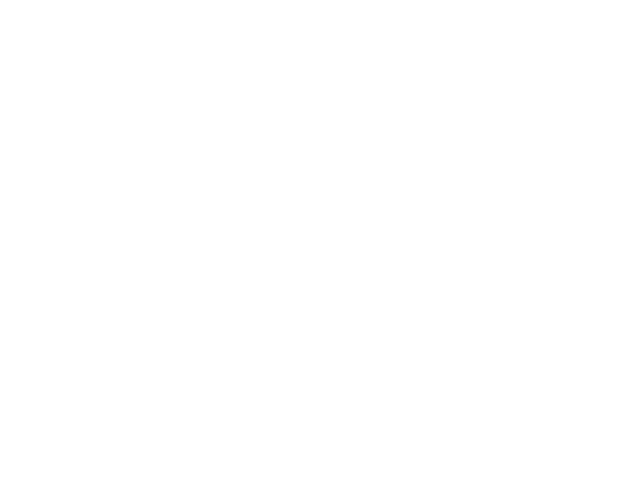

<class 'KeyError'>
('Value',)
Chosen 50050
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 35025
Predict is run


<IPython.core.display.Javascript object>


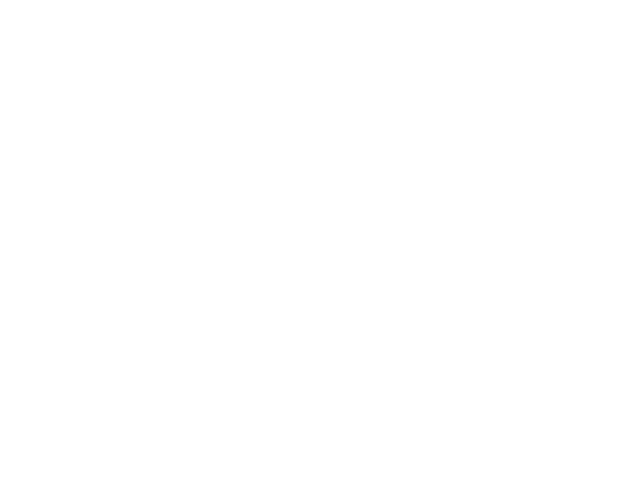

Sensor 35025
Errors:  64  ( 0.191616766467 )
BIC - raw: 332.163046837  BIC - clean: 395.021700056


<IPython.core.display.Javascript object>


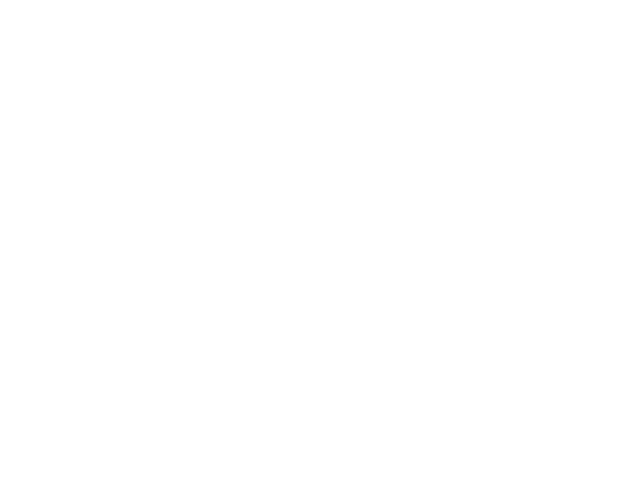

Chosen 85025
Predict is run


<IPython.core.display.Javascript object>


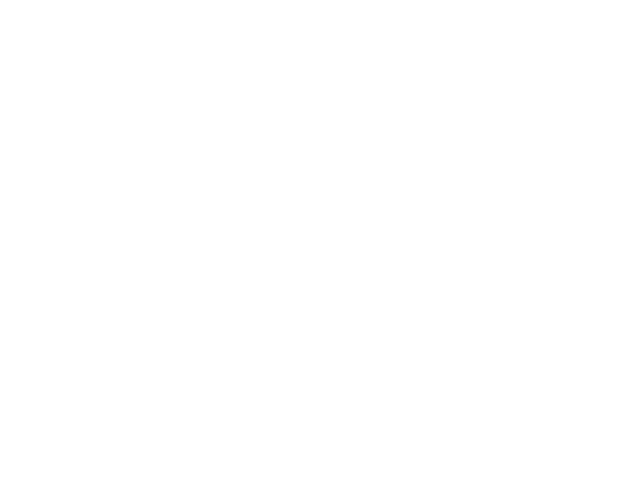

Sensor 85025
Errors:  2  ( 0.0136054421769 )
BIC - raw: 2163.81835113  BIC - clean: 45.2969913806


<IPython.core.display.Javascript object>


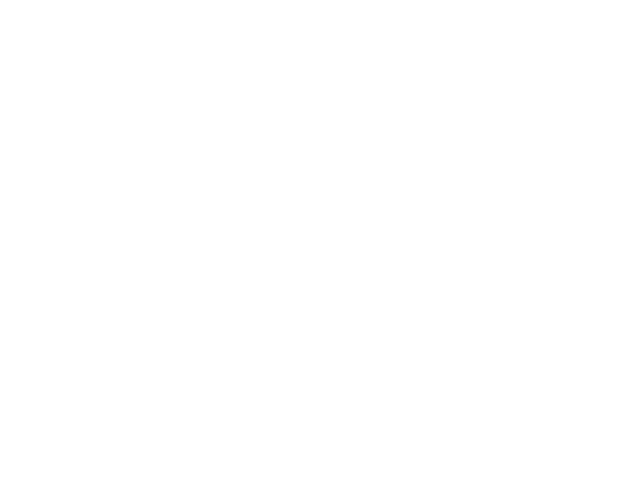

<class 'KeyError'>
('Value',)
Chosen 35002
Predict is run


<IPython.core.display.Javascript object>


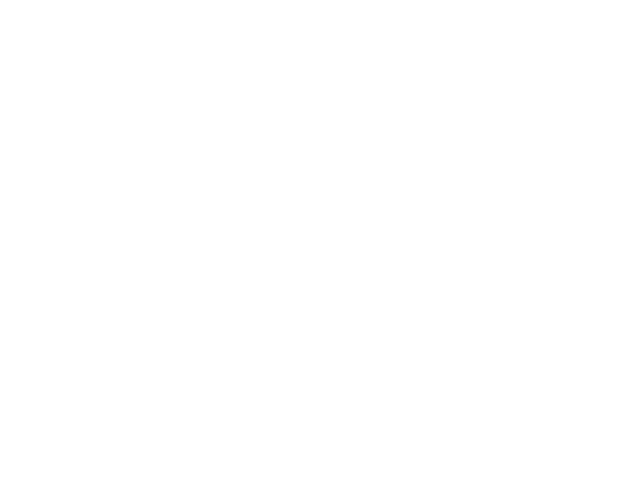

Sensor 35002
Errors:  13  ( 0.0714285714286 )
BIC - raw: 35.8049936833  BIC - clean: -19.5893770686


<IPython.core.display.Javascript object>


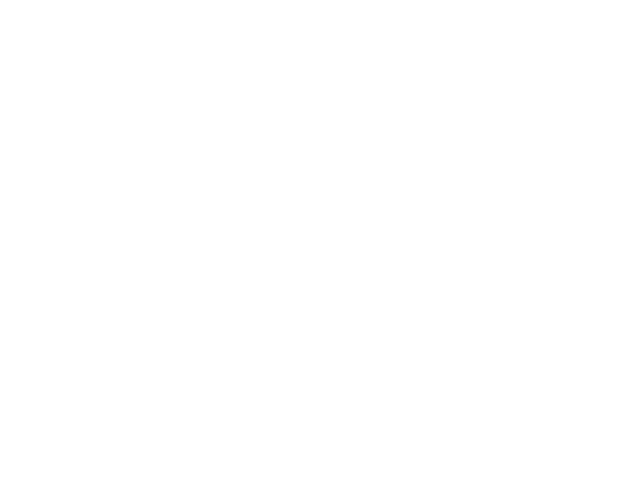

Chosen 85046
Predict is run


<IPython.core.display.Javascript object>


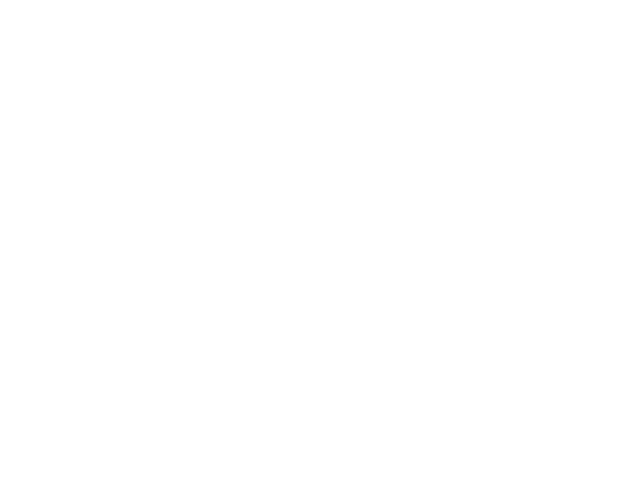

Sensor 85046
Errors:  5  ( 0.0098814229249 )
BIC - raw: -2365.98482384  BIC - clean: -2365.98482384


<IPython.core.display.Javascript object>


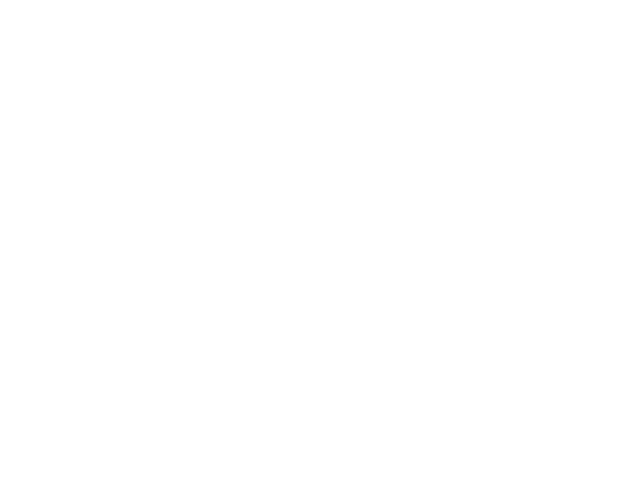

Chosen 35015
Predict is run


<IPython.core.display.Javascript object>


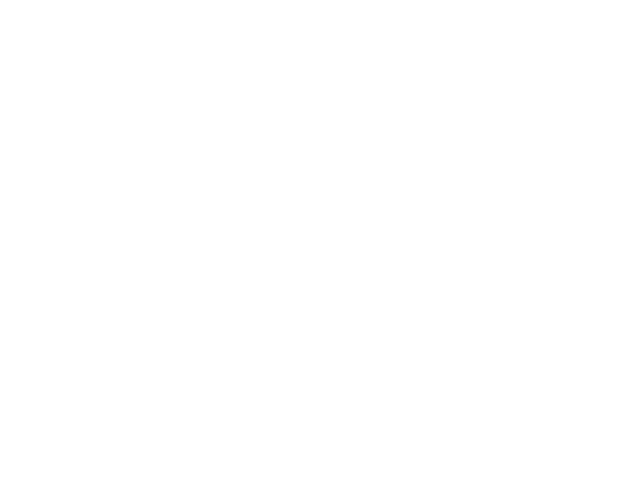

Sensor 35015
Errors:  18  ( 0.0983606557377 )
BIC - raw: 64.4359427106  BIC - clean: 66.4530920464


<IPython.core.display.Javascript object>


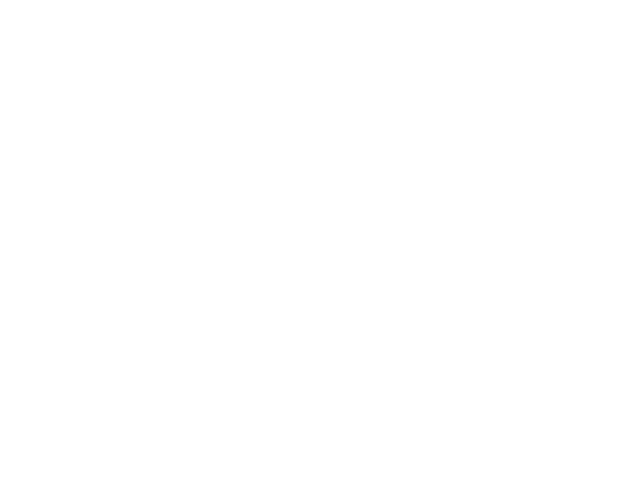

Chosen 65005
Predict is run


<IPython.core.display.Javascript object>


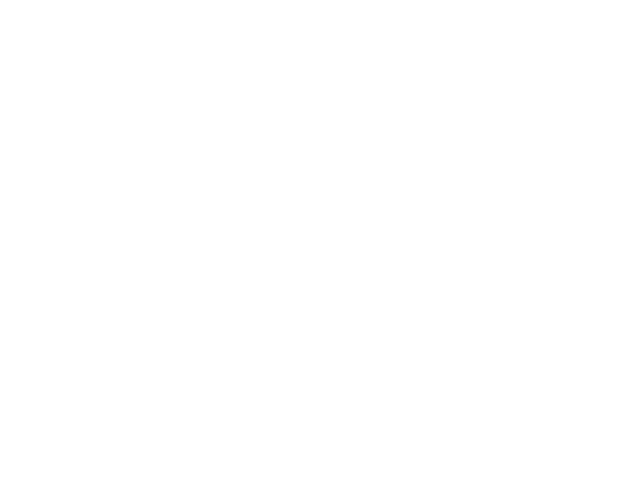

Sensor 65005
Errors:  14  ( 0.00957592339261 )
BIC - raw: -6058.22193232  BIC - clean: -4345.68471428


<IPython.core.display.Javascript object>


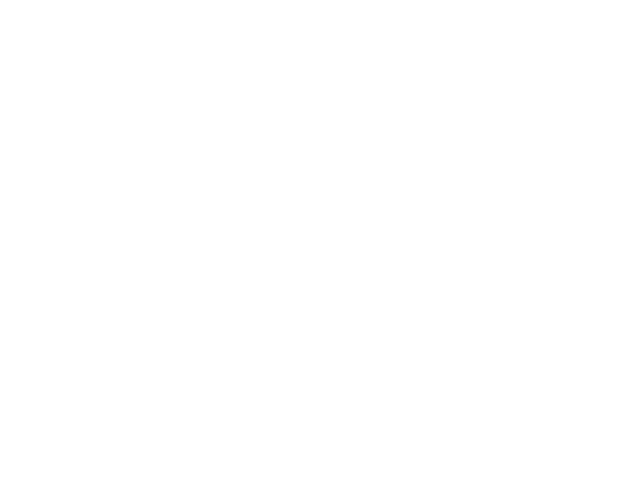

Chosen 55070
Predict is run


<IPython.core.display.Javascript object>


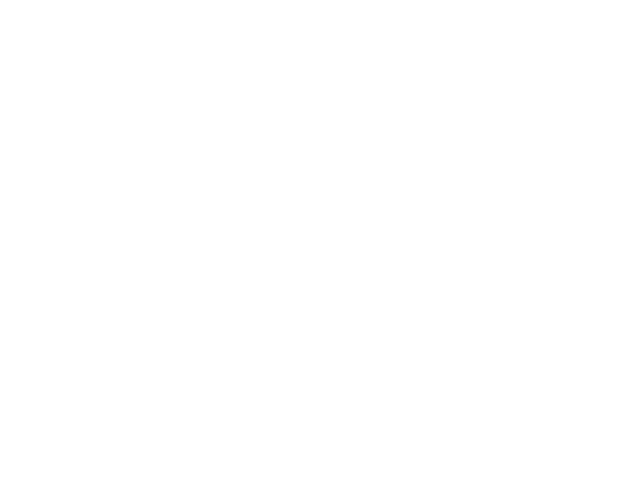

Sensor 55070
Errors:  75  ( 0.260416666667 )
BIC - raw: 336.370938856  BIC - clean: 474.043542376


<IPython.core.display.Javascript object>


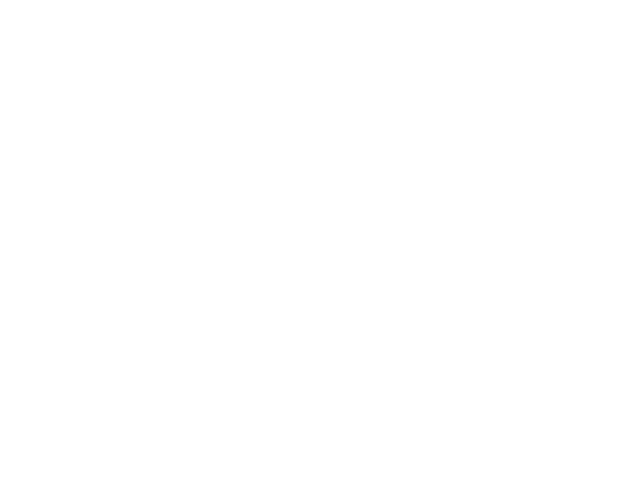

Chosen 15031
Predict is run


<IPython.core.display.Javascript object>


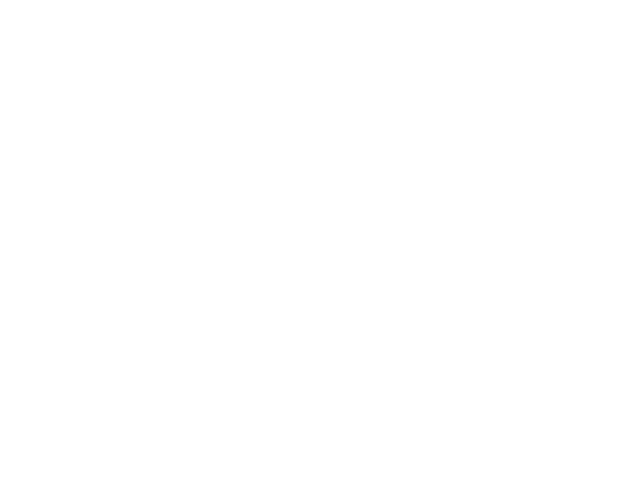

Sensor 15031
Errors:  14  ( 0.291666666667 )
BIC - raw: 492.682490193  BIC - clean: 525.28504918


<IPython.core.display.Javascript object>


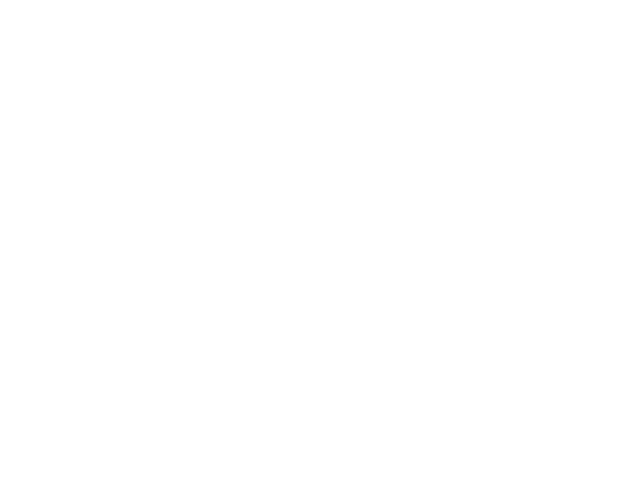

Chosen 80109
Predict is run


<IPython.core.display.Javascript object>


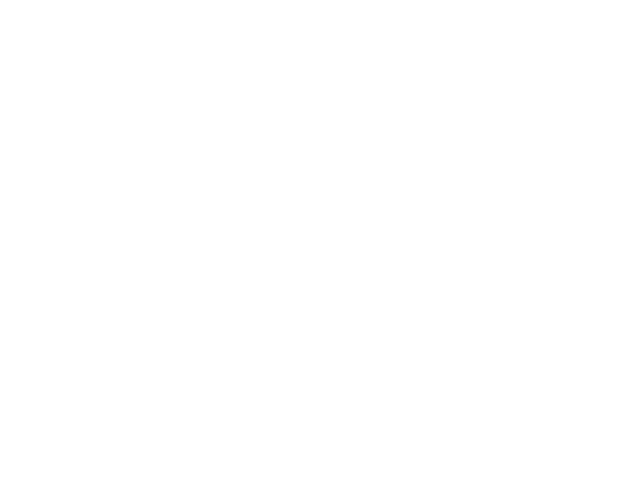

Sensor 80109
Errors:  17  ( 0.107594936709 )
BIC - raw: 346.334075784  BIC - clean: 280.881764302


<IPython.core.display.Javascript object>


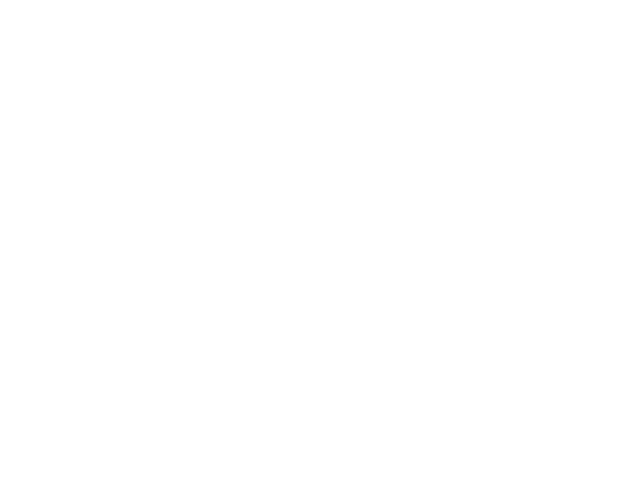

Chosen 20020
Predict is run


<IPython.core.display.Javascript object>


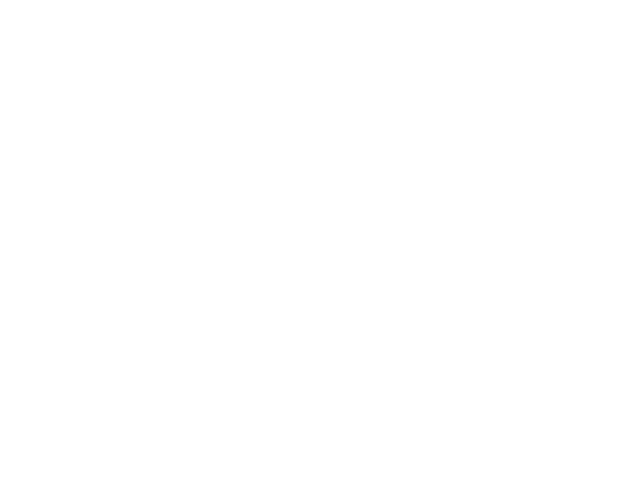

Sensor 20020
Errors:  92  ( 0.00926112341454 )
BIC - raw: -23468.2332669  BIC - clean: -15379.5464846


<IPython.core.display.Javascript object>


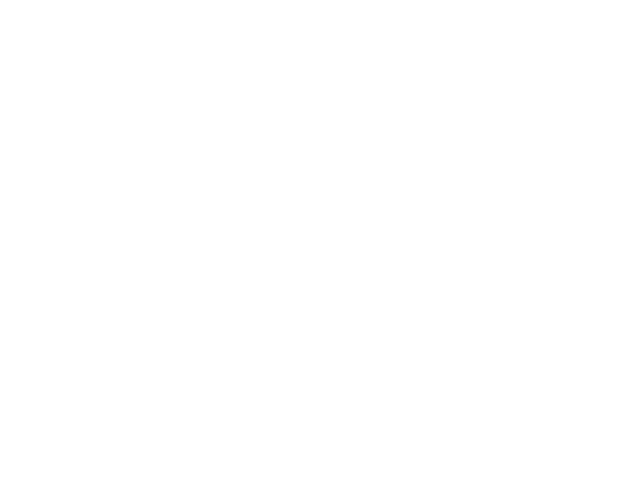

Chosen 85052
Predict is run


<IPython.core.display.Javascript object>


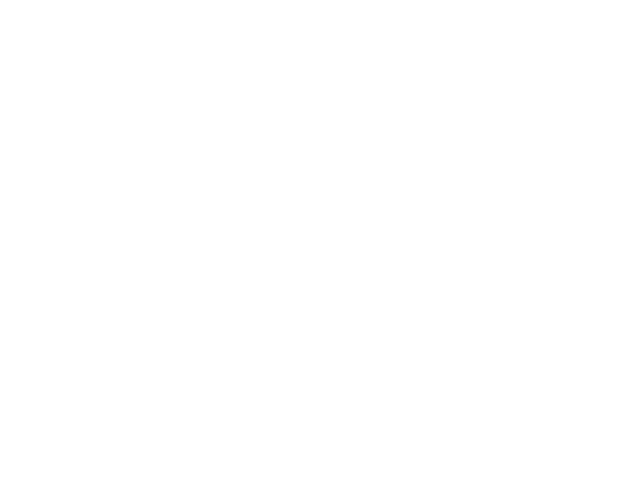

Sensor 85052
Errors:  2  ( 0.00680272108844 )
BIC - raw: 4573.95463633  BIC - clean: 25.477466247


<IPython.core.display.Javascript object>


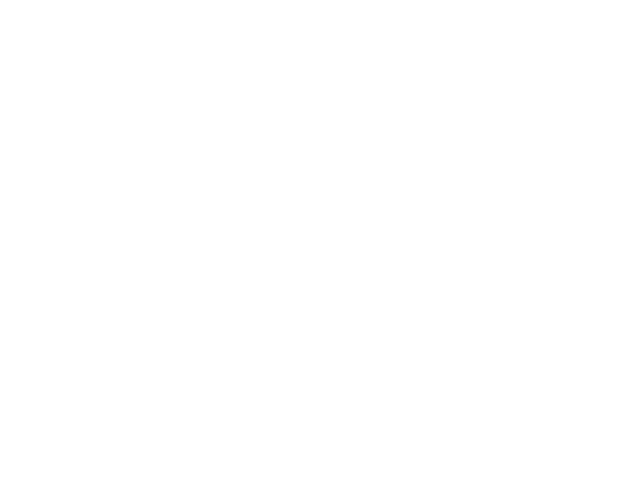

Chosen 85017
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 45030
Predict is run


<IPython.core.display.Javascript object>


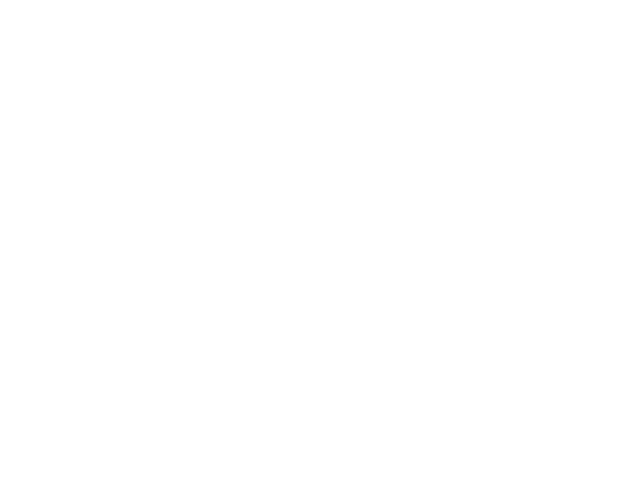

Sensor 45030
Errors:  466  ( 0.04750254842 )
BIC - raw: -18760.5573708  BIC - clean: -6206.23658404


<IPython.core.display.Javascript object>


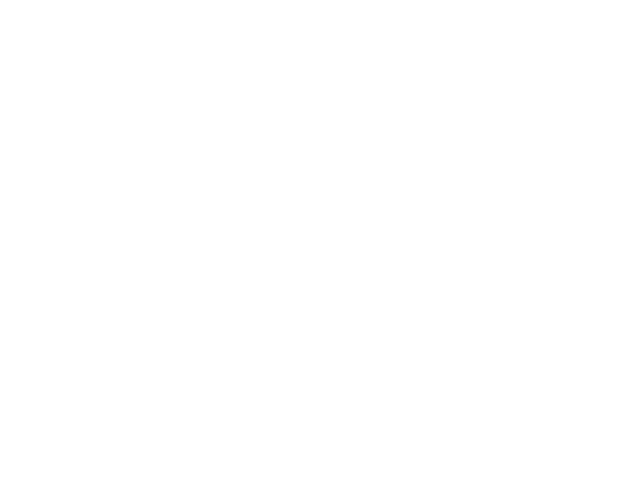

Chosen 40005
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 35027
Predict is run


<IPython.core.display.Javascript object>


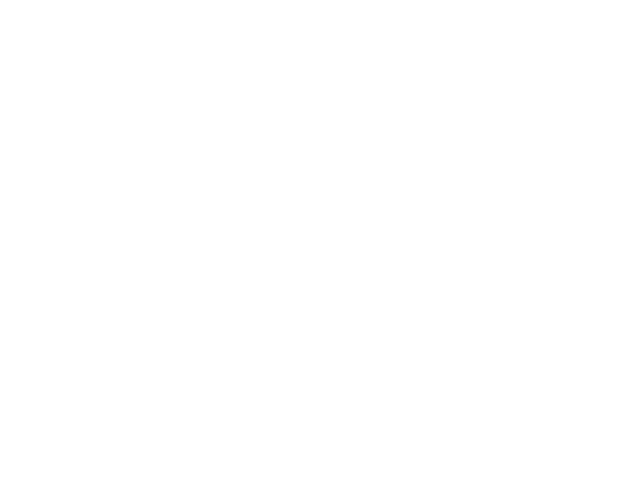

Sensor 35027
Errors:  40  ( 0.218579234973 )
BIC - raw: 230.741354456  BIC - clean: 222.309667705


<IPython.core.display.Javascript object>


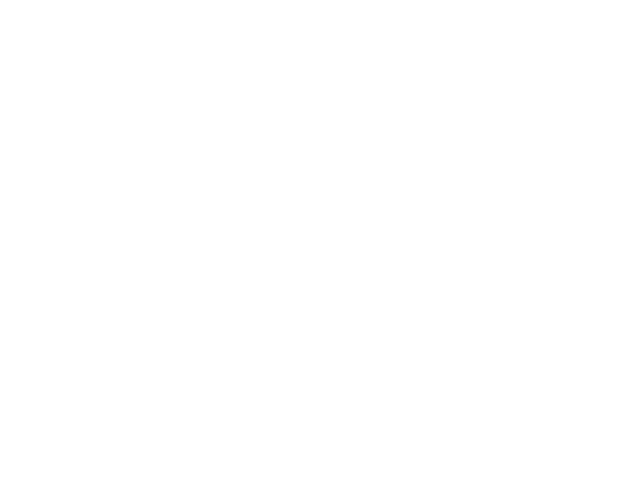

Chosen 40102
Predict is run


<IPython.core.display.Javascript object>


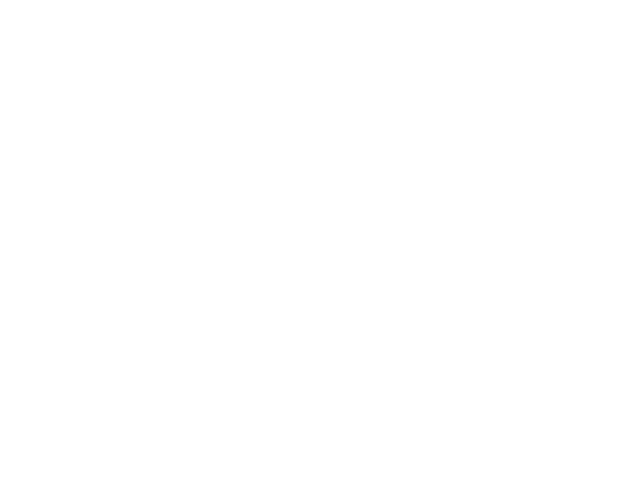

Sensor 40102
Errors:  197  ( 0.261968085106 )
BIC - raw: 312.682614884  BIC - clean: 613.783919047


<IPython.core.display.Javascript object>


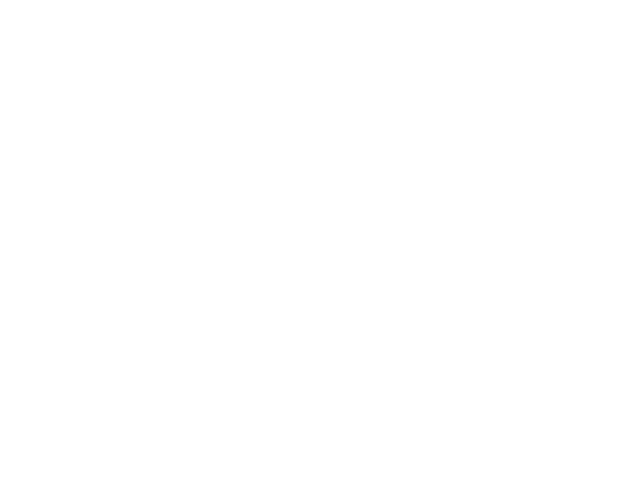

Chosen 40106
Predict is run


<IPython.core.display.Javascript object>


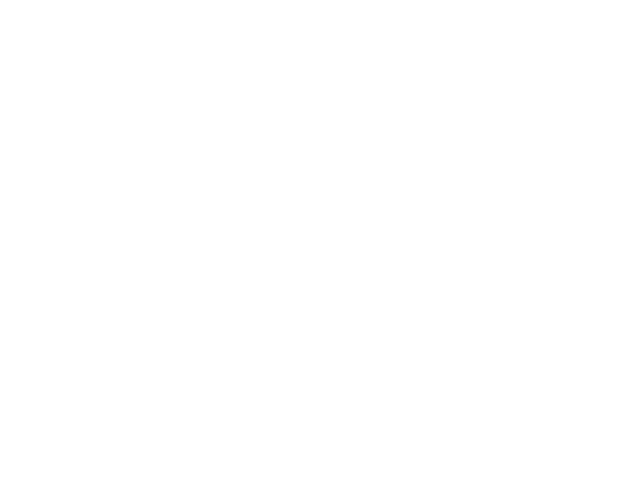

Sensor 40106
Errors:  320  ( 0.164863472437 )
BIC - raw: -1685.86131619  BIC - clean: -872.312229364


<IPython.core.display.Javascript object>


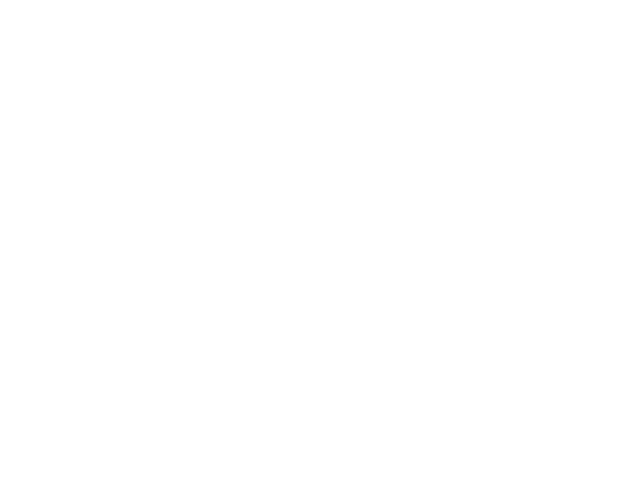

<class 'KeyError'>
('Value',)
Chosen 50102
Predict is run


<IPython.core.display.Javascript object>


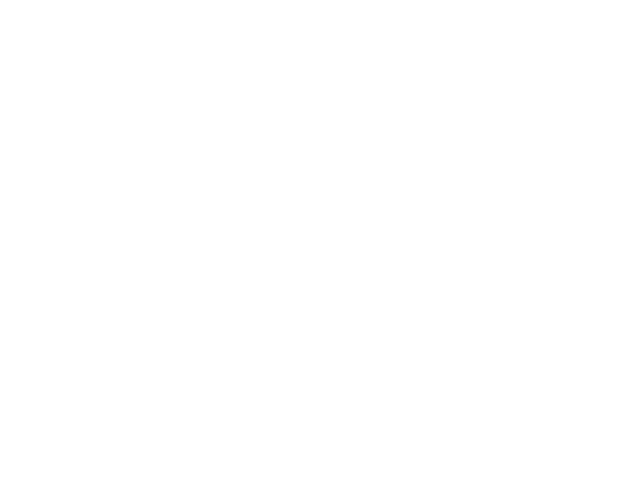

Sensor 50102
Errors:  102  ( 0.1632 )
BIC - raw: -332.482052957  BIC - clean: -254.503614392


<IPython.core.display.Javascript object>


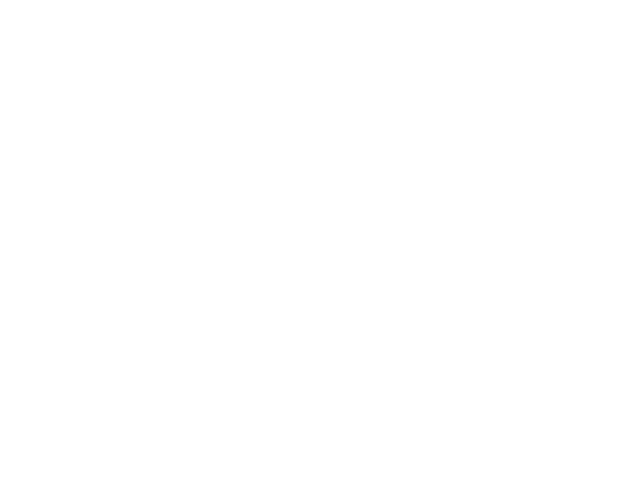

Chosen 95001
Predict is run


<IPython.core.display.Javascript object>


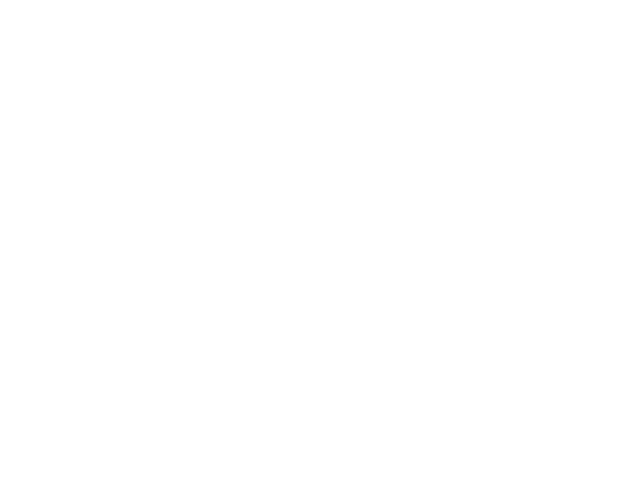

Sensor 95001
Errors:  31  ( 0.407894736842 )
BIC - raw: 154.815564404  BIC - clean: 198.876896507


<IPython.core.display.Javascript object>


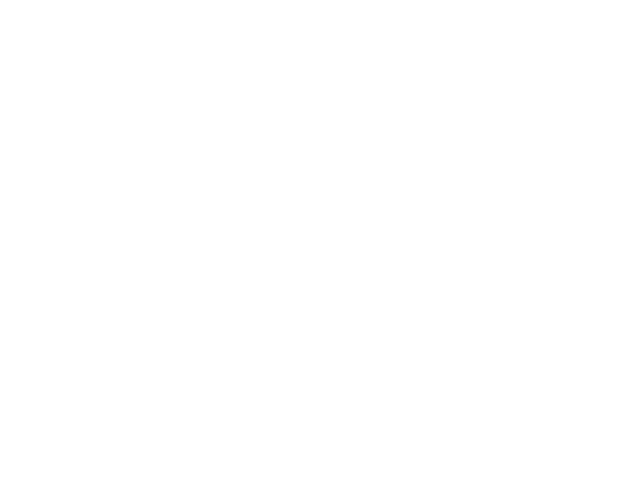

Chosen 50086
Predict is run


<IPython.core.display.Javascript object>


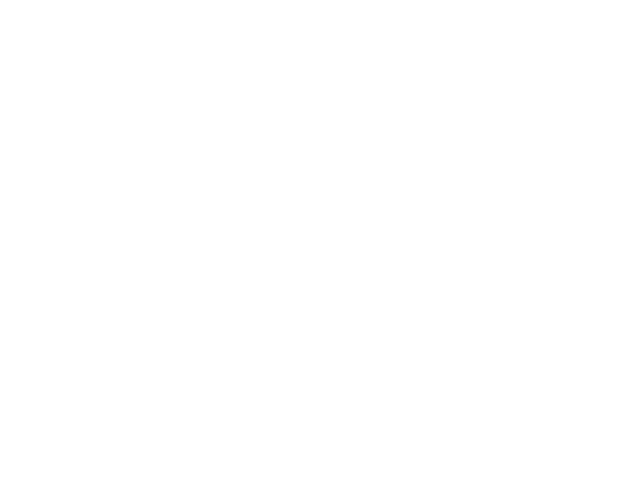

Sensor 50086
Errors:  7  ( 0.0376344086022 )
BIC - raw: -375.133150432  BIC - clean: -346.388024474


<IPython.core.display.Javascript object>


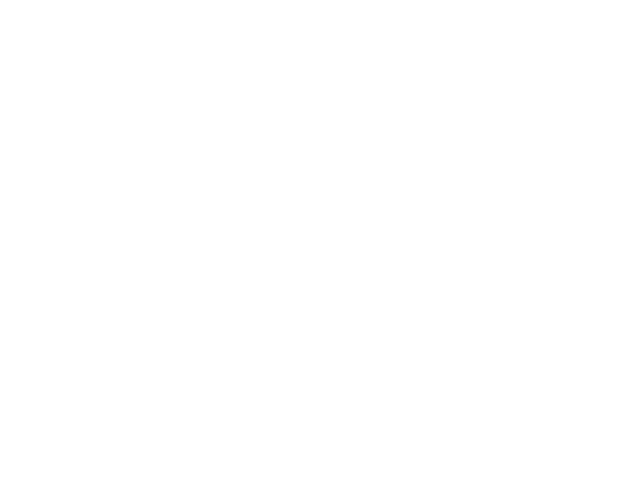

Chosen 40104
Predict is run


<IPython.core.display.Javascript object>


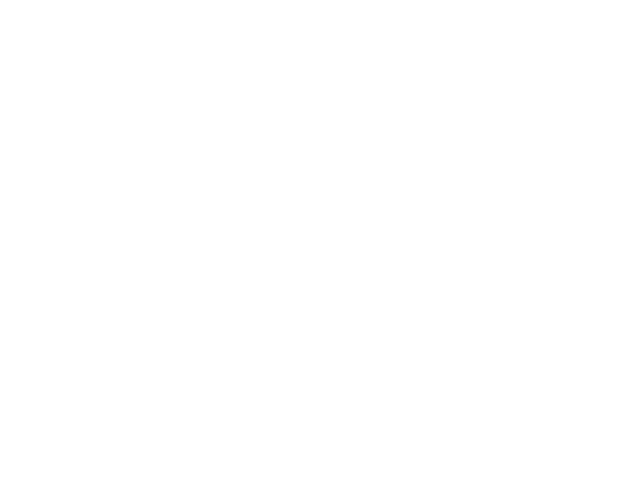

Sensor 40104
Errors:  156  ( 0.231797919762 )
BIC - raw: 102.951957388  BIC - clean: -74.2286202473


<IPython.core.display.Javascript object>


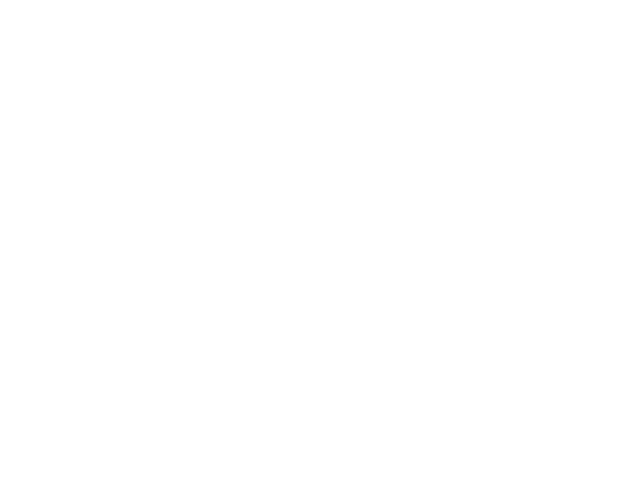

Chosen 90040
Predict is run


<IPython.core.display.Javascript object>


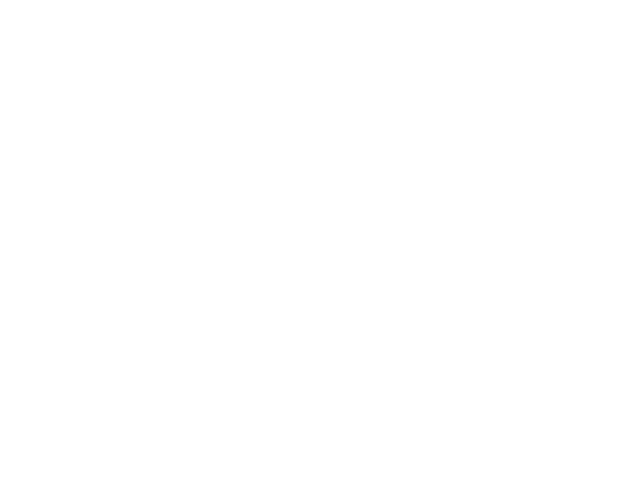

Sensor 90040
Errors:  1249  ( 0.149187768753 )
BIC - raw: -41.2638182717  BIC - clean: 6408.15746535


<IPython.core.display.Javascript object>


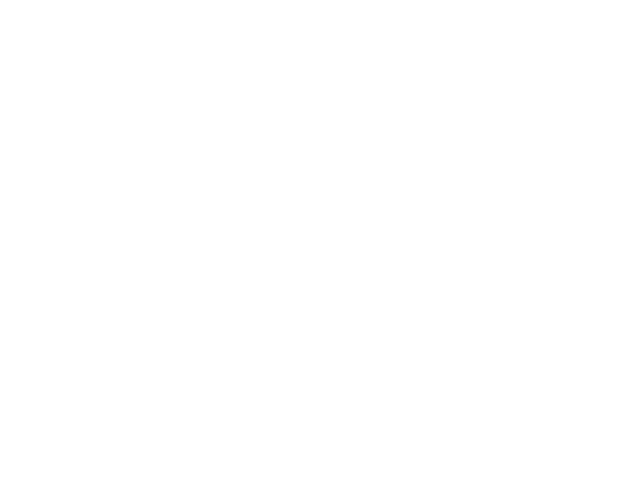

Chosen 35039
Predict is run


<IPython.core.display.Javascript object>


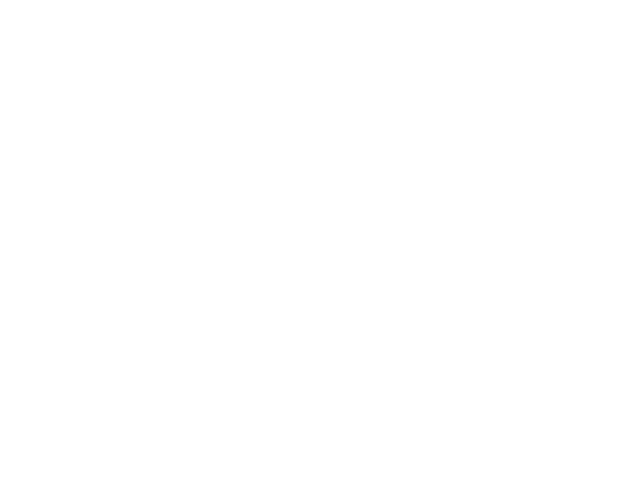

Sensor 35039
Errors:  12  ( 0.0655737704918 )
BIC - raw: -35.0631630281  BIC - clean: -76.5296331529


<IPython.core.display.Javascript object>


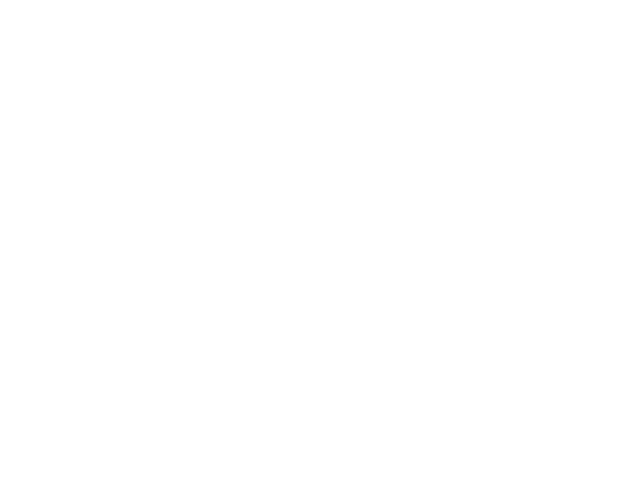

Chosen 90025
Predict is run


<IPython.core.display.Javascript object>


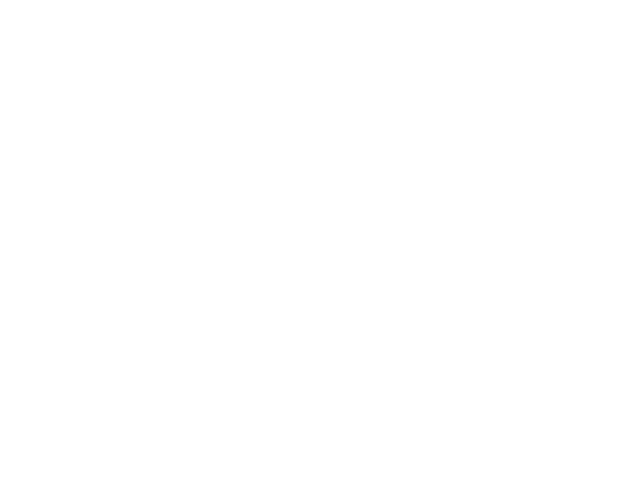

Sensor 90025
Errors:  27  ( 0.1875 )
BIC - raw: 191.351303566  BIC - clean: 228.492615508


<IPython.core.display.Javascript object>


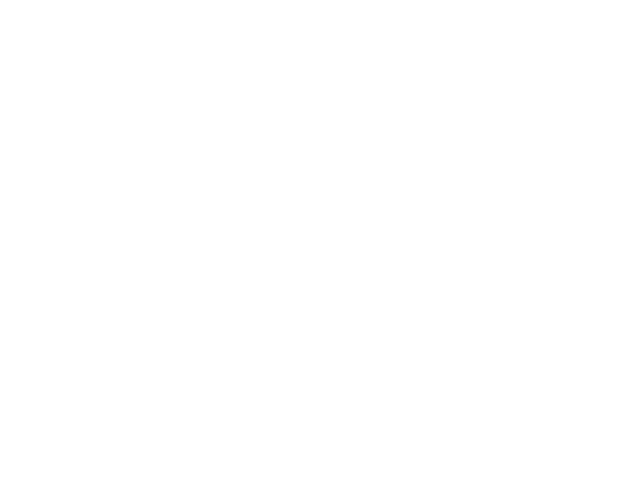

Chosen 40103
Predict is run


<IPython.core.display.Javascript object>


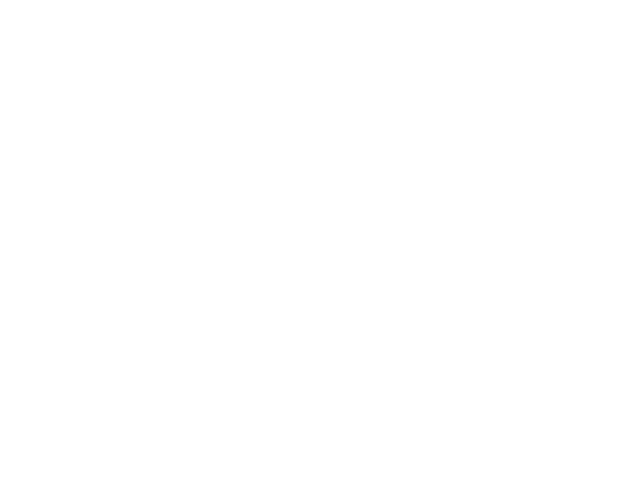

Sensor 40103
Errors:  446  ( 0.248191430161 )
BIC - raw: 564.076323348  BIC - clean: 1685.8177756


<IPython.core.display.Javascript object>


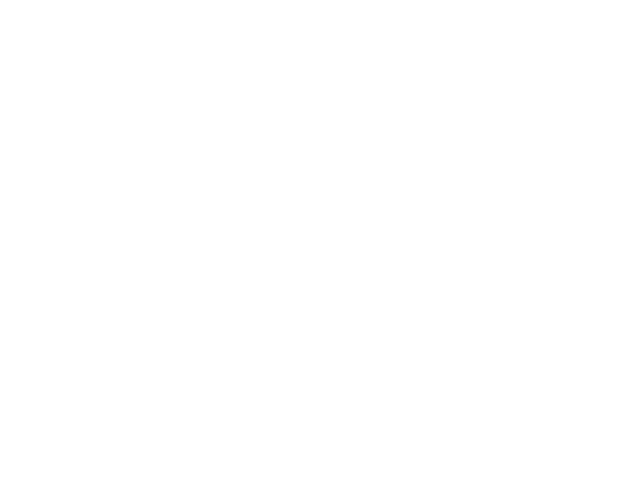

Chosen 96002
Predict is run


<IPython.core.display.Javascript object>


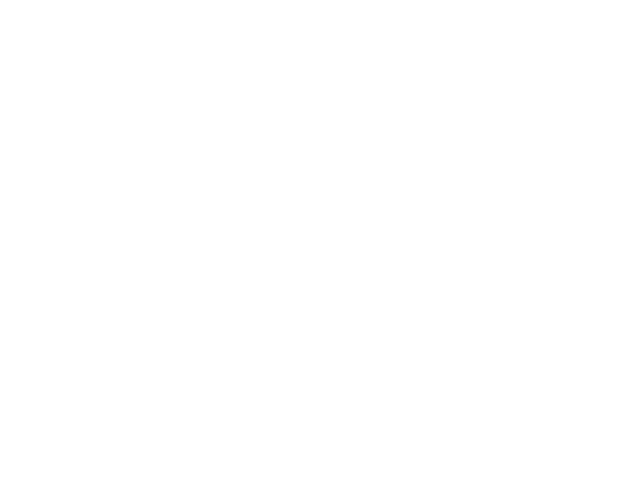

Sensor 96002
Errors:  115  ( 0.157534246575 )
BIC - raw: 25.9718623257  BIC - clean: 1073.00289702


<IPython.core.display.Javascript object>


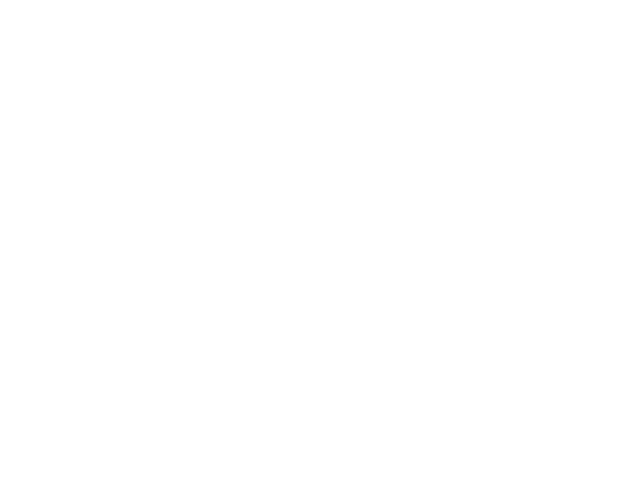

Chosen 30191
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
Chosen 71021
Predict is run


<IPython.core.display.Javascript object>


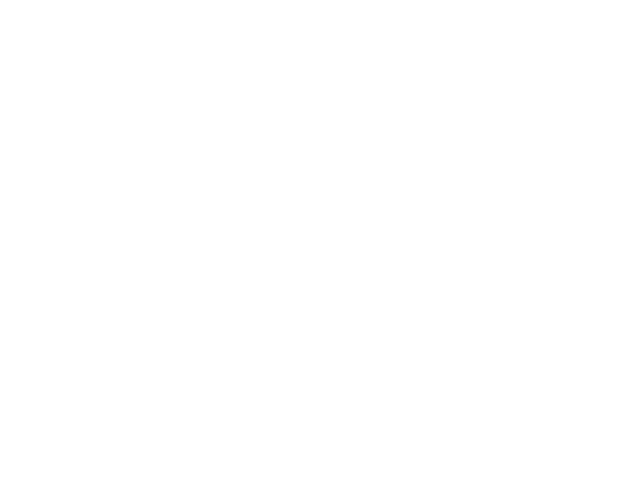

Sensor 71021
Errors:  5  ( 0.00456204379562 )
BIC - raw: -6994.44130743  BIC - clean: -6994.44130743


<IPython.core.display.Javascript object>


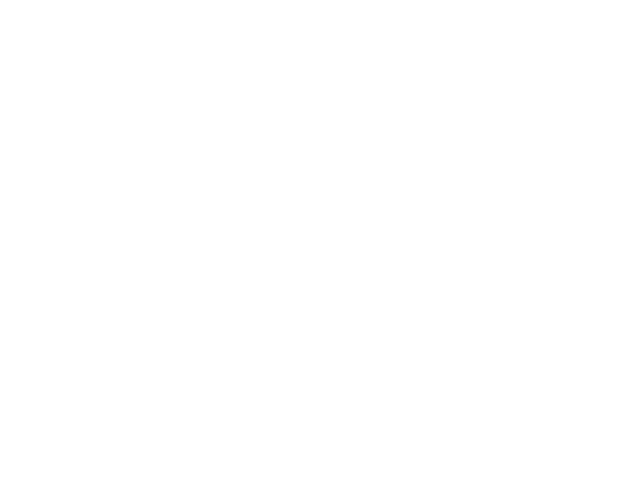

Chosen 10020
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 65015
Predict is run


<IPython.core.display.Javascript object>


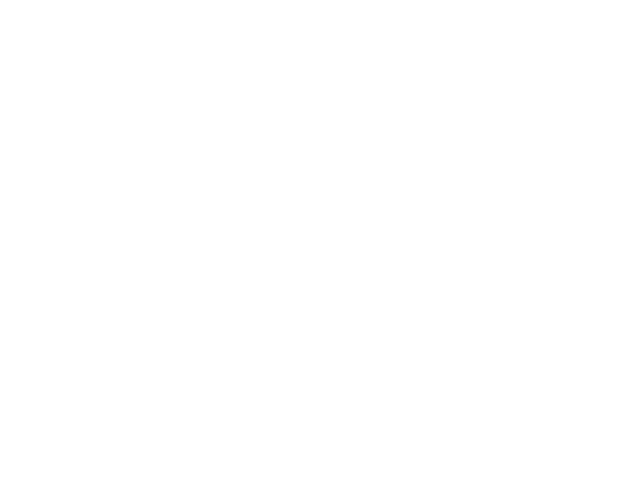

Sensor 65015
Errors:  762  ( 0.0382914572864 )
BIC - raw: -21152.3236073  BIC - clean: -3228.3433614


<IPython.core.display.Javascript object>


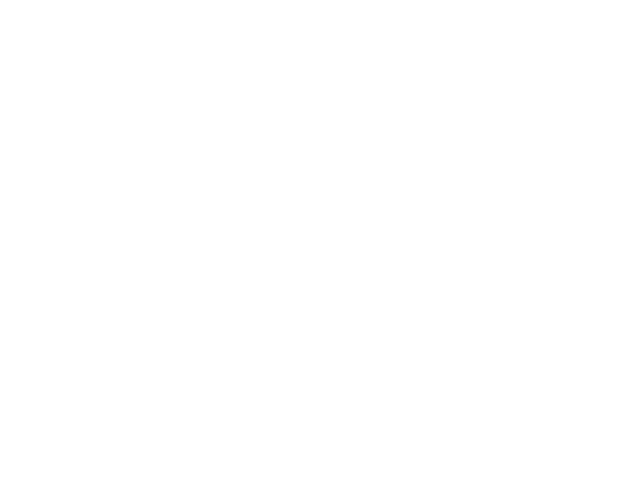

Chosen 85005
Predict is run


<IPython.core.display.Javascript object>


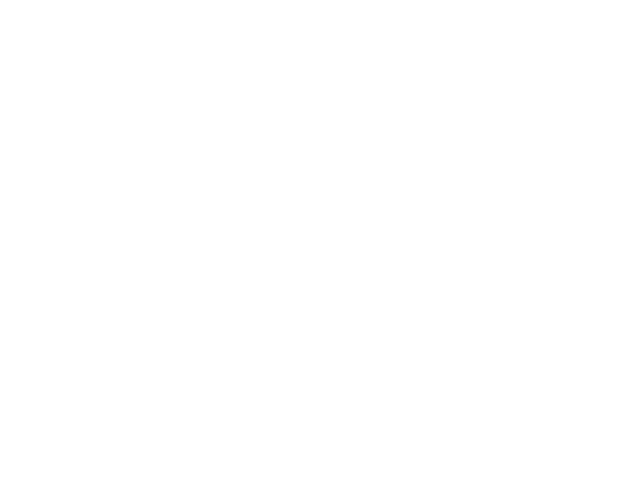

Sensor 85005
Errors:  505  ( 0.0454300107953 )
BIC - raw: -18161.859933  BIC - clean: -9243.93071551


<IPython.core.display.Javascript object>


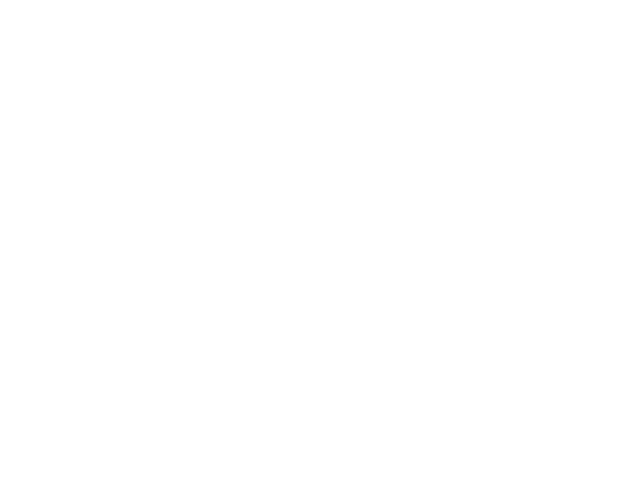

Chosen 85075
<class 'TypeError'>
("Cannot cast ufunc subtract output from dtype('float64') to dtype('int64') with casting rule 'same_kind'",)
Chosen 10022
Predict is run


<IPython.core.display.Javascript object>


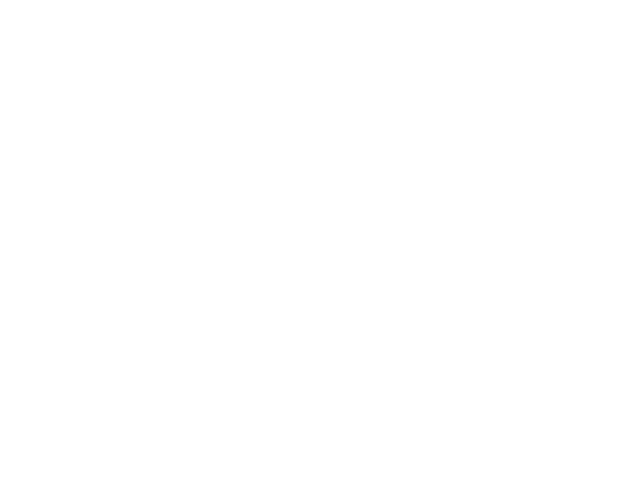

Sensor 10022
Errors:  8  ( 0.00475341651812 )
BIC - raw: -9534.244676  BIC - clean: -8966.19553148


<IPython.core.display.Javascript object>


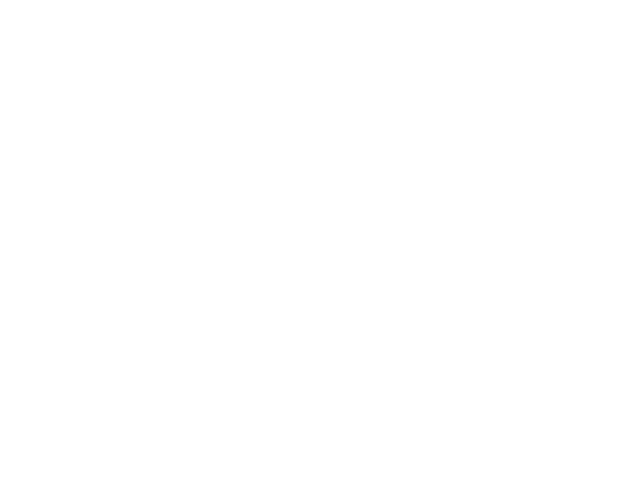

Chosen 50085
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 20037
Predict is run


<IPython.core.display.Javascript object>


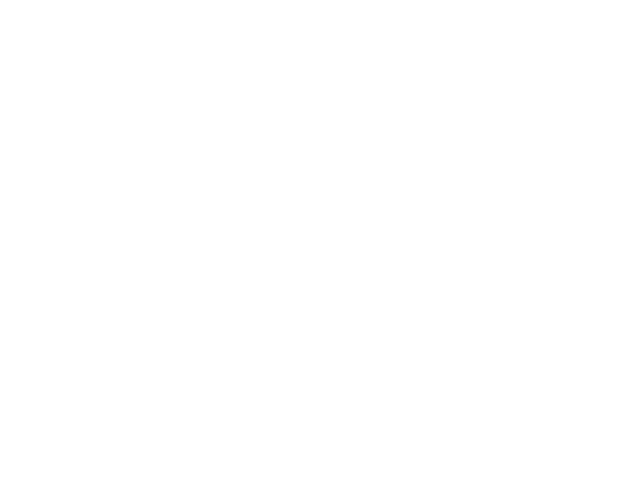

Sensor 20037
Errors:  4  ( 0.0294117647059 )
BIC - raw: -254.291498901  BIC - clean: -254.291498901


<IPython.core.display.Javascript object>


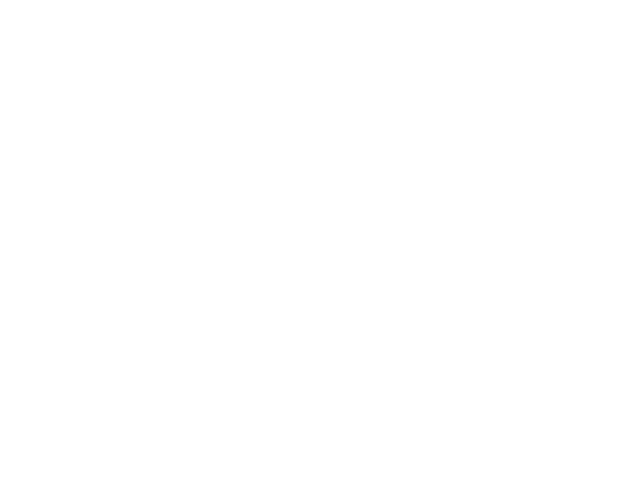

Chosen 65036
Predict is run


<IPython.core.display.Javascript object>


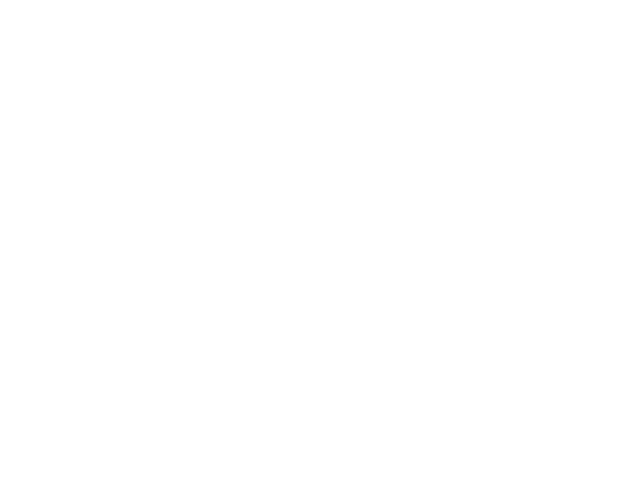

Sensor 65036
Errors:  10  ( 0.00683994528044 )
BIC - raw: -2673.05791079  BIC - clean: -2121.27212838


<IPython.core.display.Javascript object>


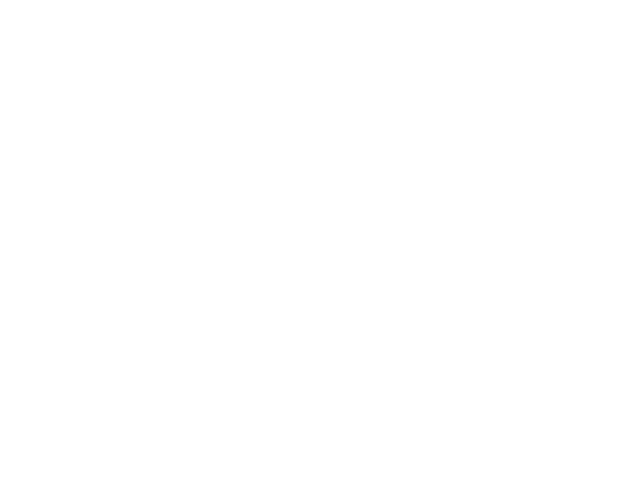

Chosen 70010
Predict is run


<IPython.core.display.Javascript object>


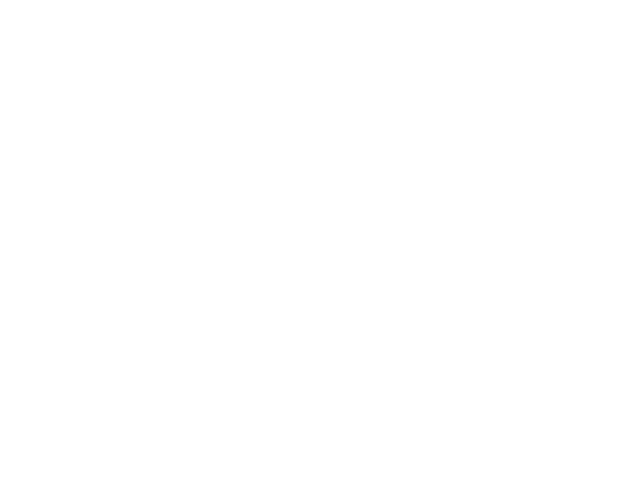

Sensor 70010
Errors:  2532  ( 0.158557204584 )
BIC - raw: 1520.09608549  BIC - clean: 22527.3330392


<IPython.core.display.Javascript object>


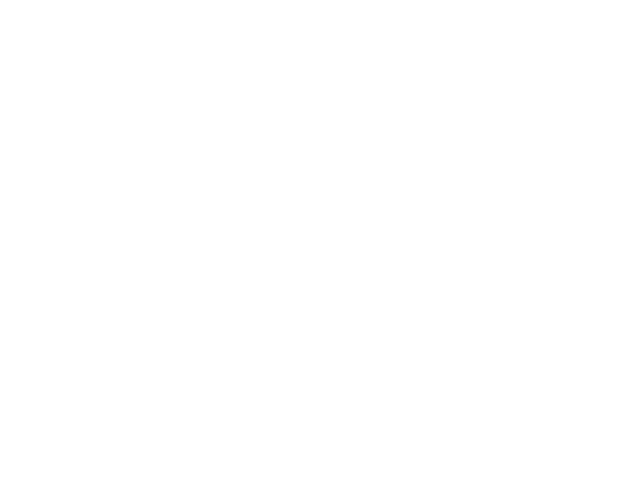

Chosen 20097
Predict is run


<IPython.core.display.Javascript object>


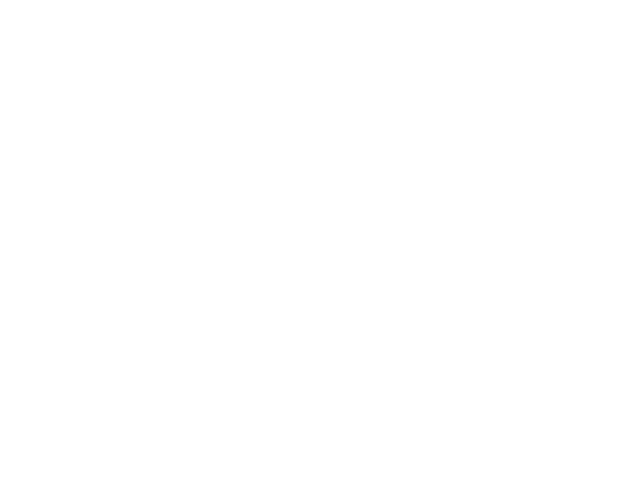

Sensor 20097
Errors:  5  ( 0.00741839762611 )
BIC - raw: -4178.85515887  BIC - clean: -4178.85515887


<IPython.core.display.Javascript object>


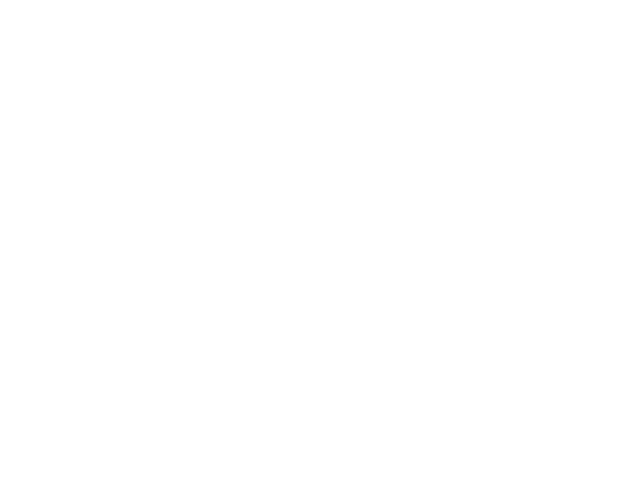

Chosen 85050
Predict is run


<IPython.core.display.Javascript object>


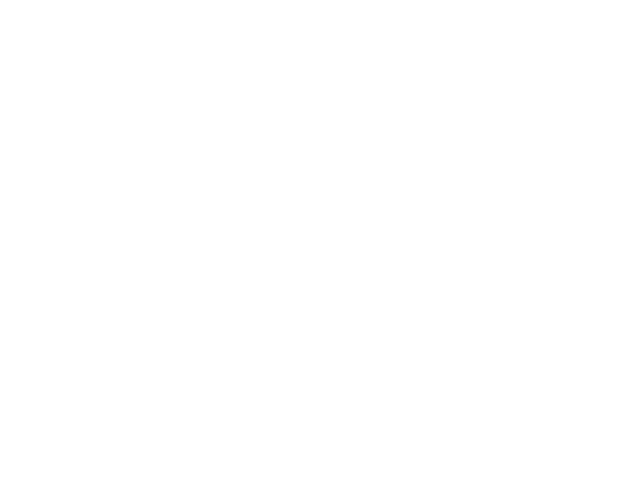

Sensor 85050
Errors:  152  ( 0.0189148830264 )
BIC - raw: -25452.5834899  BIC - clean: -15864.2495345


<IPython.core.display.Javascript object>


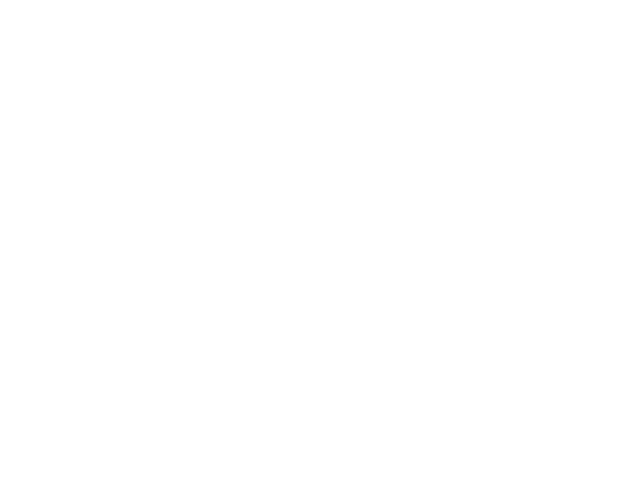

Chosen 10001
Predict is run


<IPython.core.display.Javascript object>


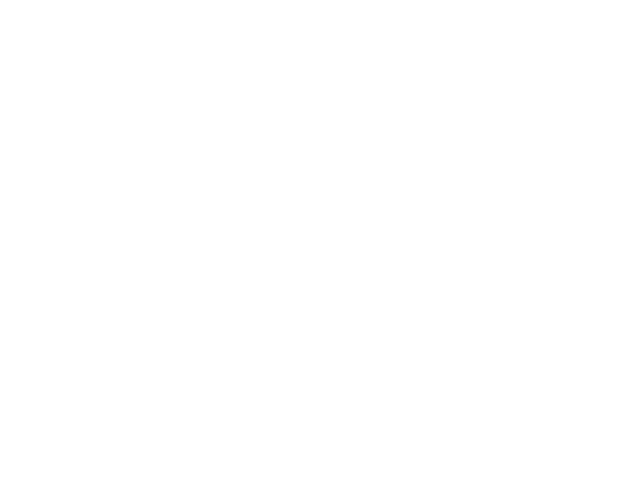

Sensor 10001
Errors:  43  ( 0.0398517145505 )
BIC - raw: 17420.1954804  BIC - clean: 16347.2281801


<IPython.core.display.Javascript object>


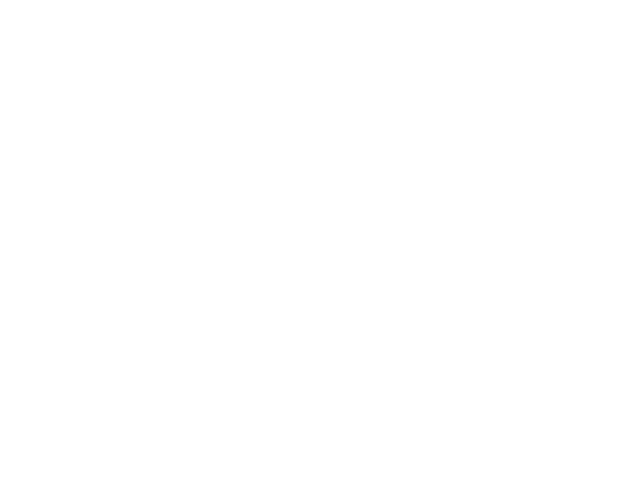

Chosen 90027
Predict is run


<IPython.core.display.Javascript object>


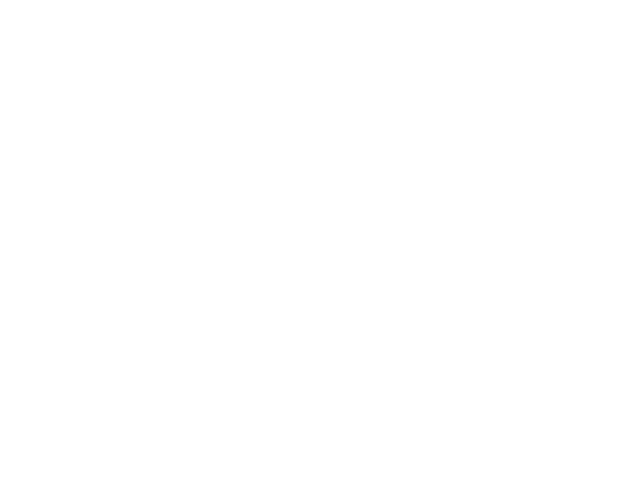

Sensor 90027
Errors:  6  ( 0.0416666666667 )
BIC - raw: -106.343209458  BIC - clean: -97.0013212799


<IPython.core.display.Javascript object>


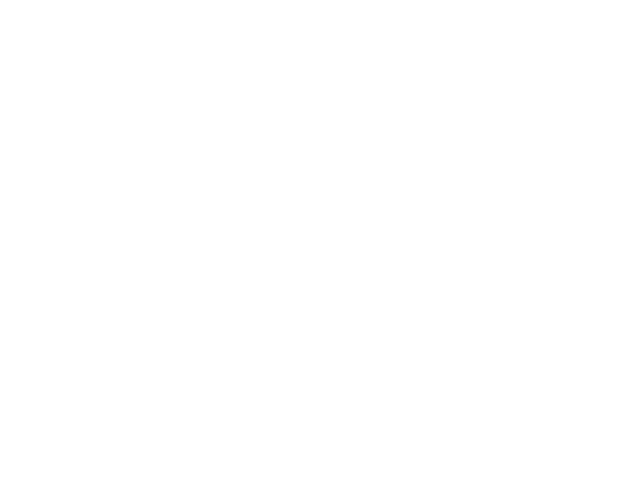

<class 'KeyError'>
('Value',)
Chosen 40015
Predict is run


<IPython.core.display.Javascript object>


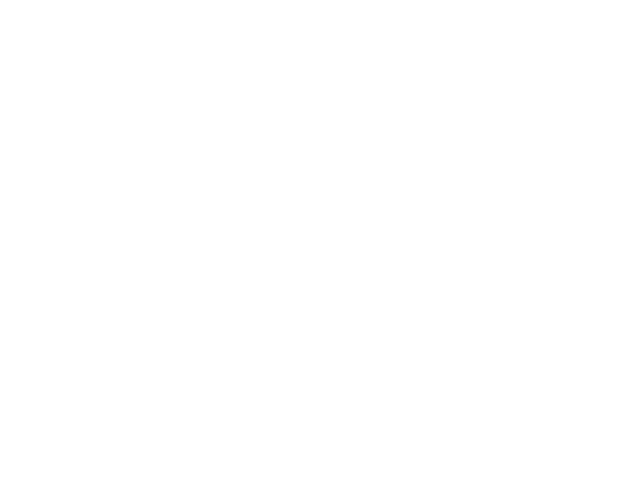

Sensor 40015
Errors:  150  ( 0.0202647932991 )
BIC - raw: -23747.4835627  BIC - clean: -20200.0133265


<IPython.core.display.Javascript object>


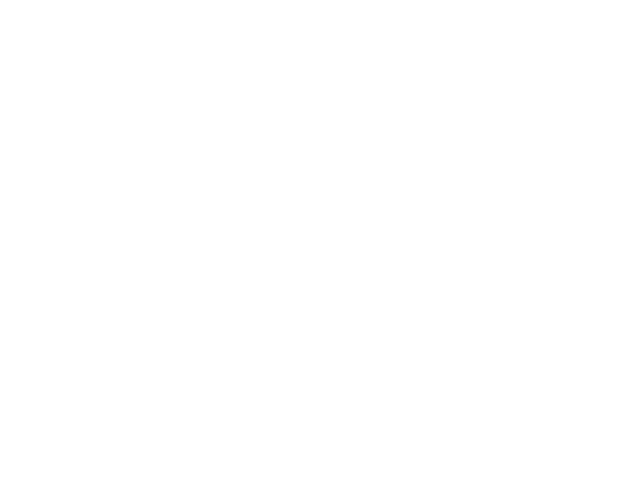

Chosen 10021
Predict is run


<IPython.core.display.Javascript object>


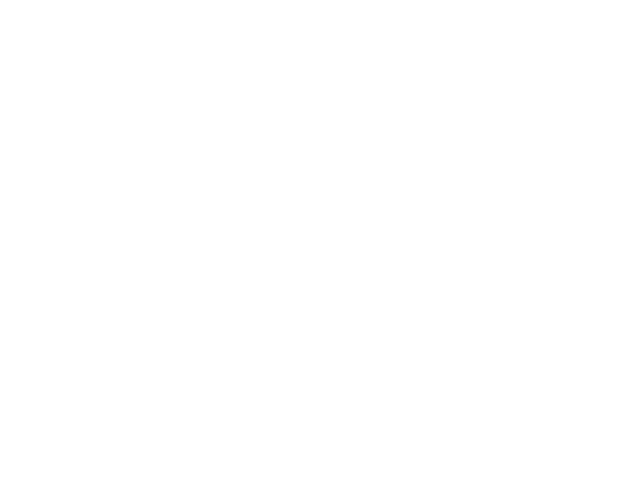

Sensor 10021
Errors:  3  ( 0.0666666666667 )
BIC - raw: -64.3081876345  BIC - clean: -64.3081876345


<IPython.core.display.Javascript object>


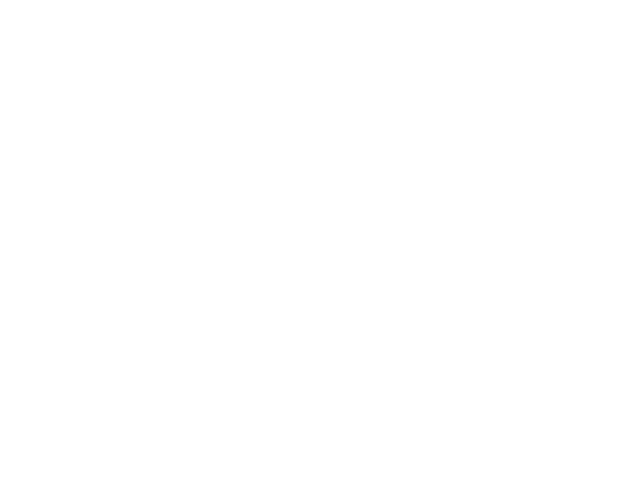

Chosen 65102
Predict is run


<IPython.core.display.Javascript object>


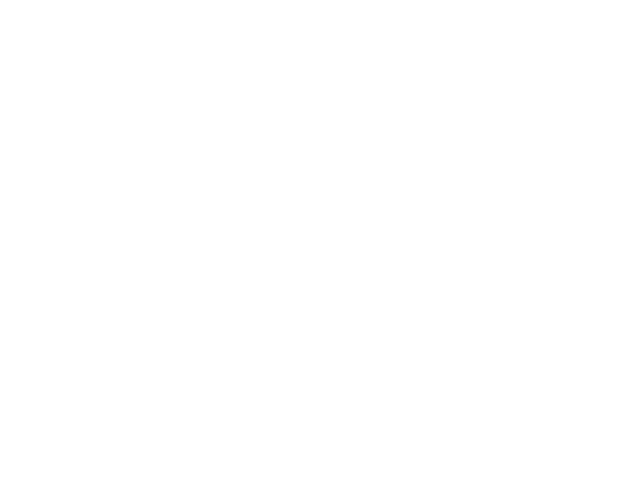

Sensor 65102
Errors:  90  ( 0.274390243902 )
BIC - raw: 1450.5663888  BIC - clean: 1488.38047498


<IPython.core.display.Javascript object>


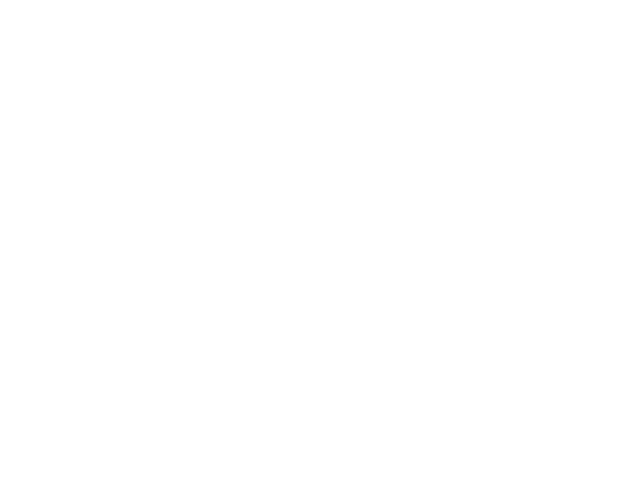

Chosen 30181
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 10115
Predict is run


<IPython.core.display.Javascript object>


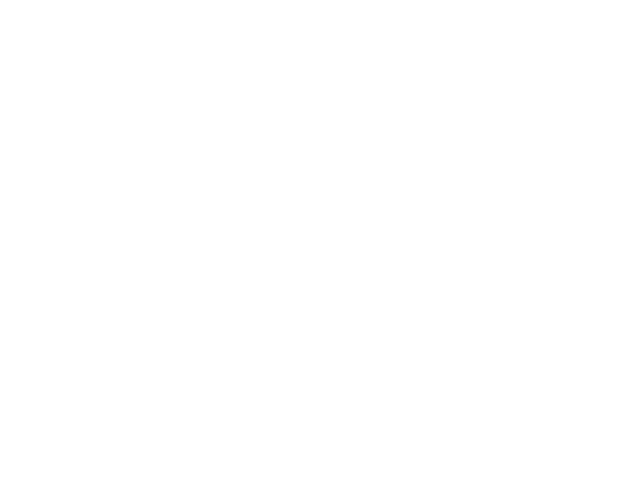

Sensor 10115
Errors:  15  ( 0.0643776824034 )
BIC - raw: -228.655754783  BIC - clean: -226.453017677


<IPython.core.display.Javascript object>


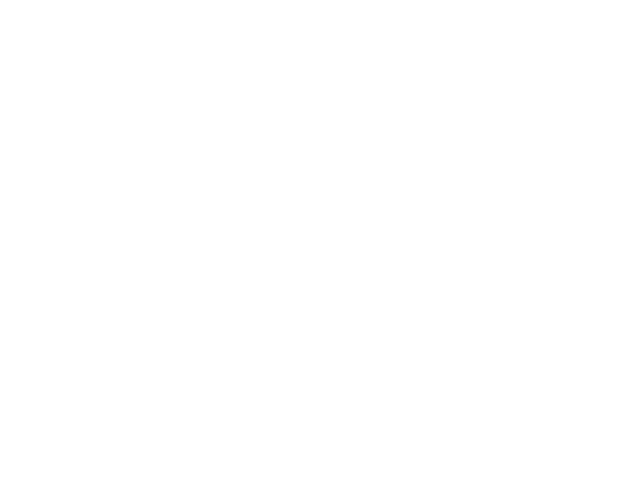

Chosen 80104
Predict is run


<IPython.core.display.Javascript object>


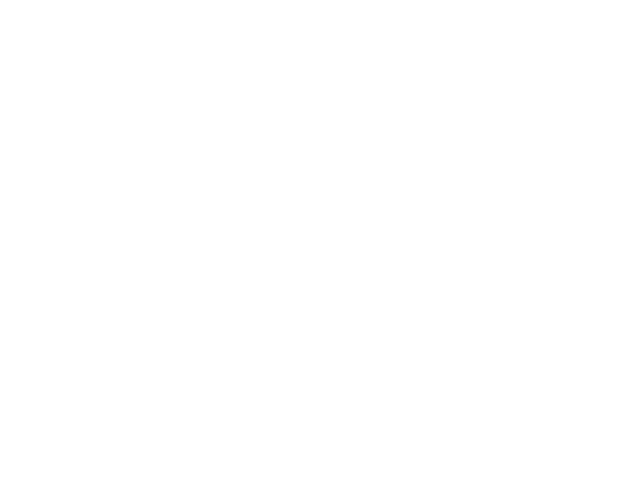

Sensor 80104
Errors:  5  ( 0.0892857142857 )
BIC - raw: 42.7628833094  BIC - clean: 34.7375263947


<IPython.core.display.Javascript object>


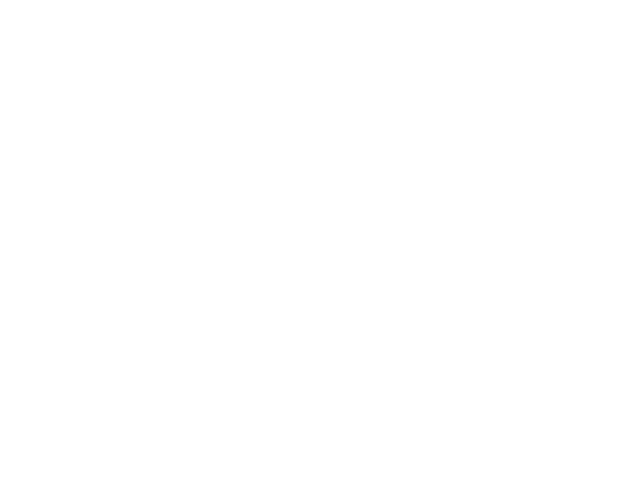

Chosen 90020
Predict is run


<IPython.core.display.Javascript object>


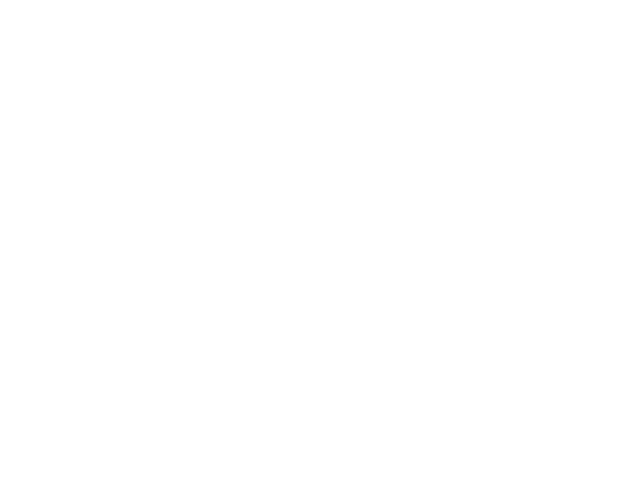

Sensor 90020
Errors:  5  ( 0.0347222222222 )
BIC - raw: -77.8072125945  BIC - clean: -77.8072125945


<IPython.core.display.Javascript object>


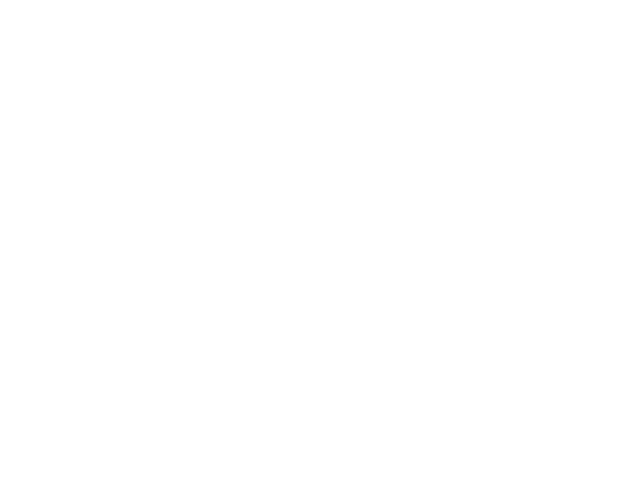

Chosen 10113
Predict is run


<IPython.core.display.Javascript object>


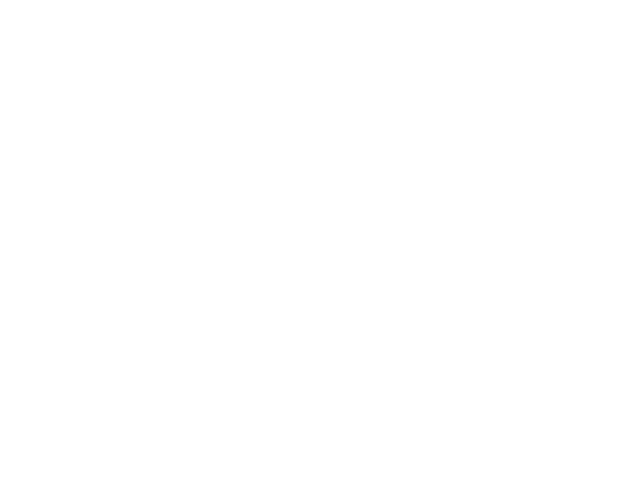

Sensor 10113
Errors:  11  ( 0.047619047619 )
BIC - raw: -248.751225029  BIC - clean: -214.274405772


<IPython.core.display.Javascript object>


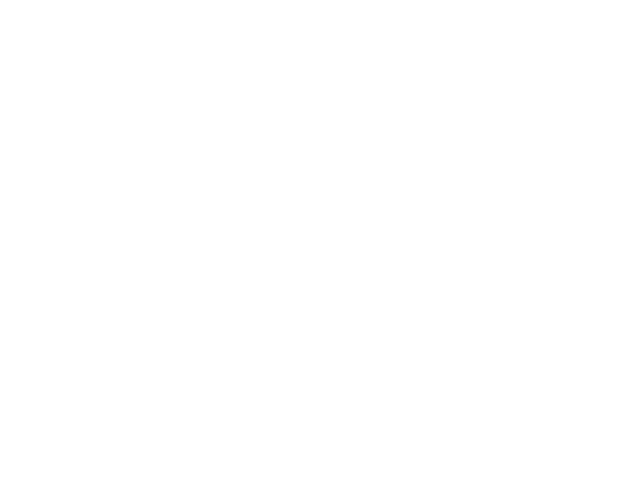

Chosen 65052
Predict is run


<IPython.core.display.Javascript object>


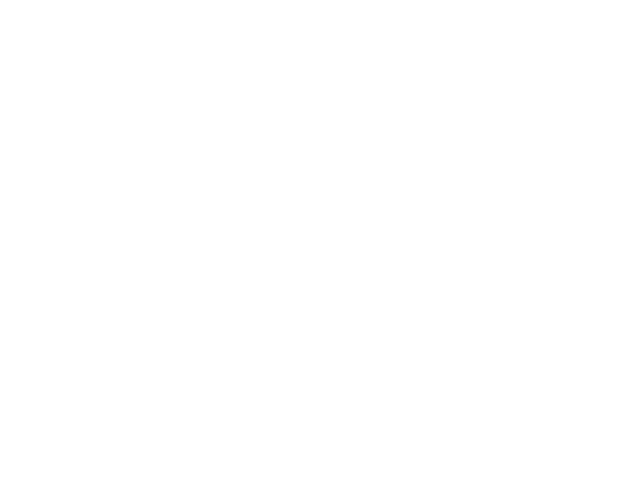

Sensor 65052
Errors:  5  ( 0.00683994528044 )
BIC - raw: -3422.15725857  BIC - clean: -3422.15725857


<IPython.core.display.Javascript object>


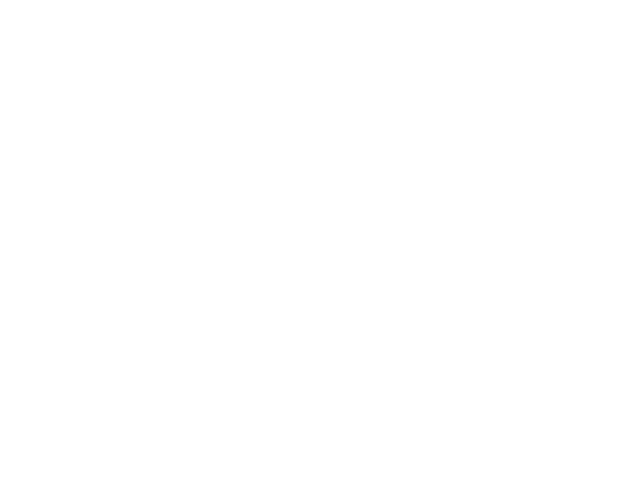

Chosen 65050
Predict is run


<IPython.core.display.Javascript object>


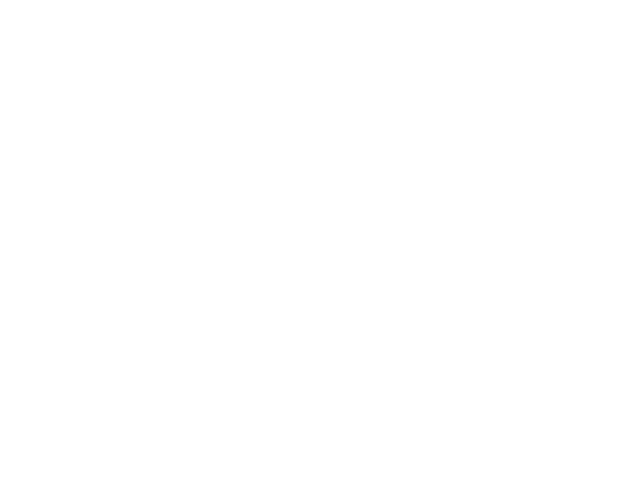

Sensor 65050
Errors:  12  ( 0.00908402725208 )
BIC - raw: 20060.353876  BIC - clean: 2658.8088542


<IPython.core.display.Javascript object>


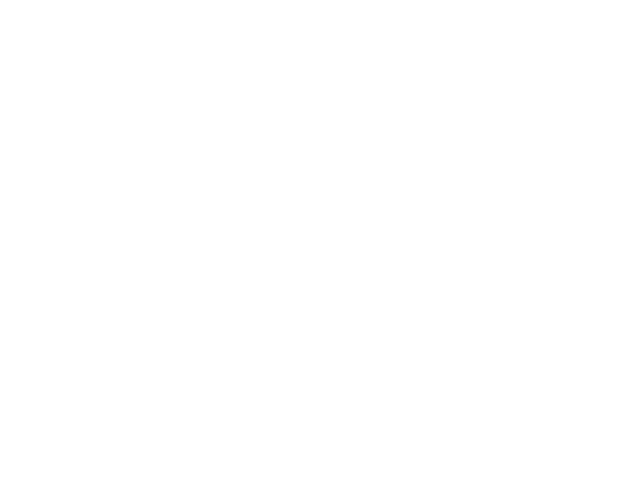

Chosen 10112
Predict is run


<IPython.core.display.Javascript object>


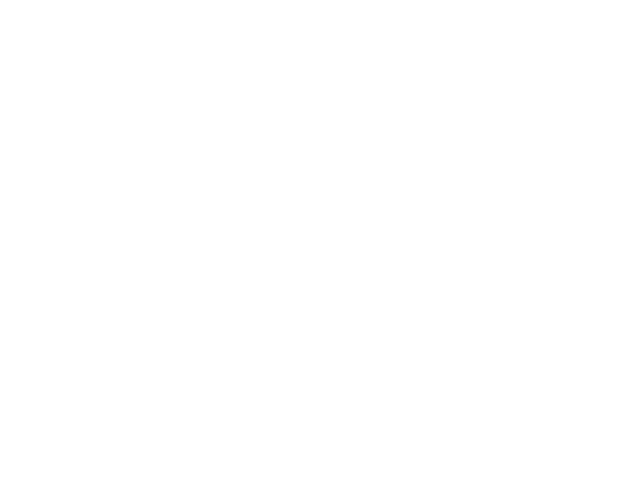

Sensor 10112
Errors:  16  ( 0.068669527897 )
BIC - raw: -204.76387563  BIC - clean: -149.273483662


<IPython.core.display.Javascript object>


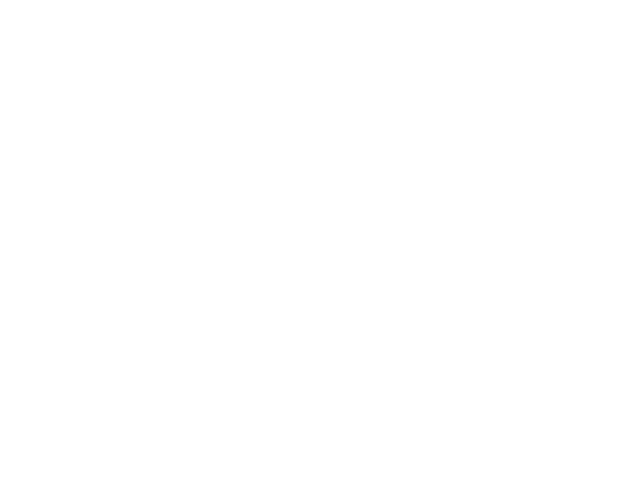

Chosen 30172
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 50061
Predict is run


<IPython.core.display.Javascript object>


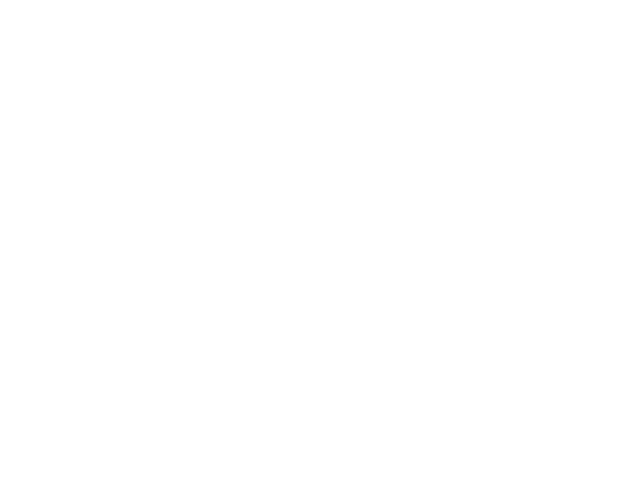

Sensor 50061
Errors:  43  ( 0.00313639679066 )
BIC - raw: -68108.3856992  BIC - clean: -63639.503625


<IPython.core.display.Javascript object>


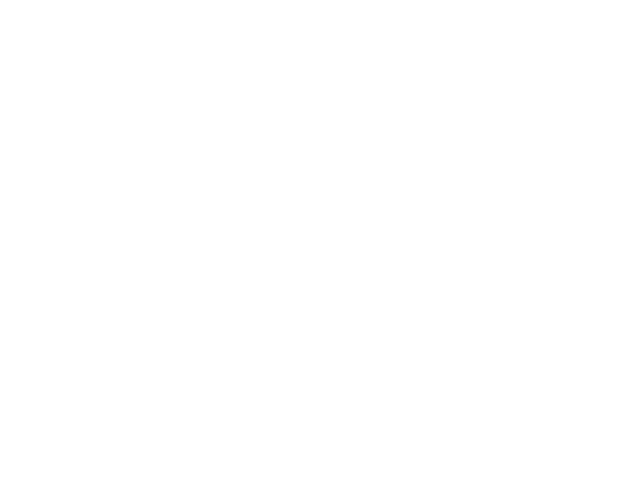

Chosen 50010
<class 'numpy.linalg.linalg.LinAlgError'>
('Singular matrix',)
Chosen 65047
Predict is run


<IPython.core.display.Javascript object>


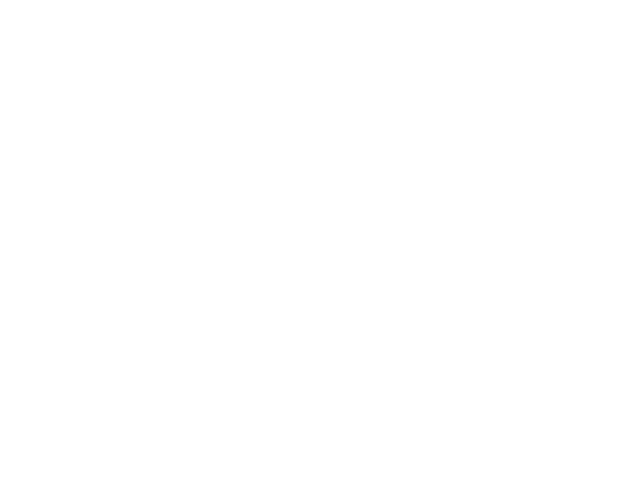

Sensor 65047
Errors:  6  ( 0.08 )
BIC - raw: 59.5985680392  BIC - clean: 41.7568159087


<IPython.core.display.Javascript object>


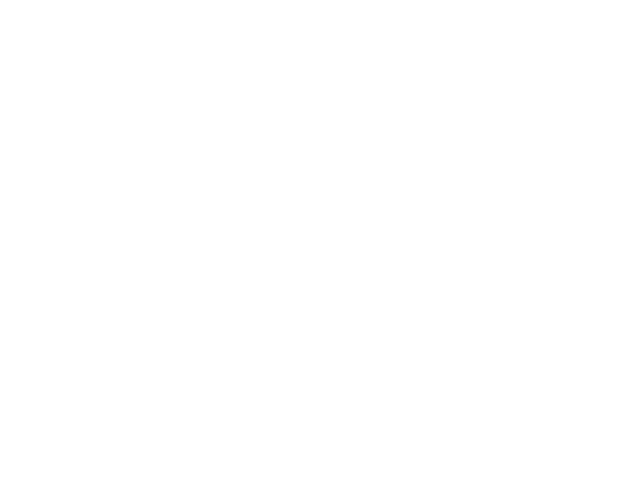

Chosen 60070
Predict is run


<IPython.core.display.Javascript object>


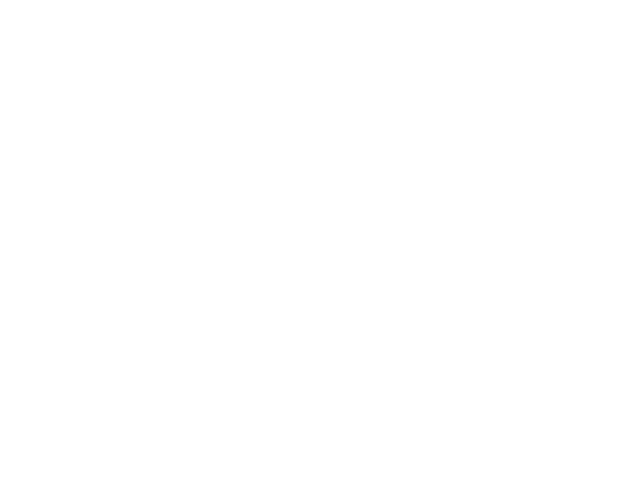

Sensor 60070
Errors:  36  ( 0.142857142857 )
BIC - raw: 29.3463010763  BIC - clean: 105.811579096


<IPython.core.display.Javascript object>


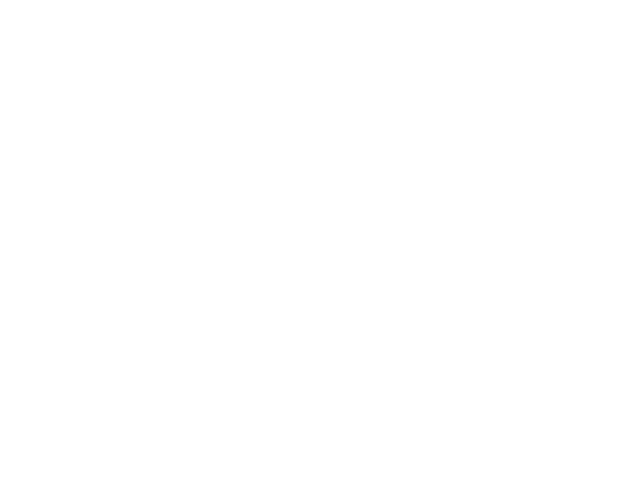

Chosen 65015
Predict is run


<IPython.core.display.Javascript object>


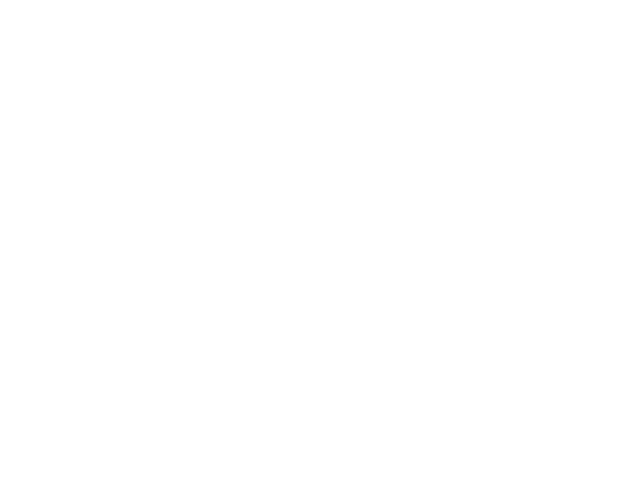

Sensor 65015
Errors:  762  ( 0.0382914572864 )
BIC - raw: -21152.3236073  BIC - clean: -3228.3433614


<IPython.core.display.Javascript object>


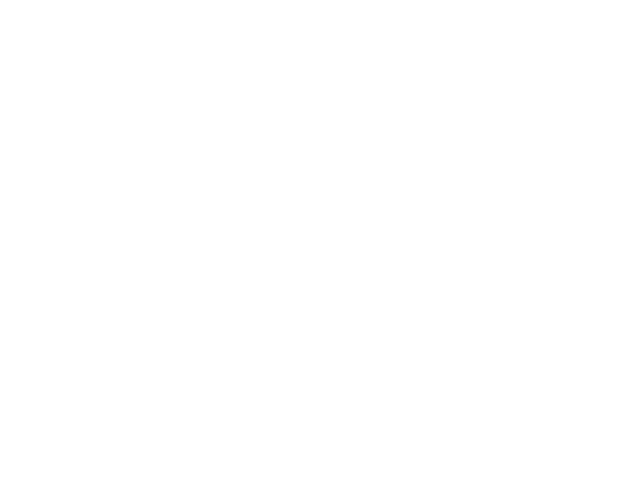

Chosen 10110
Predict is run


<IPython.core.display.Javascript object>


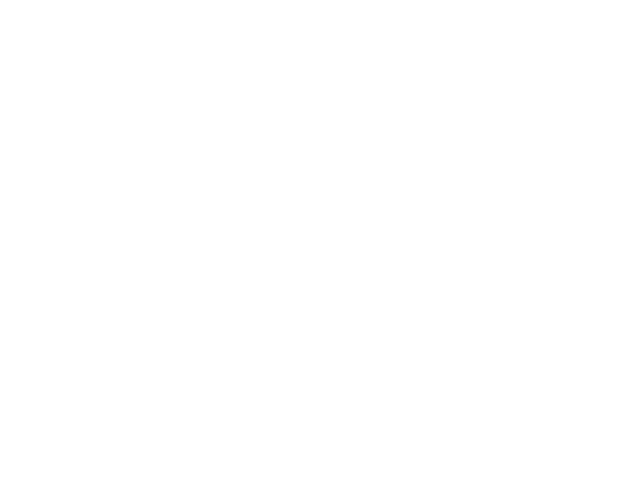

Sensor 10110
Errors:  13  ( 0.0769230769231 )
BIC - raw: 2699.53837157  BIC - clean: 2538.95565004


<IPython.core.display.Javascript object>


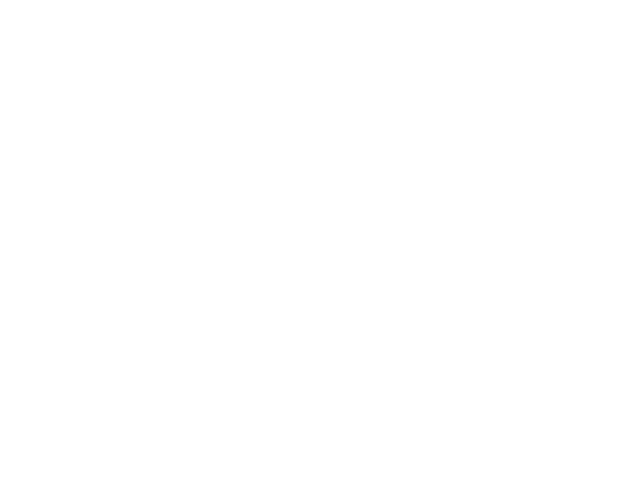

Chosen 35029
Predict is run


<IPython.core.display.Javascript object>


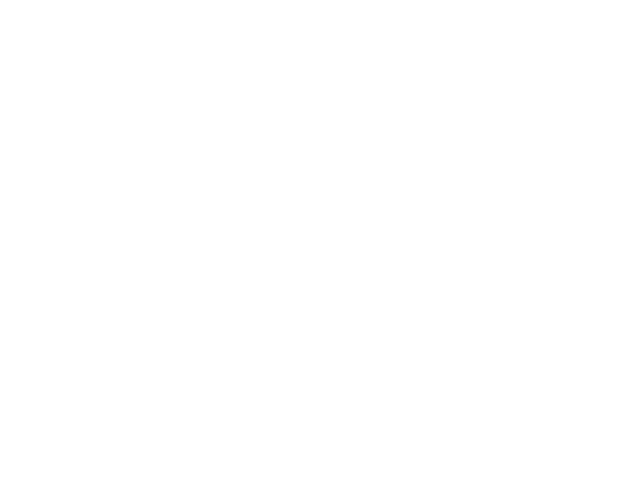

Sensor 35029
Errors:  15  ( 0.0165380374862 )
BIC - raw: -2858.19250307  BIC - clean: -2177.71012863


<IPython.core.display.Javascript object>


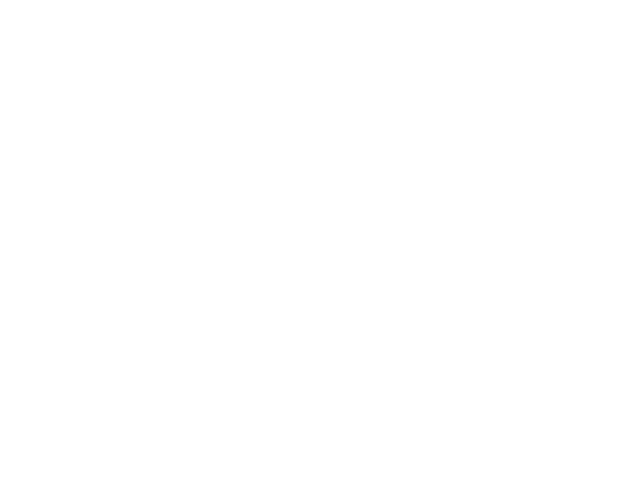

Chosen 20010
Predict is run


<IPython.core.display.Javascript object>


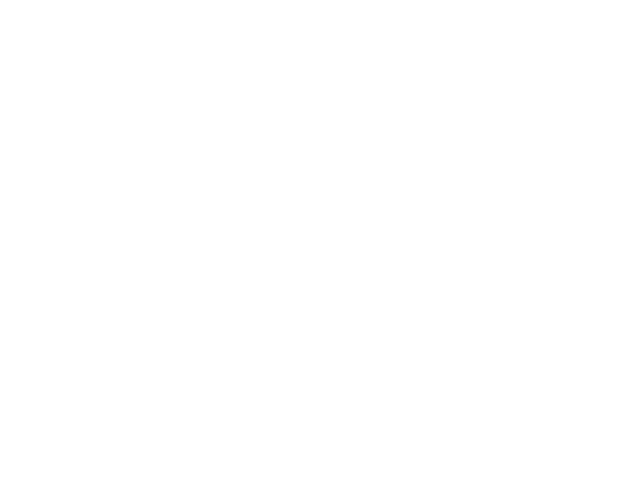

Sensor 20010
Errors:  21  ( 0.0054873268879 )
BIC - raw: -16664.0839866  BIC - clean: -15883.3265452


<IPython.core.display.Javascript object>


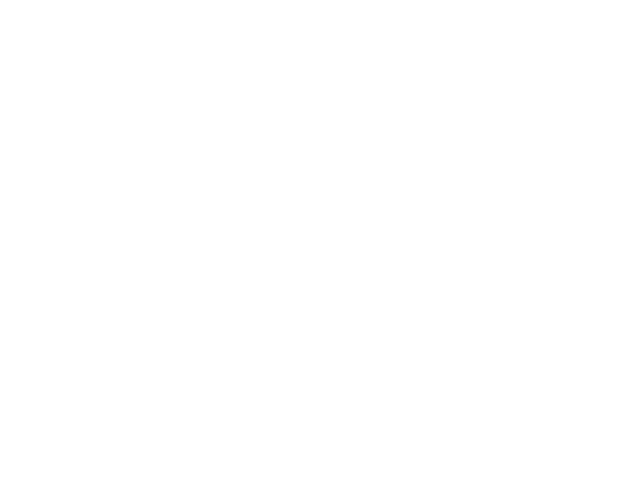

Chosen 80102
Predict is run


<IPython.core.display.Javascript object>


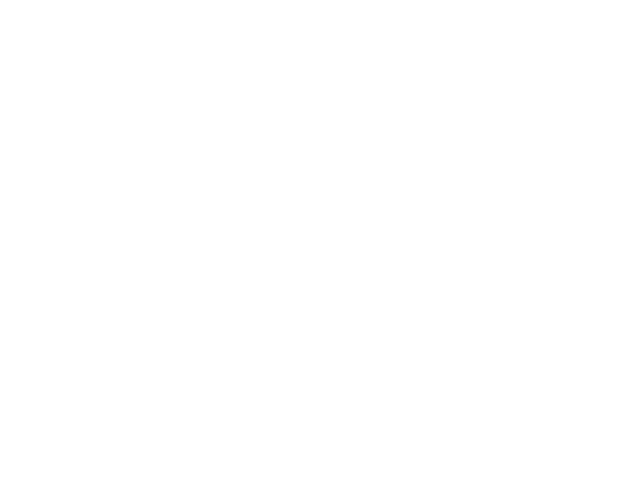

Sensor 80102
Errors:  86  ( 0.0575635876841 )
BIC - raw: -2135.30404639  BIC - clean: -1237.46152252


<IPython.core.display.Javascript object>


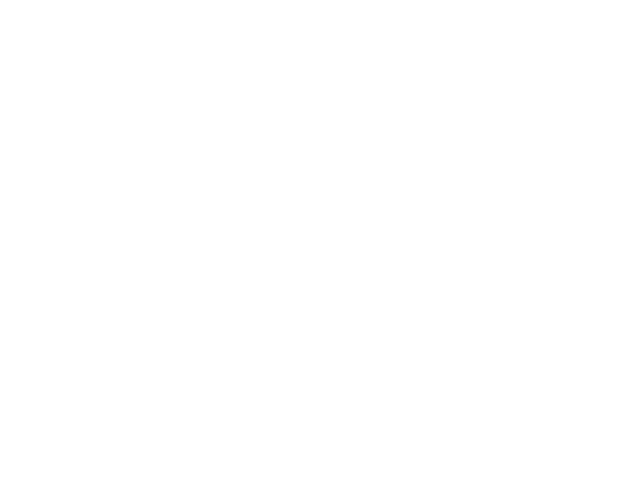

Chosen 10114
Predict is run


<IPython.core.display.Javascript object>


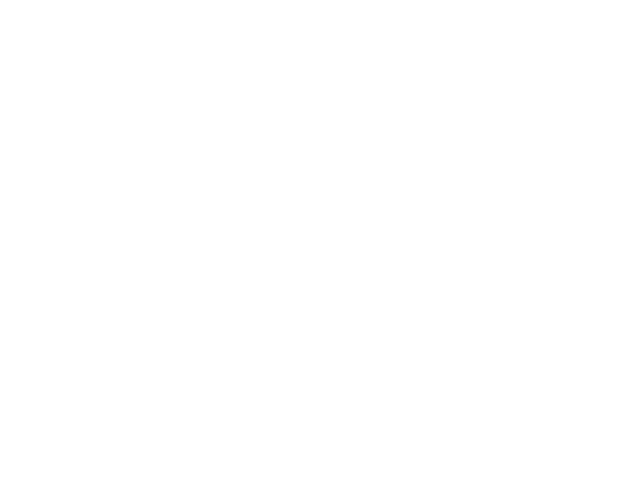

Sensor 10114
Errors:  26  ( 0.111587982833 )
BIC - raw: -45.6544574131  BIC - clean: -45.9521080221


<IPython.core.display.Javascript object>


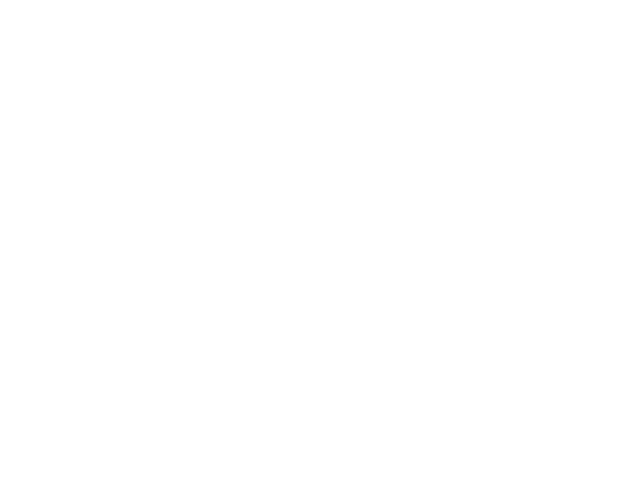

Chosen 80107
Predict is run


<IPython.core.display.Javascript object>


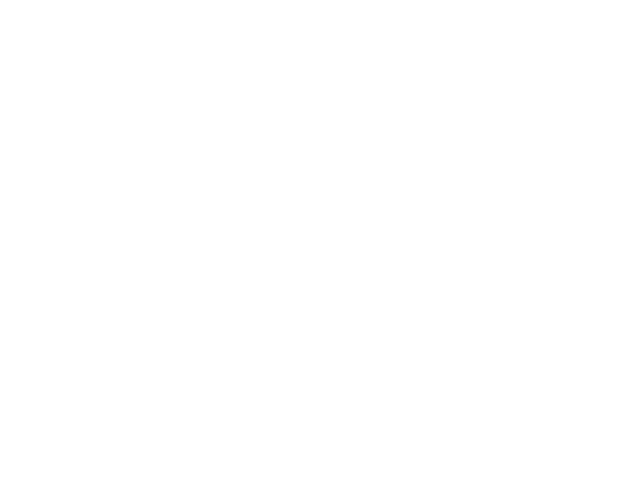

Sensor 80107
Errors:  4  ( 0.0248447204969 )
BIC - raw: -250.329672926  BIC - clean: -250.329672926


<IPython.core.display.Javascript object>


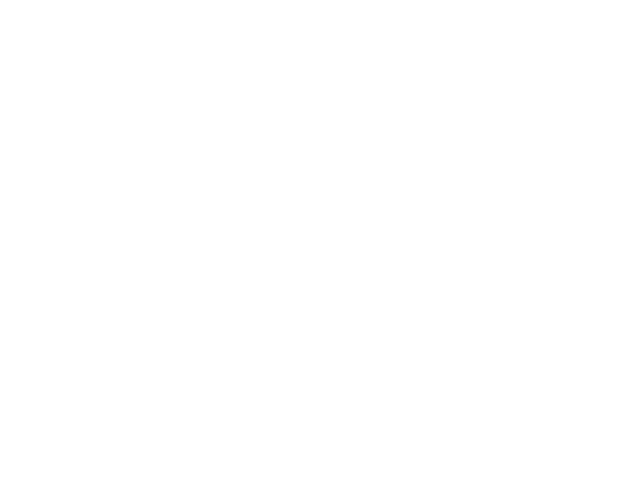

Chosen 50035
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
Chosen 80010
Predict is run


<IPython.core.display.Javascript object>


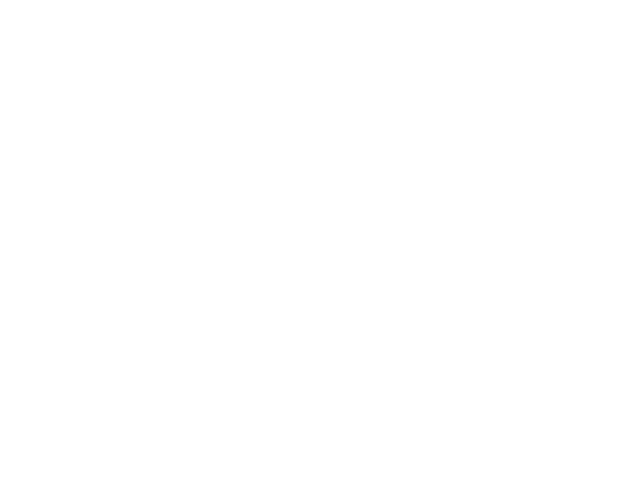

Sensor 80010
Errors:  145  ( 0.00976168035546 )
BIC - raw: -47553.980982  BIC - clean: -38275.885085


<IPython.core.display.Javascript object>


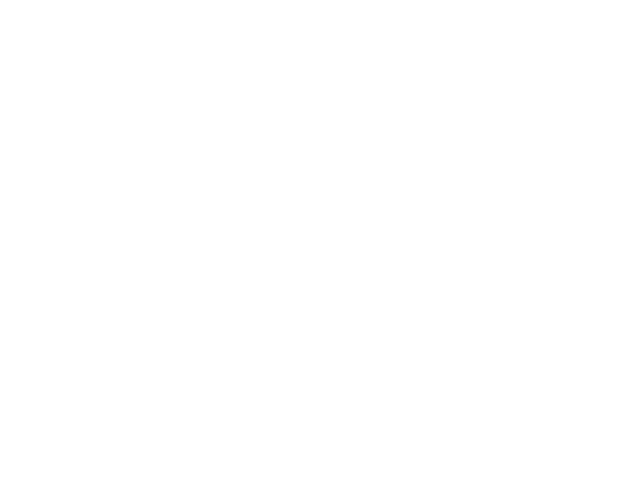

Chosen 35050
Predict is run


<IPython.core.display.Javascript object>


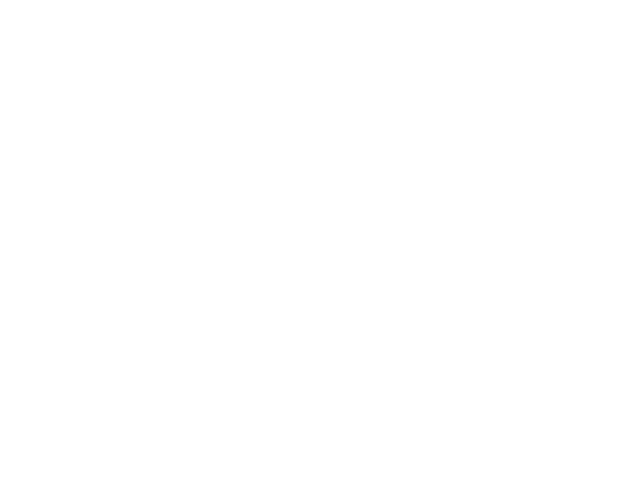

Sensor 35050
Errors:  120  ( 0.00813063215665 )
BIC - raw: -57043.190053  BIC - clean: -50264.8995048


<IPython.core.display.Javascript object>


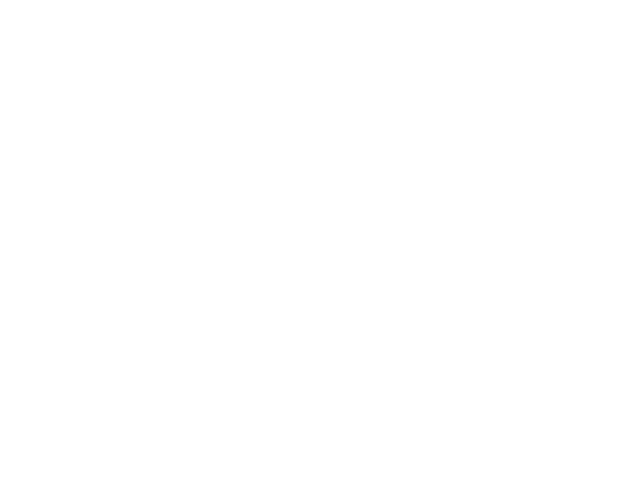

<class 'KeyError'>
('Value',)
Chosen 10109
Predict is run


<IPython.core.display.Javascript object>


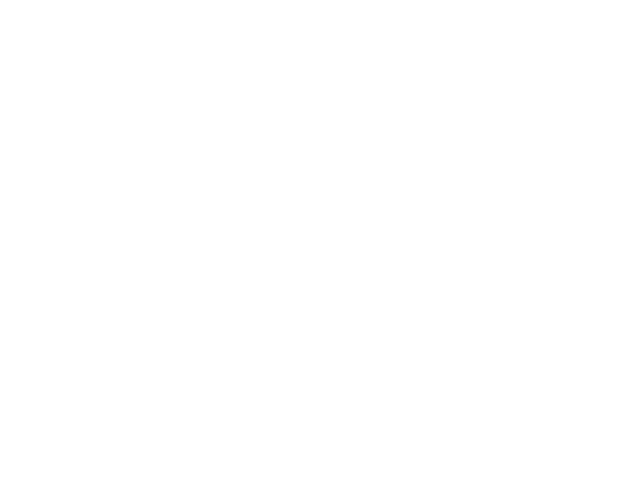

Sensor 10109
Errors:  1  ( 0.00429184549356 )
BIC - raw: 3377.08592414  BIC - clean: -217.011296319


<IPython.core.display.Javascript object>


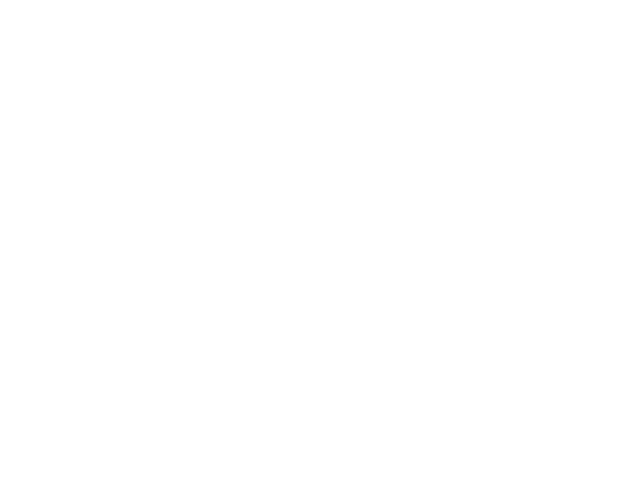

Chosen 10107
Predict is run


<IPython.core.display.Javascript object>


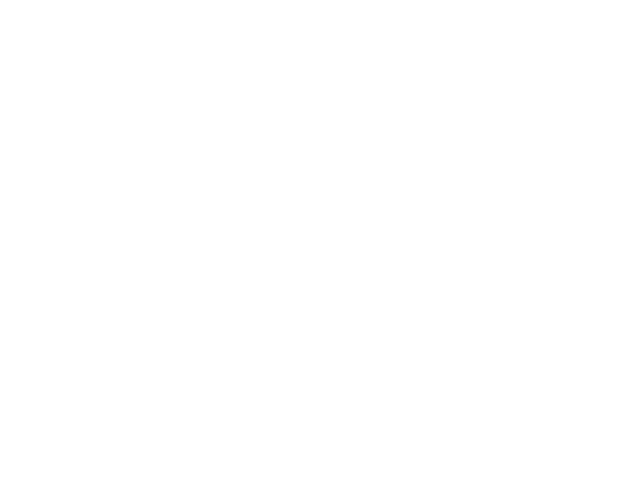

Sensor 10107
Errors:  12  ( 0.0515021459227 )
BIC - raw: -284.08518117  BIC - clean: -267.532765525


<IPython.core.display.Javascript object>


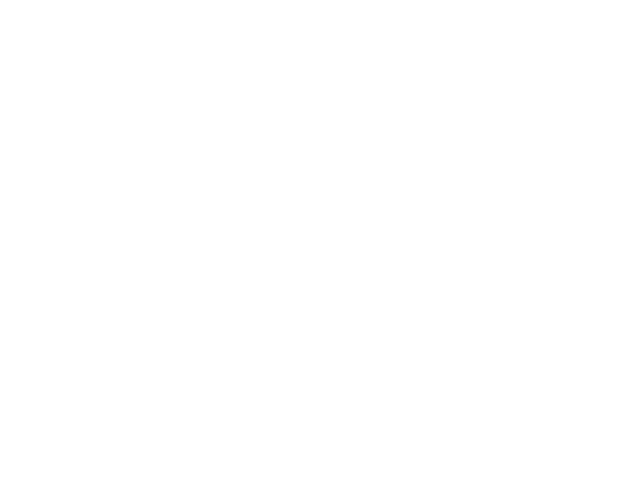

Chosen 10106
Predict is run


<IPython.core.display.Javascript object>


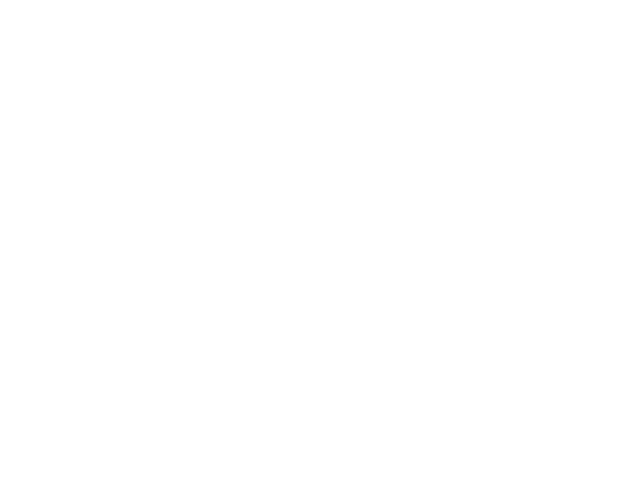

Sensor 10106
Errors:  18  ( 0.0772532188841 )
BIC - raw: -204.091858331  BIC - clean: -179.173157778


<IPython.core.display.Javascript object>


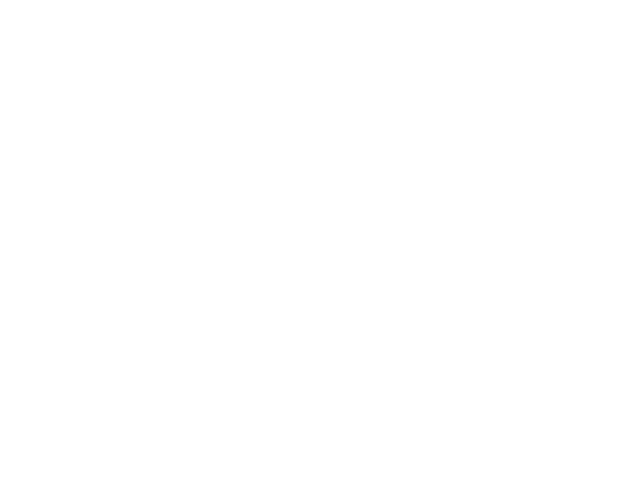

Chosen 70021
<class 'TypeError'>
("Cannot cast ufunc subtract output from dtype('float64') to dtype('int64') with casting rule 'same_kind'",)
Chosen 40010
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 40107
Predict is run


<IPython.core.display.Javascript object>


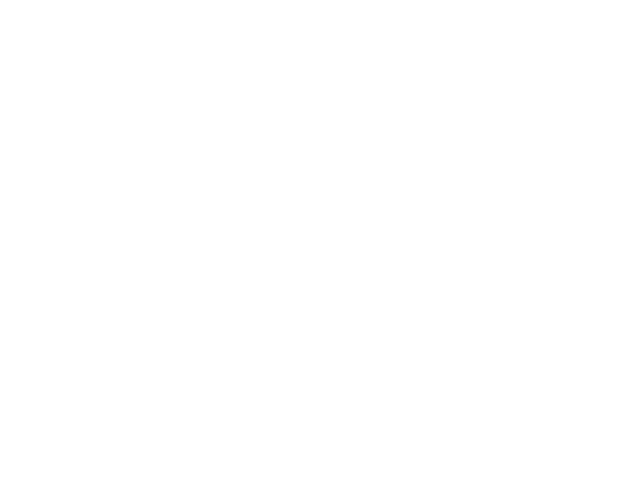

Sensor 40107
Errors:  389  ( 0.465311004785 )
BIC - raw: 2069.8721444  BIC - clean: 2812.74780492


<IPython.core.display.Javascript object>


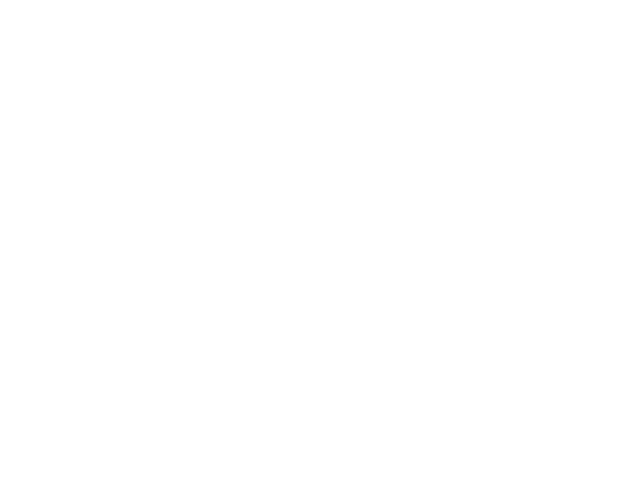

Chosen 10103
Predict is run


<IPython.core.display.Javascript object>


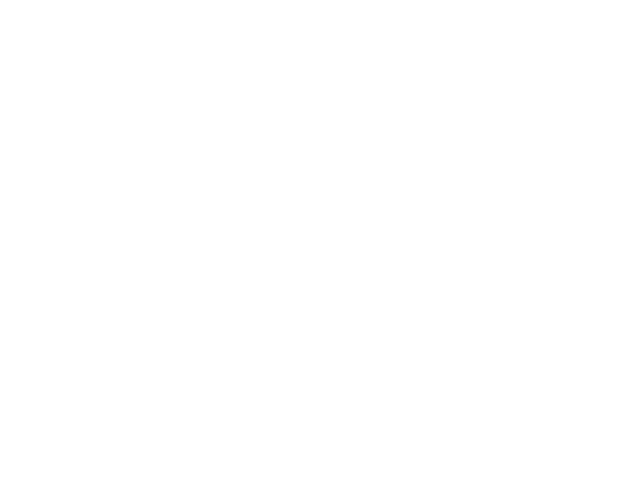

Sensor 10103
Errors:  108  ( 0.0329972502291 )
BIC - raw: -5733.81053533  BIC - clean: -4824.96917475


<IPython.core.display.Javascript object>


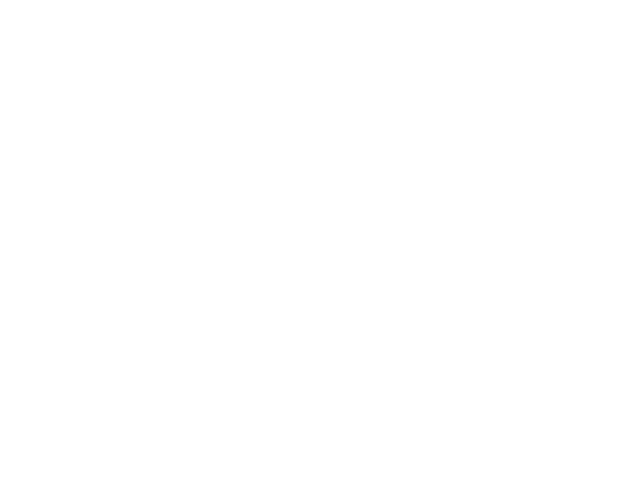

Chosen 85031
Predict is run


<IPython.core.display.Javascript object>


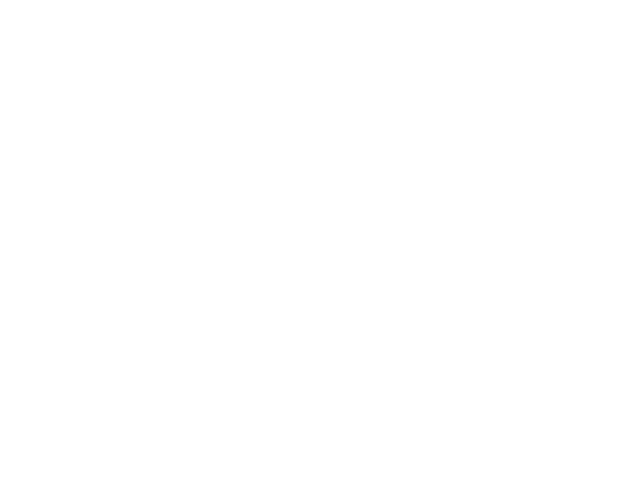

Sensor 85031
Errors:  15  ( 0.00270221581697 )
BIC - raw: 78510.6692887  BIC - clean: -8968.1157345


<IPython.core.display.Javascript object>


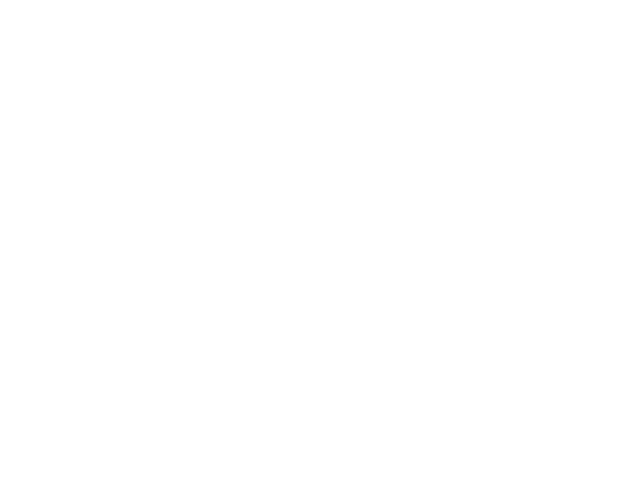

Chosen 85027
Predict is run


<IPython.core.display.Javascript object>


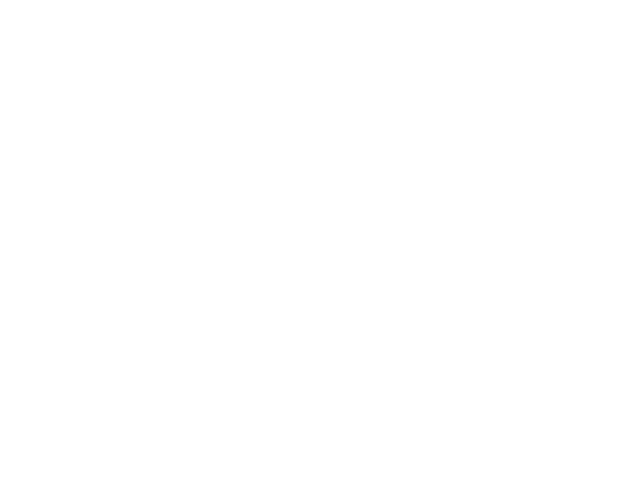

Sensor 85027
Errors:  51  ( 0.178321678322 )
BIC - raw: 179.789732756  BIC - clean: 167.521284881


<IPython.core.display.Javascript object>


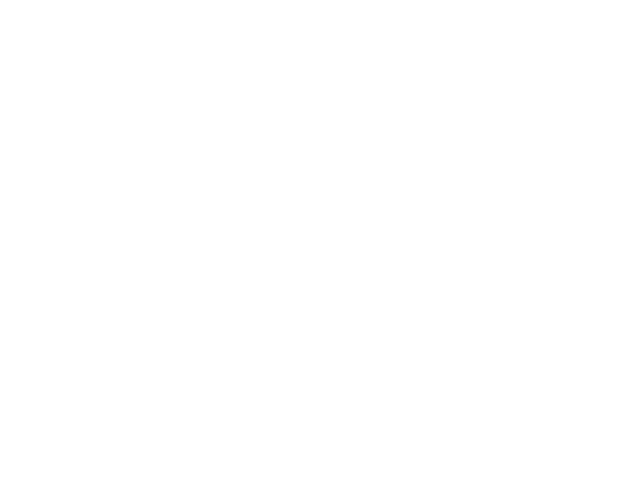

Chosen 90102
Predict is run


<IPython.core.display.Javascript object>


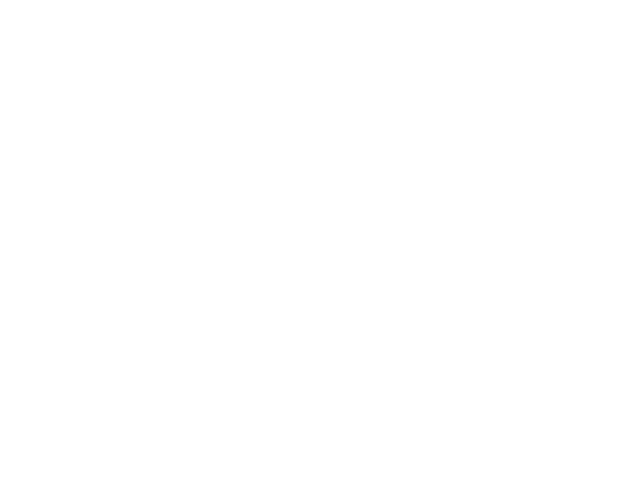

Sensor 90102
Errors:  319  ( 0.185465116279 )
BIC - raw: 634.081365069  BIC - clean: 1038.73117065


<IPython.core.display.Javascript object>


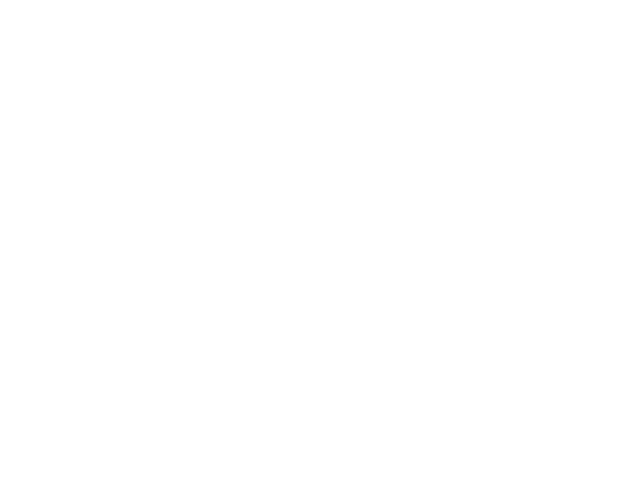

<class 'KeyError'>
('Value',)
Chosen 50063
Predict is run


<IPython.core.display.Javascript object>


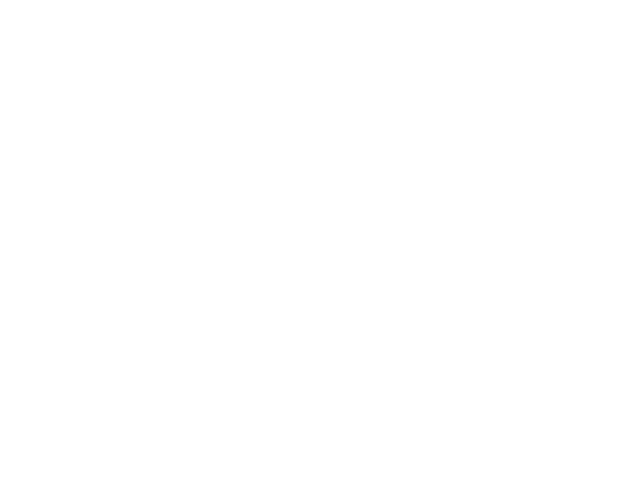

Sensor 50063
Errors:  15  ( 0.06 )
BIC - raw: -437.690466892  BIC - clean: -446.597893109


<IPython.core.display.Javascript object>


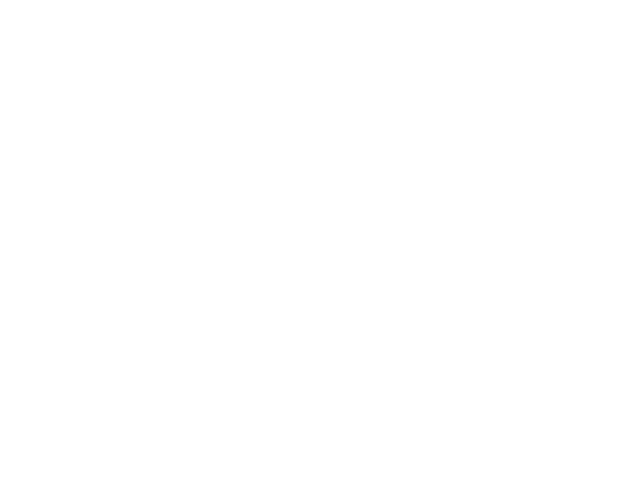

Chosen 85018
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 10105
Predict is run


<IPython.core.display.Javascript object>


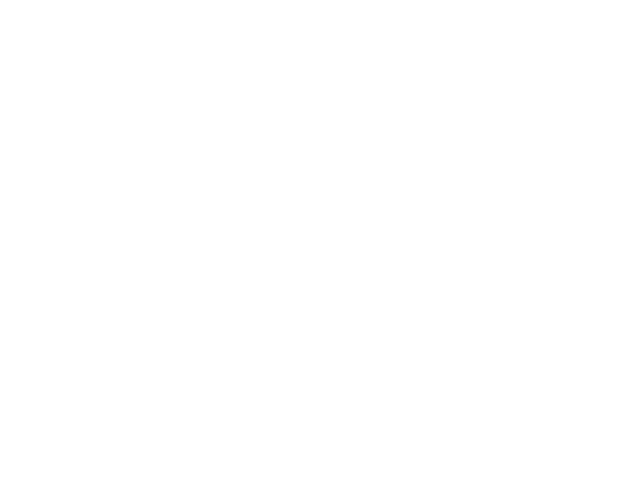

Sensor 10105
Errors:  4  ( 0.00842105263158 )
BIC - raw: 7370.92960706  BIC - clean: -267.095582589


<IPython.core.display.Javascript object>


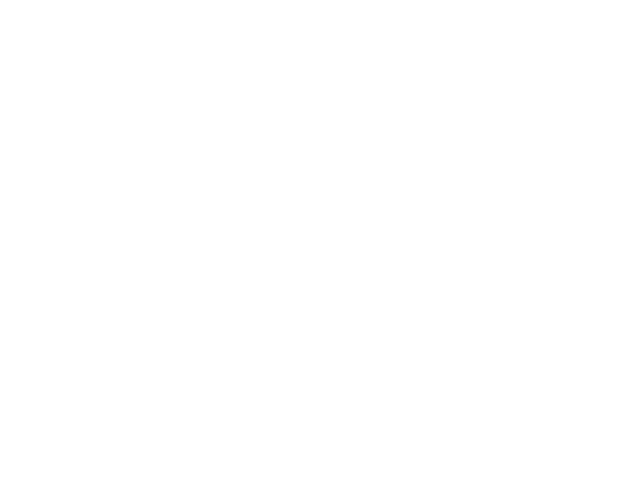

Chosen 40101
Predict is run


<IPython.core.display.Javascript object>


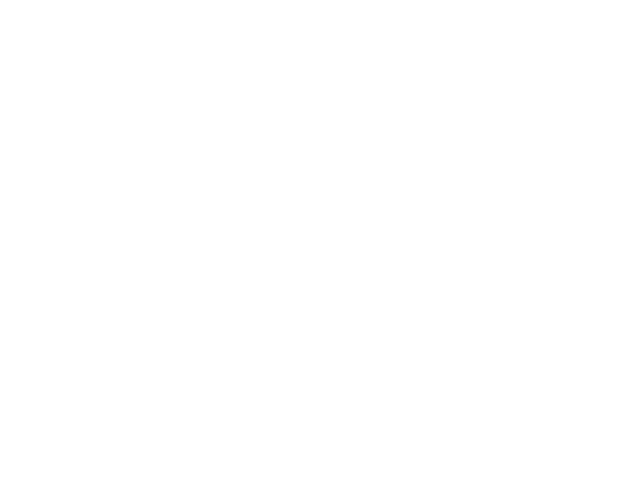

Sensor 40101
Errors:  91  ( 0.313793103448 )
BIC - raw: 859.5438323  BIC - clean: 965.143814604


<IPython.core.display.Javascript object>


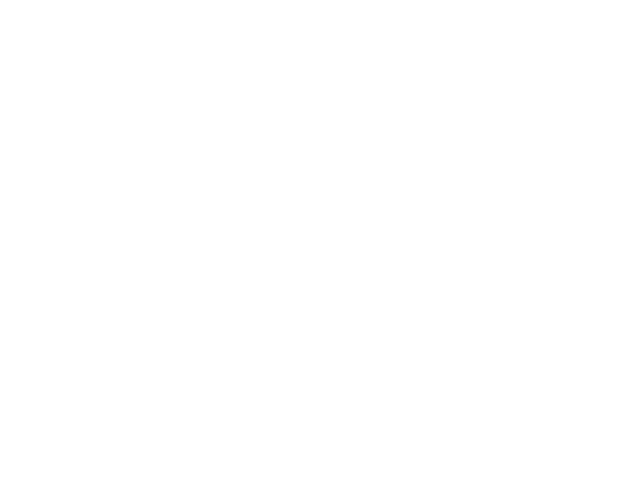

<class 'KeyError'>
('Value',)
Chosen 10104
Predict is run


<IPython.core.display.Javascript object>


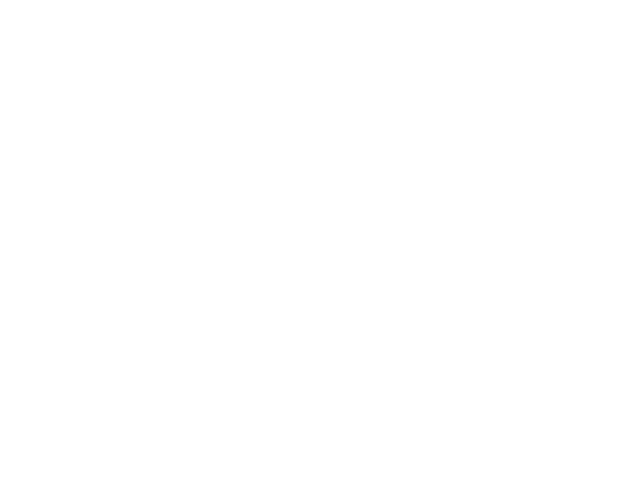

Sensor 10104
Errors:  45  ( 0.0947368421053 )
BIC - raw: -61.9387125606  BIC - clean: -106.169953972


<IPython.core.display.Javascript object>


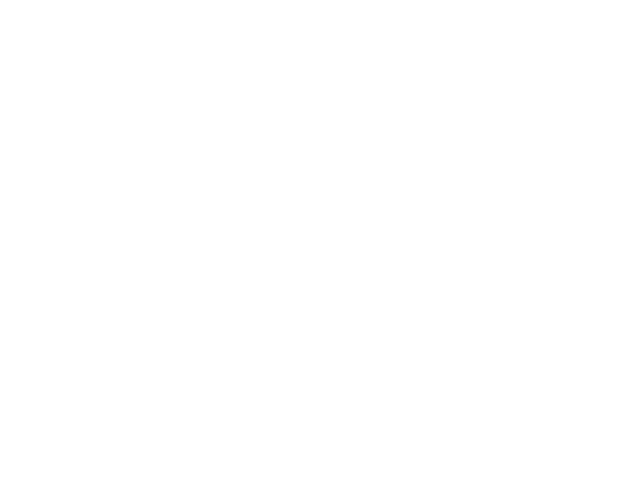

Chosen 10100
Predict is run


<IPython.core.display.Javascript object>


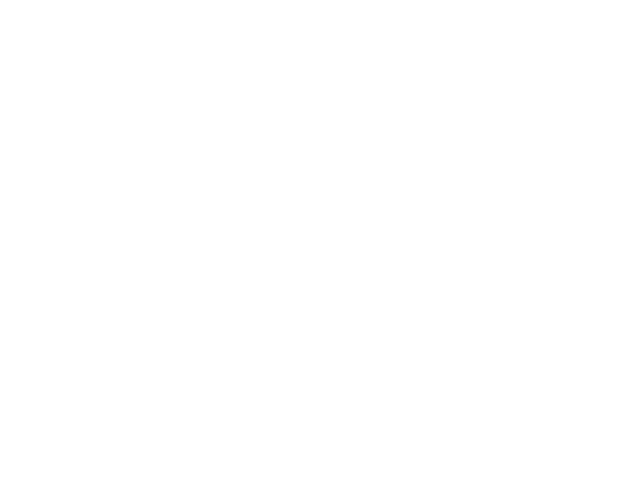

Sensor 10100
Errors:  22  ( 0.109452736318 )
BIC - raw: 3295.19282003  BIC - clean: 2906.39028722


<IPython.core.display.Javascript object>


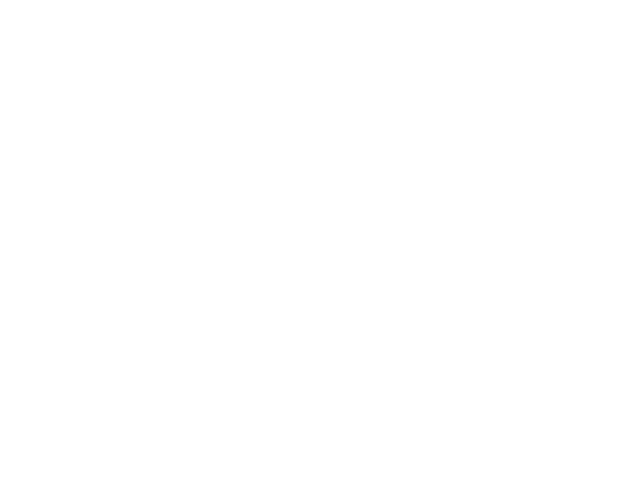

Chosen 30034
Predict is run


<IPython.core.display.Javascript object>


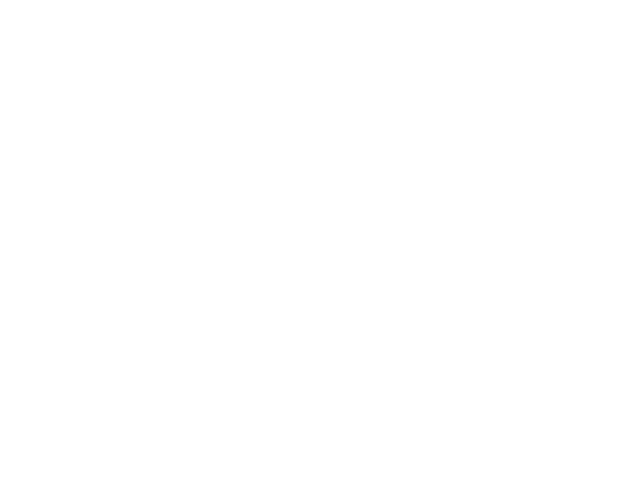

Sensor 30034
Errors:  9  ( 0.05 )
BIC - raw: -55.463723905  BIC - clean: -230.586980351


<IPython.core.display.Javascript object>


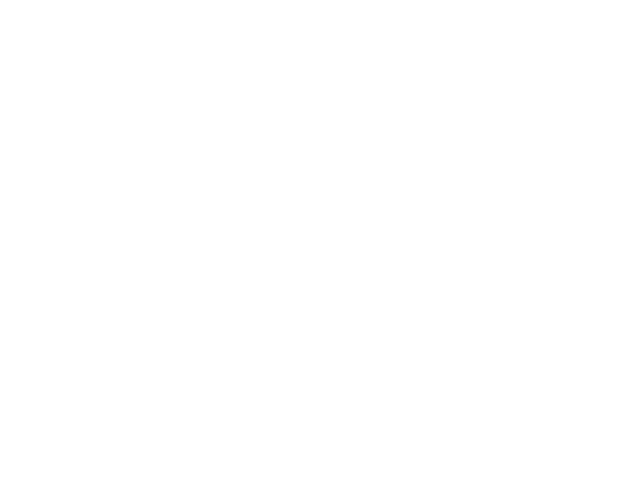

<class 'KeyError'>
('Value',)
Chosen 95009
Predict is run


<IPython.core.display.Javascript object>


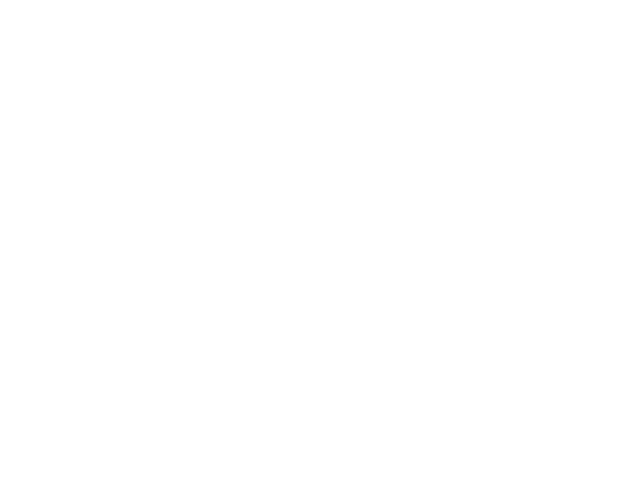

Sensor 95009
Errors:  67  ( 0.195906432749 )
BIC - raw: 6282.38132019  BIC - clean: 5878.80342766


<IPython.core.display.Javascript object>


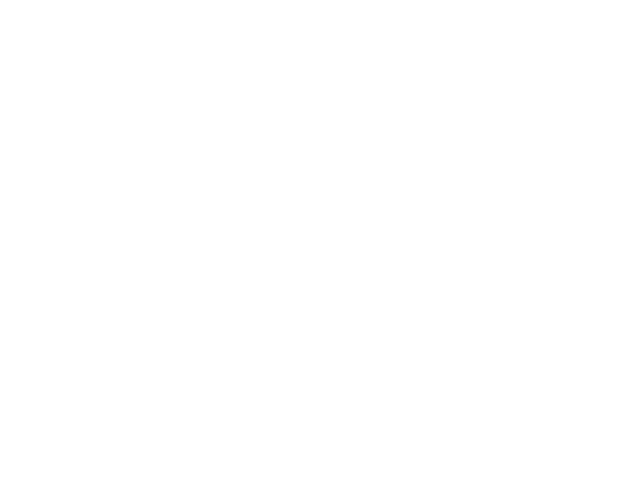

Chosen 10108
Predict is run


<IPython.core.display.Javascript object>


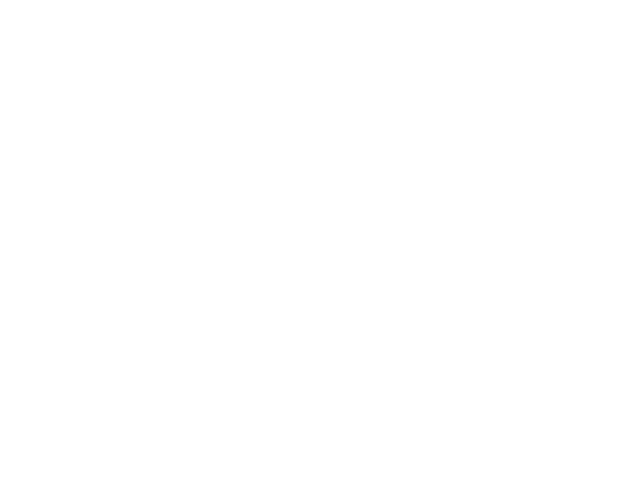

Sensor 10108
Errors:  25  ( 0.206611570248 )
BIC - raw: 1930.28782459  BIC - clean: 1855.39599279


<IPython.core.display.Javascript object>


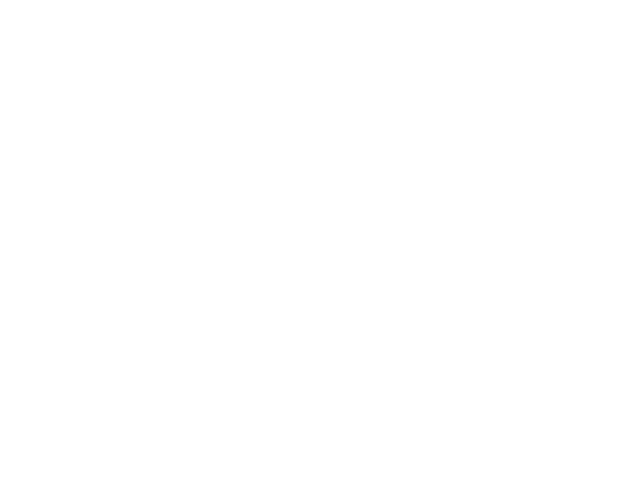

Chosen 10081
Predict is run


<IPython.core.display.Javascript object>


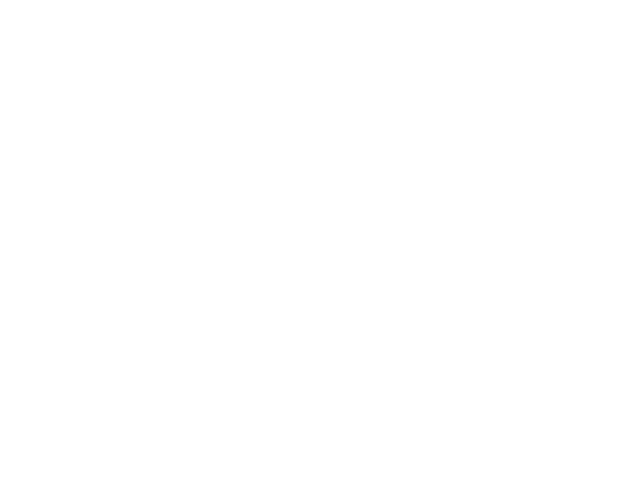

Sensor 10081
Errors:  46  ( 0.21198156682 )
BIC - raw: 149.555621118  BIC - clean: 271.609875623


<IPython.core.display.Javascript object>


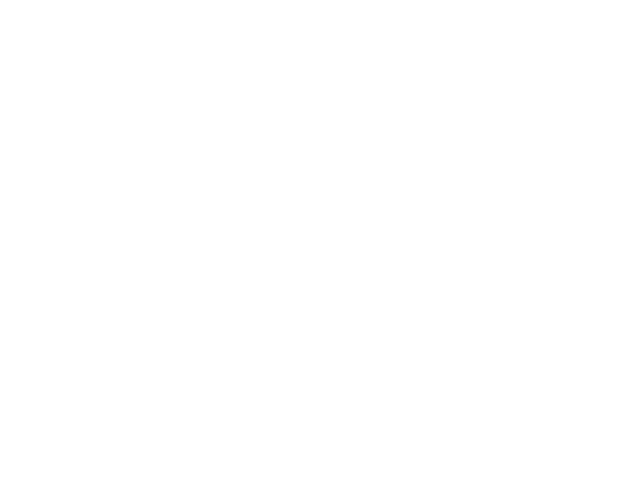

Chosen 40085
Predict is run


<IPython.core.display.Javascript object>


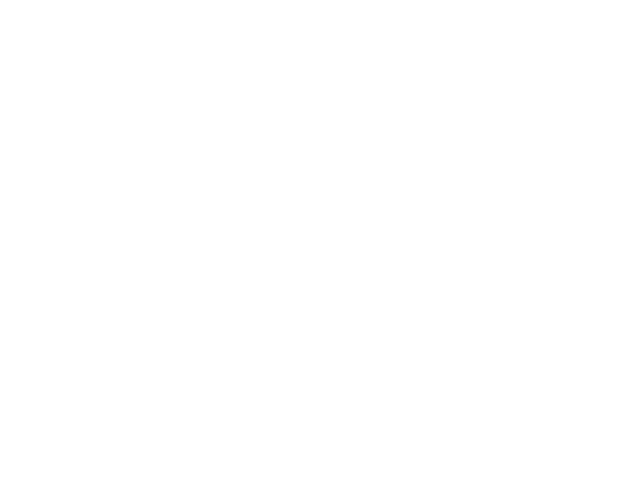

Sensor 40085
Errors:  24  ( 0.24 )
BIC - raw: 49.9150271057  BIC - clean: 75.1110059856


<IPython.core.display.Javascript object>


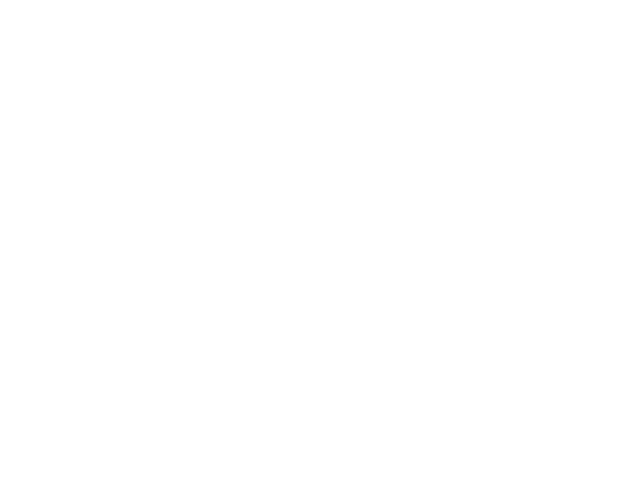

Chosen 85033
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 50045
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30026
Predict is run


<IPython.core.display.Javascript object>


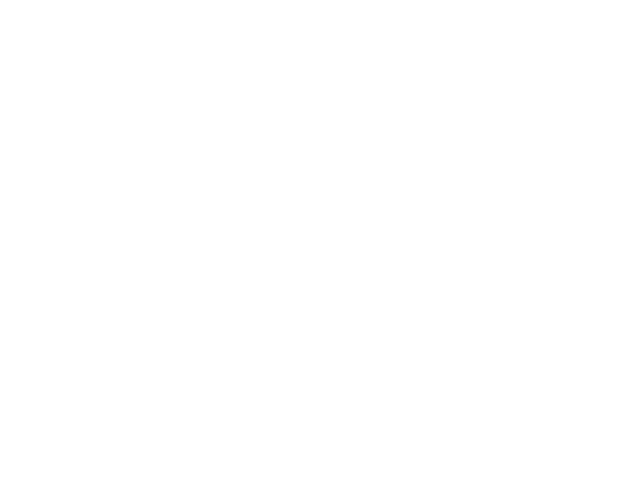

Sensor 30026
Errors:  28  ( 0.12962962963 )
BIC - raw: 99.7973566757  BIC - clean: 138.784170826


<IPython.core.display.Javascript object>


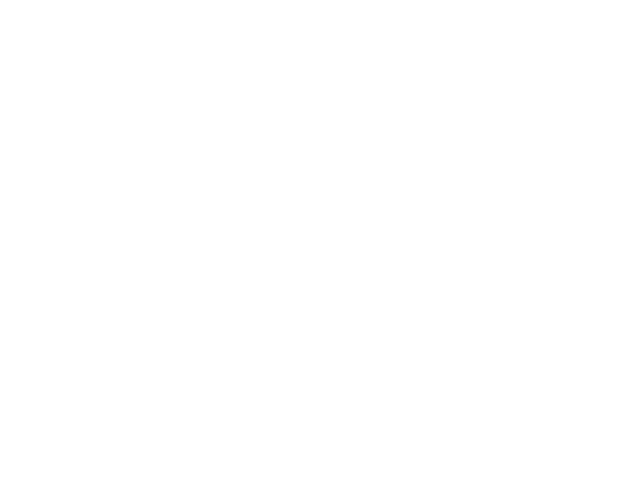

Chosen 10999
Predict is run


<IPython.core.display.Javascript object>


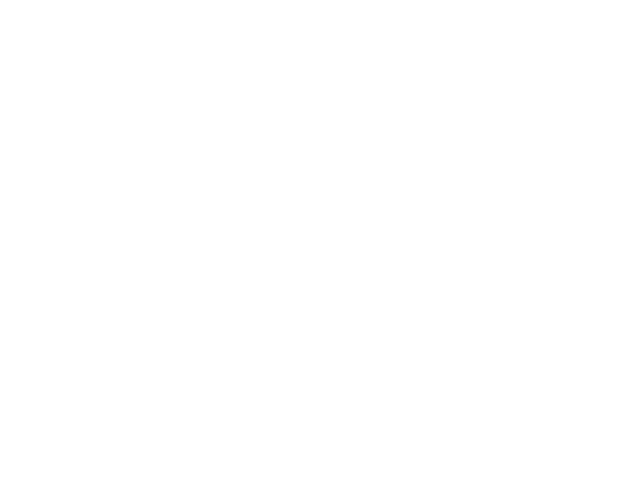

Sensor 10999
Errors:  28  ( 0.042042042042 )
BIC - raw: -1338.68422341  BIC - clean: -1432.92442162


<IPython.core.display.Javascript object>


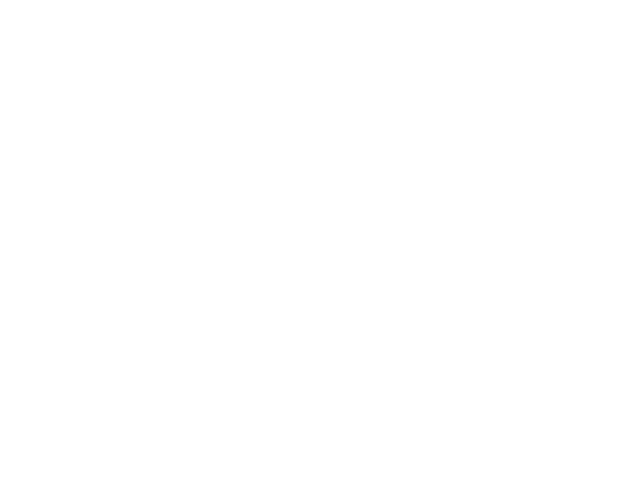

Chosen 10082
Predict is run


<IPython.core.display.Javascript object>


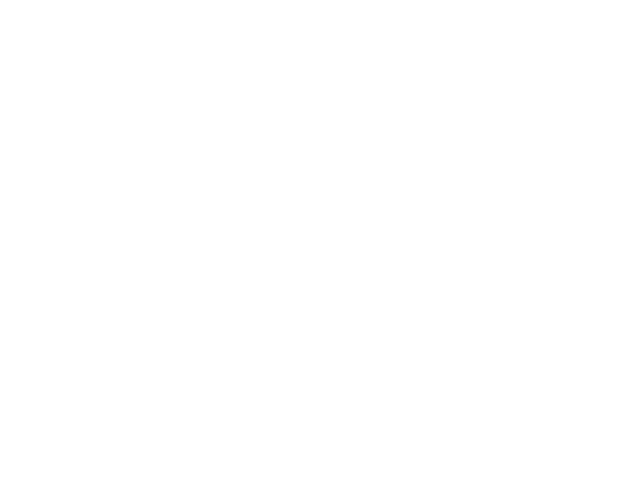

Sensor 10082
Errors:  56  ( 0.259259259259 )
BIC - raw: 266.148557728  BIC - clean: 266.286280183


<IPython.core.display.Javascript object>


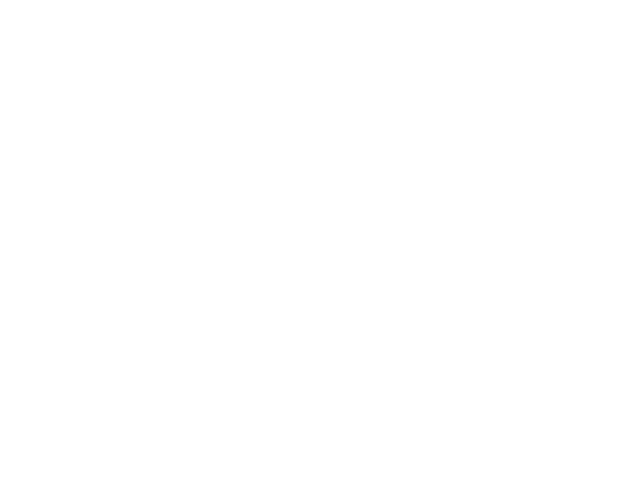

<class 'KeyError'>
('Value',)
Chosen 30174
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 85012
Predict is run


<IPython.core.display.Javascript object>


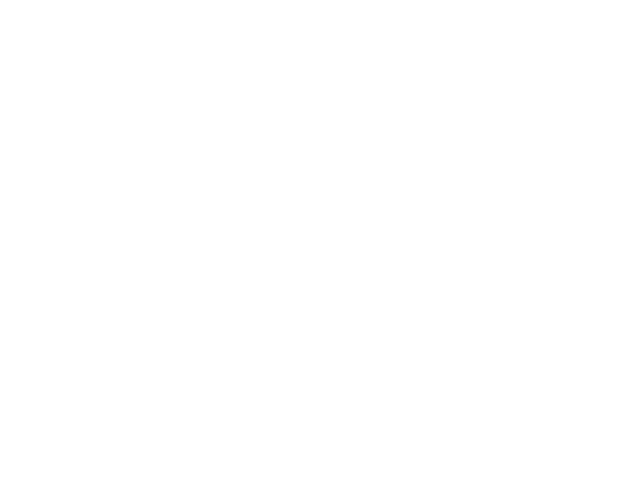

Sensor 85012
Errors:  515  ( 0.0901295064753 )
BIC - raw: -5484.59151953  BIC - clean: -217.905602736


<IPython.core.display.Javascript object>


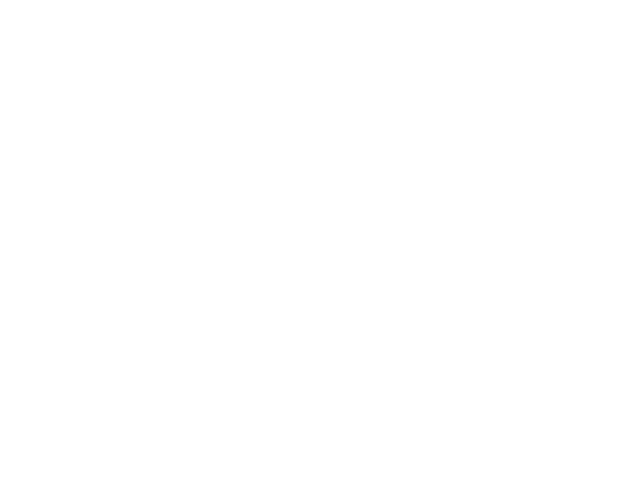

Chosen 90080
Predict is run


<IPython.core.display.Javascript object>


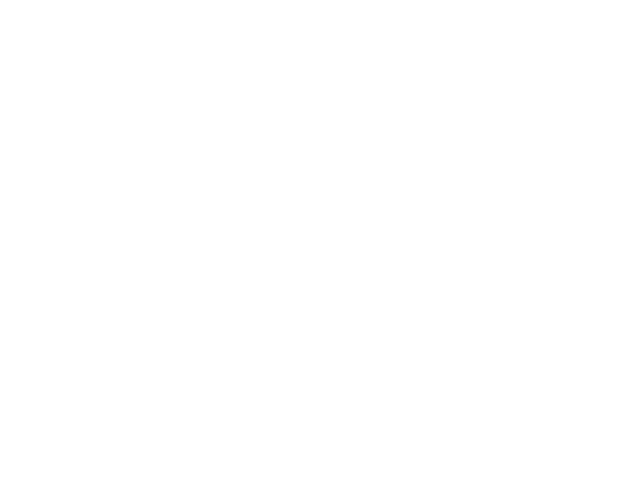

Sensor 90080
Errors:  7  ( 0.0648148148148 )
BIC - raw: -25.8998918293  BIC - clean: -35.5122685874


<IPython.core.display.Javascript object>


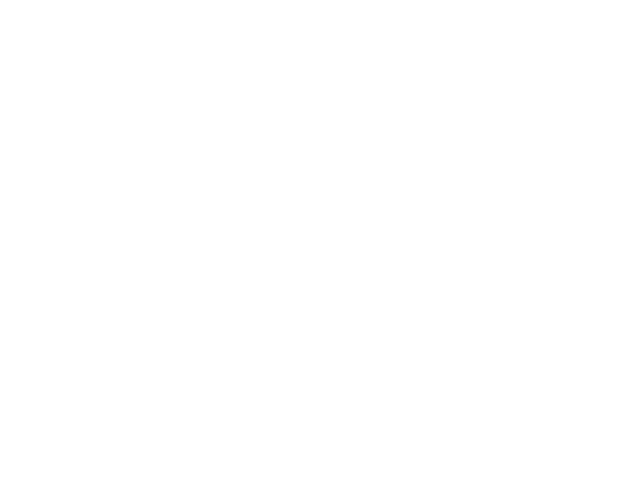

Chosen 95102
Predict is run


<IPython.core.display.Javascript object>


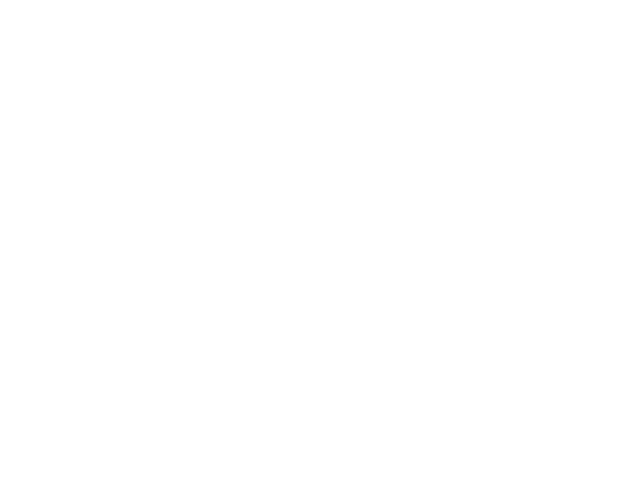

Sensor 95102
Errors:  38  ( 0.0306451612903 )
BIC - raw: 20754.7807014  BIC - clean: 18331.4081348


<IPython.core.display.Javascript object>


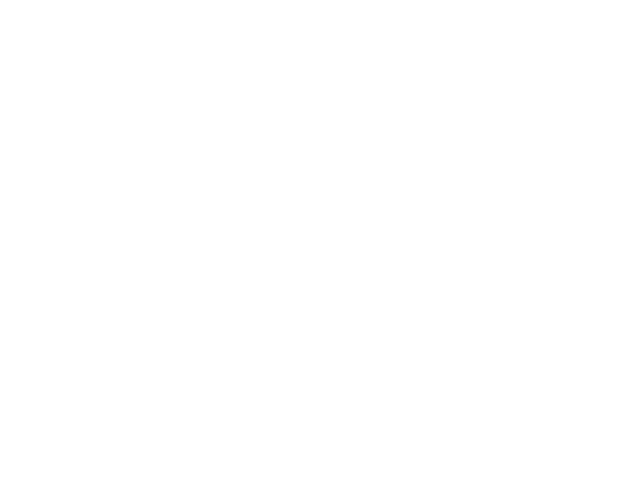

Chosen 25065
Predict is run


<IPython.core.display.Javascript object>


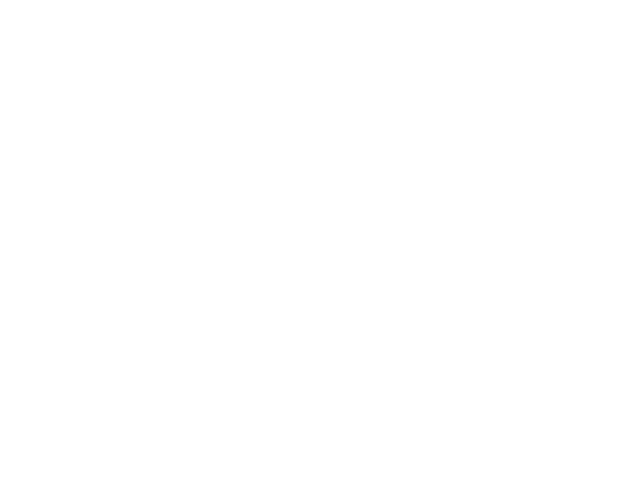

Sensor 25065
Errors:  4  ( 0.0555555555556 )
BIC - raw: -10.005376077  BIC - clean: -10.005376077


<IPython.core.display.Javascript object>


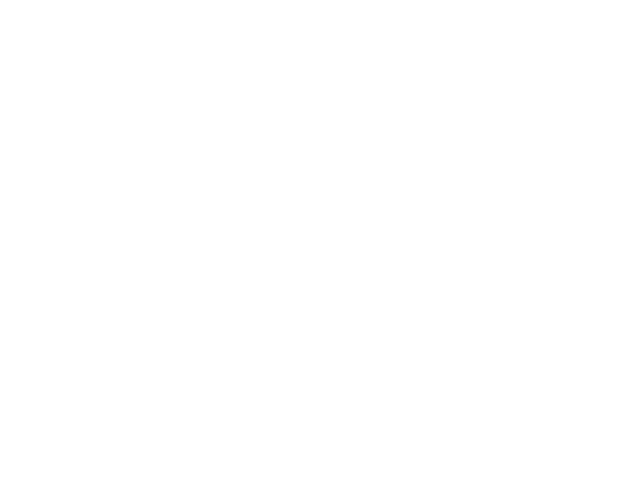

Chosen 80106
Predict is run


<IPython.core.display.Javascript object>


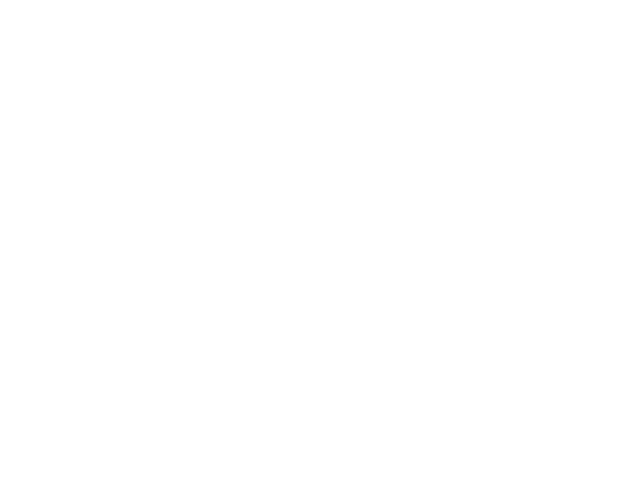

Sensor 80106
Errors:  4  ( 0.0248447204969 )
BIC - raw: -400.923302383  BIC - clean: -400.923302383


<IPython.core.display.Javascript object>


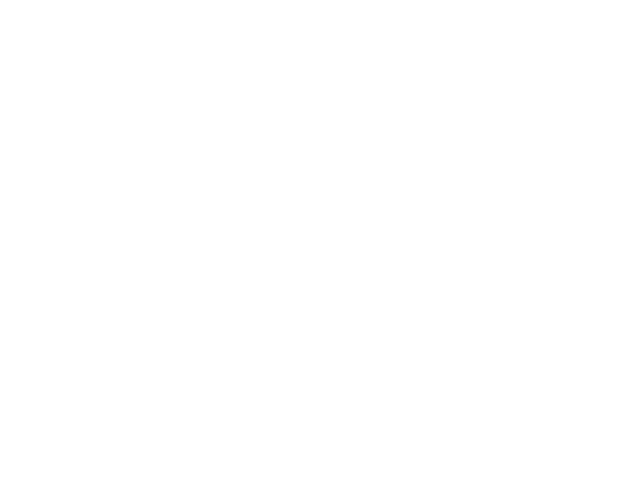

Chosen 10111
Predict is run


<IPython.core.display.Javascript object>


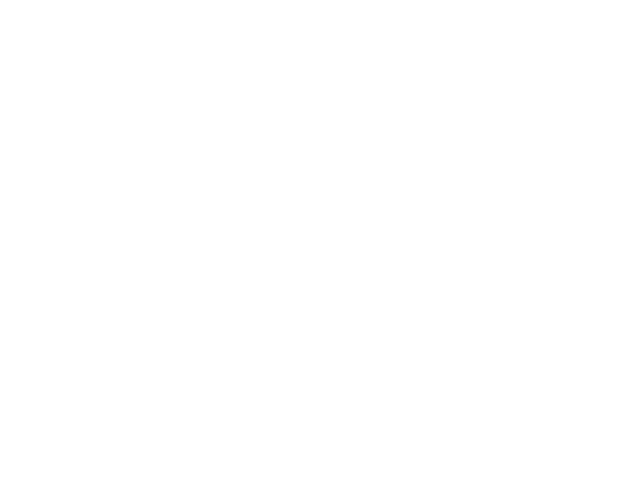

Sensor 10111
Errors:  26  ( 0.16049382716 )
BIC - raw: 2557.12382694  BIC - clean: 2533.11527427


<IPython.core.display.Javascript object>


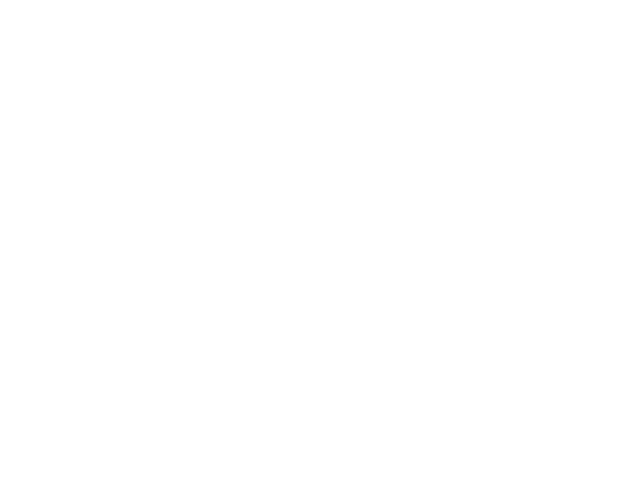

<class 'KeyError'>
('Value',)
Chosen 80065
Predict is run


<IPython.core.display.Javascript object>


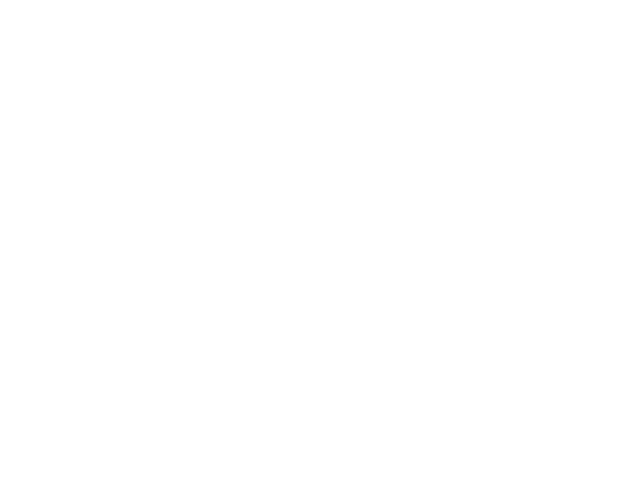

Sensor 80065
Errors:  404  ( 0.0772318868285 )
BIC - raw: -6946.93773004  BIC - clean: -5637.43415964


<IPython.core.display.Javascript object>


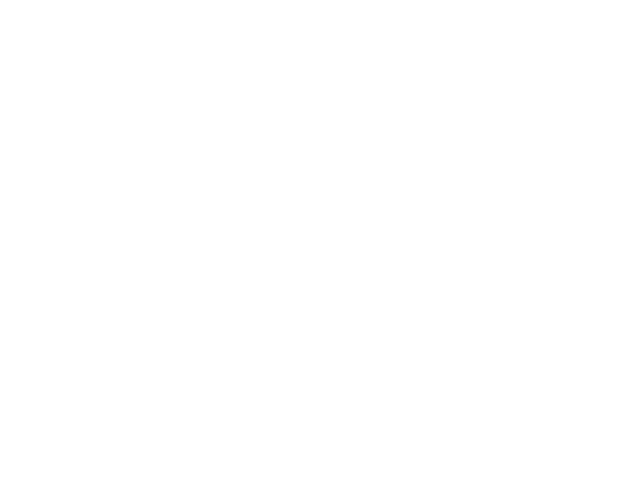

Chosen 10079
Predict is run


<IPython.core.display.Javascript object>


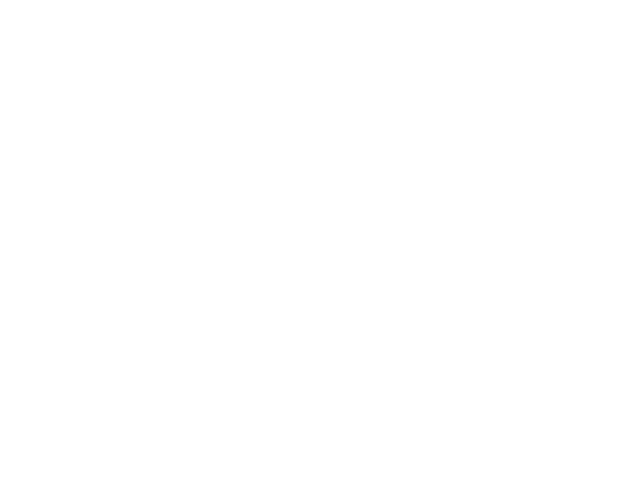

Sensor 10079
Errors:  48  ( 0.222222222222 )
BIC - raw: 149.966768117  BIC - clean: 123.384002293


<IPython.core.display.Javascript object>


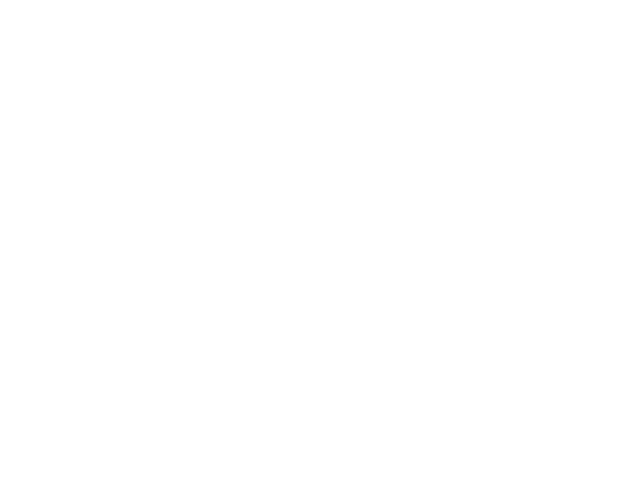

Chosen 85024
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 30188
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 85003
Predict is run


<IPython.core.display.Javascript object>


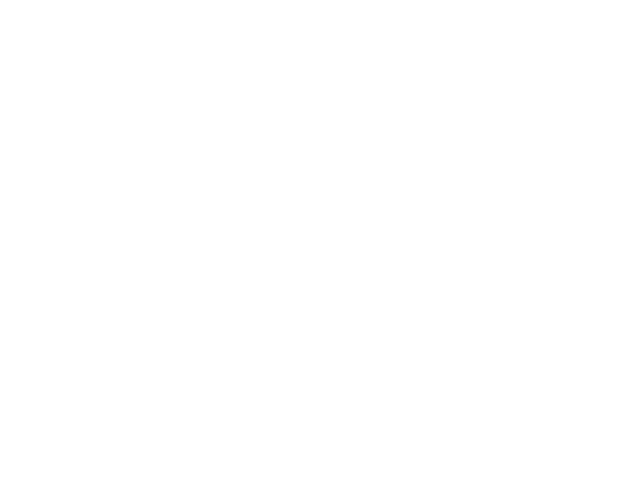

Sensor 85003
Errors:  3  ( 0.046875 )
BIC - raw: 759.976909896  BIC - clean: 80.2820571554


<IPython.core.display.Javascript object>


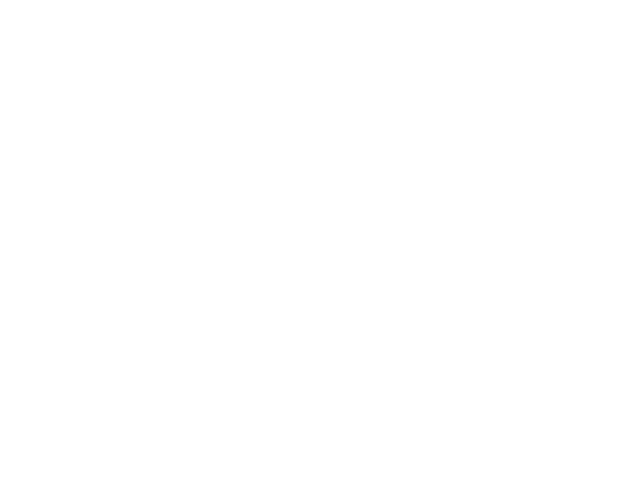

Chosen 85034
Predict is run


<IPython.core.display.Javascript object>


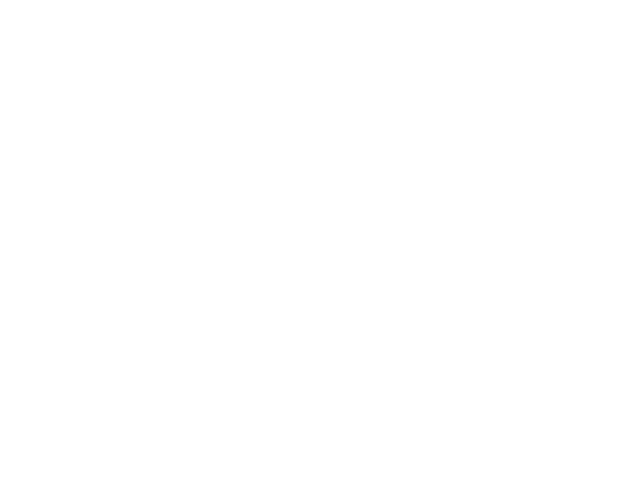

Sensor 85034
Errors:  23  ( 0.129943502825 )
BIC - raw: 100.196358376  BIC - clean: 54.543958362


<IPython.core.display.Javascript object>


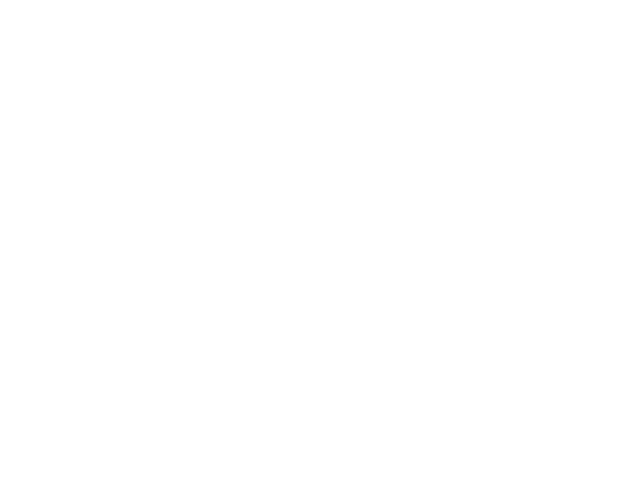

Chosen 40020
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 10070
Predict is run


<IPython.core.display.Javascript object>


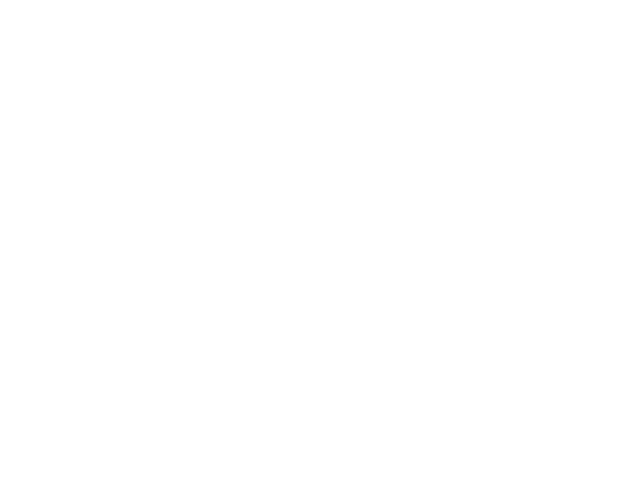

Sensor 10070
Errors:  117  ( 0.0256804214223 )
BIC - raw: -10728.8925427  BIC - clean: -9077.94274121


<IPython.core.display.Javascript object>


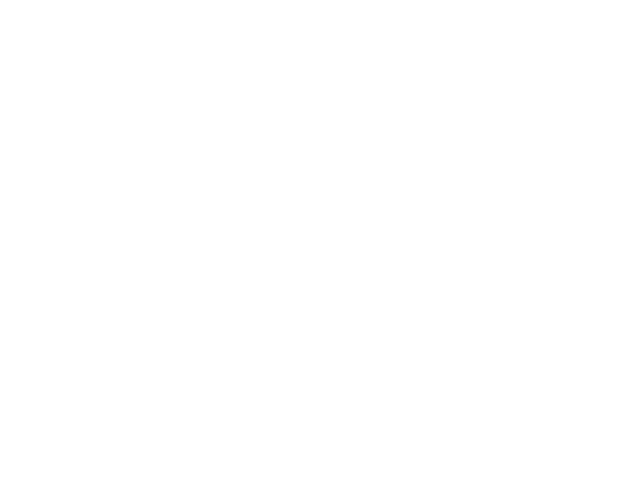

Chosen 85029
Predict is run


<IPython.core.display.Javascript object>


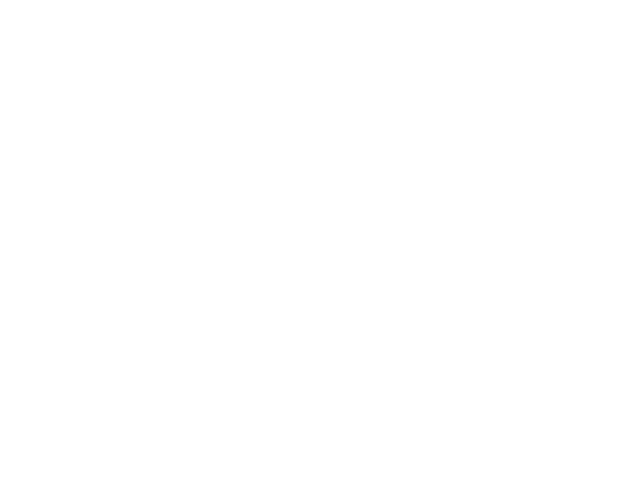

Sensor 85029
Errors:  14  ( 0.0503597122302 )
BIC - raw: 4469.7025969  BIC - clean: 4272.21274807


<IPython.core.display.Javascript object>


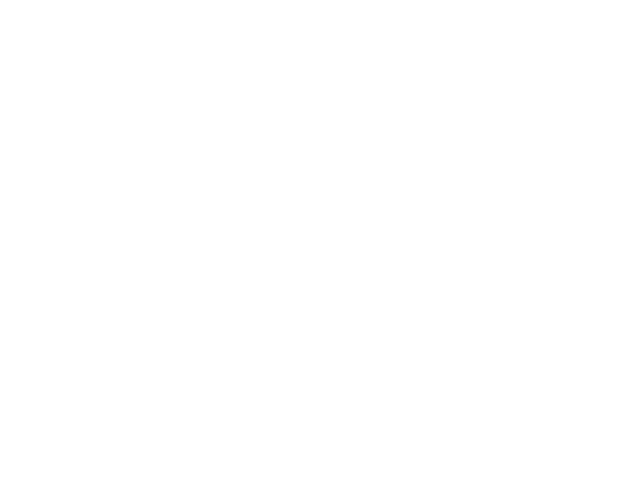

Chosen 25101
Predict is run


<IPython.core.display.Javascript object>


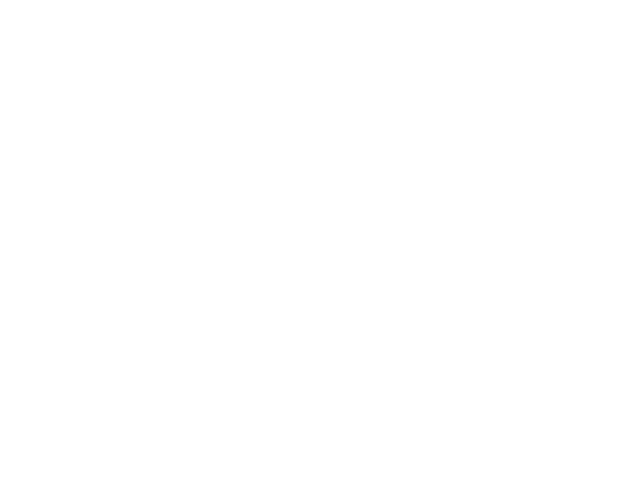

Sensor 25101
Errors:  727  ( 0.342117647059 )
BIC - raw: 3271.89315728  BIC - clean: 4341.10308131


<IPython.core.display.Javascript object>


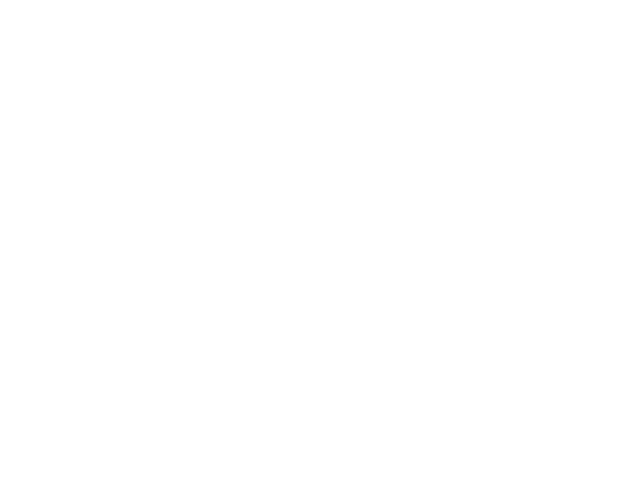

Chosen 95008
Predict is run


<IPython.core.display.Javascript object>


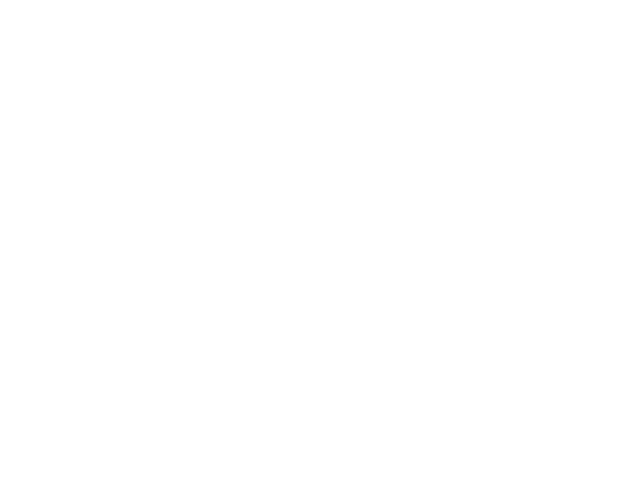

Sensor 95008
Errors:  9  ( 0.0796460176991 )
BIC - raw: -137.072251419  BIC - clean: -147.497185541


<IPython.core.display.Javascript object>


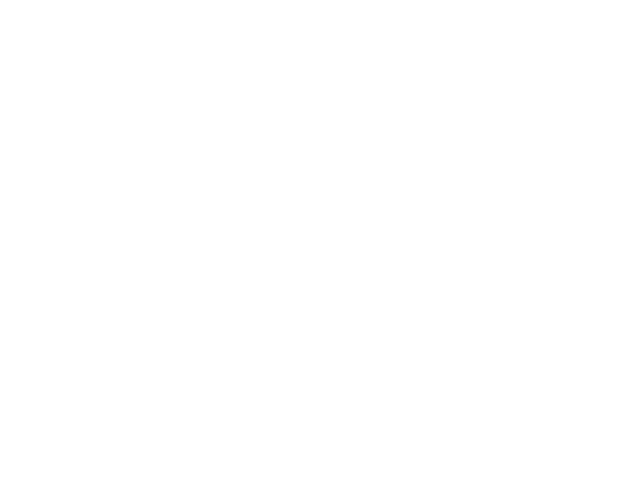

<class 'KeyError'>
('Value',)
Chosen 10091
Predict is run


<IPython.core.display.Javascript object>


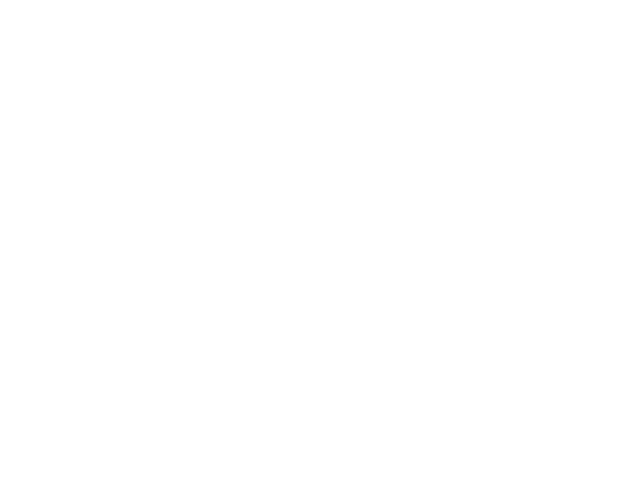

Sensor 10091
Errors:  39  ( 0.179723502304 )
BIC - raw: 120.757614823  BIC - clean: 116.021100566


<IPython.core.display.Javascript object>


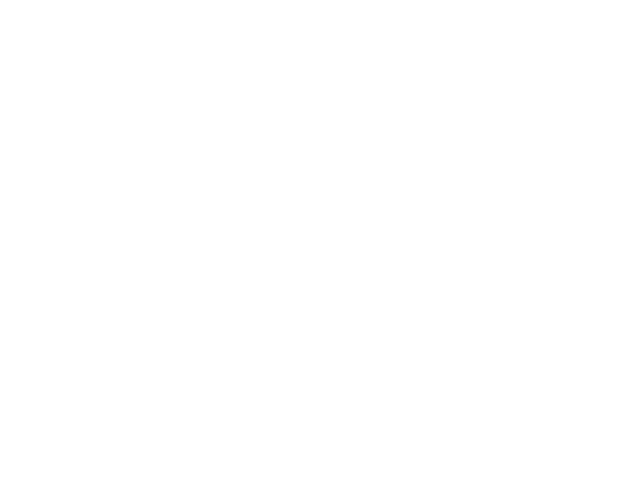

Chosen 35031
Predict is run


<IPython.core.display.Javascript object>


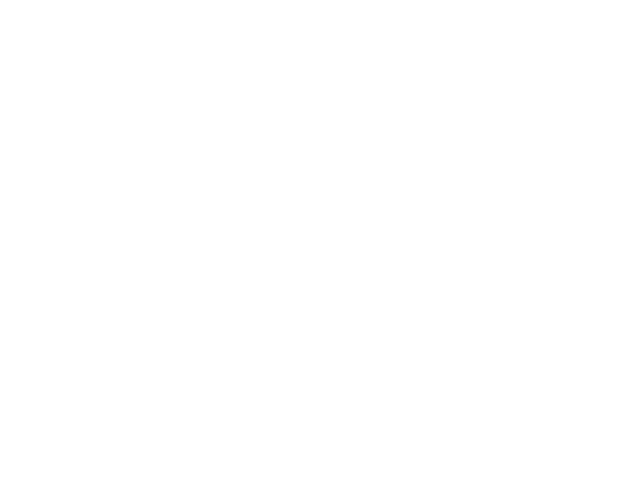

Sensor 35031
Errors:  43  ( 0.166023166023 )
BIC - raw: 192.804972402  BIC - clean: 176.797641394


<IPython.core.display.Javascript object>


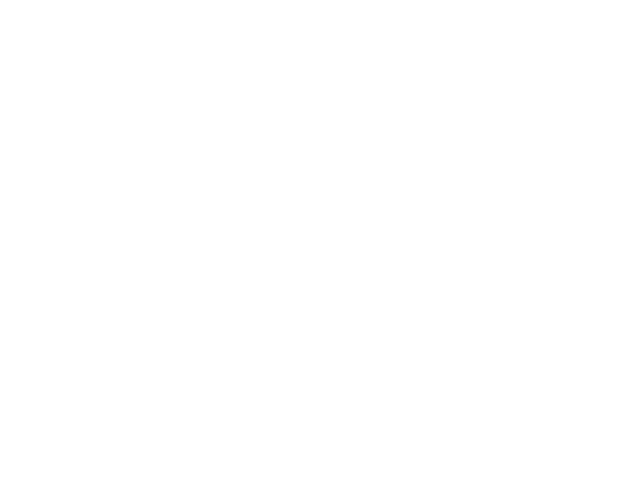

Chosen 35046
Predict is run


<IPython.core.display.Javascript object>


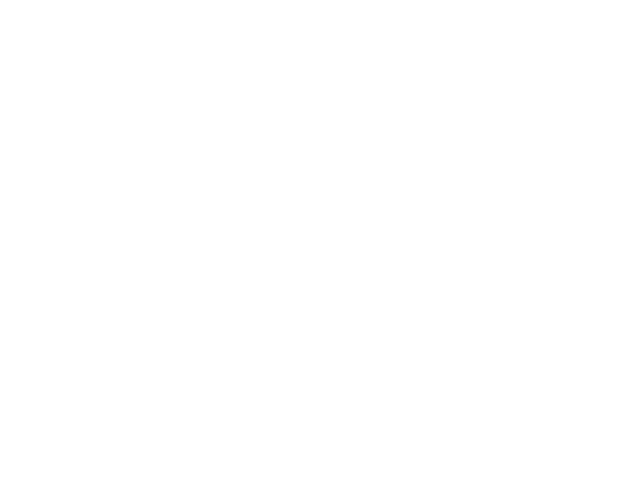

Sensor 35046
Errors:  14  ( 0.0154355016538 )
BIC - raw: -3093.91228744  BIC - clean: -2260.57224761


<IPython.core.display.Javascript object>


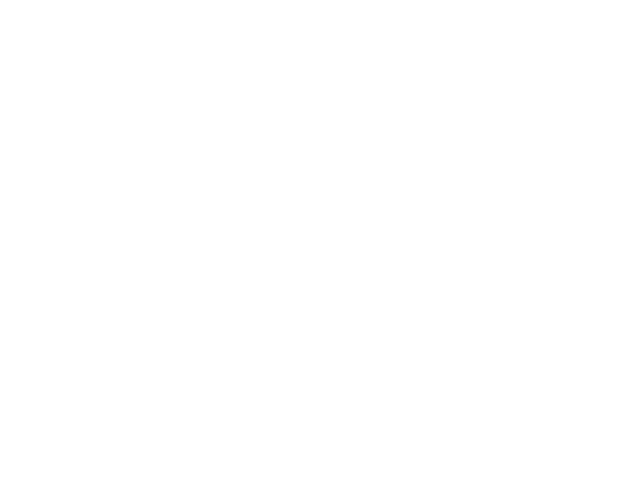

Chosen 20041
Predict is run


<IPython.core.display.Javascript object>


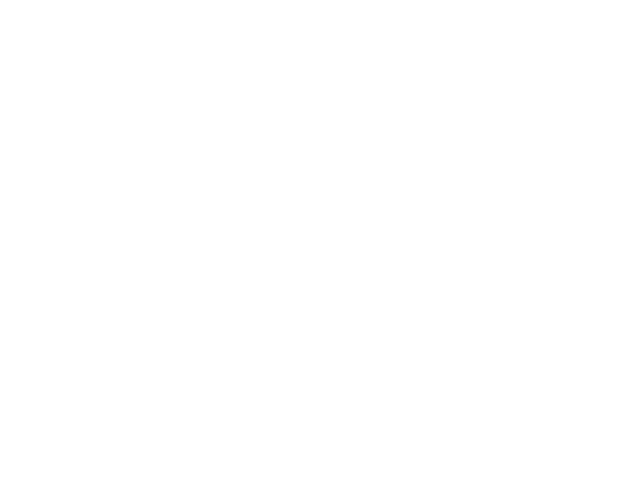

Sensor 20041
Errors:  7  ( 0.00421179302046 )
BIC - raw: -11076.8843251  BIC - clean: -11076.8843251


<IPython.core.display.Javascript object>


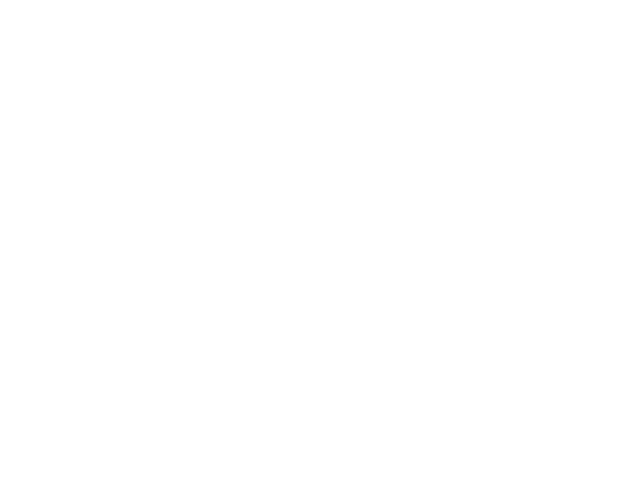

Chosen 80071
Predict is run


<IPython.core.display.Javascript object>


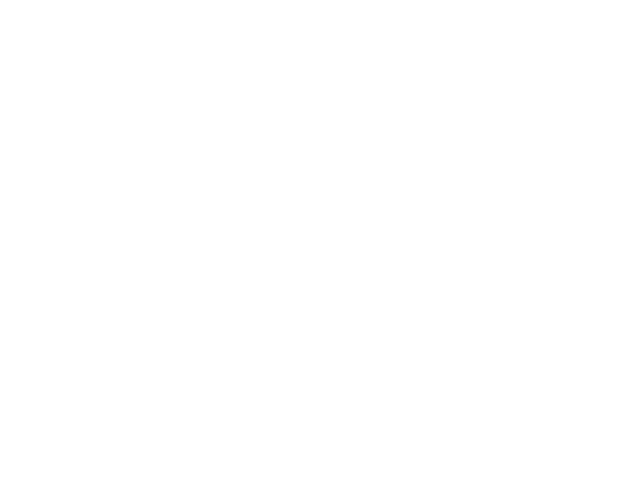

Sensor 80071
Errors:  13  ( 0.0228873239437 )
BIC - raw: -1158.7520735  BIC - clean: -937.225700345


<IPython.core.display.Javascript object>


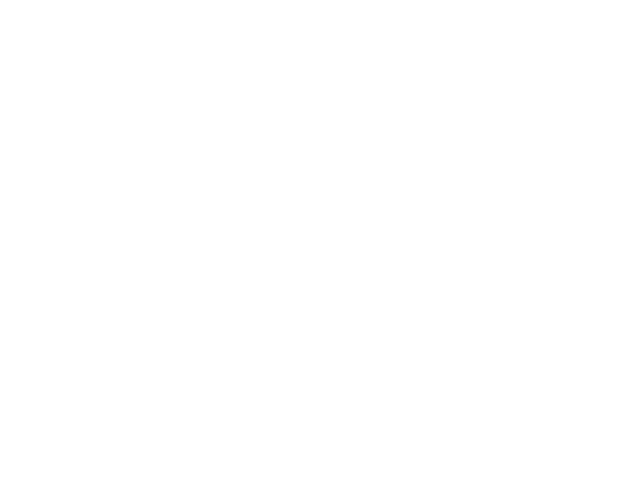

Chosen 10078
Predict is run


<IPython.core.display.Javascript object>


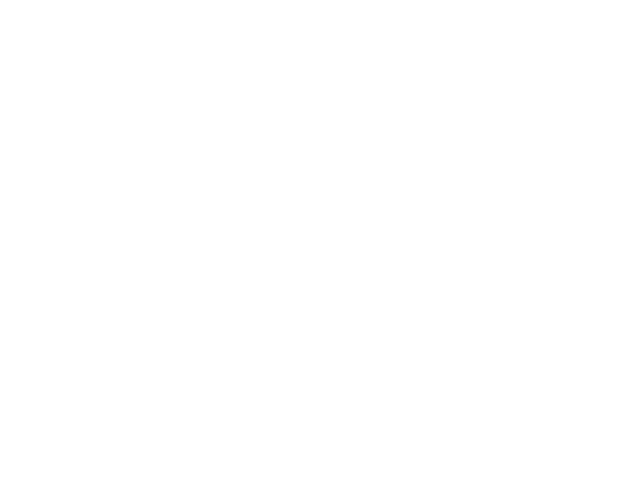

Sensor 10078
Errors:  12  ( 0.0552995391705 )
BIC - raw: 3534.19061269  BIC - clean: 350.548774108


<IPython.core.display.Javascript object>


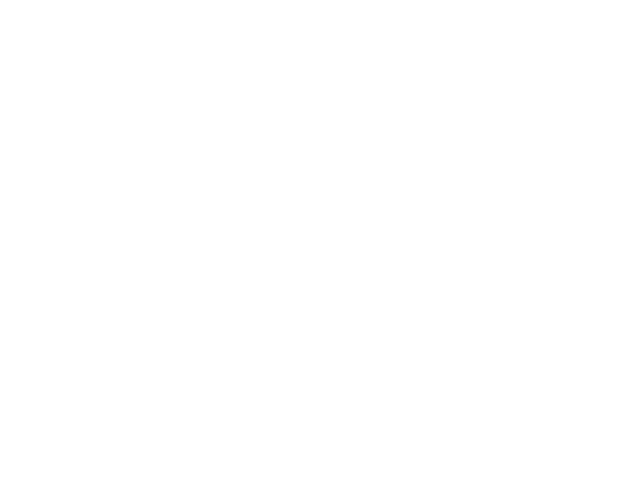

<class 'KeyError'>
('Value',)
Chosen 10019
Predict is run


<IPython.core.display.Javascript object>


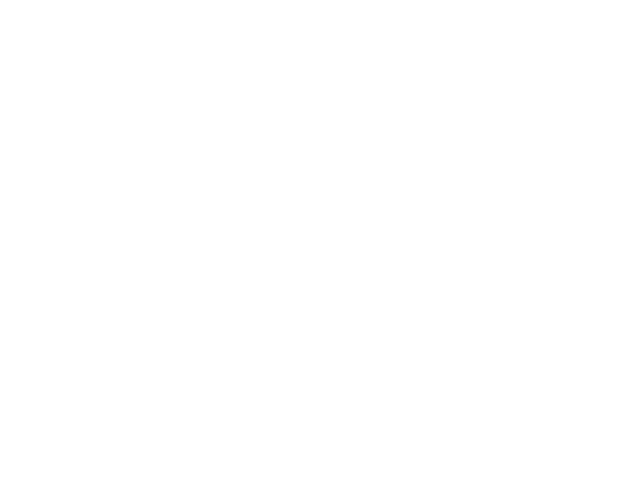

Sensor 10019
Errors:  14  ( 0.0648148148148 )
BIC - raw: -74.7695008899  BIC - clean: -83.1613301895


<IPython.core.display.Javascript object>


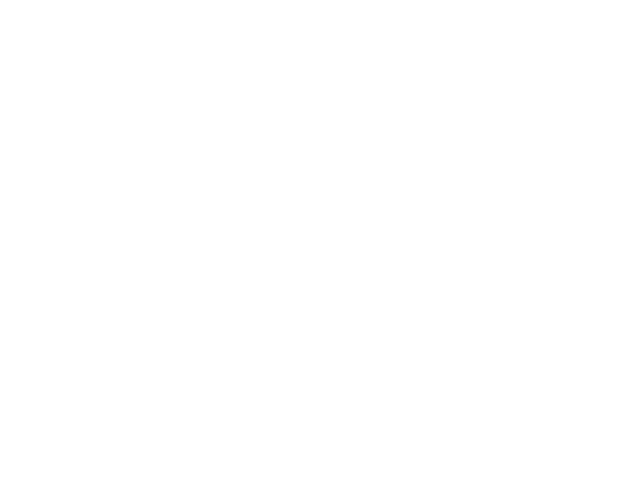

Chosen 65053
Predict is run


<IPython.core.display.Javascript object>


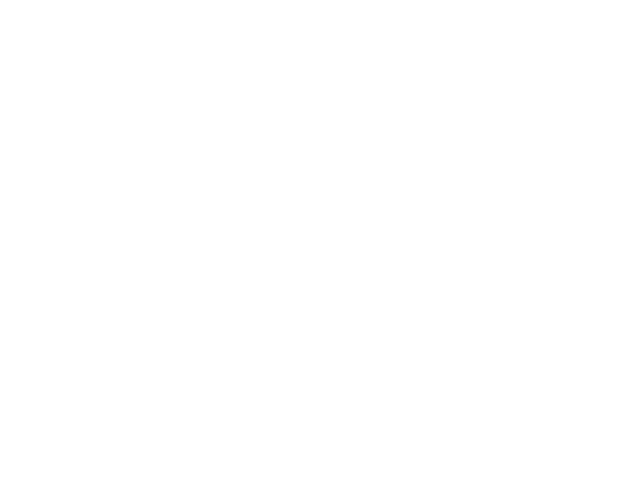

Sensor 65053
Errors:  5  ( 0.00683994528044 )
BIC - raw: -3663.62373099  BIC - clean: -3663.62373099


<IPython.core.display.Javascript object>


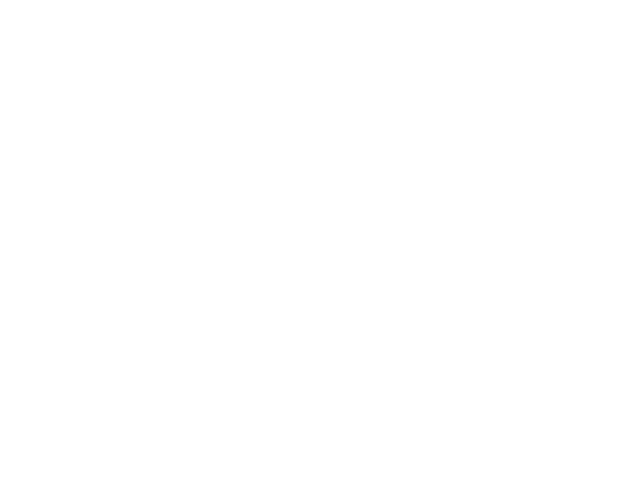

Chosen 90051
Predict is run


<IPython.core.display.Javascript object>


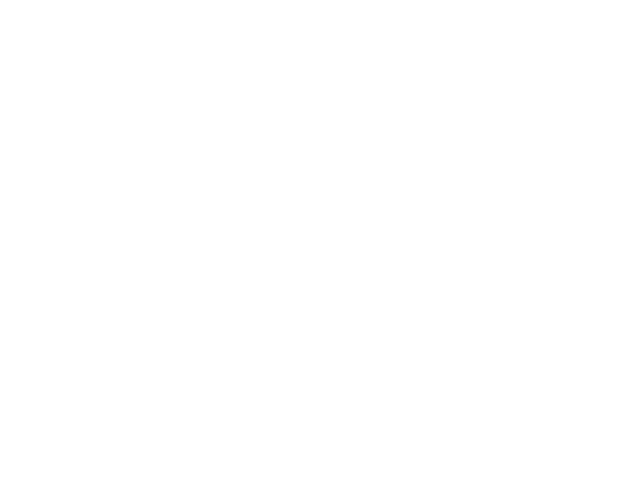

Sensor 90051
Errors:  11  ( 0.00407407407407 )
BIC - raw: -12661.5283174  BIC - clean: -11112.3536863


<IPython.core.display.Javascript object>


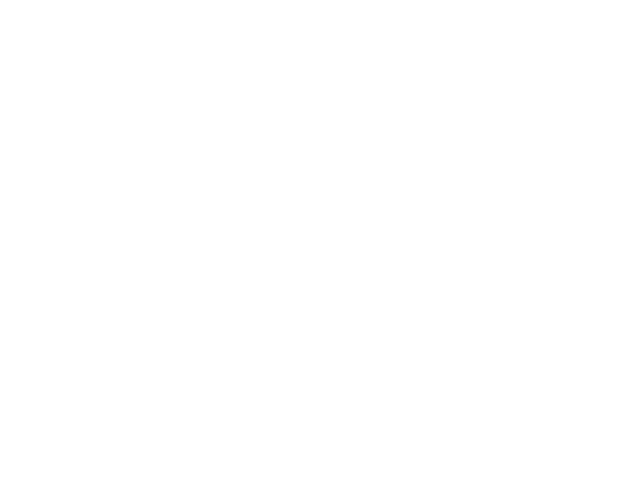

Chosen 10016
Predict is run


<IPython.core.display.Javascript object>


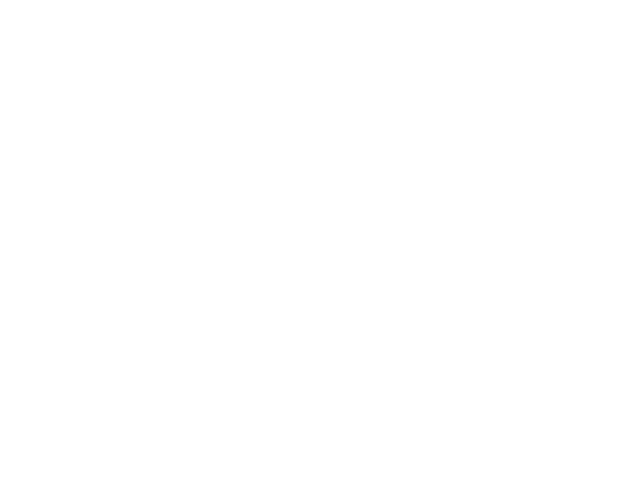

Sensor 10016
Errors:  5  ( 0.0232558139535 )
BIC - raw: 3243.57547741  BIC - clean: 223.088977888


<IPython.core.display.Javascript object>


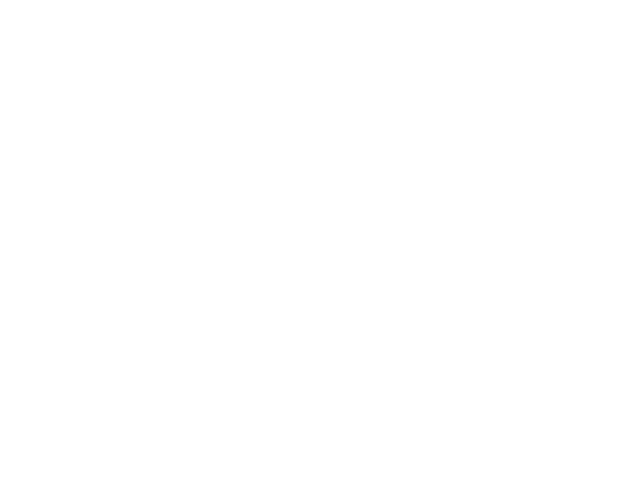

Chosen 10084
Predict is run


<IPython.core.display.Javascript object>


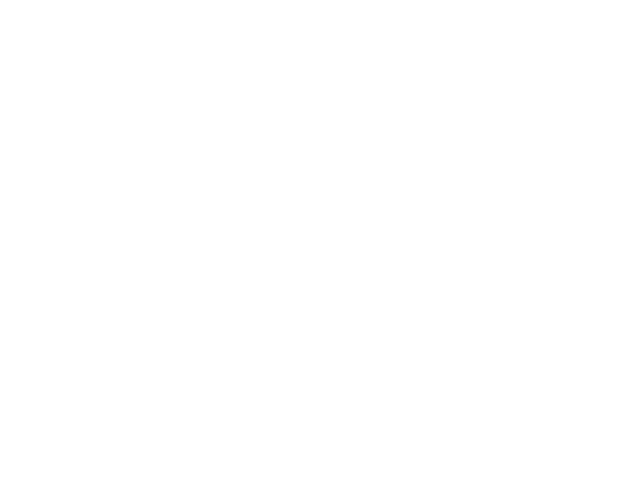

Sensor 10084
Errors:  10  ( 0.0833333333333 )
BIC - raw: -9.995359721  BIC - clean: -0.106188424291


<IPython.core.display.Javascript object>


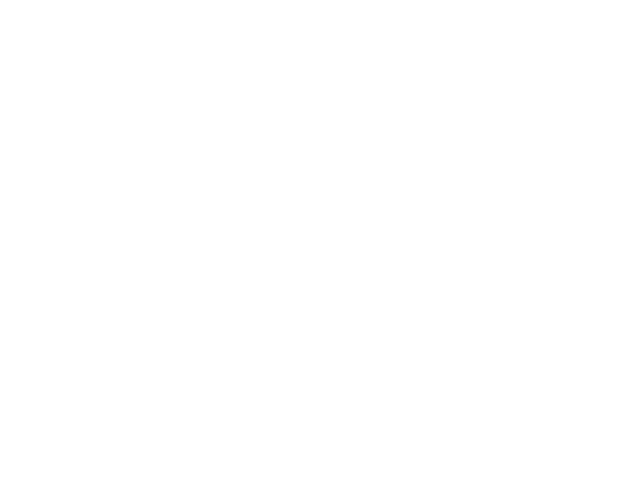

<class 'KeyError'>
('Value',)
<class 'KeyError'>
('Value',)
Chosen 20095
Predict is run


<IPython.core.display.Javascript object>


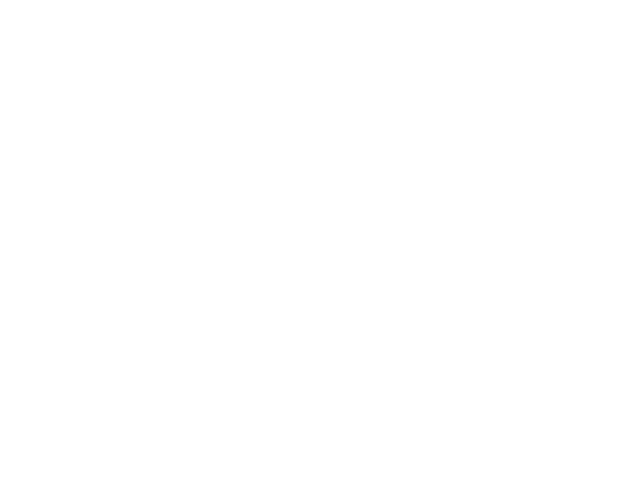

Sensor 20095
Errors:  94  ( 0.111506524318 )
BIC - raw: 2283.81324547  BIC - clean: 2524.00424541


<IPython.core.display.Javascript object>


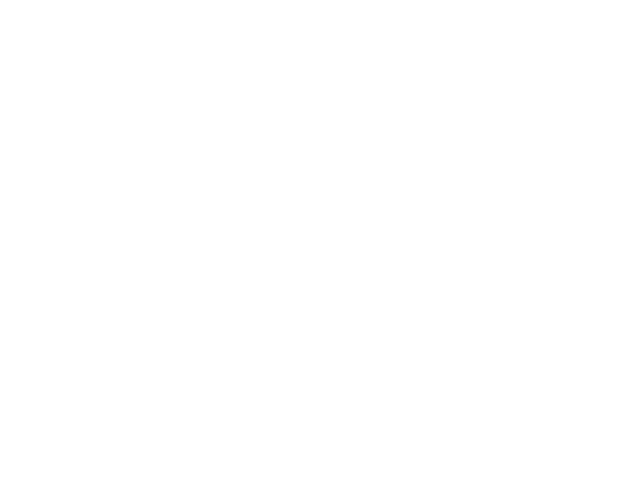

Chosen 35101
Predict is run


<IPython.core.display.Javascript object>


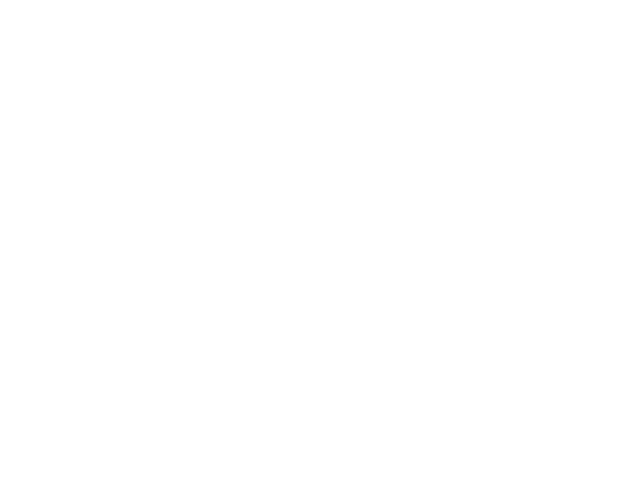

Sensor 35101
Errors:  85  ( 0.0793650793651 )
BIC - raw: 679.362466842  BIC - clean: 589.763184529


<IPython.core.display.Javascript object>


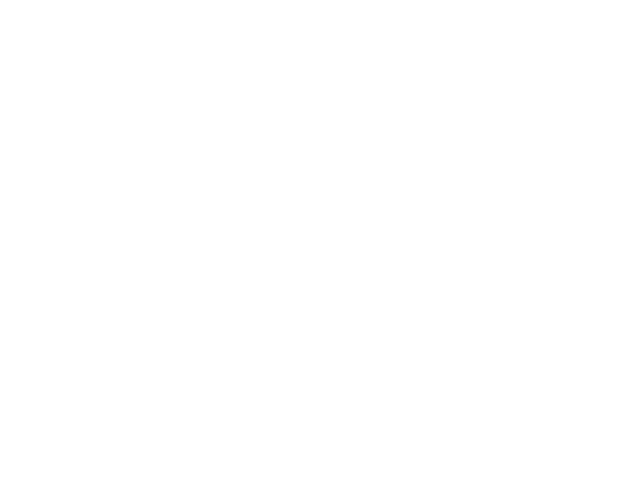

Chosen 10013
Predict is run


<IPython.core.display.Javascript object>


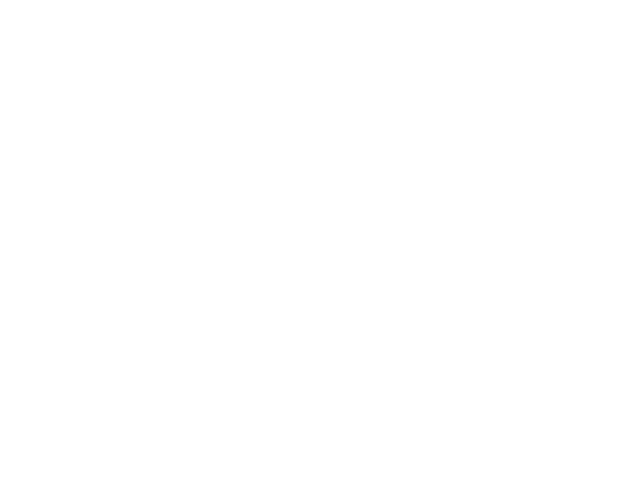

Sensor 10013
Errors:  22  ( 0.122222222222 )
BIC - raw: -8.49003436715  BIC - clean: -27.5056889597


<IPython.core.display.Javascript object>


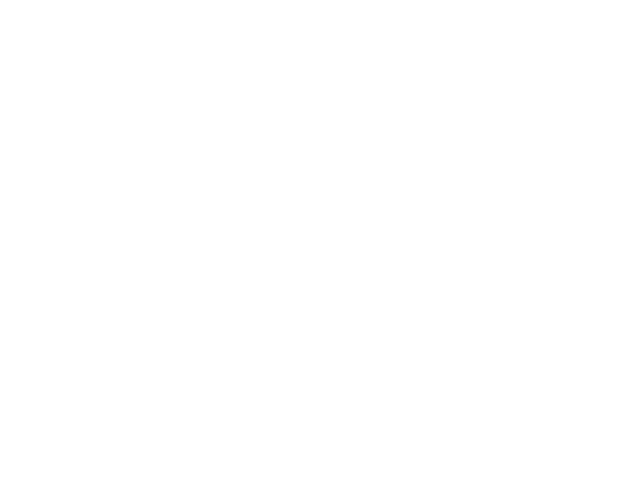

<class 'KeyError'>
('Value',)
Chosen 10102
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
<class 'KeyError'>
('Value',)
Chosen 65055
Predict is run


<IPython.core.display.Javascript object>


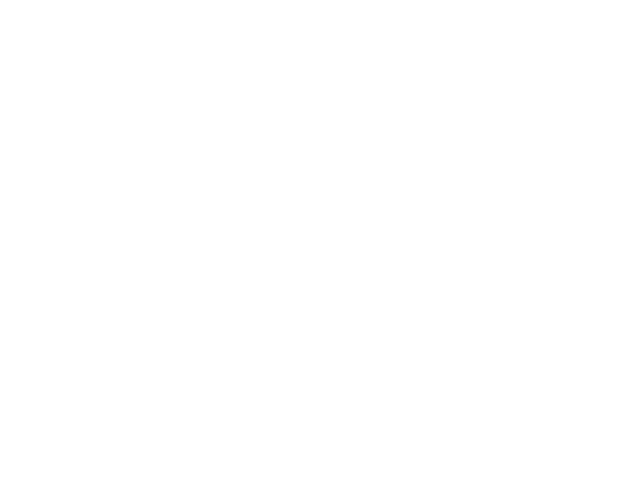

Sensor 65055
Errors:  212  ( 0.033523086654 )
BIC - raw: -12185.7665165  BIC - clean: -6194.99177176


<IPython.core.display.Javascript object>


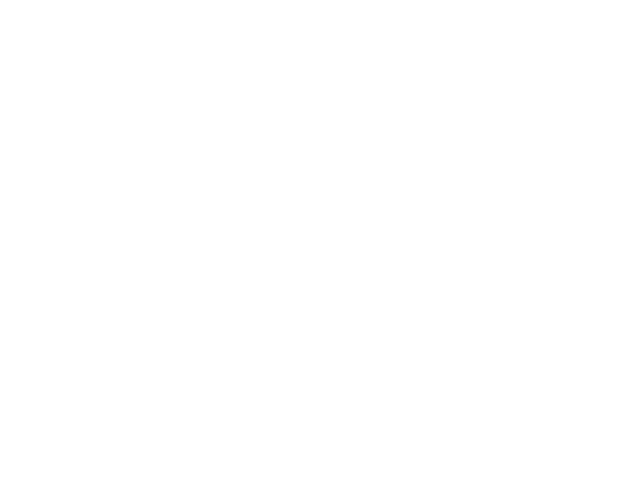

Chosen 20066
Predict is run


<IPython.core.display.Javascript object>


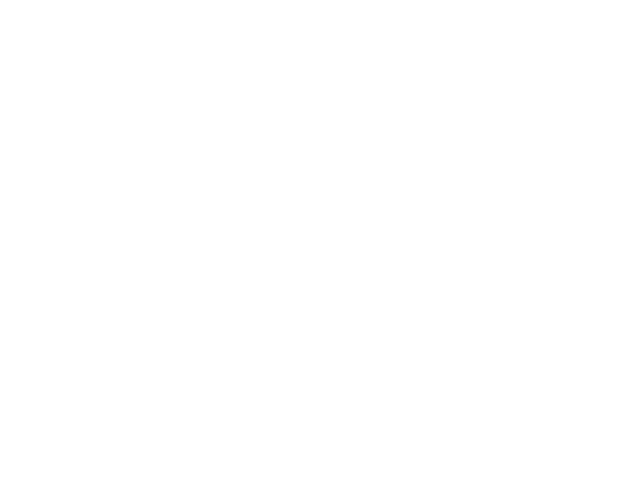

Sensor 20066
Errors:  9  ( 0.00205291970803 )
BIC - raw: -23421.9226407  BIC - clean: -22618.0974994


<IPython.core.display.Javascript object>


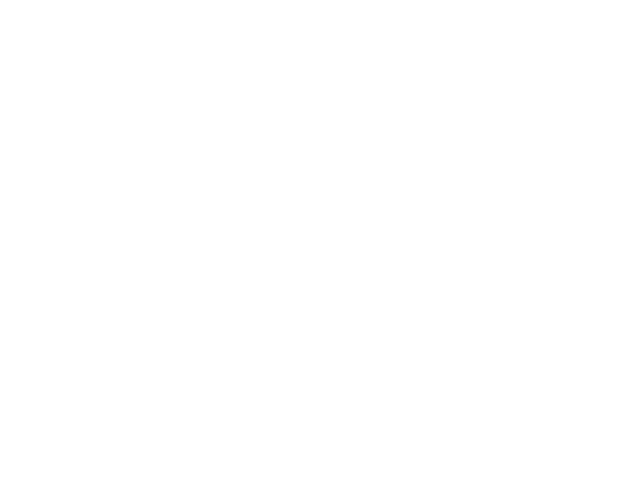

Chosen 30180
Predict is run


<IPython.core.display.Javascript object>


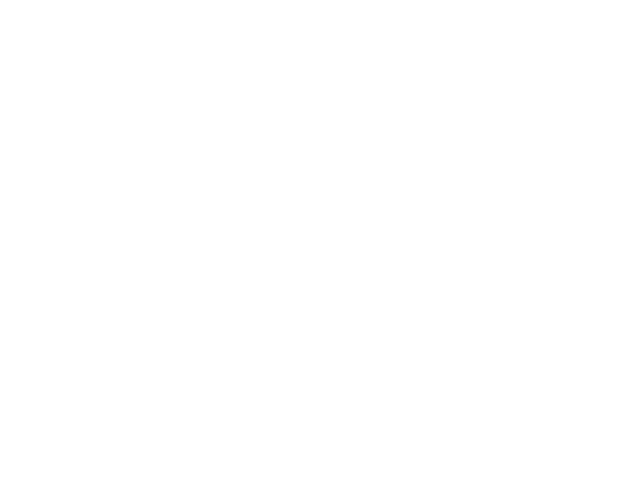

Sensor 30180
Errors:  16  ( 0.111888111888 )
BIC - raw: 51.7610470113  BIC - clean: 59.6807299377


<IPython.core.display.Javascript object>


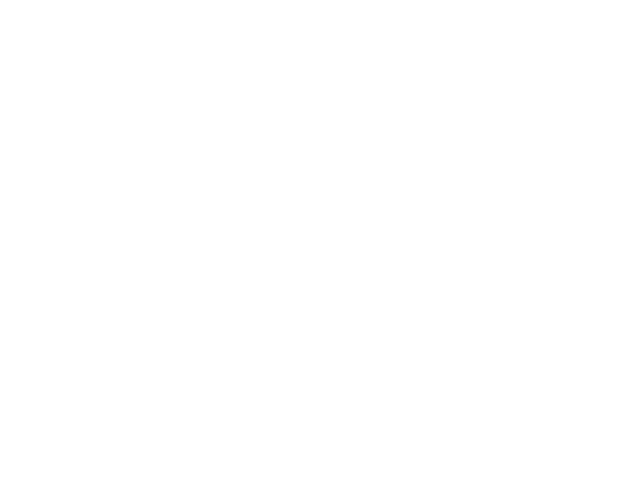

Chosen 40105
Predict is run


<IPython.core.display.Javascript object>


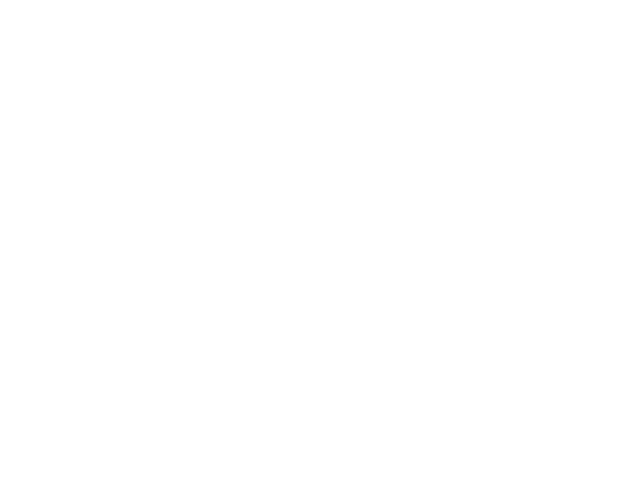

Sensor 40105
Errors:  38  ( 0.176744186047 )
BIC - raw: 512.86953711  BIC - clean: 502.937312803


<IPython.core.display.Javascript object>


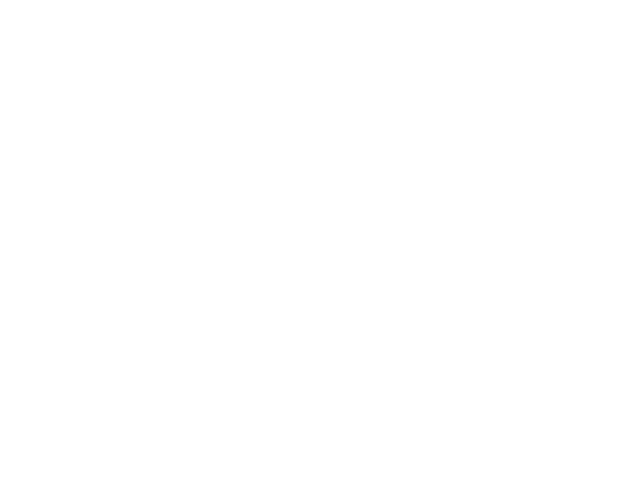

<class 'KeyError'>
('Value',)
Chosen 20065
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 10004
Predict is run


<IPython.core.display.Javascript object>


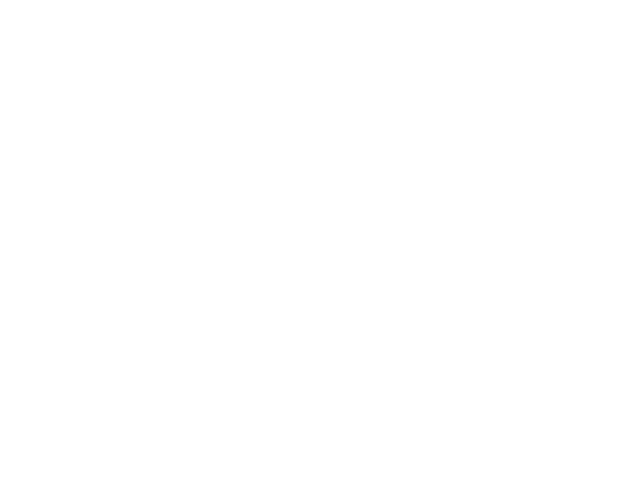

Sensor 10004
Errors:  4  ( 0.0185185185185 )
BIC - raw: 3382.03644075  BIC - clean: 69.5581274354


<IPython.core.display.Javascript object>


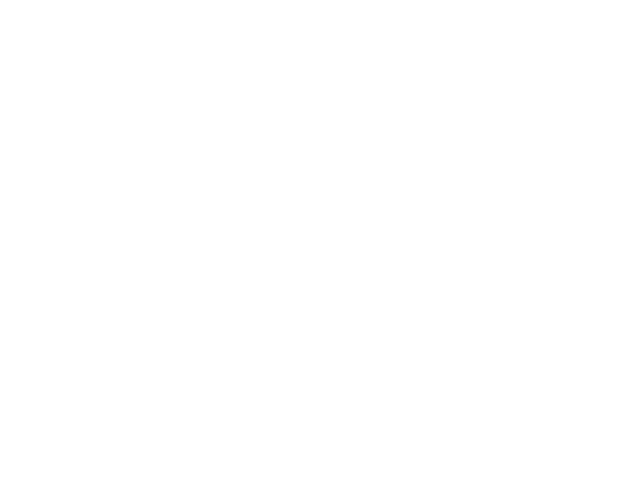

Chosen 10029
Predict is run


<IPython.core.display.Javascript object>


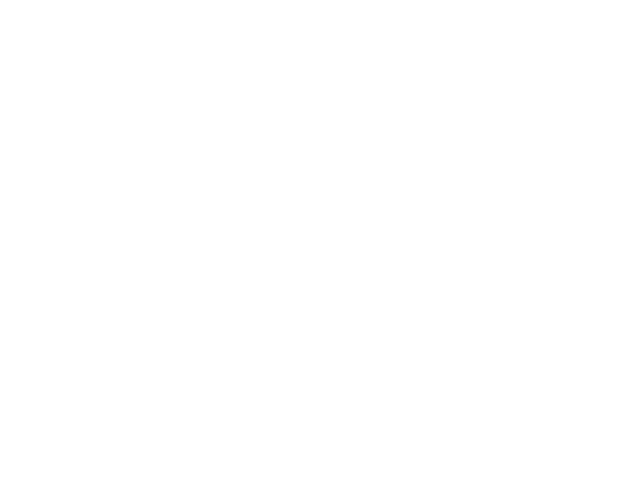

Sensor 10029
Errors:  11  ( 0.0723684210526 )
BIC - raw: 2386.10698417  BIC - clean: 2247.4803596


<IPython.core.display.Javascript object>


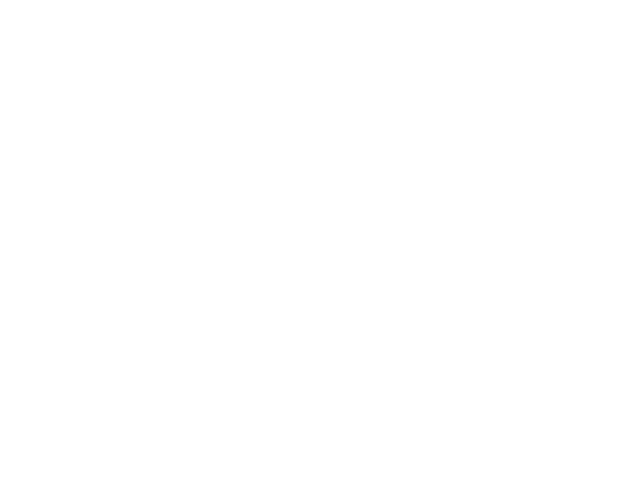

Chosen 70025
Predict is run


<IPython.core.display.Javascript object>


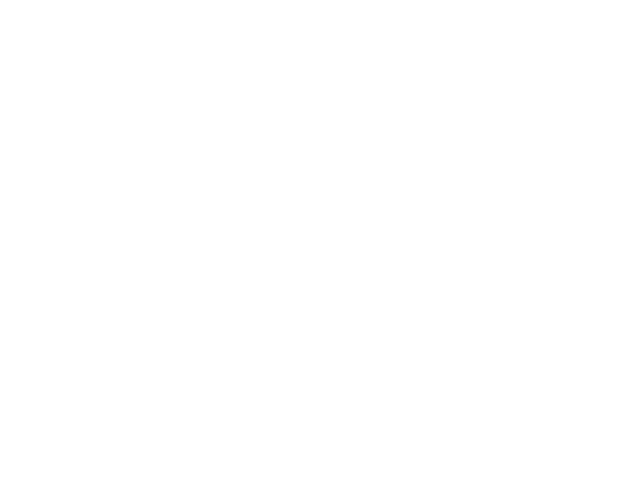

Sensor 70025
Errors:  29  ( 0.0031556039173 )
BIC - raw: 123363.547921  BIC - clean: 122745.365818


<IPython.core.display.Javascript object>


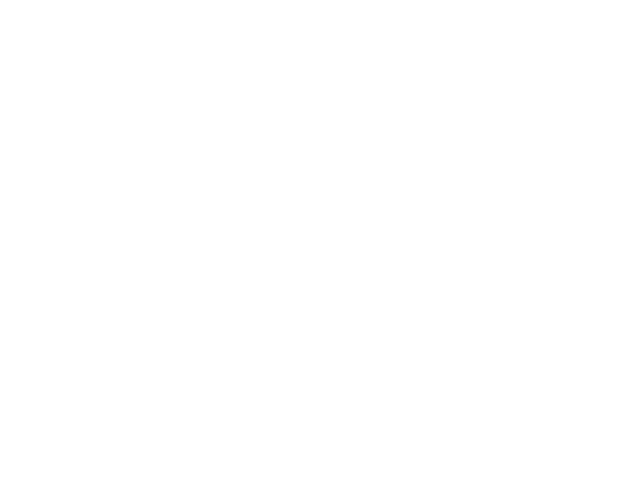

Chosen 25035
Predict is run


<IPython.core.display.Javascript object>


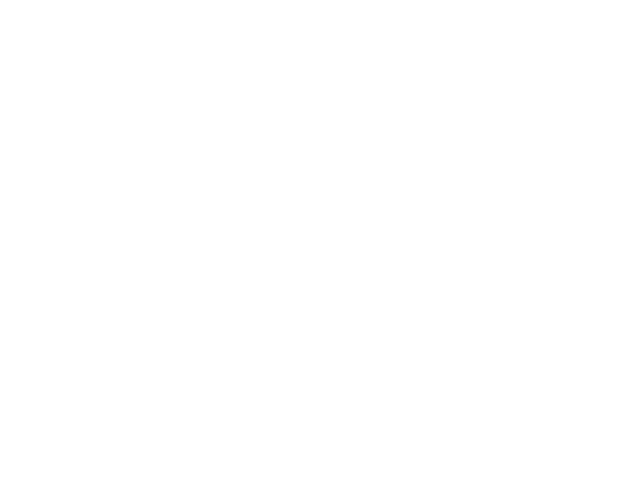

Sensor 25035
Errors:  9  ( 0.166666666667 )
BIC - raw: 71.8835765694  BIC - clean: 48.003356452


<IPython.core.display.Javascript object>


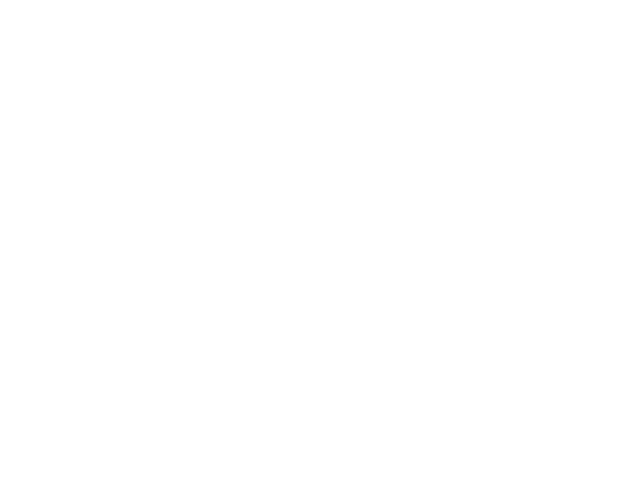

Chosen 65048
Predict is run


<IPython.core.display.Javascript object>


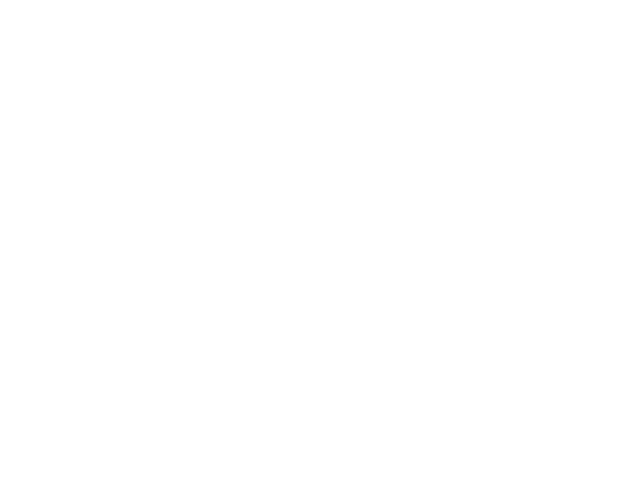

Sensor 65048
Errors:  2  ( 0.0392156862745 )
BIC - raw: 9.84299567943  BIC - clean: 9.84299567943


<IPython.core.display.Javascript object>


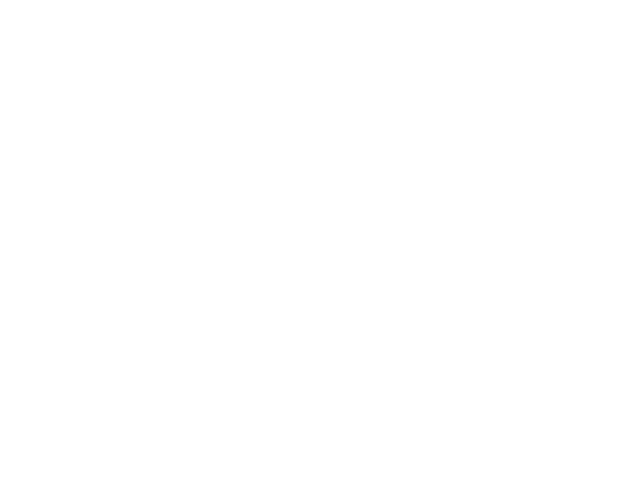

Chosen 80085
Predict is run


<IPython.core.display.Javascript object>


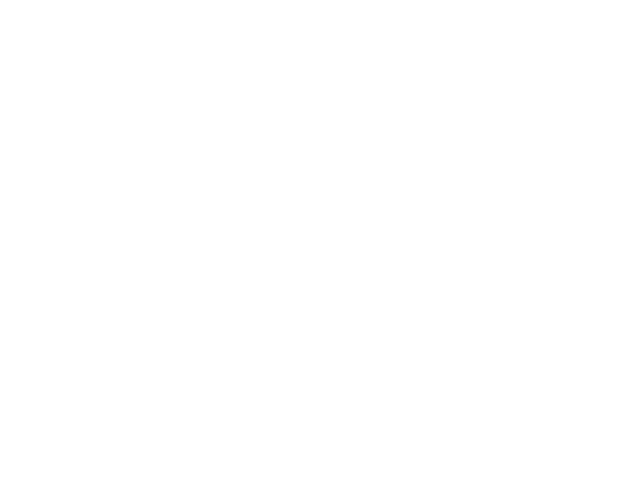

Sensor 80085
Errors:  130  ( 0.0168590325509 )
BIC - raw: -21879.357986  BIC - clean: -19487.3228523


<IPython.core.display.Javascript object>


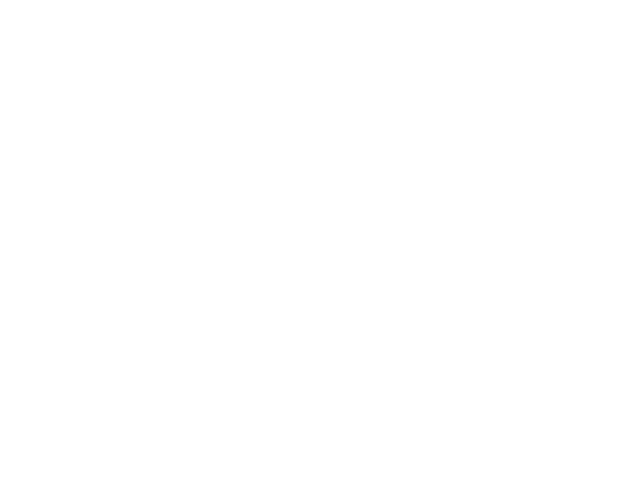

Chosen 90007
Predict is run


<IPython.core.display.Javascript object>


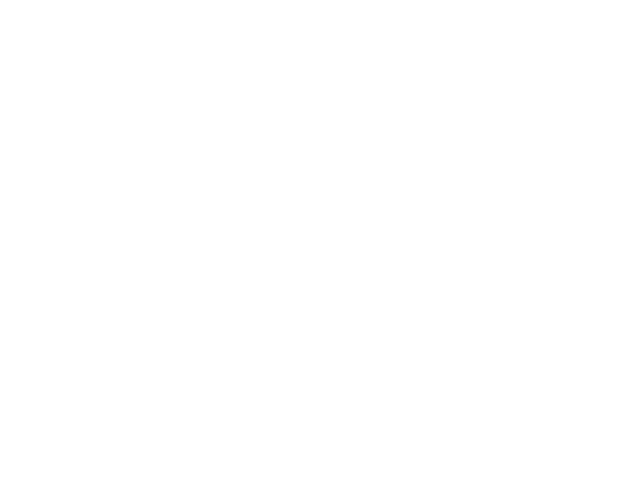

Sensor 90007
Errors:  5  ( 0.0347222222222 )
BIC - raw: -96.0447805519  BIC - clean: -101.396815535


<IPython.core.display.Javascript object>


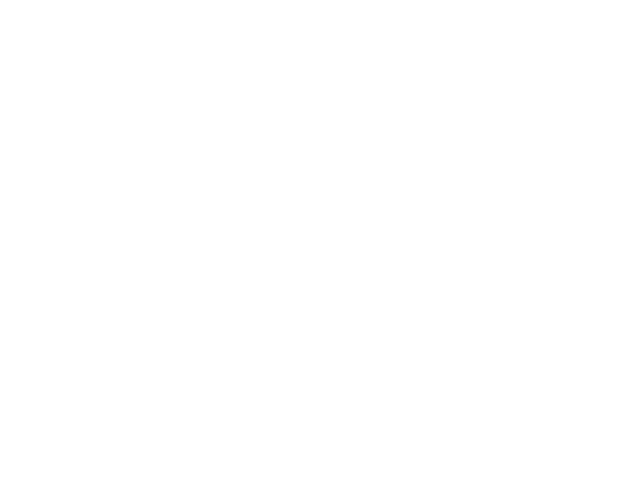

Chosen 10036
Predict is run


<IPython.core.display.Javascript object>


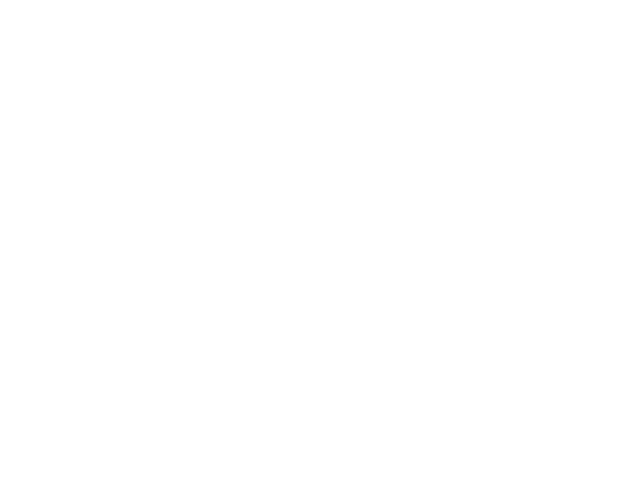

Sensor 10036
Errors:  12  ( 0.00713012477718 )
BIC - raw: -6977.29411909  BIC - clean: -5882.1092674


<IPython.core.display.Javascript object>


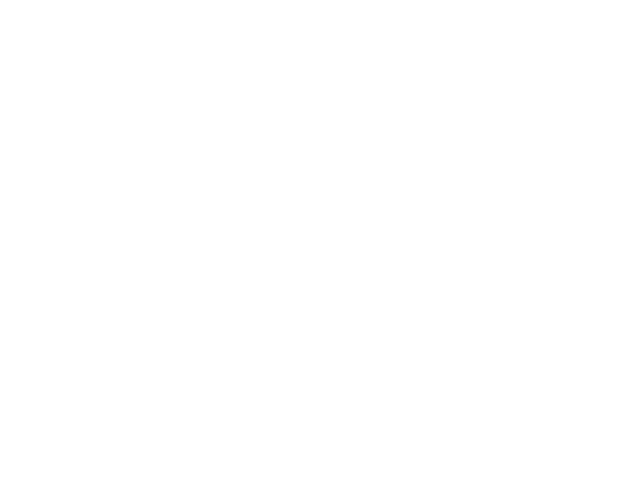

Chosen 10071
Predict is run


<IPython.core.display.Javascript object>


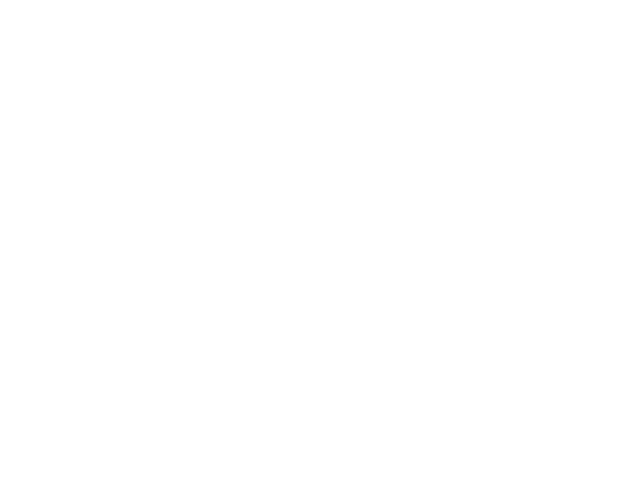

Sensor 10071
Errors:  43  ( 0.208737864078 )
BIC - raw: 3474.68287351  BIC - clean: 3434.34004681


<IPython.core.display.Javascript object>


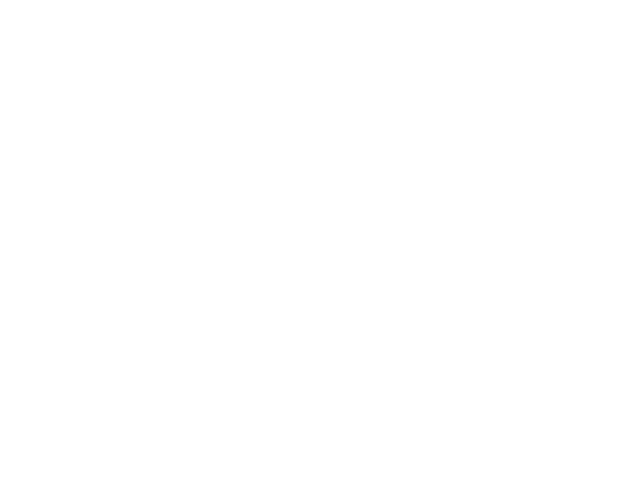

<class 'KeyError'>
('Value',)
Chosen 30183
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 10068
Predict is run


<IPython.core.display.Javascript object>


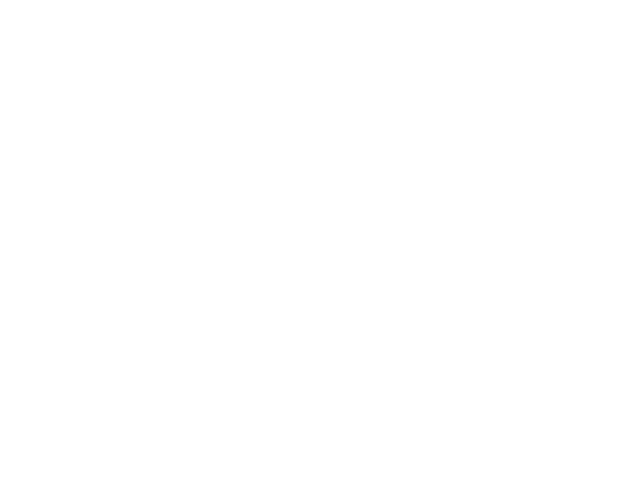

Sensor 10068
Errors:  11  ( 0.015047879617 )
BIC - raw: -2235.19921149  BIC - clean: -1732.18690044


<IPython.core.display.Javascript object>


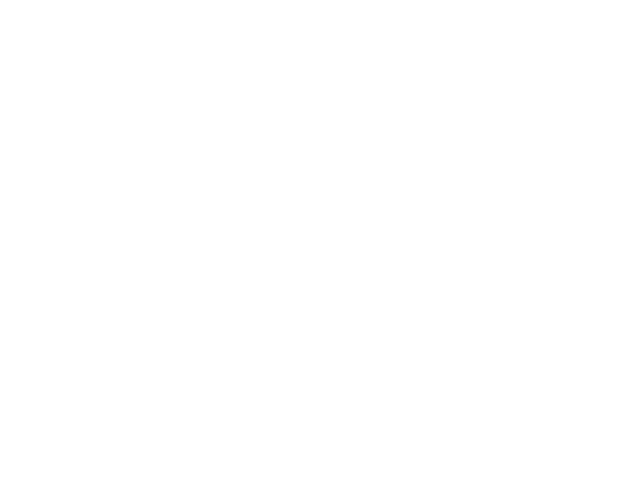

Chosen 10101
Predict is run


<IPython.core.display.Javascript object>


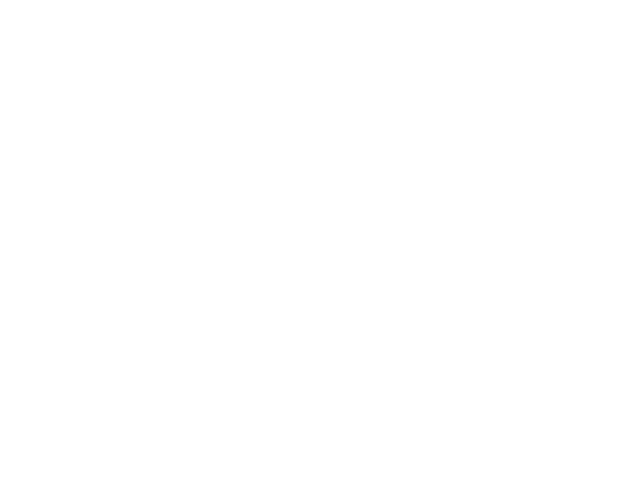

Sensor 10101
Errors:  18  ( 0.0267857142857 )
BIC - raw: -1454.74503938  BIC - clean: -1064.36421138


<IPython.core.display.Javascript object>


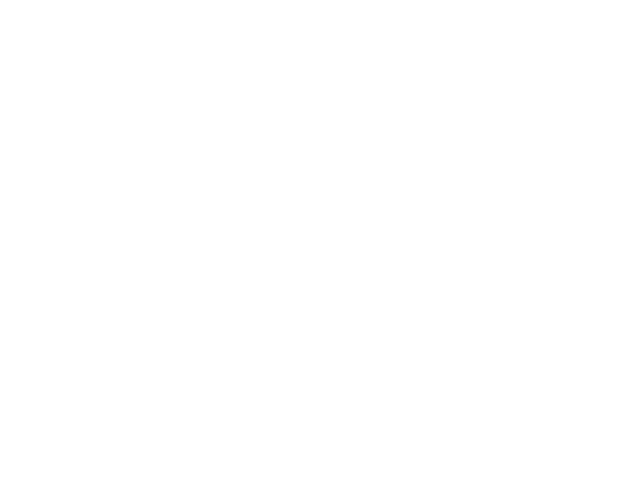

Chosen 40070
Predict is run


<IPython.core.display.Javascript object>


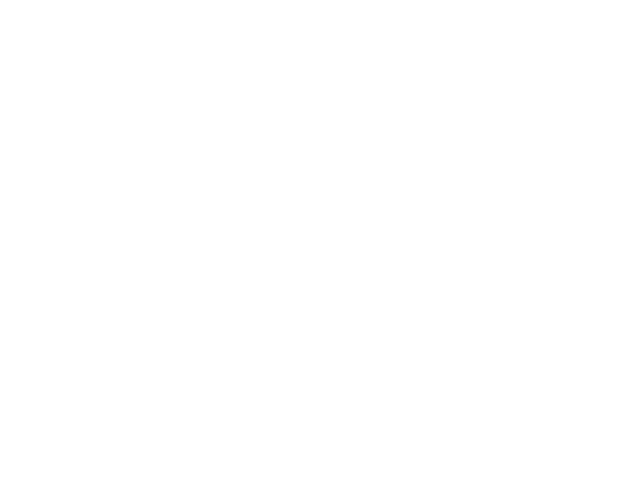

Sensor 40070
Errors:  74  ( 0.0879904875149 )
BIC - raw: -736.148133168  BIC - clean: -488.516247803


<IPython.core.display.Javascript object>


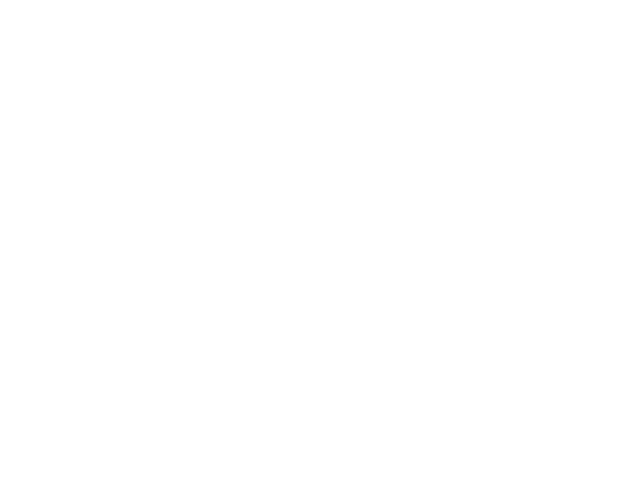

Chosen 65070
Predict is run


<IPython.core.display.Javascript object>


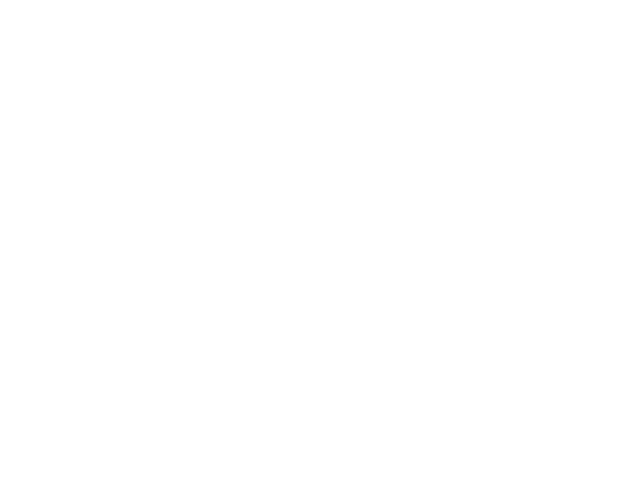

Sensor 65070
Errors:  11  ( 0.0733333333333 )
BIC - raw: 11.5079226965  BIC - clean: -39.9663822788


<IPython.core.display.Javascript object>


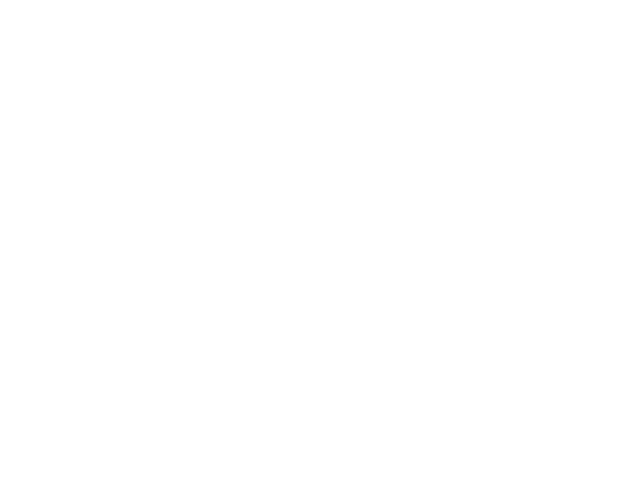

<class 'KeyError'>
('Value',)
Chosen 65030
Predict is run


<IPython.core.display.Javascript object>


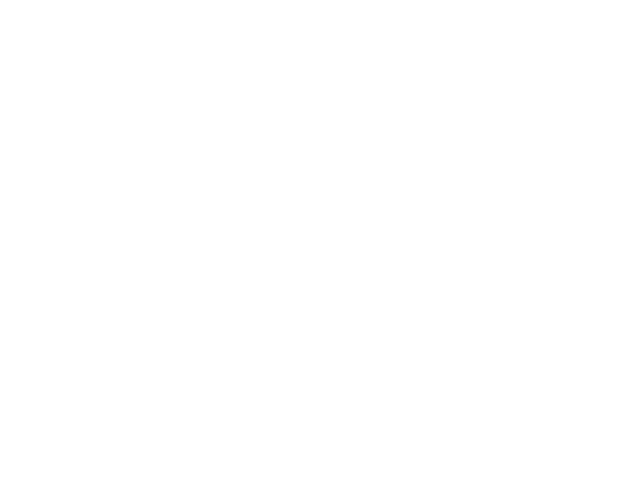

Sensor 65030
Errors:  479  ( 0.0852161537093 )
BIC - raw: -3191.50223862  BIC - clean: 768.958080251


<IPython.core.display.Javascript object>


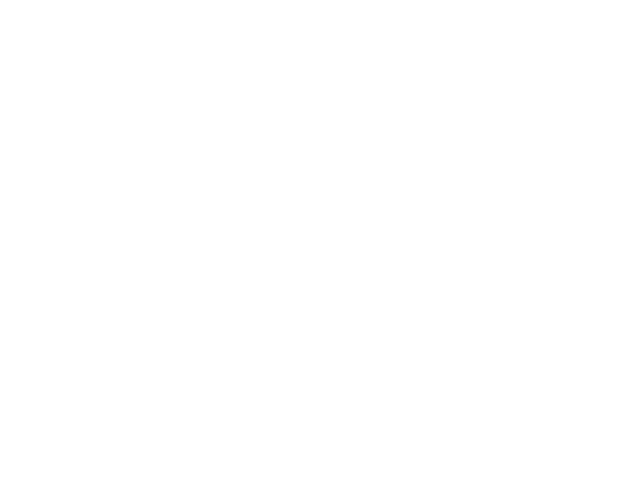

Chosen 10018
Predict is run


<IPython.core.display.Javascript object>


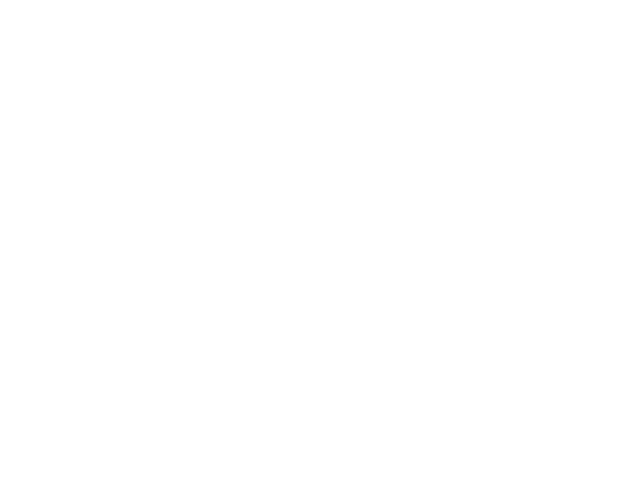

Sensor 10018
Errors:  41  ( 0.189814814815 )
BIC - raw: 117.534967328  BIC - clean: 190.382849739


<IPython.core.display.Javascript object>


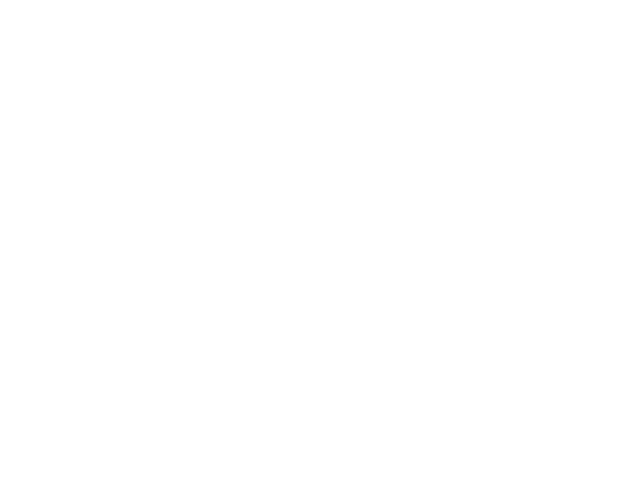

Chosen 10035
<class 'IndexError'>
('index 0 is out of bounds for axis 0 with size 0',)
Chosen 50013
Predict is run


<IPython.core.display.Javascript object>


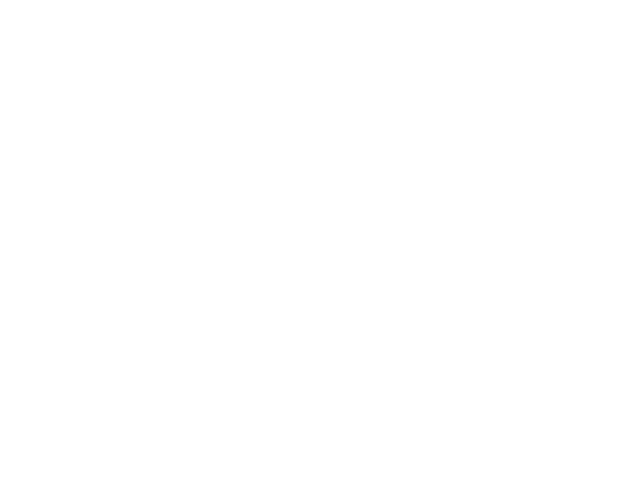

Sensor 50013
Errors:  6  ( 0.0130718954248 )
BIC - raw: -2885.13884923  BIC - clean: -2885.13884923


<IPython.core.display.Javascript object>


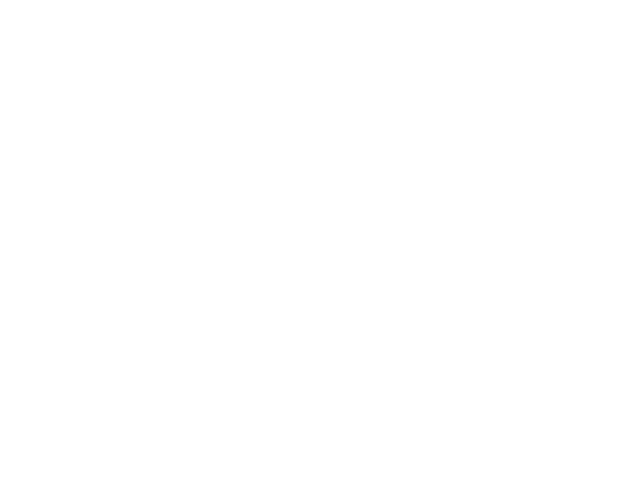

Chosen 95075
Predict is run


<IPython.core.display.Javascript object>


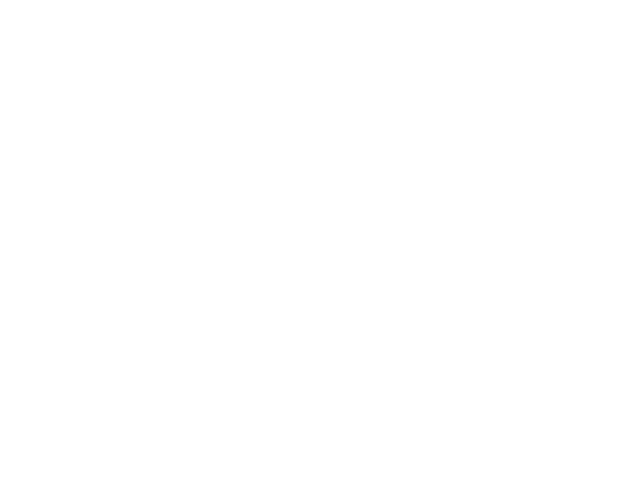

Sensor 95075
Errors:  121  ( 0.517094017094 )
BIC - raw: 865.898539608  BIC - clean: 903.09361551


<IPython.core.display.Javascript object>


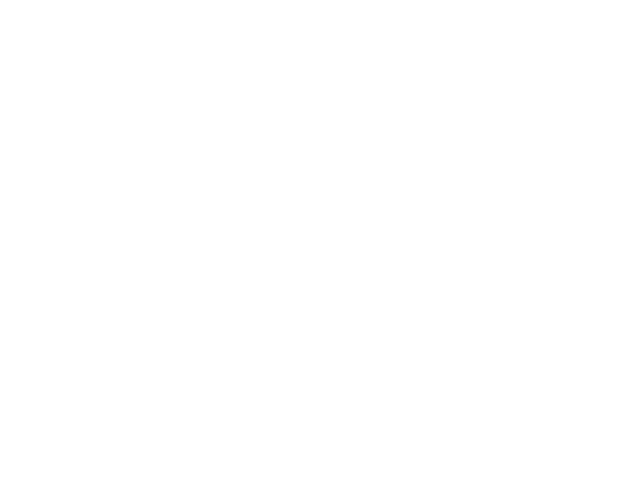

Chosen 10061
Predict is run


<IPython.core.display.Javascript object>


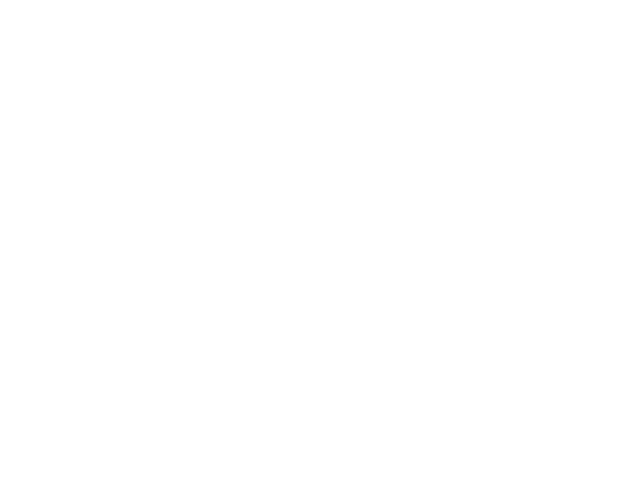

Sensor 10061
Errors:  29  ( 0.161111111111 )
BIC - raw: 128.074231867  BIC - clean: 173.721348759


<IPython.core.display.Javascript object>


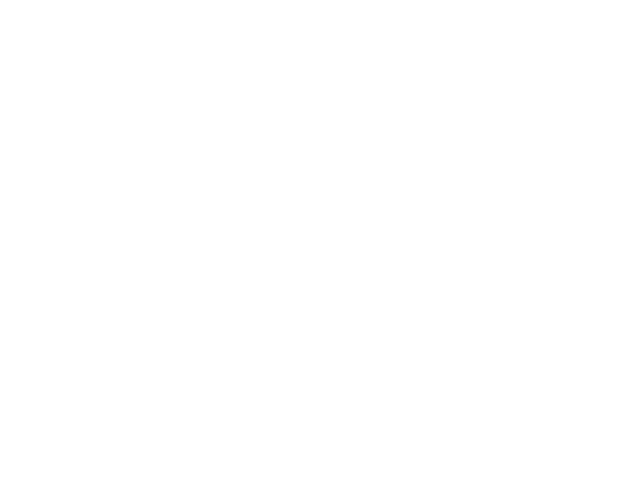

Chosen 90013
Predict is run


<IPython.core.display.Javascript object>


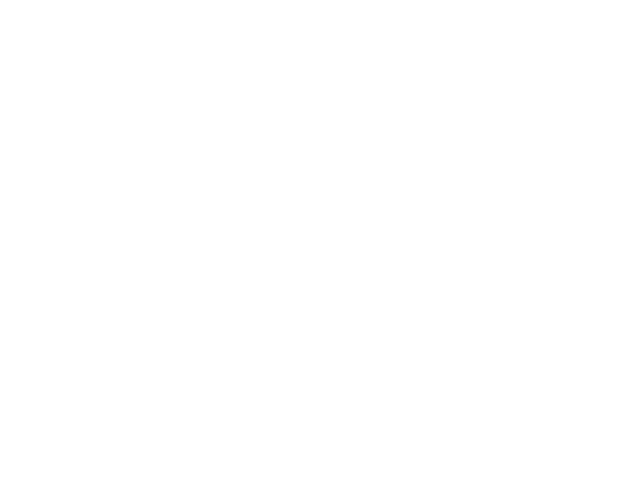

Sensor 90013
Errors:  24  ( 0.166666666667 )
BIC - raw: 176.850650727  BIC - clean: 138.709050905


<IPython.core.display.Javascript object>


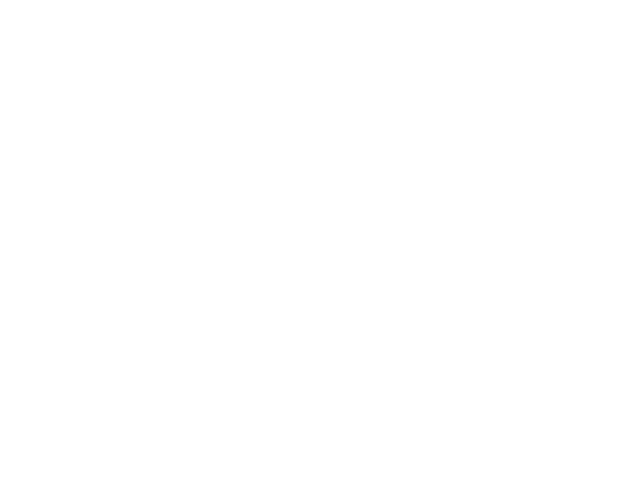

Chosen 30197
Predict is run


<IPython.core.display.Javascript object>


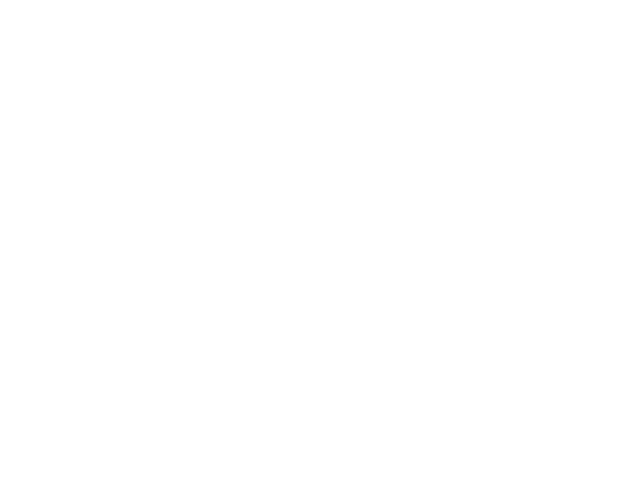

Sensor 30197
Errors:  19  ( 0.158333333333 )
BIC - raw: 117.986833722  BIC - clean: 88.6010259692


<IPython.core.display.Javascript object>


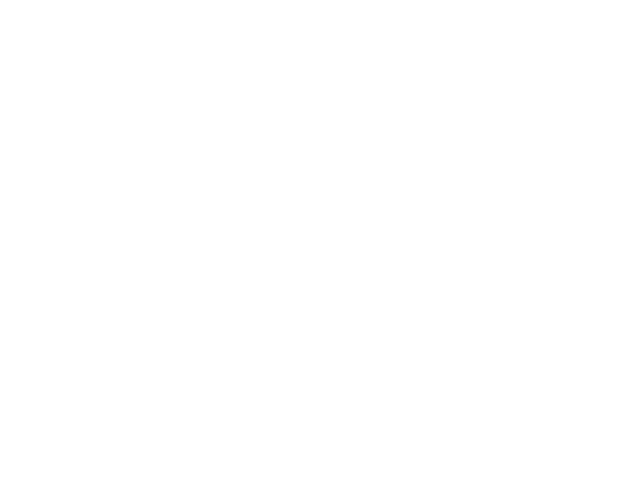

Chosen 85036
Predict is run


<IPython.core.display.Javascript object>


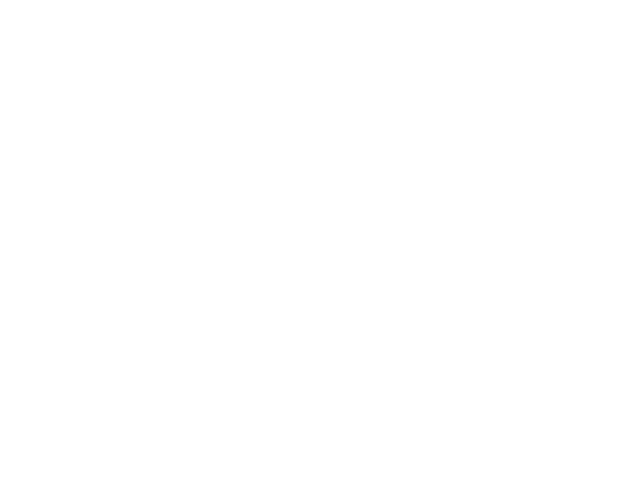

Sensor 85036
Errors:  12  ( 0.0528634361233 )
BIC - raw: -214.960386047  BIC - clean: -88.8649930177


<IPython.core.display.Javascript object>


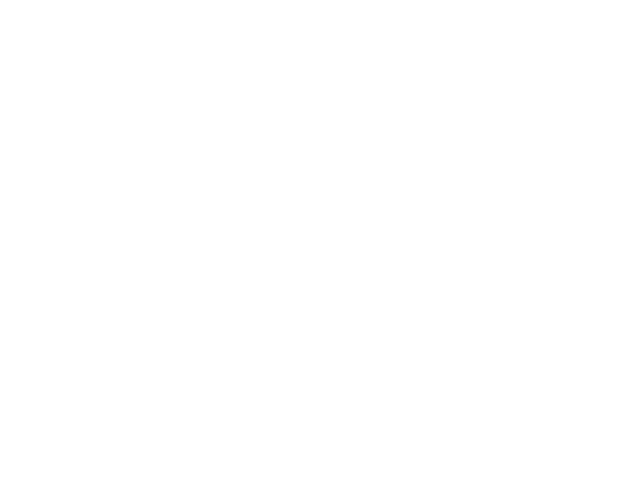

Chosen 10028
Predict is run


<IPython.core.display.Javascript object>


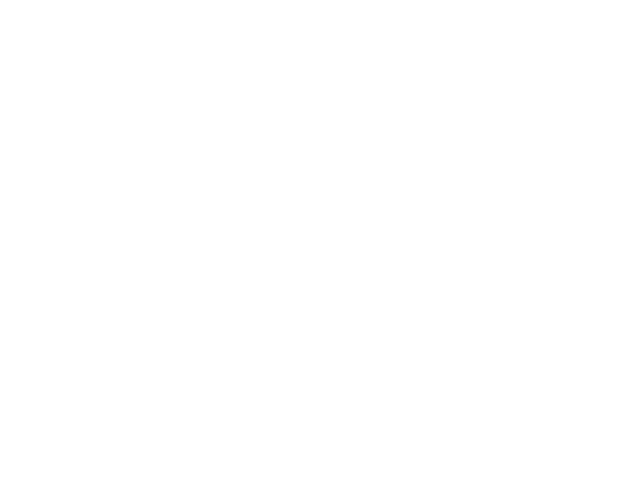

Sensor 10028
Errors:  38  ( 0.175925925926 )
BIC - raw: 170.938547932  BIC - clean: 183.173131334


<IPython.core.display.Javascript object>


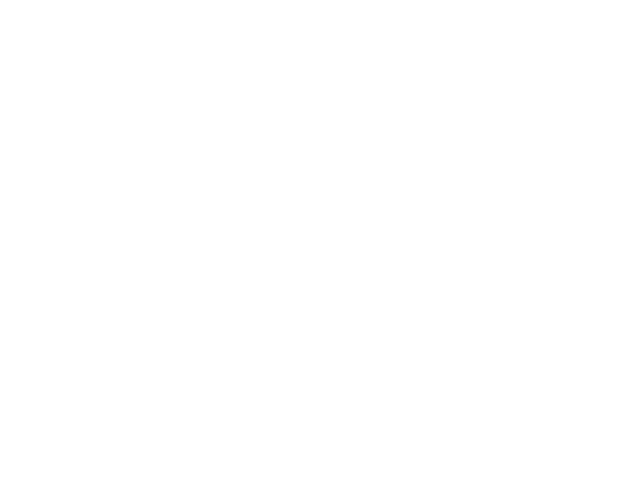

<class 'KeyError'>
('Value',)
Chosen 15045
Predict is run


<IPython.core.display.Javascript object>


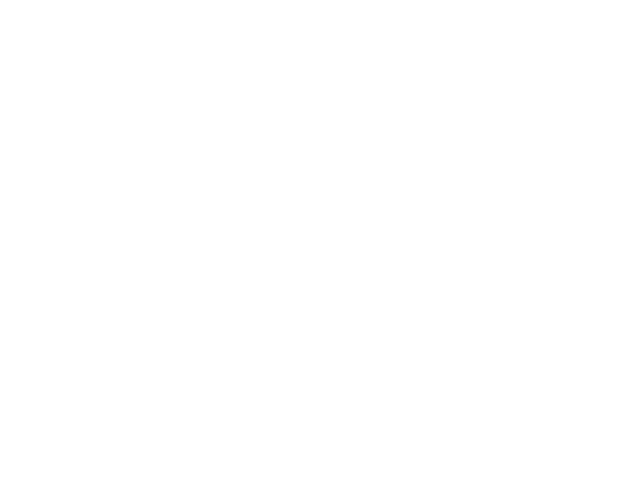

Sensor 15045
Errors:  8  ( 0.000822452965971 )
BIC - raw: -58206.6713462  BIC - clean: -57714.3763377


<IPython.core.display.Javascript object>


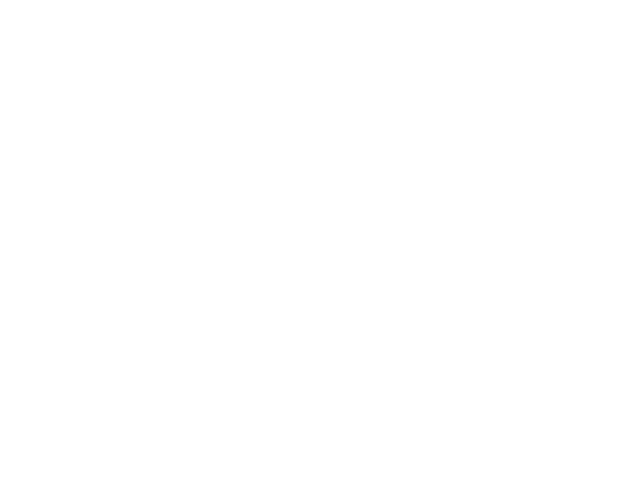

Chosen 30176
Predict is run


<IPython.core.display.Javascript object>


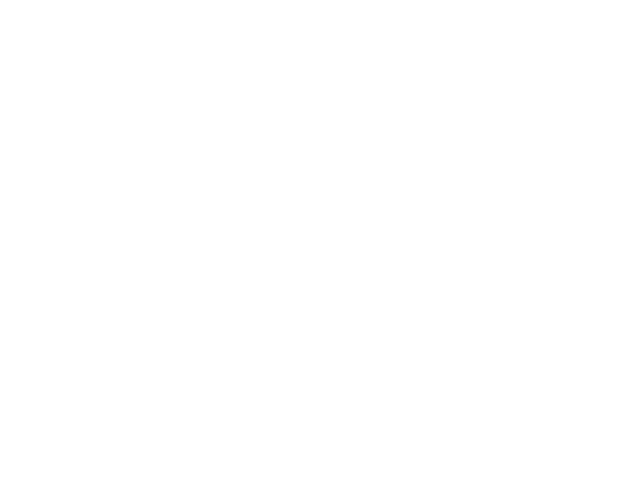

Sensor 30176
Errors:  10  ( 0.0751879699248 )
BIC - raw: -31.2924236411  BIC - clean: -10.8833137819


<IPython.core.display.Javascript object>


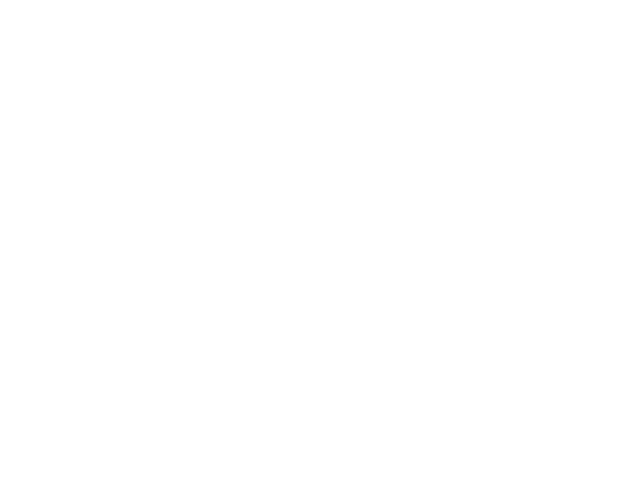

Chosen 35005
Predict is run


<IPython.core.display.Javascript object>


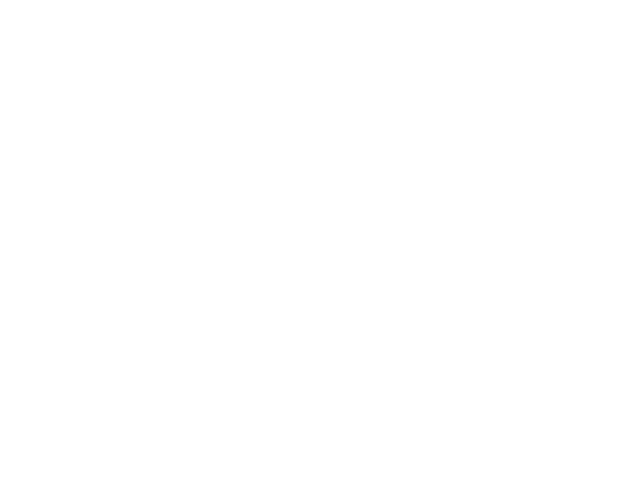

Sensor 35005
Errors:  765  ( 0.311990212072 )
BIC - raw: 2939.65297595  BIC - clean: 4538.00845769


<IPython.core.display.Javascript object>


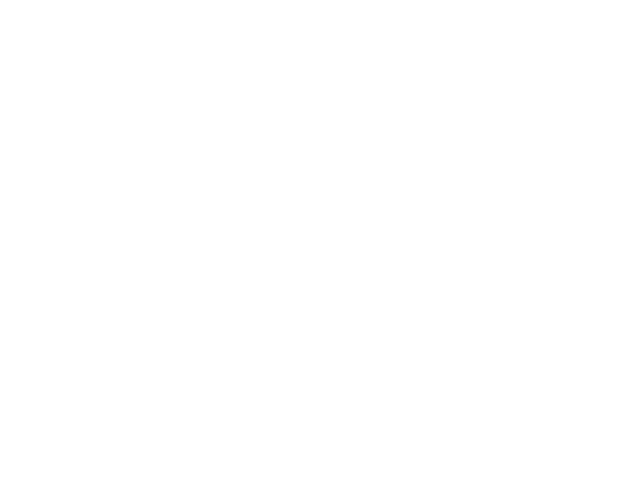

In [15]:
# go through all sensors and run algorithm for them
allNodes = []

for i in range(0, len(sources)):
    try:
        df, X, noise = LoadData(sources["Station_id"][i])
        avgWindow = (df['Date'][len(df) - 1] - df['Date'][0]) / 1000 / 60 / 60 / 24 / len(df)
        #if (avgWindow < 1.05) and (noise < 0.2):
        print("Chosen", sources["Station_id"][i])
        CompareCleanRaw(sources["Station_id"][i])
        #else:
        #    print("Rejected", sources["Station_id"][i])
    except Exception as inst:
        print(type(inst))    # the exception instance
        print(inst.args)     # arguments stored in .args

## Cleaning log statistics

In [16]:
file = open('cleaning.log', 'r') 
lines = file.read().split('\n')

In [55]:
better = 0
worse = 0
for i in range(len(lines)):
    if lines[i].find('Sensor ') != -1:
        sensorId = lines[i][7:]
        errors = lines[i+1].split(" ")[2]
        errorRate = lines[i+1].split(" ")[5]
        bicRaw = lines[i+2].split(" ")[3]
        bicClean = lines[i+2].split(" ")[8]
        if (float(bicClean) - float(bicRaw) <= 0):
            print(sensorId, errors, errorRate, bicRaw, bicClean, float(bicRaw) - float(bicClean))
            better = better + 1
        else:
            print("Worse", sensorId)
            worse = worse + 1

Worse 16005
Worse 75020
95052 54 0.461538461538 303.598664575 301.933602347 1.6650622280000107
Worse 95081
95006 42 0.352941176471 175.275185396 162.130966521 13.144218875000007
Worse 95035
Worse 95024
95046 20 0.176991150442 1760.41423138 1696.83453432 63.579697059999944
95031 34 0.283333333333 77.4054374531 72.4675415565 4.937895896600011
Worse 95030
95002 44 0.382608695652 258.362823916 232.553640081 25.809183835000027
Worse 95019
Worse 95020
95056 47 0.635135135135 323.532324596 279.429541789 44.10278280700004
Worse 95101
95057 2 0.00512820512821 5885.96942403 1693.91083085 4192.05859318
95059 53 0.441666666667 216.814893765 200.663373245 16.15152051999999
95058 48 0.403361344538 183.456111863 171.427433954 12.028677908999981
95055 4 0.000376010528295 134595.551995 -7260.53279903 141856.08479403
95105 2 0.00167224080268 17478.4193411 2065.051846 15413.367495100001
Worse 95005
95050 97 0.0368261199696 41831.437097 40949.1128138 882.3242832000033
Worse 95037
Worse 95007
Worse 95103
W

In [56]:
print(better, worse)

168 198
